In [9]:
import pairTrade
from pairTrade import pairTrade
import pandas as pd
import warnings
import pandas.util.testing as tm
from matplotlib import pyplot as plt
import statsmodels.tsa.stattools as ts 
warnings.filterwarnings('ignore')

symbols = pd.read_csv(f"/Users/jochien/Documents/MaxRereach/pair-trade/rawdata/symbols.csv").symbol.tolist()
df = ((pd.concat([pd.read_csv(f"/Users/jochien/Documents/MaxRereach/pair-trade/rawdata/{symbol}.csv", index_col='date', parse_dates=True)
        ['close'].rename(symbol)for symbol in symbols],axis=1,sort=True)))
df = df.loc[:,~df.columns.duplicated()]

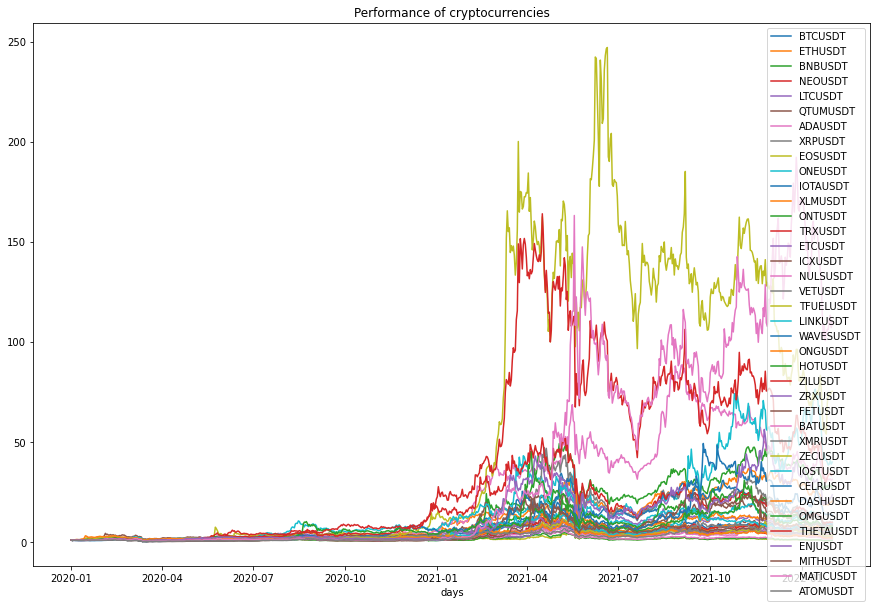

ETHUSDT and BNBUSDT: p-value = 0.03979705332444582
ETHUSDT and FETUSDT: p-value = 0.009294446232473275
ETHUSDT and ATOMUSDT: p-value = 0.023721913440312683
BNBUSDT and ETHUSDT: p-value = 0.04184327180902625
BNBUSDT and ONEUSDT: p-value = 0.017484822695047326
BNBUSDT and TFUELUSDT: p-value = 0.03356023967788704
BNBUSDT and ONGUSDT: p-value = 0.017847752585666694
BNBUSDT and HOTUSDT: p-value = 0.03491978636054913
BNBUSDT and FETUSDT: p-value = 0.04605206033659679
BNBUSDT and CELRUSDT: p-value = 0.018390725167988196
BNBUSDT and ENJUSDT: p-value = 0.02378173173397498
BNBUSDT and MATICUSDT: p-value = 0.038107528953613565
NEOUSDT and TFUELUSDT: p-value = 0.0001684619737509815
NEOUSDT and HOTUSDT: p-value = 0.018482944552887164
NEOUSDT and ZILUSDT: p-value = 0.025957842103161946
NEOUSDT and THETAUSDT: p-value = 2.6834950126713157e-07
LTCUSDT and BTCUSDT: p-value = 0.03861984946462687
LTCUSDT and IOTAUSDT: p-value = 0.0190484896026411
LTCUSDT and XLMUSDT: p-value = 0.00039515054718914565
LTCUS

WAVESUSDT and TRXUSDT: p-value = 0.01116972877720734
WAVESUSDT and VETUSDT: p-value = 0.015683923691441275
WAVESUSDT and TFUELUSDT: p-value = 0.001632307403118933
WAVESUSDT and ONGUSDT: p-value = 8.897822036597178e-05
WAVESUSDT and HOTUSDT: p-value = 0.006923414180555478
WAVESUSDT and FETUSDT: p-value = 0.0023848624756069073
WAVESUSDT and OMGUSDT: p-value = 0.042239187944367554
WAVESUSDT and THETAUSDT: p-value = 0.01907919031528317
ONGUSDT and ETHUSDT: p-value = 0.03418164222454803
ONGUSDT and BNBUSDT: p-value = 0.009574291195622732
ONGUSDT and QTUMUSDT: p-value = 0.022383863688809253
ONGUSDT and ADAUSDT: p-value = 0.009979372077112915
ONGUSDT and XRPUSDT: p-value = 0.005212552926376681
ONGUSDT and IOTAUSDT: p-value = 0.03279373127168058
ONGUSDT and TRXUSDT: p-value = 0.0018682625614575505
ONGUSDT and VETUSDT: p-value = 0.0014384162716002712
ONGUSDT and TFUELUSDT: p-value = 0.03851453444051624
ONGUSDT and WAVESUSDT: p-value = 0.00010944247282061185
ONGUSDT and HOTUSDT: p-value = 0.0098

MITHUSDT and DASHUSDT: p-value = 0.006560933853022412
MITHUSDT and THETAUSDT: p-value = 0.0006217928037544199
MATICUSDT and BNBUSDT: p-value = 0.03431794557039632
MATICUSDT and ONEUSDT: p-value = 0.03274629846865262
MATICUSDT and CELRUSDT: p-value = 0.03781541470290243
ATOMUSDT and ETHUSDT: p-value = 0.014003139677686655
ATOMUSDT and ONEUSDT: p-value = 0.0030698077520654433
ATOMUSDT and FETUSDT: p-value = 0.03033057537430436
ATOMUSDT and BATUSDT: p-value = 0.023245696792688585
ATOMUSDT and CELRUSDT: p-value = 0.01721653317572078
ATOMUSDT and ENJUSDT: p-value = 0.0074358629487091725


In [10]:
norm_prices = df.divide(df.iloc[0])

plt.figure(figsize = (15, 10))
plt.plot(norm_prices)
plt.xlabel('days')
plt.title('Performance of cryptocurrencies')
plt.legend(symbols)
plt.show()

result_list = []
for a1 in df.columns:
    for a2 in df.columns:
        if a1 != a2:
            test_result = ts.coint(df[a1], df[a2])
            if test_result[1] < 0.05:
                print(a1 + ' and ' + a2 + ': p-value = ' + str(test_result[1]))
                result_list.append((a1, a2, test_result[1]))

In [12]:
df1 = df[['QTUMUSDT', 'XRPUSDT']]
df2 = df[['XRPUSDT', 'QTUMUSDT']]

QTUMUSDT_XRPUSDT 回測結果
-----------------------------QTUMUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  -69727.92637791
總交易次數:  45
平均損益:  -1549.5094750646333
勝率:  0.35555555555555557
獲利因子:  0.38104301865134776
賺賠比:  0.6906404713055678
最大資金回落:  83290.37044819756
夏普比率:  -0.18755921221004085


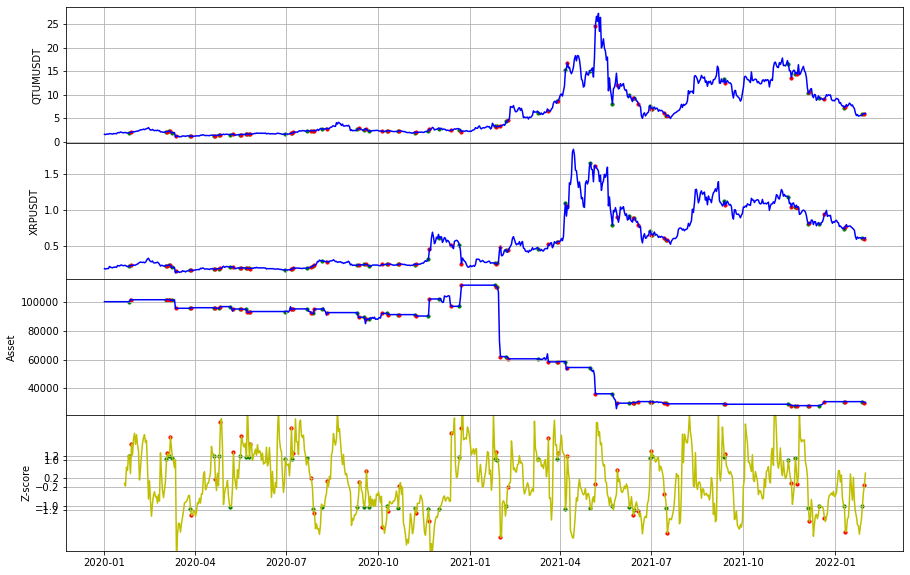

In [15]:
df1 = df[['QTUMUSDT', 'XRPUSDT']]
A = pairTrade(df1)
A.indicator(tradeType = 'ratio')
A.strategy(strategyType = 'divergence', actionType = 'amount', entry = 1, exit = 0.2, stopLoss = 1.2)
A.pplot()

XRPUSDT_QTUMUSDT 回測結果
-----------------------------XRPUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  -65326.76235596
總交易次數:  51
平均損益:  -1280.9169089403554
勝率:  0.39215686274509803
獲利因子:  0.4388432617967691
賺賠比:  0.6802070557849921
最大資金回落:  81306.15198440573
夏普比率:  -0.1763120264910473


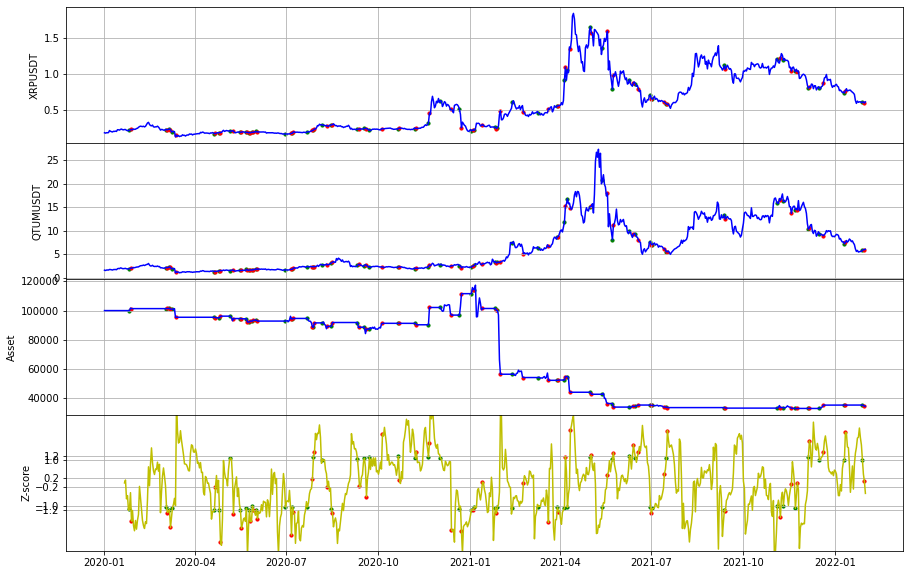

In [16]:
df2 = df[['XRPUSDT', 'QTUMUSDT']]
A = pairTrade(df2)
A.indicator(tradeType = 'ratio')
A.strategy(strategyType = 'divergence', actionType = 'amount', entry = 1, exit = 0.2, stopLoss = 1.2)
A.pplot()

QTUMUSDT_XRPUSDT 回測結果
-----------------------------QTUMUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  113911.37140196
總交易次數:  45
平均損益:  2531.3638089323404
勝率:  0.6444444444444445
獲利因子:  2.5103200229530014
賺賠比:  1.3850041505947595
最大資金回落:  27711.04709143433
夏普比率:  0.22336409314322703


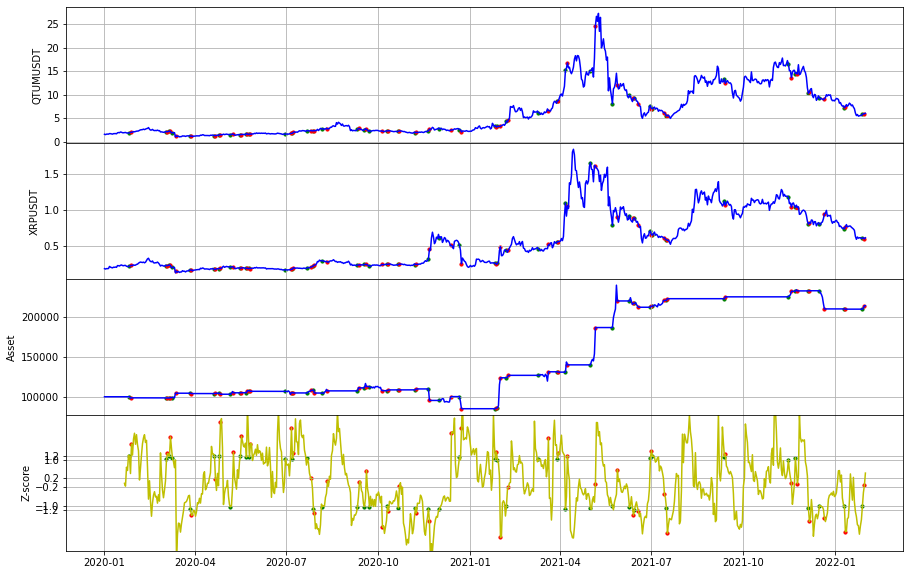

In [17]:
df1 = df[['QTUMUSDT', 'XRPUSDT']]
A = pairTrade(df1)
A.indicator(tradeType = 'ratio')
A.strategy(strategyType = 'convergence', actionType = 'amount', entry = 1, exit = 0.2, stopLoss = 1.2)
A.pplot()

XRPUSDT_QTUMUSDT 回測結果
-----------------------------XRPUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  100957.94359753
總交易次數:  51
平均損益:  1979.5675215201975
勝率:  0.6078431372549019
獲利因子:  2.2245695877679195
賺賠比:  1.4352061856567222
最大資金回落:  30593.01550479757
夏普比率:  0.22010530912700707


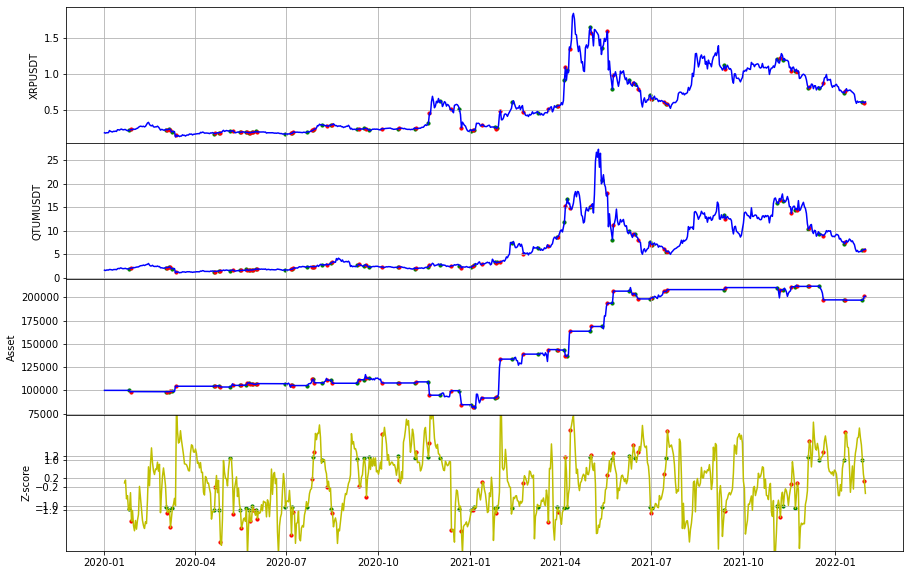

In [18]:
df2 = df[['XRPUSDT', 'QTUMUSDT']]
A = pairTrade(df2)
A.indicator(tradeType = 'ratio')
A.strategy(strategyType = 'convergence', actionType = 'amount', entry = 1, exit = 0.2, stopLoss = 1.2)
A.pplot()

ETHUSDT_BNBUSDT 回測結果，場上有單已平倉
-----------------------------ETHUSDT-BNBUSDT--------------------------
初始價格 100000
總損益:  -29917.50652167
總交易次數:  65
平均損益:  -460.26933110260177
勝率:  0.49230769230769234
獲利因子:  0.5800647304622387
賺賠比:  0.5800647304622387
最大資金回落:  40295.52748694543
夏普比率:  -0.17622399445556033


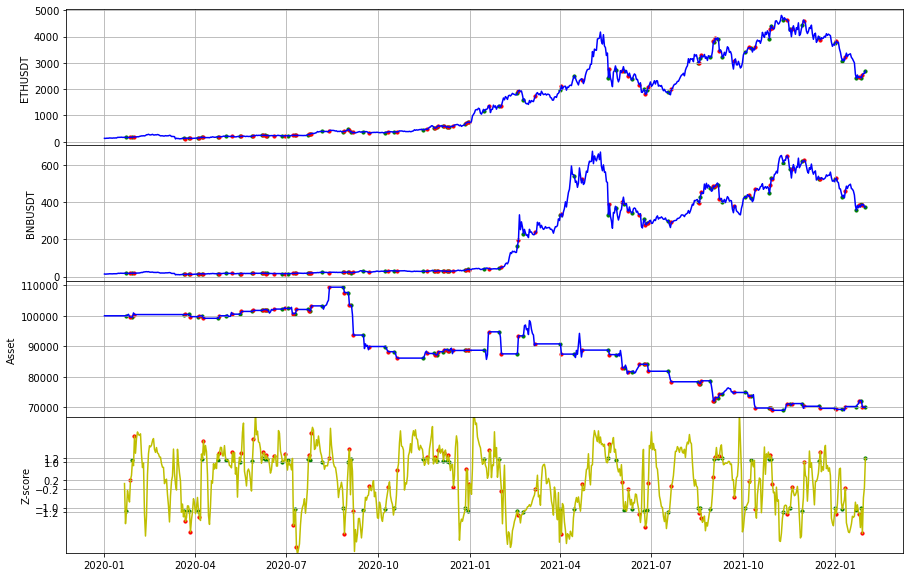

ETHUSDT_FETUSDT 回測結果
-----------------------------ETHUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  12312.48745678
總交易次數:  64
平均損益:  192.38261651214134
勝率:  0.5625
獲利因子:  1.1215135076146372
賺賠比:  0.8722882837002733
最大資金回落:  34713.11007899474
夏普比率:  0.04309068576541914


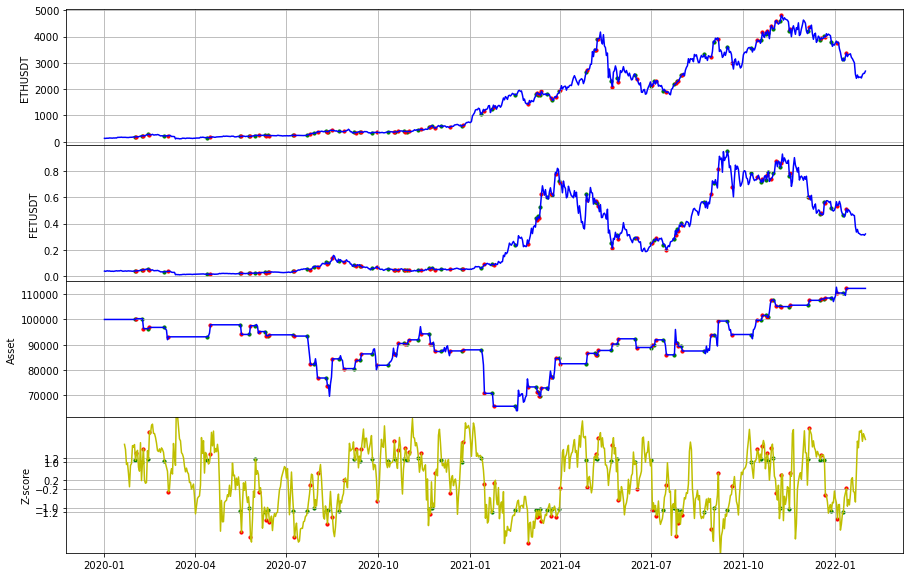

ETHUSDT_ATOMUSDT 回測結果
-----------------------------ETHUSDT-ATOMUSDT--------------------------
初始價格 100000
總損益:  -878.63312424
總交易次數:  57
平均損益:  -15.41461621473667
勝率:  0.5614035087719298
獲利因子:  0.9919595885947685
賺賠比:  0.7749684285896629
最大資金回落:  49353.889523388294
夏普比率:  -0.002484846878409262


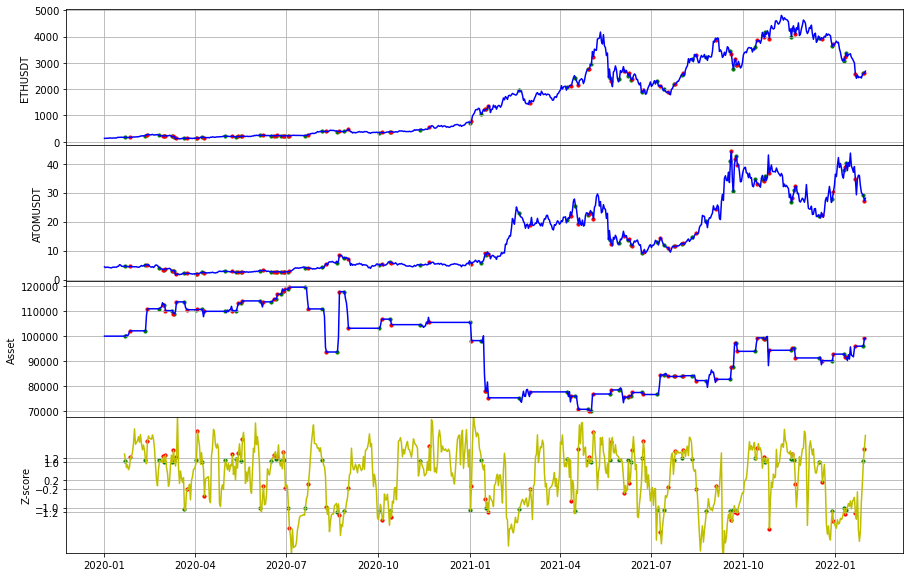

BNBUSDT_ETHUSDT 回測結果，場上有單已平倉
-----------------------------BNBUSDT-ETHUSDT--------------------------
初始價格 100000
總損益:  -34487.22357359
總交易次數:  69
平均損益:  -499.8148343998804
勝率:  0.4927536231884058
獲利因子:  0.5333834614231917
賺賠比:  0.5333834614231917
最大資金回落:  40450.04304196396
夏普比率:  -0.20495999167617987


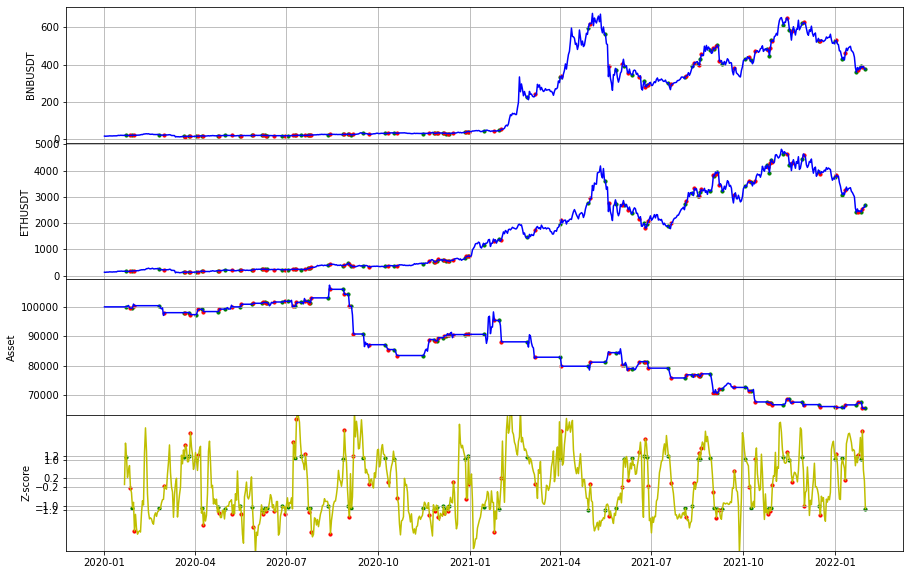

BNBUSDT_ONEUSDT 回測結果，場上有單已平倉
-----------------------------BNBUSDT-ONEUSDT--------------------------
初始價格 100000
總損益:  109718.38052833
總交易次數:  56
平均損益:  1959.2567951487986
勝率:  0.6607142857142857
獲利因子:  1.6274394589934564
賺賠比:  0.791727304375195
最大資金回落:  42380.37589714897
夏普比率:  0.16903370412282637


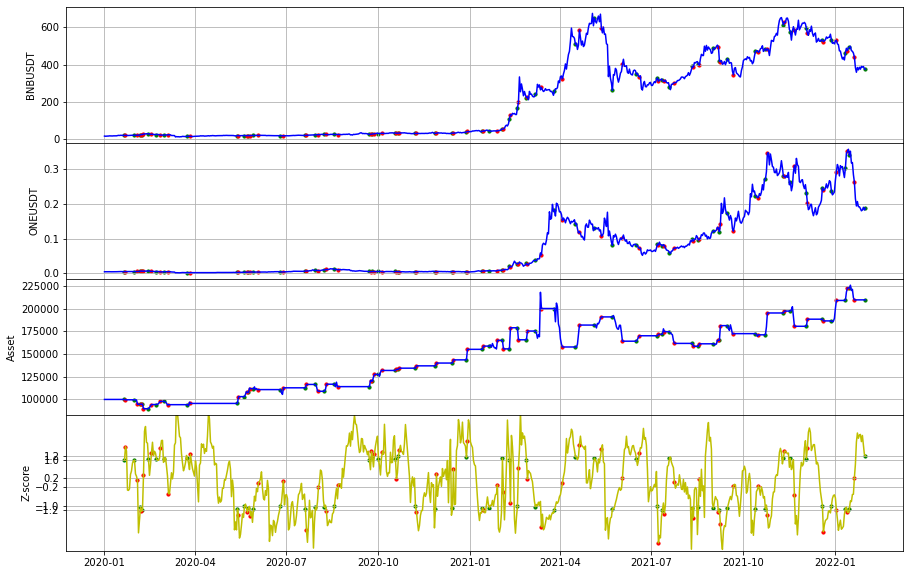

BNBUSDT_TFUELUSDT 回測結果
-----------------------------BNBUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  164416.81395254
總交易次數:  55
平均損益:  2989.3966173188505
勝率:  0.6
獲利因子:  2.4630776453585472
賺賠比:  1.6420517635723646
最大資金回落:  46390.161810611375
夏普比率:  0.26694523562200045


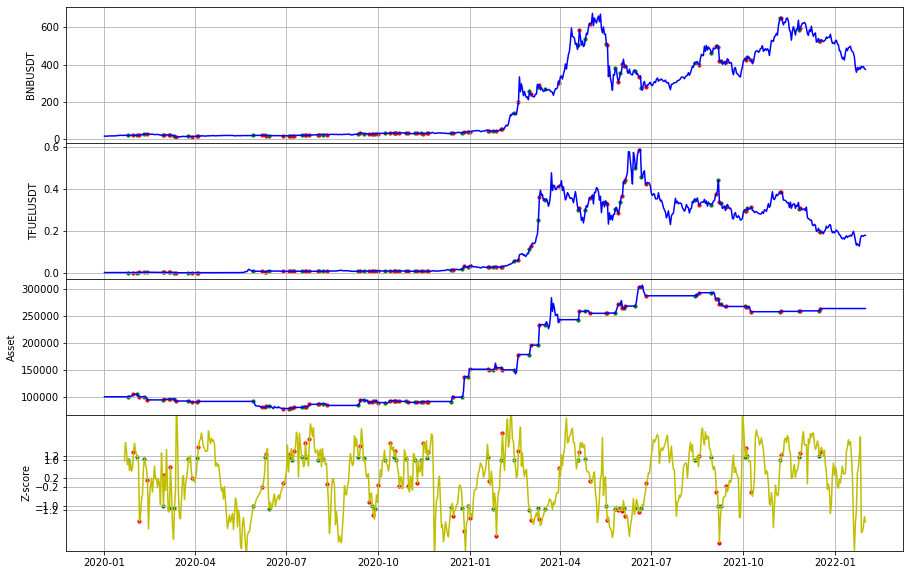

BNBUSDT_ONGUSDT 回測結果
-----------------------------BNBUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  68922.77861320
總交易次數:  49
平均損益:  1406.587318636768
勝率:  0.5714285714285714
獲利因子:  1.8411125422903967
賺賠比:  1.3808344067177973
最大資金回落:  18134.610254495114
夏普比率:  0.21404927484242003


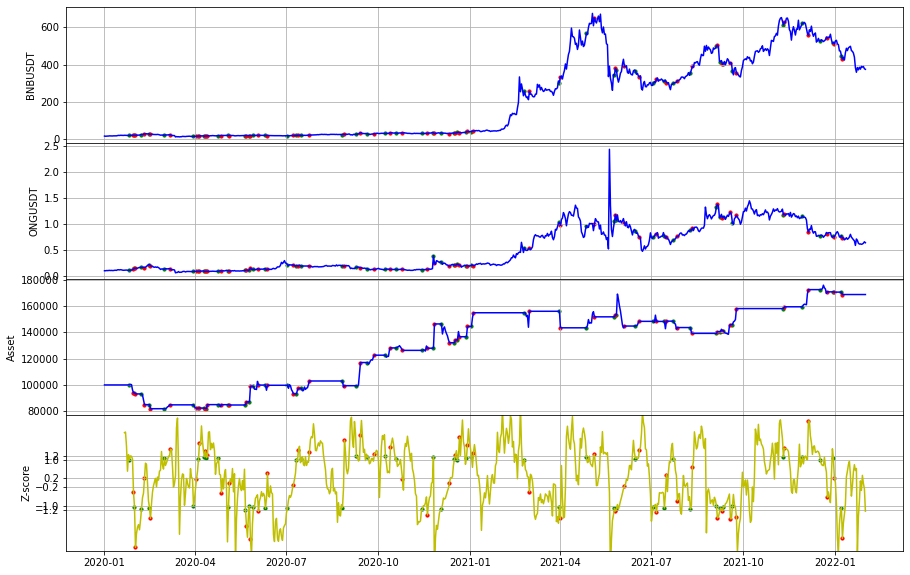

BNBUSDT_HOTUSDT 回測結果
-----------------------------BNBUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  169672.11104987
總交易次數:  49
平均損益:  3462.6961438748845
勝率:  0.5714285714285714
獲利因子:  2.478558573719921
賺賠比:  1.858918930289941
最大資金回落:  36870.558898724616
夏普比率:  0.18076392971145486


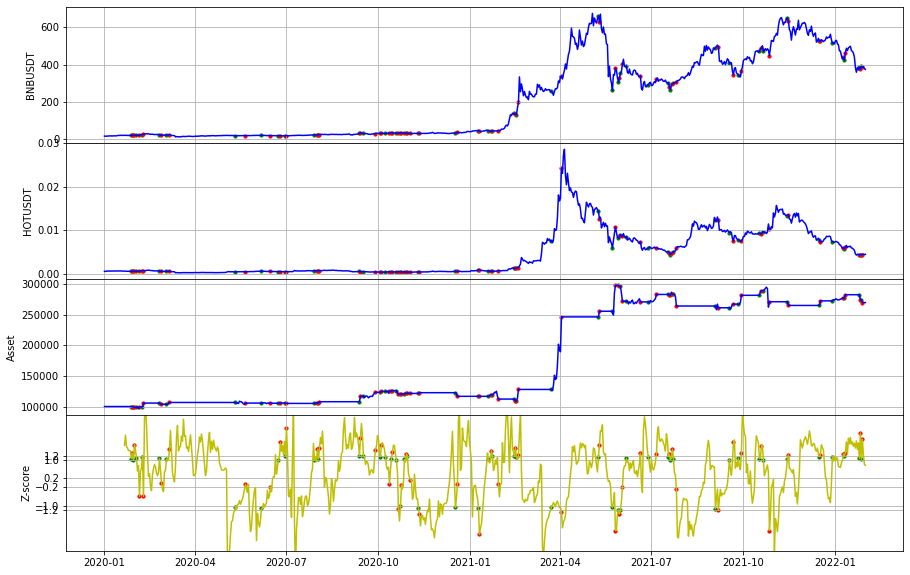

BNBUSDT_FETUSDT 回測結果
-----------------------------BNBUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  15088.24488375
總交易次數:  66
平均損益:  228.60977096588215
勝率:  0.45454545454545453
獲利因子:  1.08594524816304
賺賠比:  1.3031342977956484
最大資金回落:  41897.01835302009
夏普比率:  0.0294552065397099


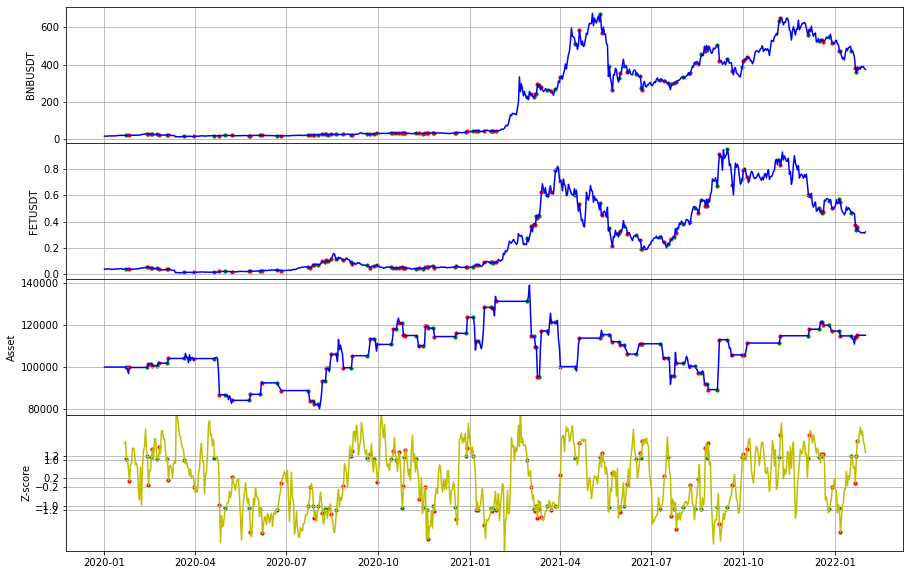

BNBUSDT_CELRUSDT 回測結果，場上有單已平倉
-----------------------------BNBUSDT-CELRUSDT--------------------------
初始價格 100000
總損益:  116880.34511957
總交易次數:  54
平均損益:  2164.450835547642
勝率:  0.5370370370370371
獲利因子:  1.7061024023030757
賺賠比:  1.4707779330198927
最大資金回落:  25065.64961215743
夏普比率:  0.15330681477580535


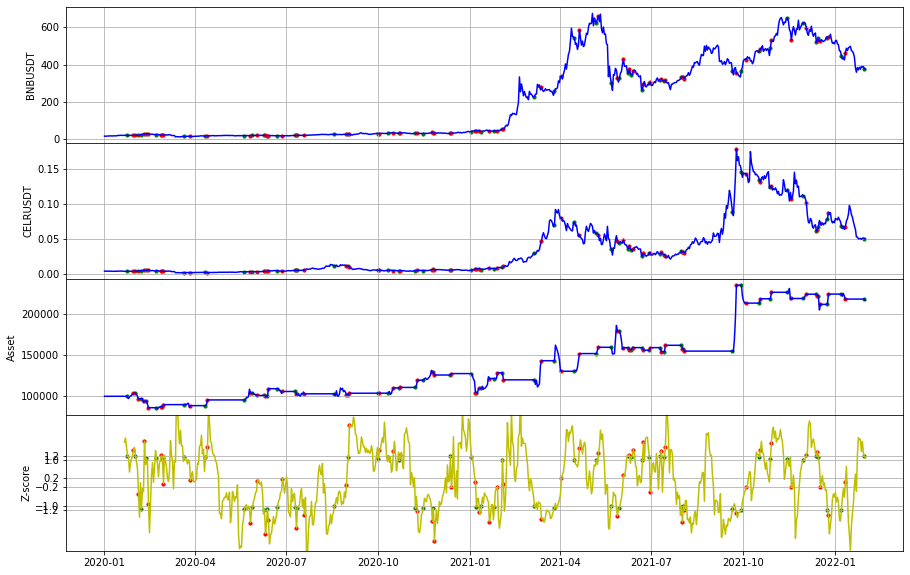

BNBUSDT_ENJUSDT 回測結果
-----------------------------BNBUSDT-ENJUSDT--------------------------
初始價格 100000
總損益:  -36779.44227456
總交易次數:  56
平均損益:  -656.7757549029237
勝率:  0.48214285714285715
獲利因子:  0.6729234194750325
賺賠比:  0.7227695986954052
最大資金回落:  38469.66906262397
夏普比率:  -0.13341354310683765


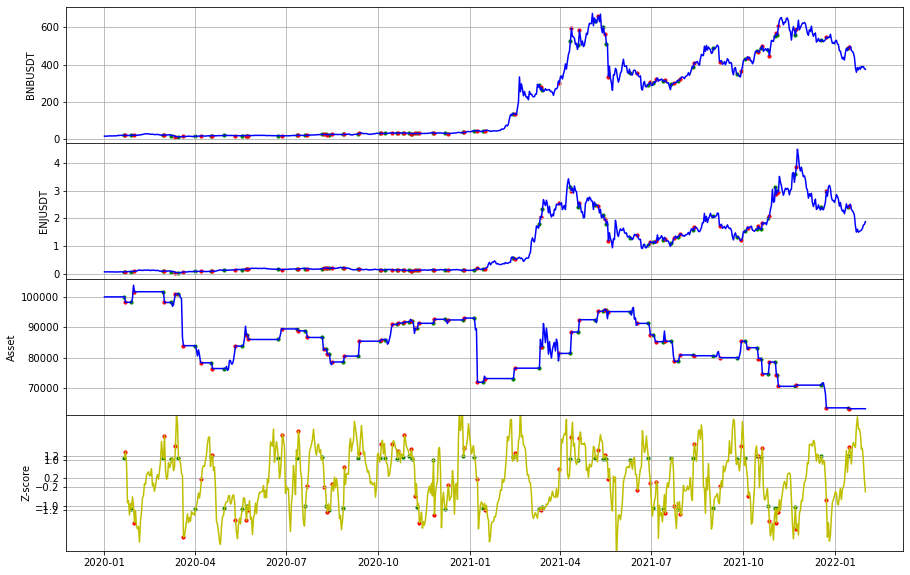

BNBUSDT_MATICUSDT 回測結果
-----------------------------BNBUSDT-MATICUSDT--------------------------
初始價格 100000
總損益:  85826.43668922
總交易次數:  49
平均損益:  1751.5599324330117
勝率:  0.42857142857142855
獲利因子:  1.5888507380051164
賺賠比:  2.1184676506734883
最大資金回落:  47262.04797849033
夏普比率:  0.13918908602922797


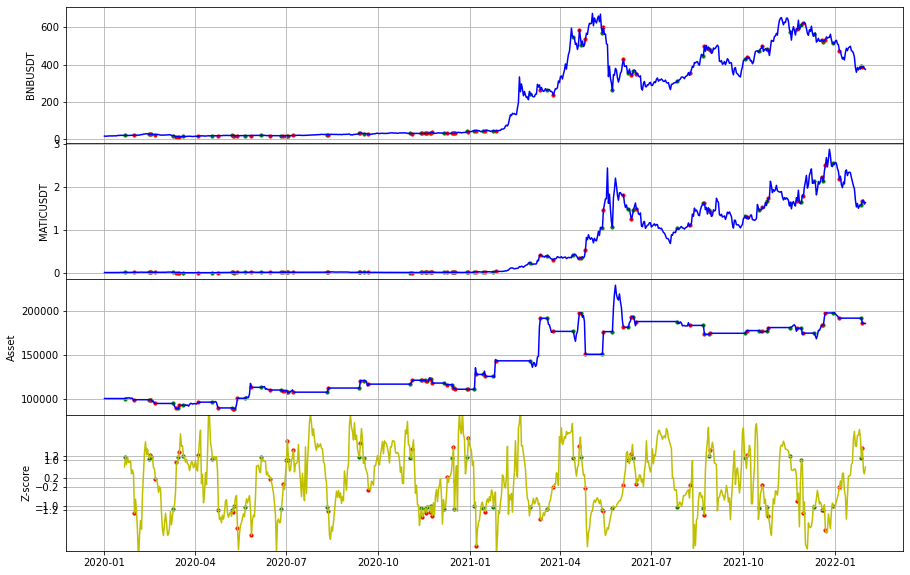

NEOUSDT_TFUELUSDT 回測結果
-----------------------------NEOUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  40342.94819828
總交易次數:  61
平均損益:  661.3598065291075
勝率:  0.5901639344262295
獲利因子:  1.3543995404818192
賺賠比:  0.9405552364457076
最大資金回落:  27281.420124510187
夏普比率:  0.10098363527492592


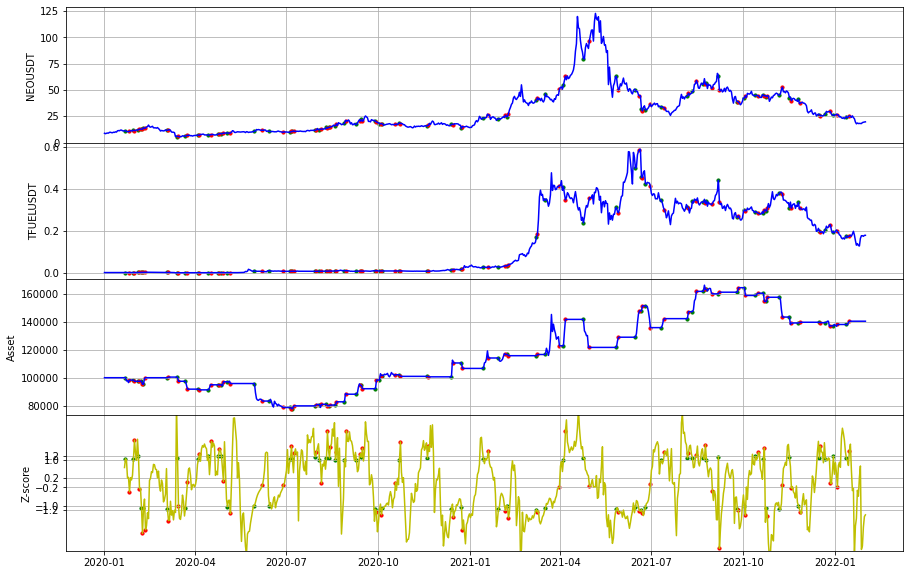

NEOUSDT_HOTUSDT 回測結果
-----------------------------NEOUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  213498.48943597
總交易次數:  59
平均損益:  3618.6184650164796
勝率:  0.6271186440677966
獲利因子:  3.651544590474097
賺賠比:  2.171188675417031
最大資金回落:  16915.413003688038
夏普比率:  0.2761559143416373


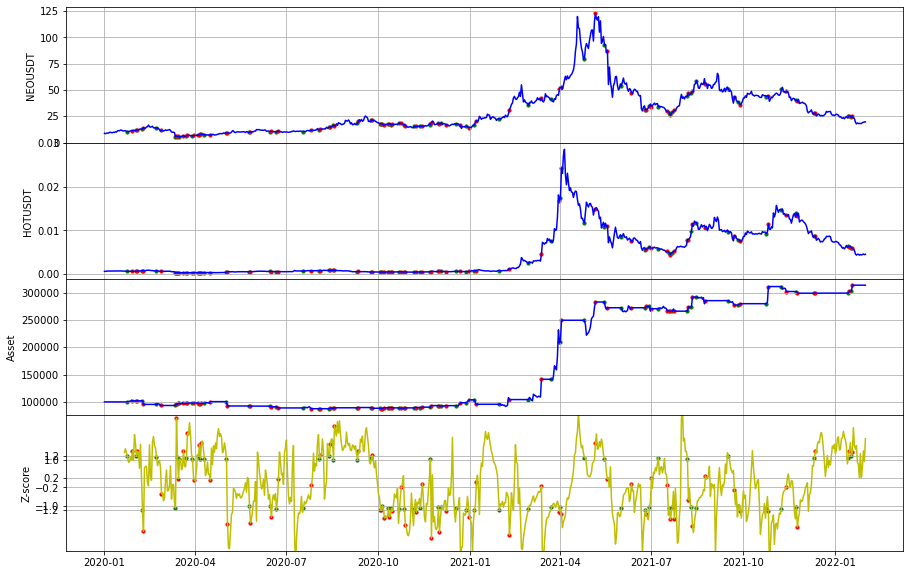

NEOUSDT_ZILUSDT 回測結果
-----------------------------NEOUSDT-ZILUSDT--------------------------
初始價格 100000
總損益:  13546.27345362
總交易次數:  53
平均損益:  255.59006516259814
勝率:  0.6037735849056604
獲利因子:  1.12164600356986
賺賠比:  0.7360801898427206
最大資金回落:  55267.42776138324
夏普比率:  0.03301357372298185


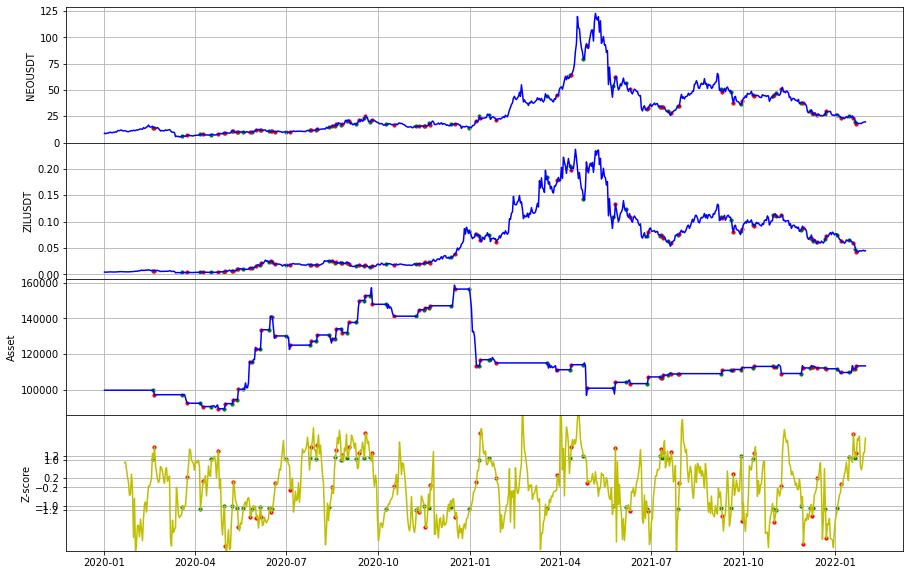

NEOUSDT_THETAUSDT 回測結果
-----------------------------NEOUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -27533.76377870
總交易次數:  54
平均損益:  -509.8845144203795
勝率:  0.5185185185185185
獲利因子:  0.7164306498993152
賺賠比:  0.6652570320493641
最大資金回落:  51102.92721393636
夏普比率:  -0.11825648901698141


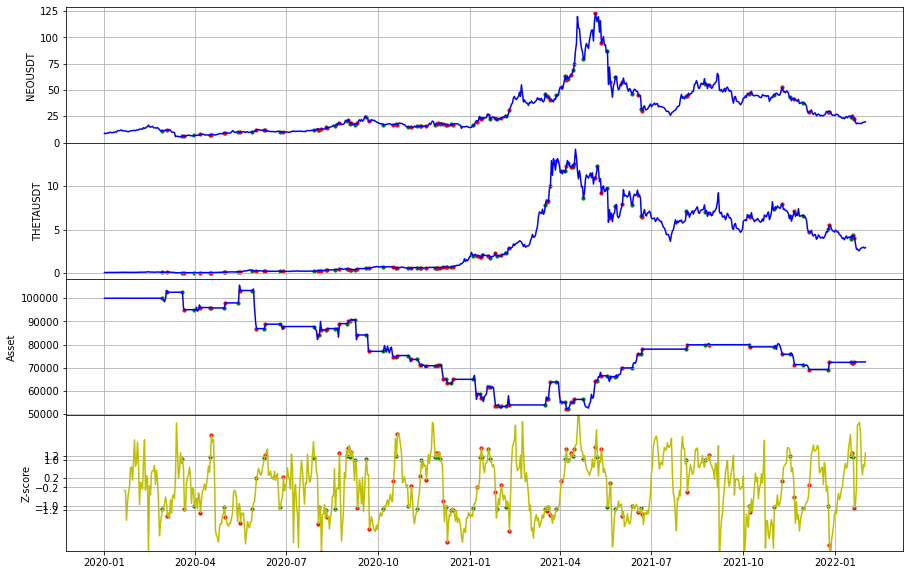

LTCUSDT_BTCUSDT 回測結果
-----------------------------LTCUSDT-BTCUSDT--------------------------
初始價格 100000
總損益:  -16964.23023772
總交易次數:  53
平均損益:  -320.0798158060604
勝率:  0.49056603773584906
獲利因子:  0.7143086149242209
賺賠比:  0.7417820231905371
最大資金回落:  36153.14408969105
夏普比率:  -0.11278121467601486


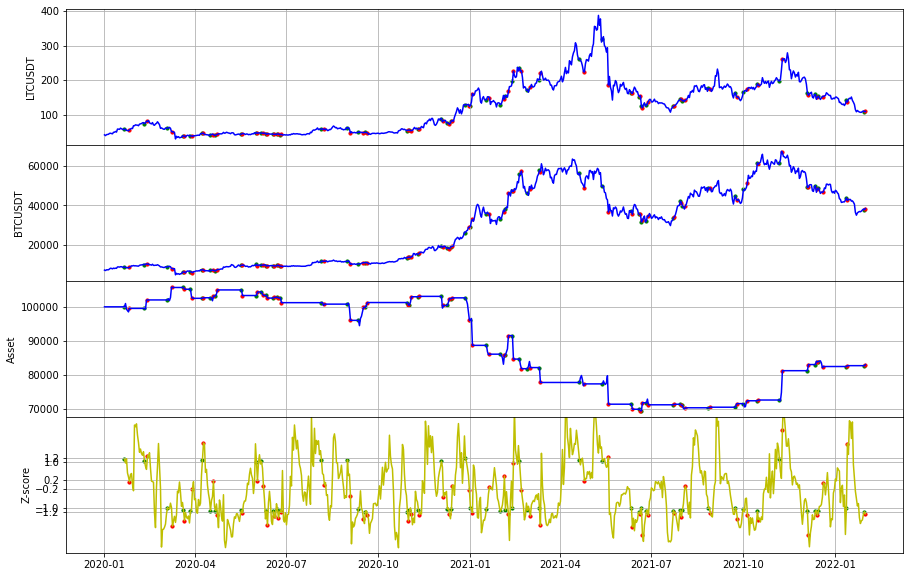

LTCUSDT_IOTAUSDT 回測結果
-----------------------------LTCUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  -12540.91281149
總交易次數:  39
平均損益:  -321.5618669612976
勝率:  0.4358974358974359
獲利因子:  0.7784071277860861
賺賠比:  1.0073504006643468
最大資金回落:  35621.338488921916
夏普比率:  -0.09839653669460484


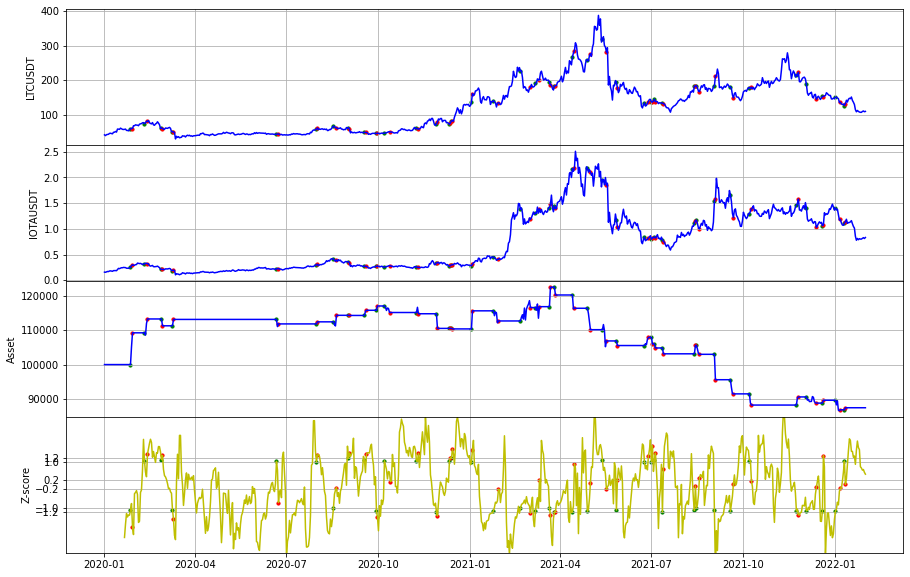

LTCUSDT_XLMUSDT 回測結果
-----------------------------LTCUSDT-XLMUSDT--------------------------
初始價格 100000
總損益:  6770.48185242
總交易次數:  55
平均損益:  123.09967004402874
勝率:  0.5272727272727272
獲利因子:  1.1222105454371551
賺賠比:  1.0061197993574496
最大資金回落:  14725.04728767059
夏普比率:  0.042817485838382845


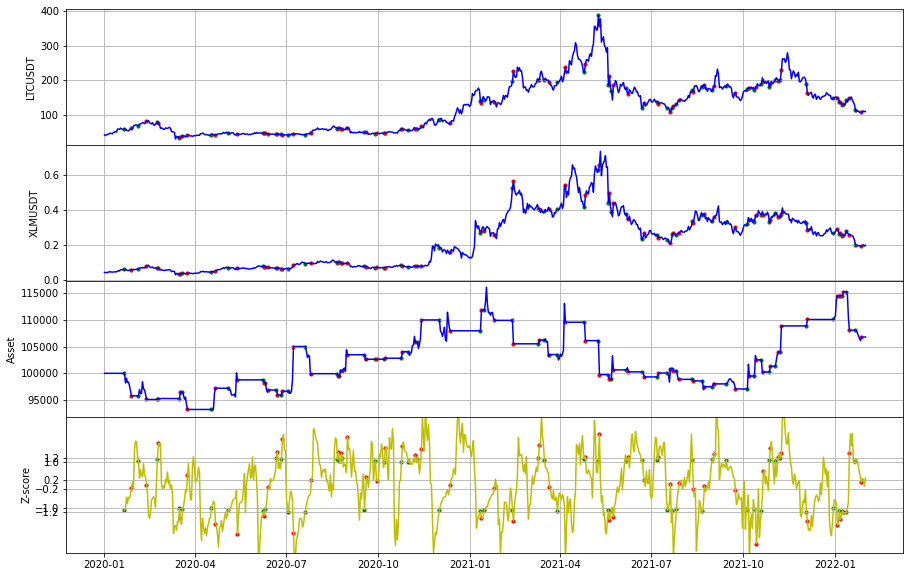

LTCUSDT_LINKUSDT 回測結果
-----------------------------LTCUSDT-LINKUSDT--------------------------
初始價格 100000
總損益:  -7906.85855479
總交易次數:  62
平均損益:  -127.5299766902303
勝率:  0.46774193548387094
獲利因子:  0.9107601102821966
賺賠比:  1.0363821944590512
最大資金回落:  24344.059619838517
夏普比率:  -0.03388644599728228


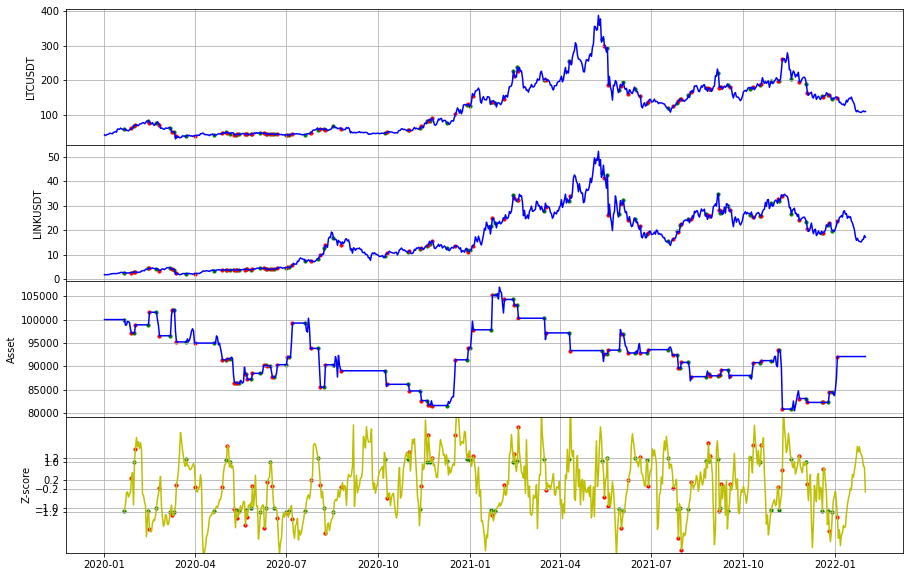

LTCUSDT_HOTUSDT 回測結果，場上有單已平倉
-----------------------------LTCUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  88034.64122384
總交易次數:  55
平均損益:  1600.6298404335103
勝率:  0.509090909090909
獲利因子:  1.6366812066534764
賺賠比:  1.5782283064158524
最大資金回落:  60163.59222427508
夏普比率:  0.09841656334755532


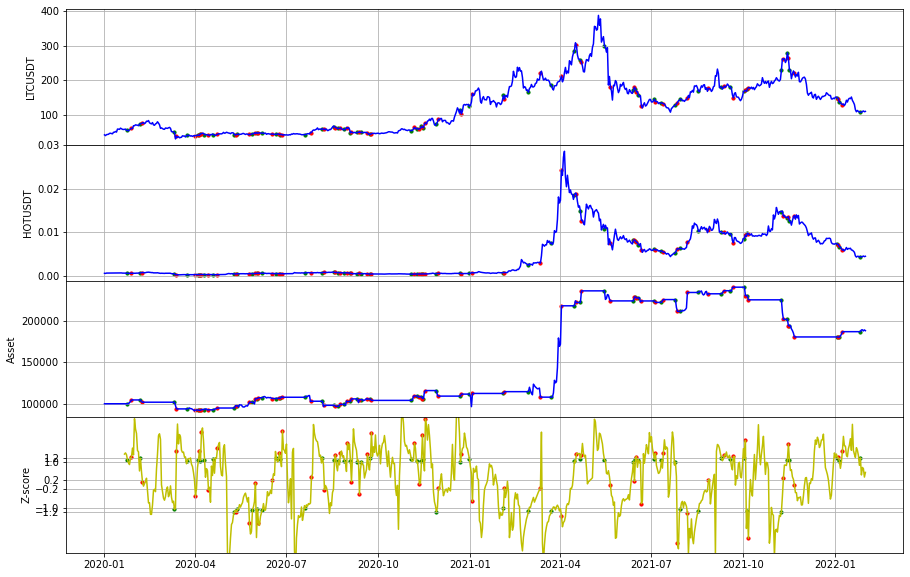

LTCUSDT_DASHUSDT 回測結果，場上有單已平倉
-----------------------------LTCUSDT-DASHUSDT--------------------------
初始價格 100000
總損益:  -35042.09259688
總交易次數:  56
平均損益:  -625.7516535158011
勝率:  0.39285714285714285
獲利因子:  0.45623020710489287
賺賠比:  0.7050830473439255
最大資金回落:  37401.50800067117
夏普比率:  -0.2621152443774272


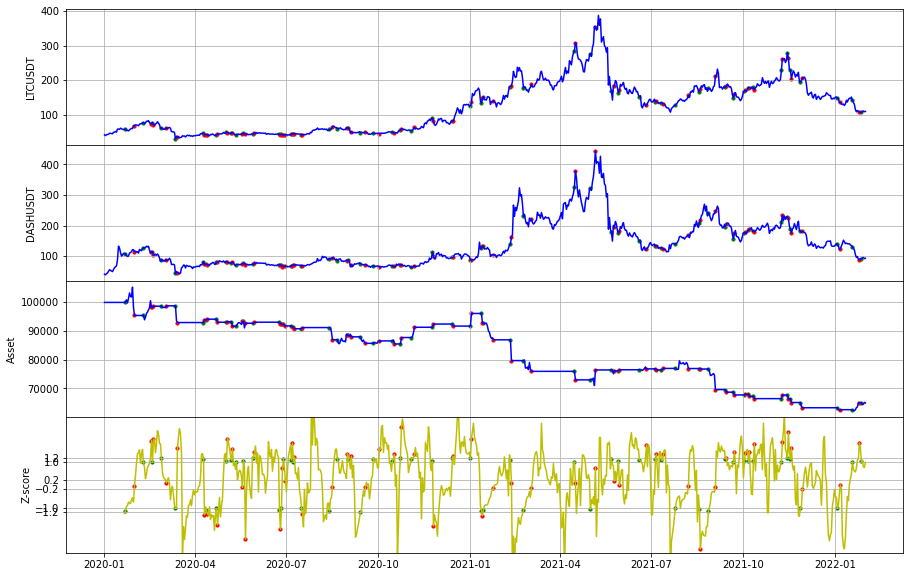

LTCUSDT_THETAUSDT 回測結果
-----------------------------LTCUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -29070.60827696
總交易次數:  67
平均損益:  -433.8896757754701
勝率:  0.4626865671641791
獲利因子:  0.7879176728999696
賺賠比:  0.9150011685289969
最大資金回落:  54105.17718514445
夏普比率:  -0.08295532959992219


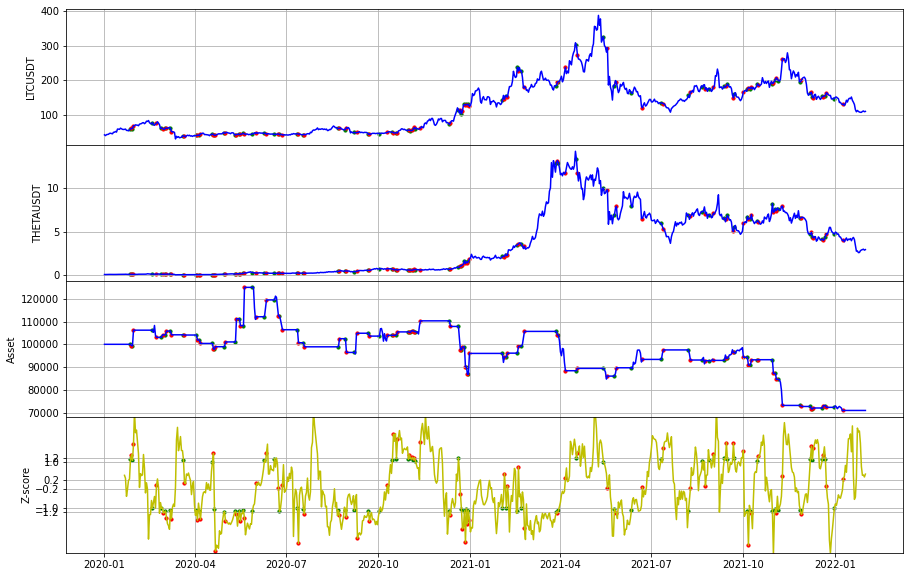

QTUMUSDT_XRPUSDT 回測結果
-----------------------------QTUMUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  -69727.92637791
總交易次數:  45
平均損益:  -1549.5094750646333
勝率:  0.35555555555555557
獲利因子:  0.38104301865134776
賺賠比:  0.6906404713055678
最大資金回落:  83290.37044819756
夏普比率:  -0.18755921221004085


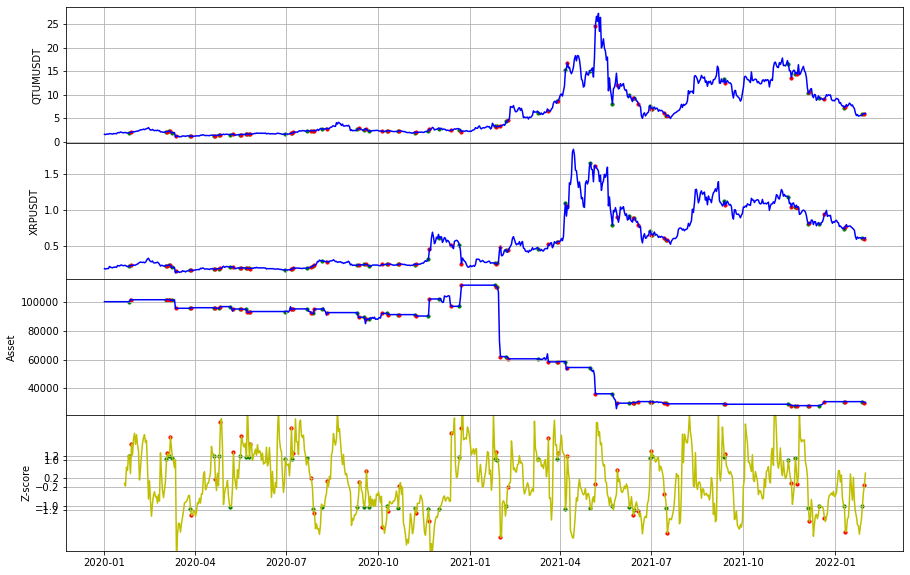

QTUMUSDT_IOTAUSDT 回測結果
-----------------------------QTUMUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  -25860.67157681
總交易次數:  67
平均損益:  -385.9801727881657
勝率:  0.417910447761194
獲利因子:  0.7178891665082765
賺賠比:  0.9999170533508137
最大資金回落:  59751.69760462052
夏普比率:  -0.11149743604297871


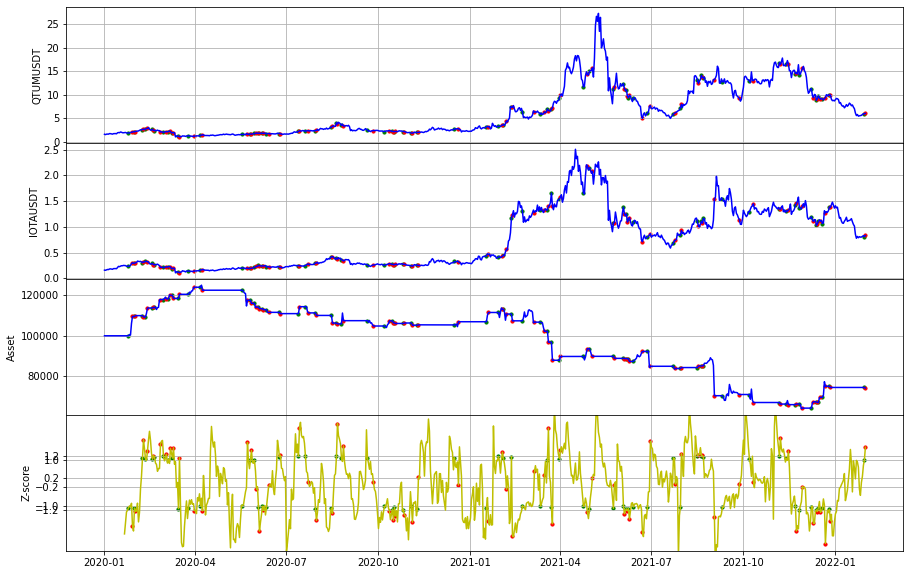

QTUMUSDT_TRXUSDT 回測結果，場上有單已平倉
-----------------------------QTUMUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  -30734.30401530
總交易次數:  46
平均損益:  -668.1370438109269
勝率:  0.34782608695652173
獲利因子:  0.5116834717646609
賺賠比:  0.9594065095587391
最大資金回落:  39950.429278989366
夏普比率:  -0.2369716655772087


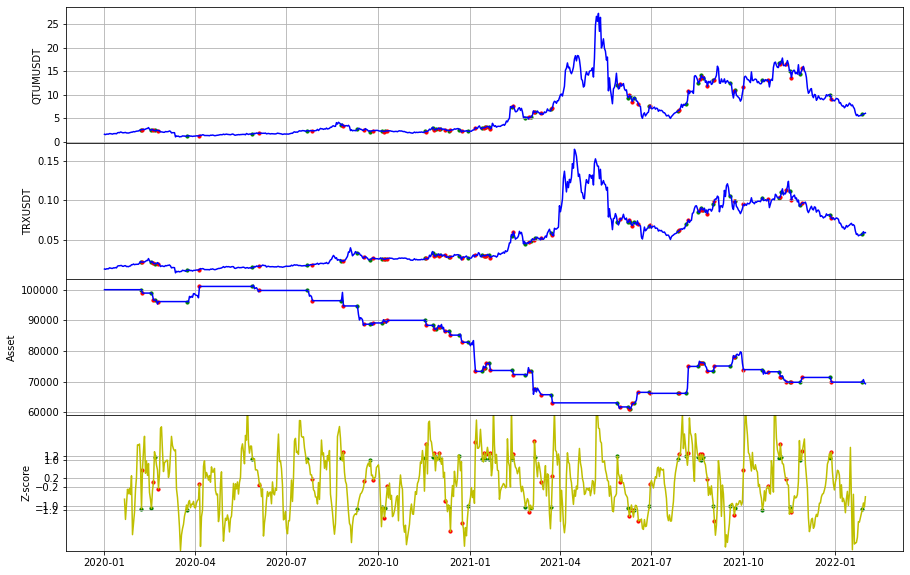

QTUMUSDT_VETUSDT 回測結果
-----------------------------QTUMUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -35853.41953186
總交易次數:  47
平均損益:  -762.8387134437235
勝率:  0.40425531914893614
獲利因子:  0.5547007733647602
賺賠比:  0.8174537712743835
最大資金回落:  43867.26686708548
夏普比率:  -0.2002978979411173


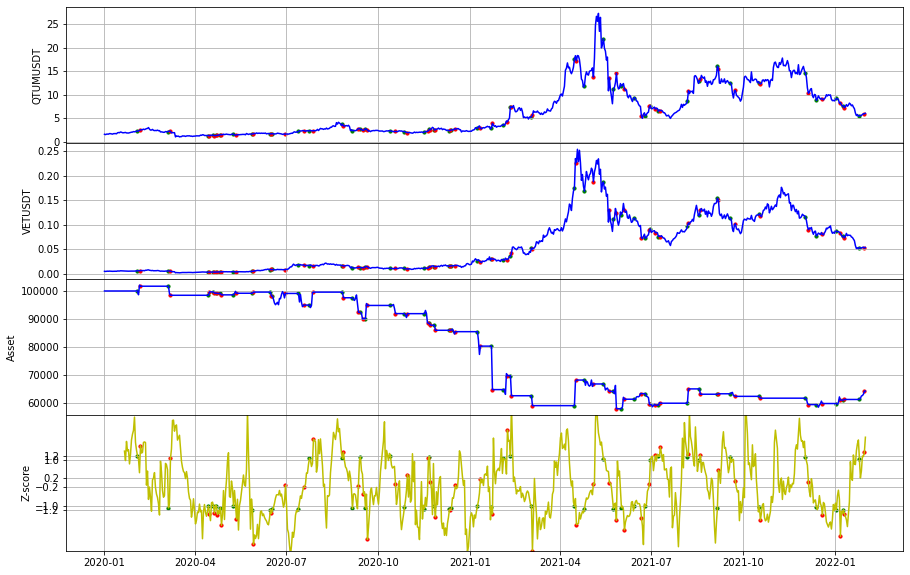

QTUMUSDT_TFUELUSDT 回測結果
-----------------------------QTUMUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  55610.98967484
總交易次數:  56
平均損益:  993.0533870507882
勝率:  0.5178571428571429
獲利因子:  1.2950963836544271
賺賠比:  1.2057793916782595
最大資金回落:  73922.3548088554
夏普比率:  0.0685361547512118


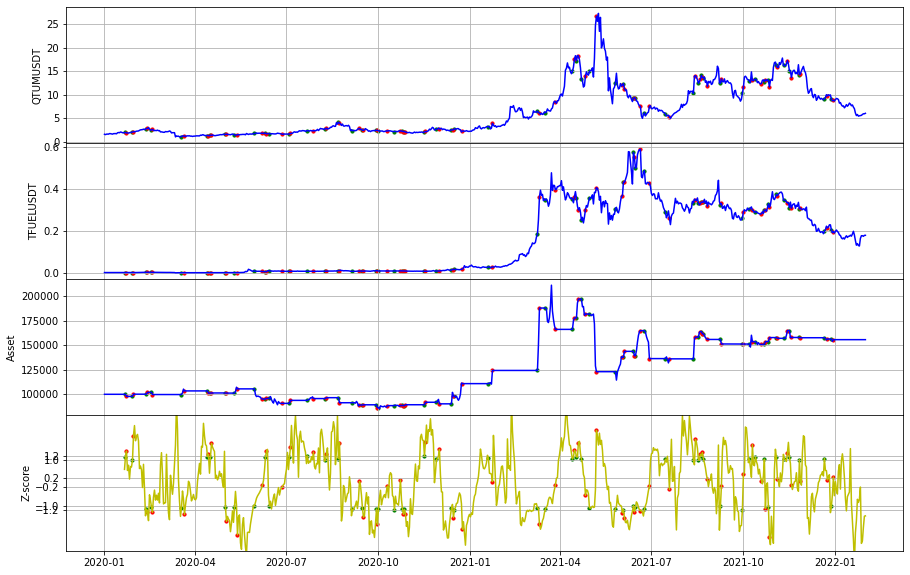

QTUMUSDT_ONGUSDT 回測結果，場上有單已平倉
-----------------------------QTUMUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -73901.35061803
總交易次數:  54
平均損益:  -1368.5435299634757
勝率:  0.4444444444444444
獲利因子:  0.6958889611655928
賺賠比:  0.869861201456991
最大資金回落:  192244.16895450462
夏普比率:  -0.050544431267804564


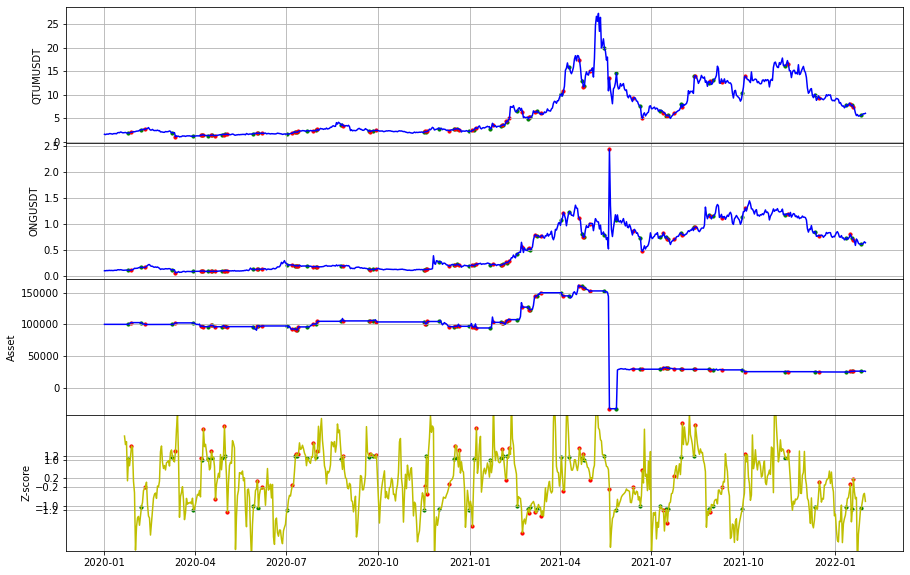

QTUMUSDT_HOTUSDT 回測結果
-----------------------------QTUMUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  -15685.83338786
總交易次數:  51
平均損益:  -307.56536054620335
勝率:  0.4117647058823529
獲利因子:  0.8533662804256202
賺賠比:  1.2190946863223147
最大資金回落:  52530.99427454044
夏普比率:  -0.049595437638276854


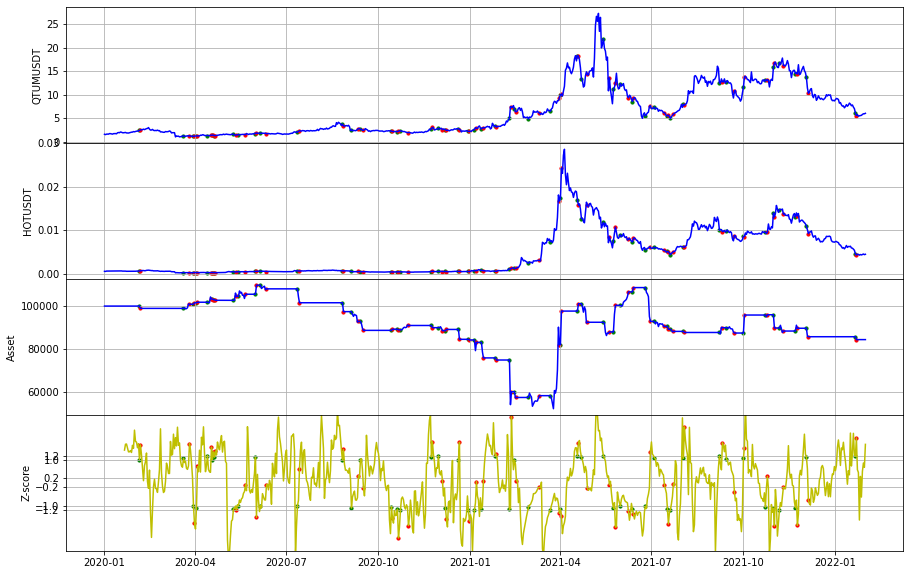

QTUMUSDT_FETUSDT 回測結果
-----------------------------QTUMUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  -62600.65650541
總交易次數:  61
平均損益:  -1026.2402705804616
勝率:  0.36065573770491804
獲利因子:  0.447796368585035
賺賠比:  0.7938208352189257
最大資金回落:  64123.23722647026
夏普比率:  -0.1982984462022707


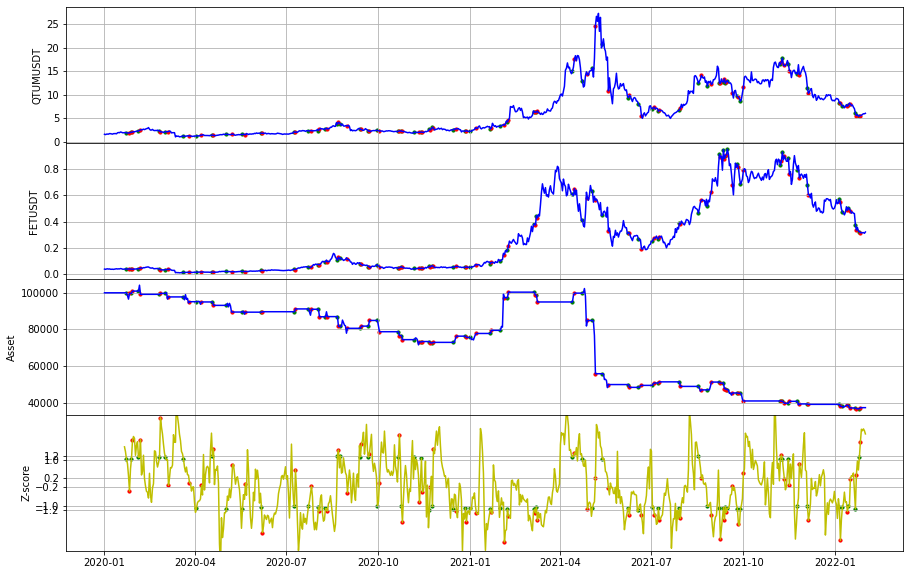

QTUMUSDT_IOSTUSDT 回測結果
-----------------------------QTUMUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  21727.76041797
總交易次數:  52
平均損益:  417.8415464995112
勝率:  0.5576923076923077
獲利因子:  1.2650135461011316
賺賠比:  1.0032866055284837
最大資金回落:  40726.55905206334
夏普比率:  0.07904762976892964


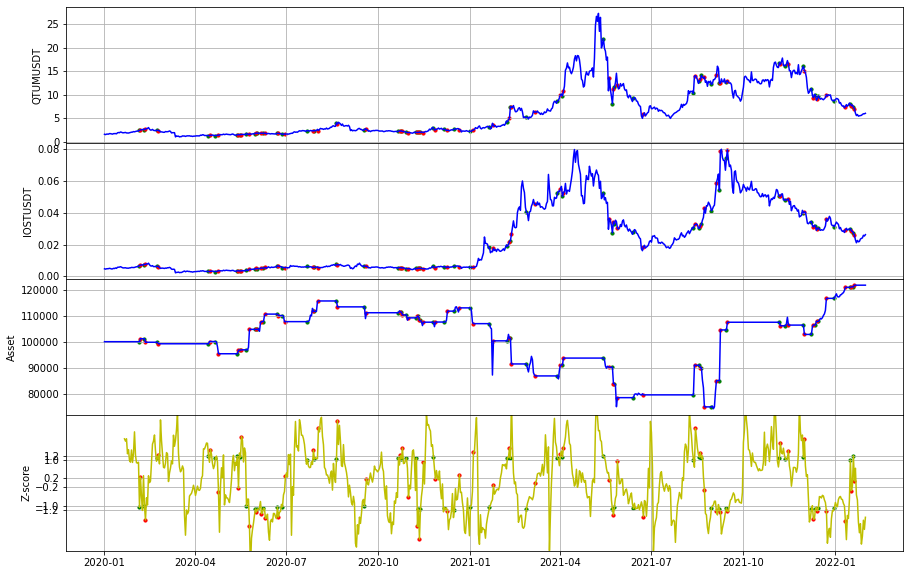

QTUMUSDT_THETAUSDT 回測結果，場上有單已平倉
-----------------------------QTUMUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -6280.55164956
總交易次數:  71
平均損益:  -88.45847393742075
勝率:  0.4788732394366197
獲利因子:  0.9606173660802413
賺賠比:  1.0171242699673142
最大資金回落:  42047.601129391594
夏普比率:  -0.014500062296098517


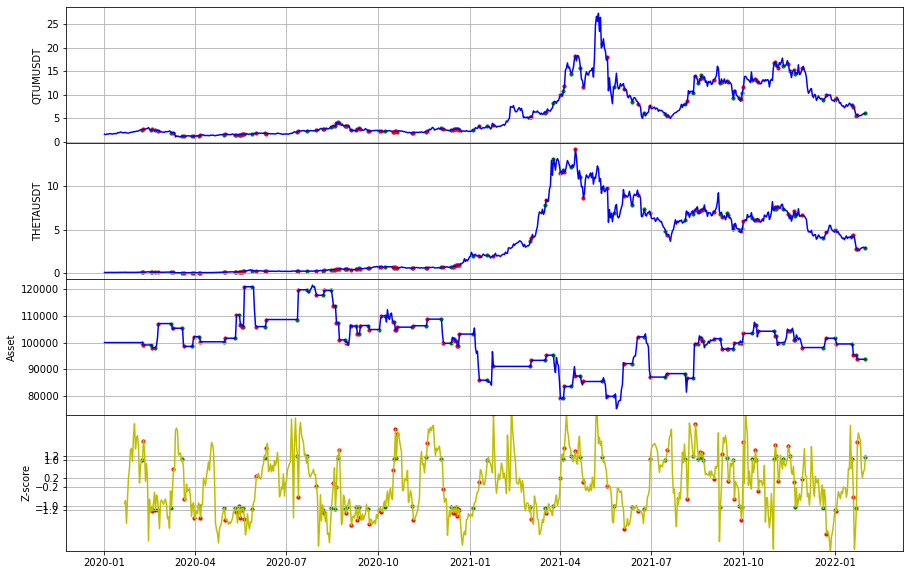

QTUMUSDT_MITHUSDT 回測結果
-----------------------------QTUMUSDT-MITHUSDT--------------------------
初始價格 100000
總損益:  -88754.45568886
總交易次數:  55
平均損益:  -1613.7173761611712
勝率:  0.2909090909090909
獲利因子:  0.2271807467296729
賺賠比:  0.5537530701535777
最大資金回落:  93454.07280600922
夏普比率:  -0.4085549632177639


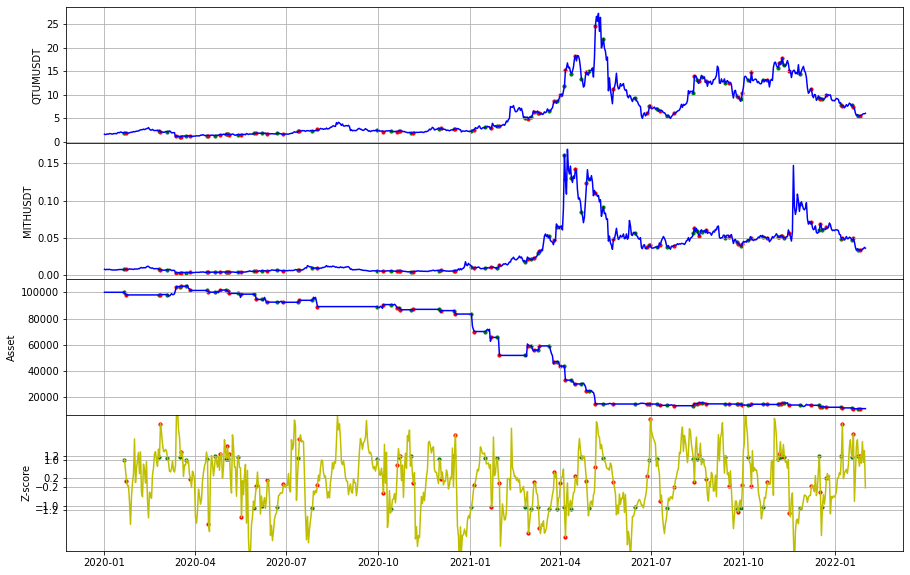

ADAUSDT_XRPUSDT 回測結果
-----------------------------ADAUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  28091.16786661
總交易次數:  55
平均損益:  510.74850666561053
勝率:  0.509090909090909
獲利因子:  1.2633299622618344
賺賠比:  1.2182110350381974
最大資金回落:  63879.35720486188
夏普比率:  0.05294819455202583


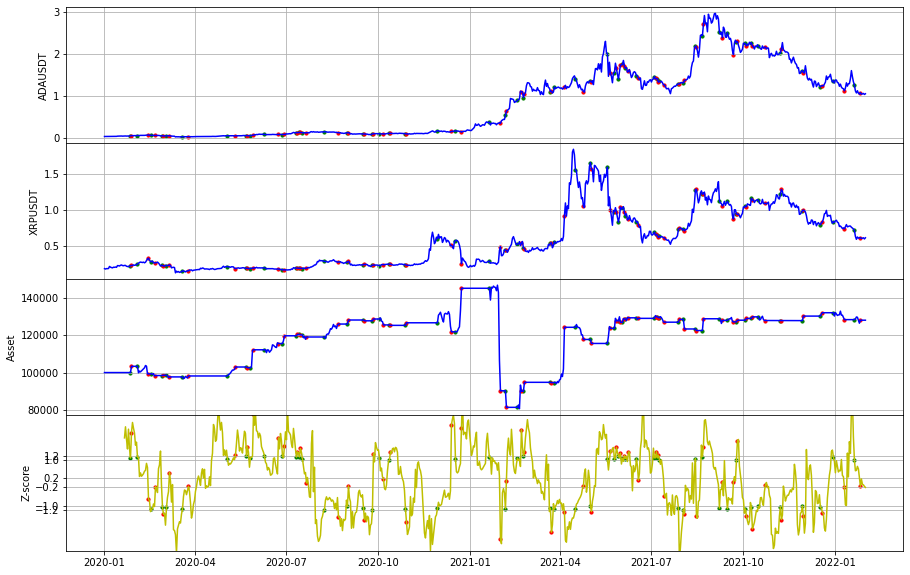

ADAUSDT_TRXUSDT 回測結果
-----------------------------ADAUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  73706.97451634
總交易次數:  44
平均損益:  1675.158511734948
勝率:  0.6136363636363636
獲利因子:  1.8783465689330543
賺賠比:  1.1826626545134047
最大資金回落:  28624.317661334673
夏普比率:  0.20745799092675113


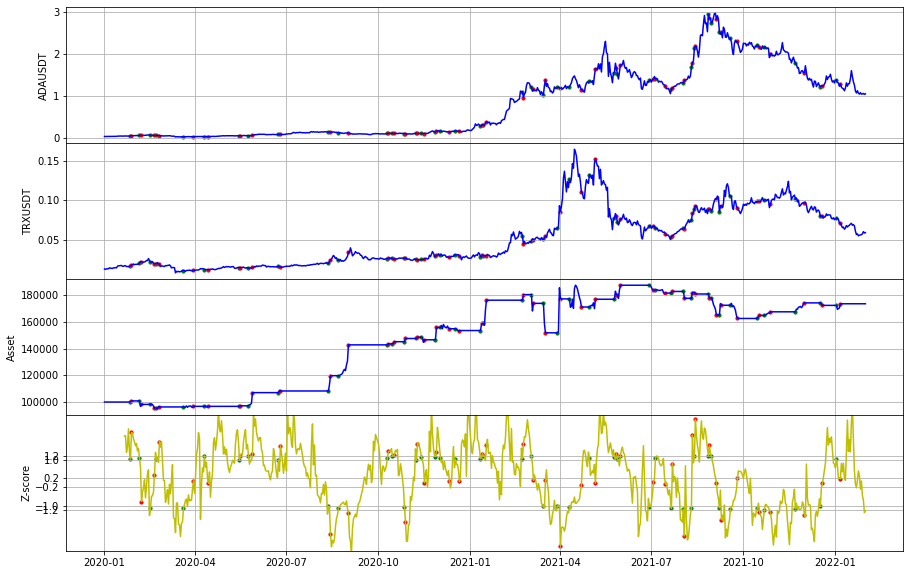

ADAUSDT_ETCUSDT 回測結果
-----------------------------ADAUSDT-ETCUSDT--------------------------
初始價格 100000
總損益:  26408.63714747
總交易次數:  48
平均損益:  550.179940572275
勝率:  0.5416666666666666
獲利因子:  1.25631024972507
賺賠比:  1.0630317497673671
最大資金回落:  55765.22779911359
夏普比率:  0.048515192266660456


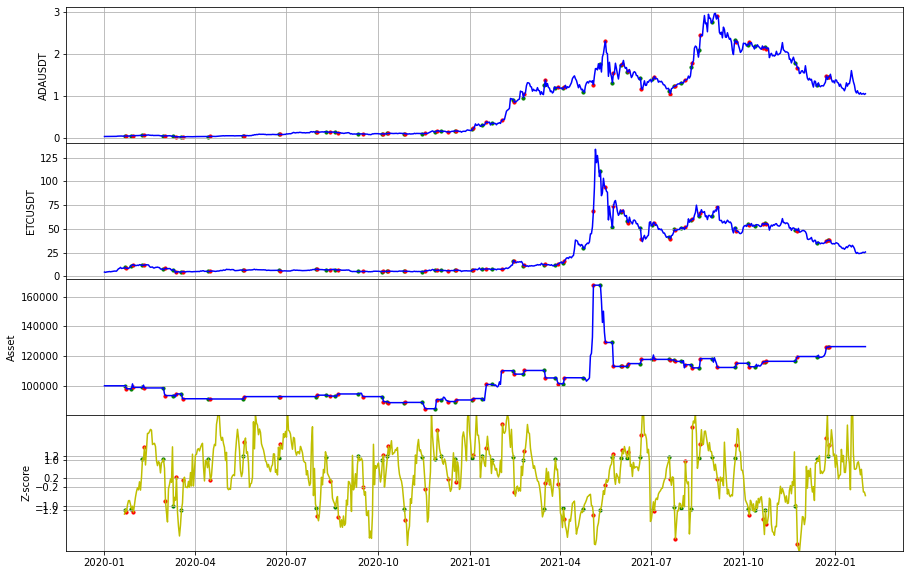

ADAUSDT_TFUELUSDT 回測結果
-----------------------------ADAUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  38548.30390972
總交易次數:  61
平均損益:  631.9394083561277
勝率:  0.45901639344262296
獲利因子:  1.2455794811084917
賺賠比:  1.4680043884492937
最大資金回落:  32439.810997934837
夏普比率:  0.07127625309141088


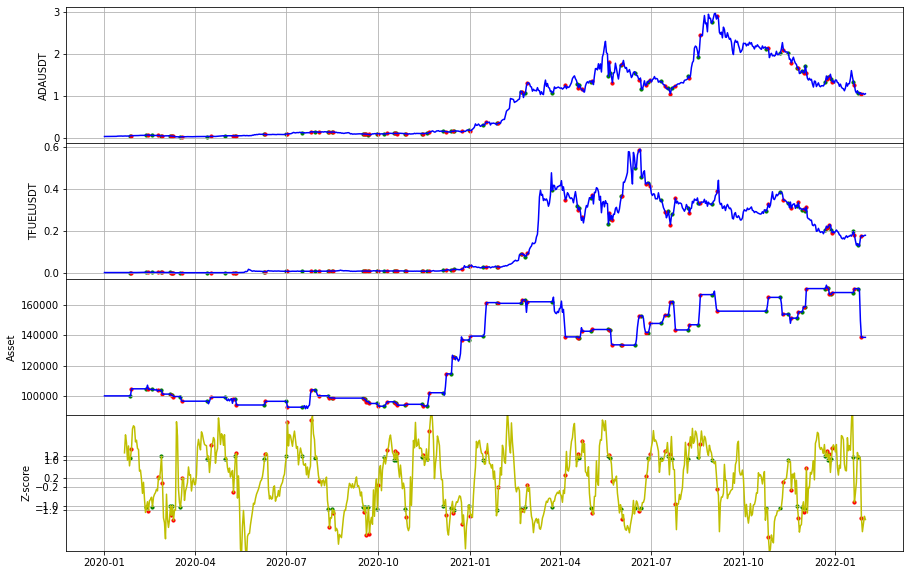

ADAUSDT_WAVESUSDT 回測結果
-----------------------------ADAUSDT-WAVESUSDT--------------------------
初始價格 100000
總損益:  -16239.09261271
總交易次數:  44
平均損益:  -369.0702866523987
勝率:  0.4772727272727273
獲利因子:  0.8084389570914549
賺賠比:  0.8854331434811172
最大資金回落:  47279.68686393117
夏普比率:  -0.07980887922436185


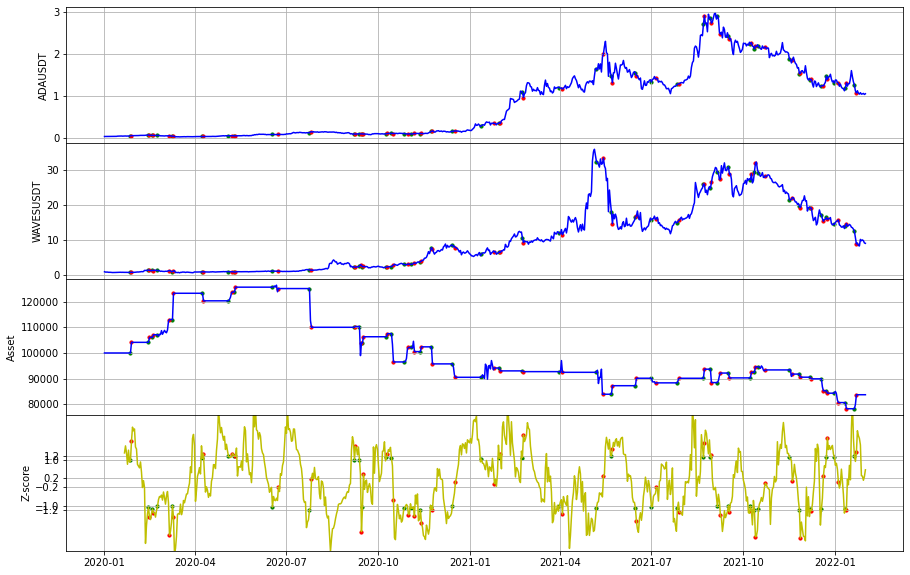

ADAUSDT_ONGUSDT 回測結果
-----------------------------ADAUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -30167.23402497
總交易次數:  50
平均損益:  -603.3446804994948
勝率:  0.48
獲利因子:  0.6431264429838573
賺賠比:  0.6967203132325122
最大資金回落:  44728.29829024648
夏普比率:  -0.16025188753455658


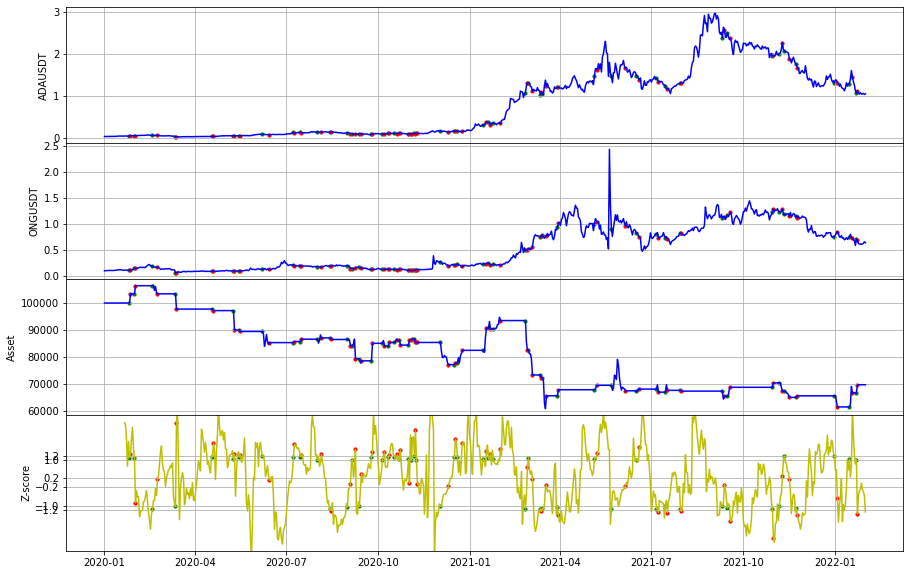

ADAUSDT_FETUSDT 回測結果，場上有單已平倉
-----------------------------ADAUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  -6598.12432686
總交易次數:  70
平均損益:  -94.2589189550991
勝率:  0.5142857142857142
獲利因子:  0.959139731137132
賺賠比:  0.9058541905184025
最大資金回落:  44638.76359214503
夏普比率:  -0.014811994834356404


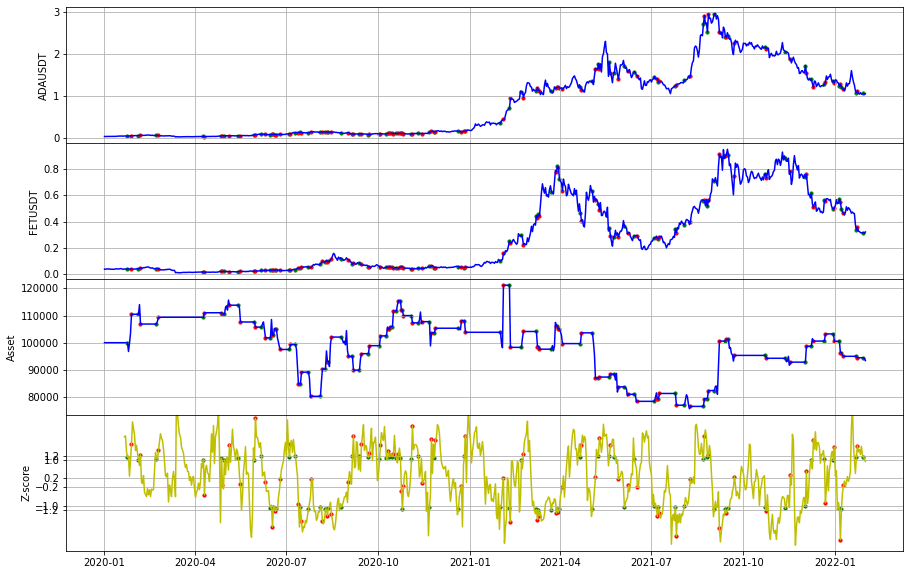

XRPUSDT_ETHUSDT 回測結果
-----------------------------XRPUSDT-ETHUSDT--------------------------
初始價格 100000
總損益:  37499.01829378
總交易次數:  46
平均損益:  815.1960498648822
勝率:  0.6304347826086957
獲利因子:  1.6117400707717335
賺賠比:  0.9448131449351543
最大資金回落:  23629.50600279594
夏普比率:  0.13917167928575347


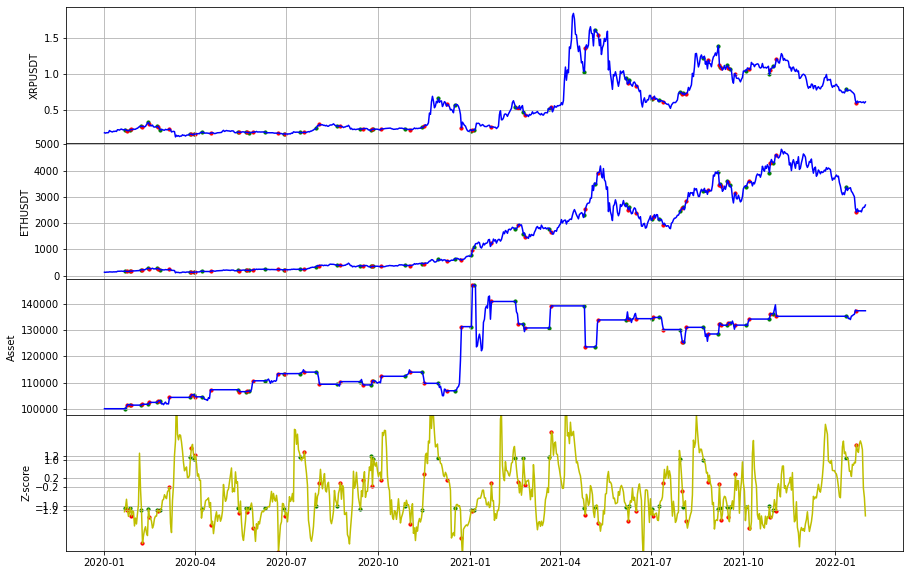

XRPUSDT_QTUMUSDT 回測結果
-----------------------------XRPUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  -65326.76235596
總交易次數:  51
平均損益:  -1280.9169089403554
勝率:  0.39215686274509803
獲利因子:  0.4388432617967691
賺賠比:  0.6802070557849921
最大資金回落:  81306.15198440573
夏普比率:  -0.1763120264910473


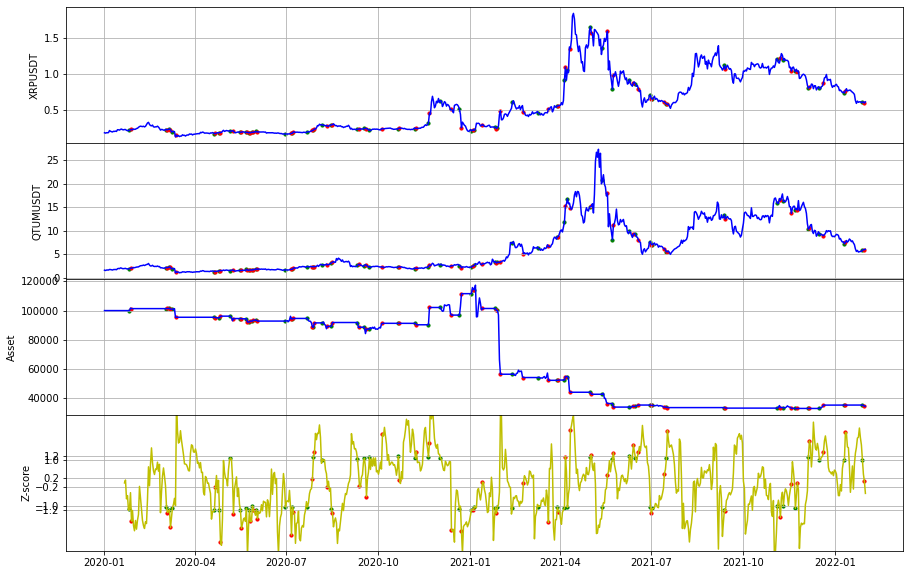

XRPUSDT_ADAUSDT 回測結果
-----------------------------XRPUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  25514.27952244
總交易次數:  51
平均損益:  500.27999063616465
勝率:  0.5294117647058824
獲利因子:  1.2266064597339552
賺賠比:  1.0903168530968492
最大資金回落:  70241.06132741821
夏普比率:  0.052877942509739054


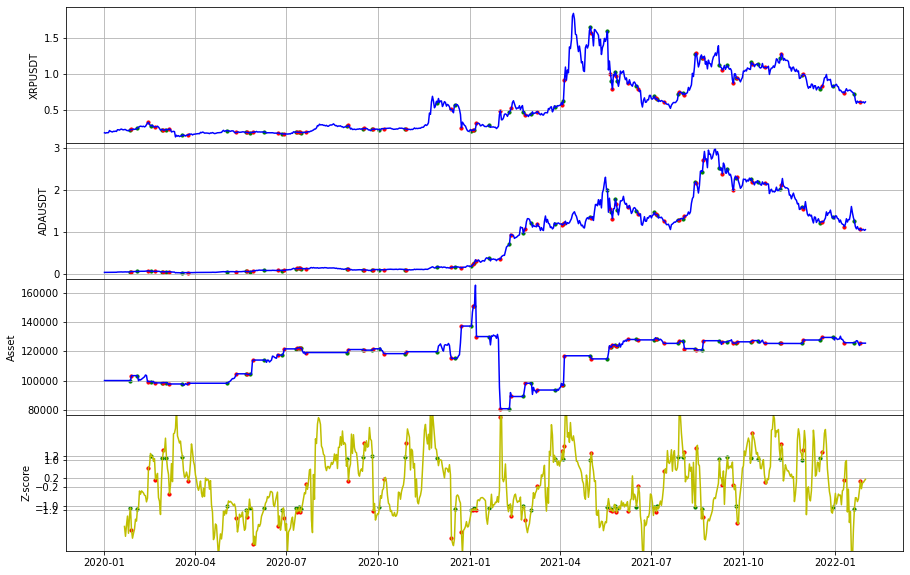

XRPUSDT_TRXUSDT 回測結果
-----------------------------XRPUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  -36131.17189001
總交易次數:  55
平均損益:  -656.9303980001109
勝率:  0.4909090909090909
獲利因子:  0.5441554078464822
賺賠比:  0.5643093118407964
最大資金回落:  46575.35661207803
夏普比率:  -0.18829286591445304


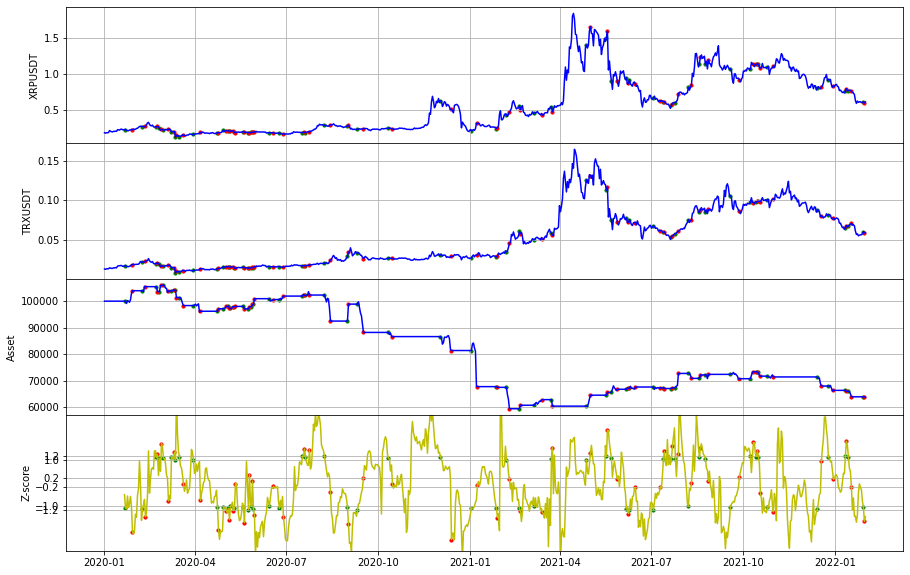

XRPUSDT_ETCUSDT 回測結果
-----------------------------XRPUSDT-ETCUSDT--------------------------
初始價格 100000
總損益:  52104.75045137
總交易次數:  53
平均損益:  983.1084990825362
勝率:  0.49056603773584906
獲利因子:  1.5111435391328298
賺賠比:  1.5692644444840924
最大資金回落:  27809.157983703306
夏普比率:  0.07986764018188418


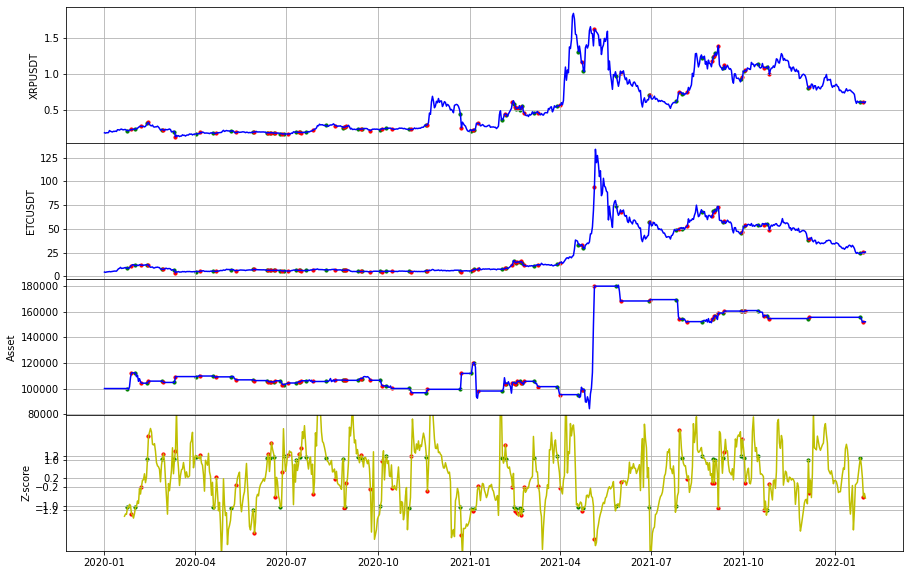

XRPUSDT_VETUSDT 回測結果
-----------------------------XRPUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -66864.86550606
總交易次數:  51
平均損益:  -1311.0757942364817
勝率:  0.39215686274509803
獲利因子:  0.23743551714223185
賺賠比:  0.36802505157045934
最大資金回落:  69482.2905869766
夏普比率:  -0.2806645490730714


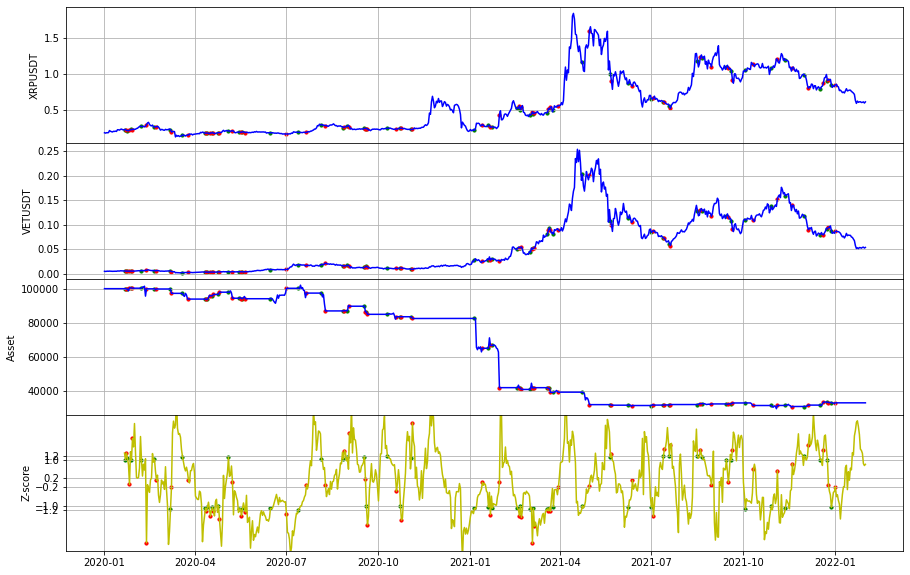

XRPUSDT_TFUELUSDT 回測結果
-----------------------------XRPUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  -48540.82217399
總交易次數:  49
平均損益:  -990.6290239589871
勝率:  0.4897959183673469
獲利因子:  0.5894271379148439
賺賠比:  0.6139866019946291
最大資金回落:  79973.18305899751
夏普比率:  -0.10516131935096235


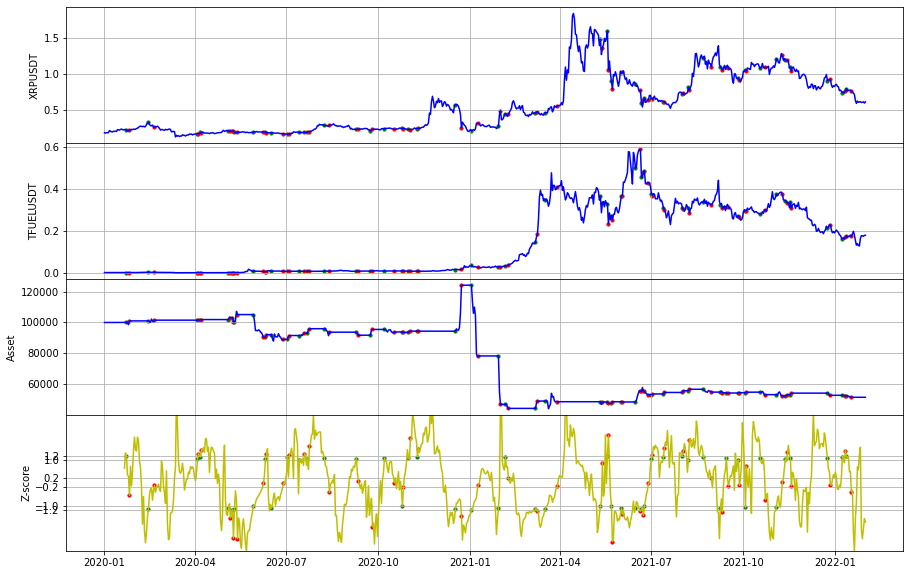

XRPUSDT_WAVESUSDT 回測結果
-----------------------------XRPUSDT-WAVESUSDT--------------------------
初始價格 100000
總損益:  -53144.70935015
總交易次數:  55
平均損益:  -966.2674427299253
勝率:  0.4
獲利因子:  0.47054631888401477
賺賠比:  0.7058194783260221
最大資金回落:  55389.43702308694
夏普比率:  -0.2048034643337645


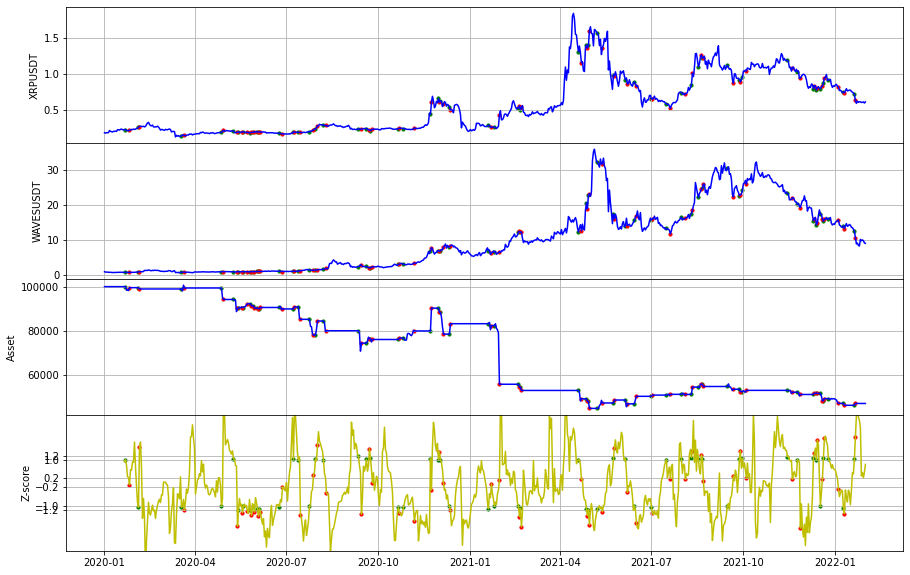

XRPUSDT_ONGUSDT 回測結果
-----------------------------XRPUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  306.11918334
總交易次數:  53
平均損益:  5.77583364785192
勝率:  0.4528301886792453
獲利因子:  1.003656792622783
賺賠比:  1.2127519577525294
最大資金回落:  31769.401603590508
夏普比率:  0.0012348090794712656


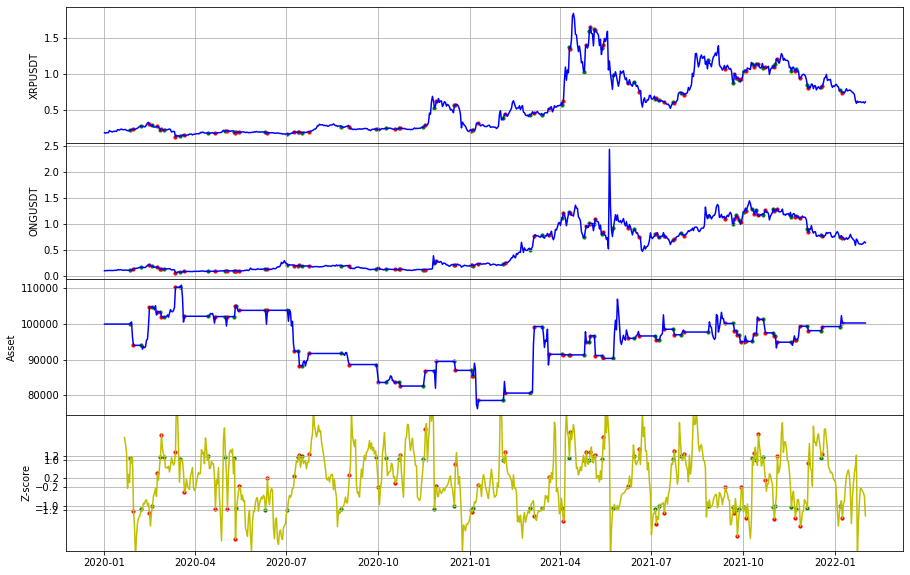

XRPUSDT_HOTUSDT 回測結果
-----------------------------XRPUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  111305.93210325
總交易次數:  45
平均損益:  2473.465157850008
勝率:  0.5333333333333333
獲利因子:  2.211239635071582
賺賠比:  1.9348346806876344
最大資金回落:  31982.551089912755
夏普比率:  0.1648645557295143


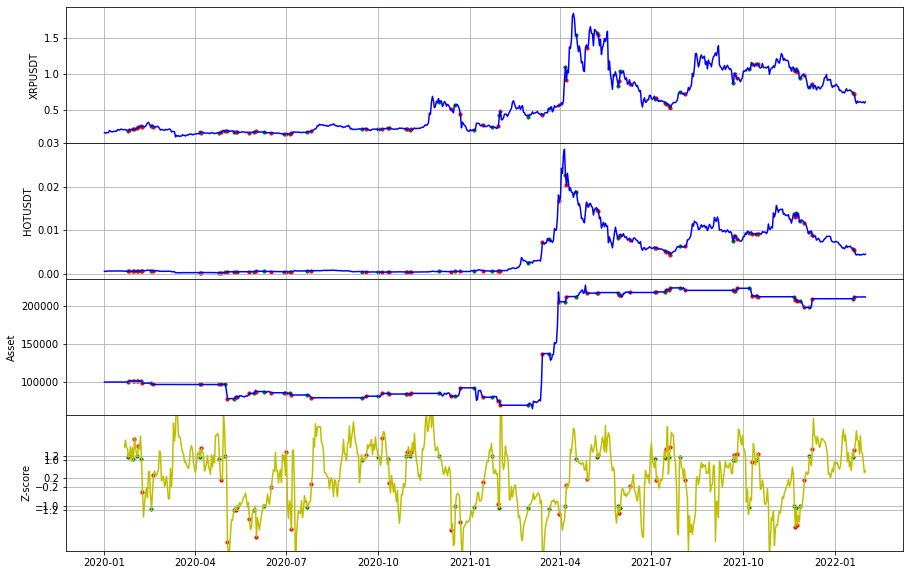

XRPUSDT_FETUSDT 回測結果
-----------------------------XRPUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  16827.31460729
總交易次數:  55
平均損益:  305.9511746779275
勝率:  0.45454545454545453
獲利因子:  1.1352893500503425
賺賠比:  1.362347220060411
最大資金回落:  47147.00005531544
夏普比率:  0.04418033131369222


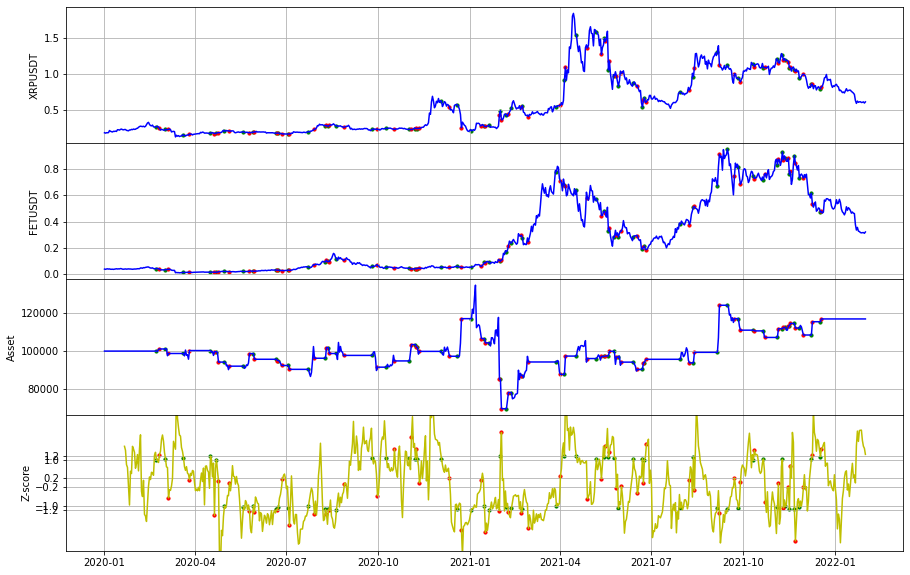

XRPUSDT_IOSTUSDT 回測結果
-----------------------------XRPUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  -1957.88206653
總交易次數:  48
平均損益:  -40.78920971941928
勝率:  0.5416666666666666
獲利因子:  0.9773880156001387
賺賠比:  0.8270206285847328
最大資金回落:  49106.63403280391
夏普比率:  -0.005287725974228536


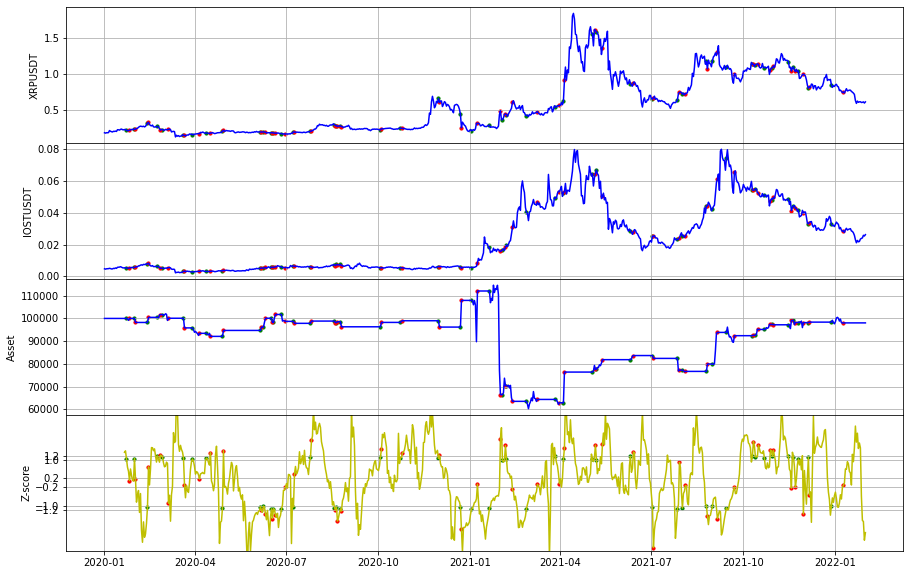

XRPUSDT_CELRUSDT 回測結果
-----------------------------XRPUSDT-CELRUSDT--------------------------
初始價格 100000
總損益:  -11951.85112982
總交易次數:  49
平均損益:  -243.91532917992672
勝率:  0.4897959183673469
獲利因子:  0.9155159815089648
賺賠比:  0.953662480738505
最大資金回落:  54801.78293238976
夏普比率:  -0.027495455339583526


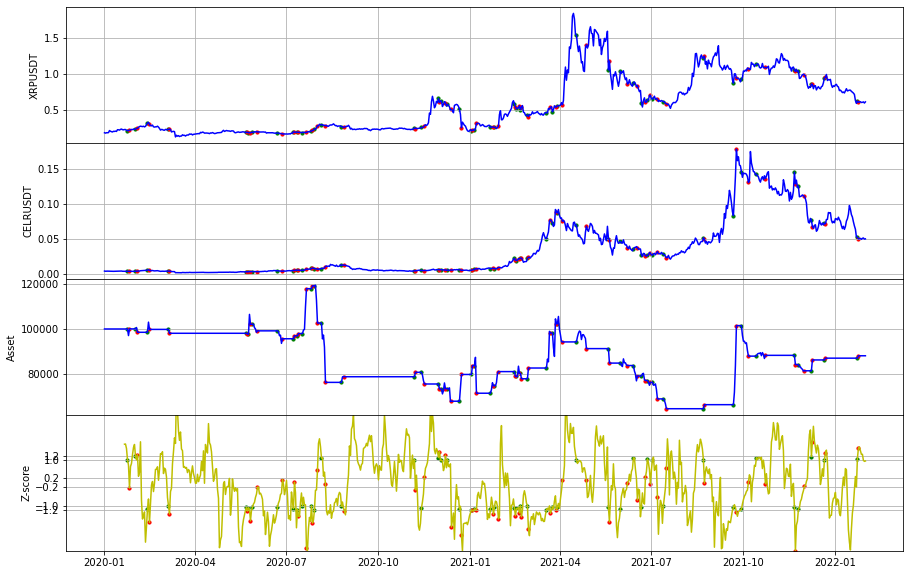

XRPUSDT_OMGUSDT 回測結果
-----------------------------XRPUSDT-OMGUSDT--------------------------
初始價格 100000
總損益:  66290.49755901
總交易次數:  43
平均損益:  1541.6394781165047
勝率:  0.5813953488372093
獲利因子:  1.7777998359245875
賺賠比:  1.280015881865703
最大資金回落:  37317.93879155643
夏普比率:  0.20138862702982274


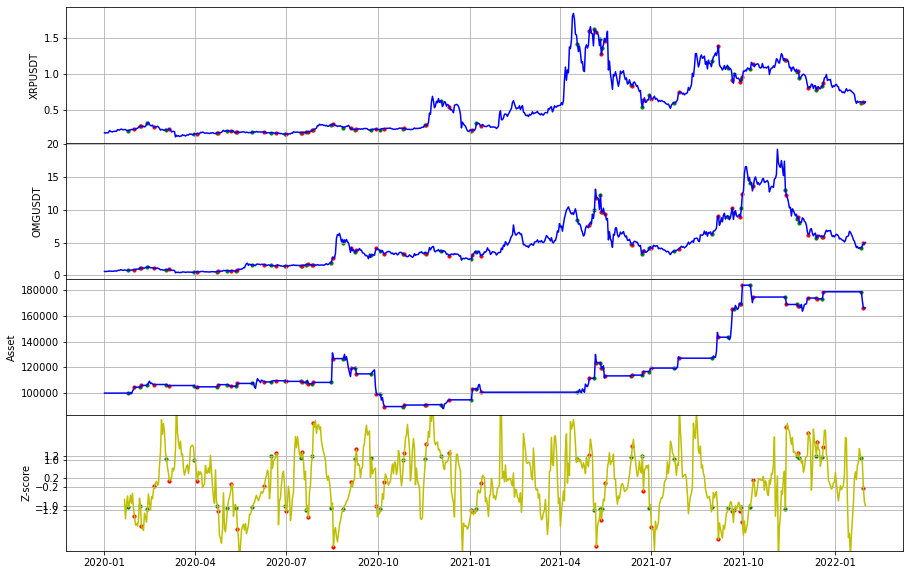

XRPUSDT_THETAUSDT 回測結果
-----------------------------XRPUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -4123.70849580
總交易次數:  56
平均損益:  -73.63765171073985
勝率:  0.48214285714285715
獲利因子:  0.9506277513566366
賺賠比:  1.0210446218274987
最大資金回落:  31291.27289363602
夏普比率:  -0.017061052593677573


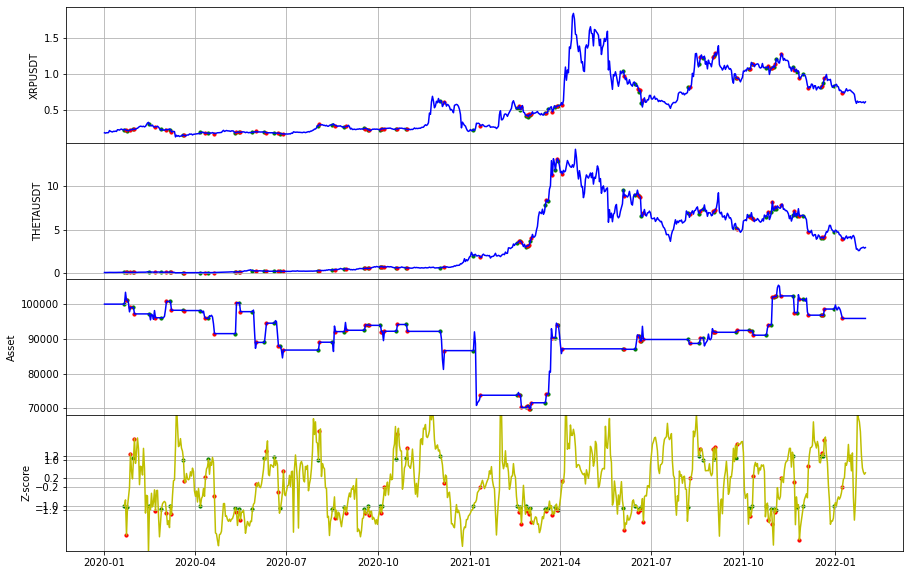

EOSUSDT_NEOUSDT 回測結果
-----------------------------EOSUSDT-NEOUSDT--------------------------
初始價格 100000
總損益:  -48915.89511730
總交易次數:  50
平均損益:  -978.3179023460679
勝率:  0.38
獲利因子:  0.3195656955824171
賺賠比:  0.5213966612134174
最大資金回落:  51688.835221366426
夏普比率:  -0.24745873619429587


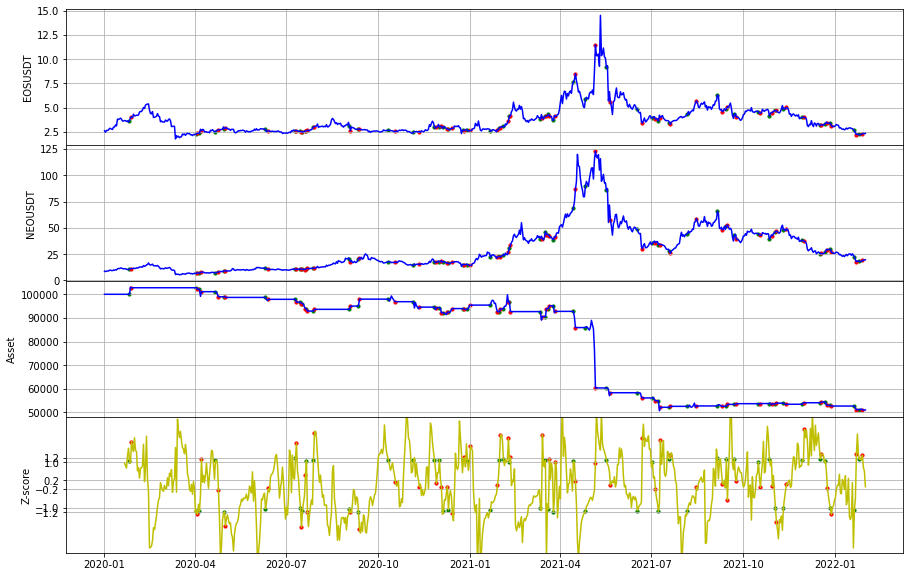

EOSUSDT_DASHUSDT 回測結果
-----------------------------EOSUSDT-DASHUSDT--------------------------
初始價格 100000
總損益:  -45392.87841963
總交易次數:  54
平均損益:  -840.6088596227272
勝率:  0.2777777777777778
獲利因子:  0.31711406341034026
賺賠比:  0.8244965648668847
最大資金回落:  47362.04662055355
夏普比率:  -0.2706608208999824


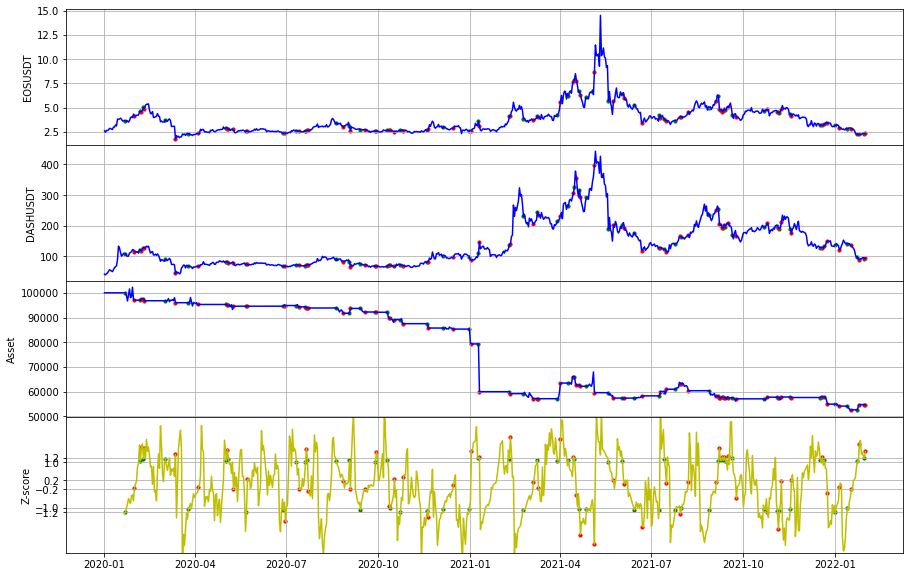

EOSUSDT_THETAUSDT 回測結果，場上有單已平倉
-----------------------------EOSUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -11477.34558890
總交易次數:  59
平均損益:  -194.531281167844
勝率:  0.4915254237288136
獲利因子:  0.9155693520225561
賺賠比:  0.947140708988851
最大資金回落:  55939.70855321745
夏普比率:  -0.025961367217290584


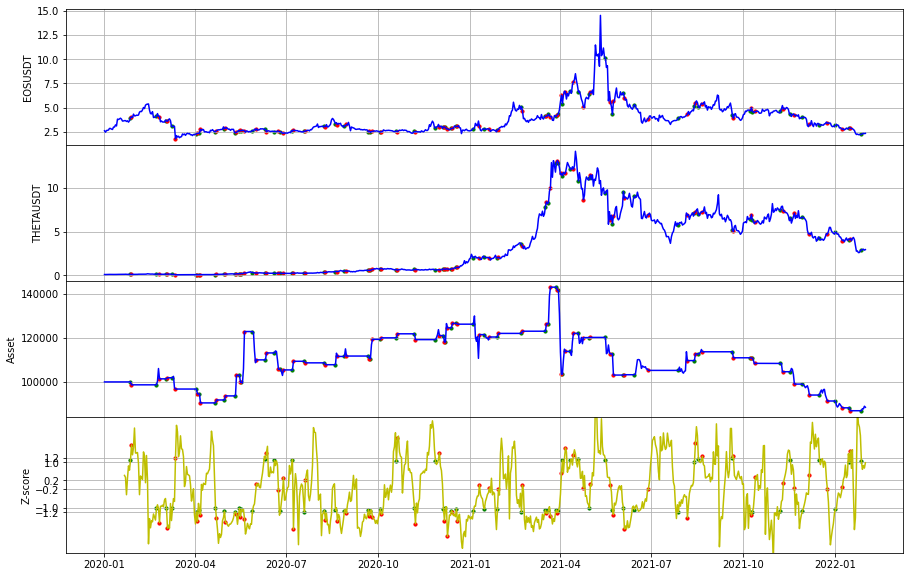

EOSUSDT_MITHUSDT 回測結果
-----------------------------EOSUSDT-MITHUSDT--------------------------
初始價格 100000
總損益:  -41742.68751623
總交易次數:  52
平均損益:  -802.7439906966572
勝率:  0.46153846153846156
獲利因子:  0.6887137226894499
賺賠比:  0.8034993431376916
最大資金回落:  68148.09144812934
夏普比率:  -0.13091073678679013


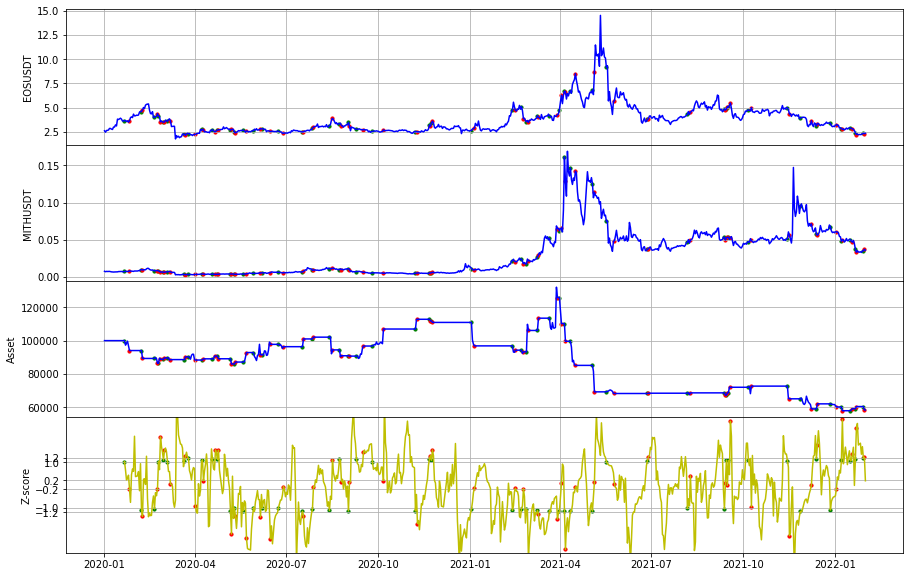

ONEUSDT_ETHUSDT 回測結果
-----------------------------ONEUSDT-ETHUSDT--------------------------
初始價格 100000
總損益:  35775.63576835
總交易次數:  52
平均損益:  687.9929955452579
勝率:  0.4807692307692308
獲利因子:  1.3057190190948151
賺賠比:  1.4101765406224005
最大資金回落:  19794.925539414136
夏普比率:  0.0886825747955252


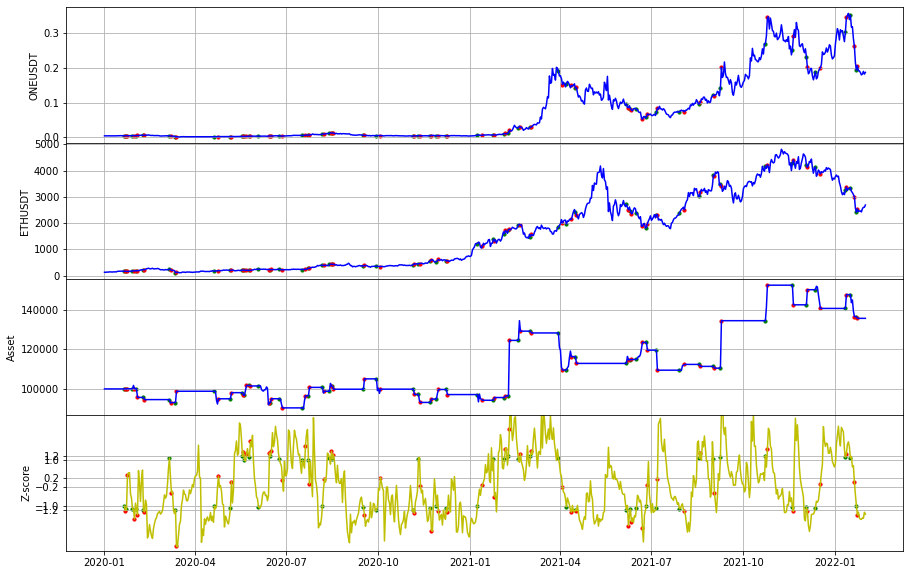

ONEUSDT_BNBUSDT 回測結果，場上有單已平倉
-----------------------------ONEUSDT-BNBUSDT--------------------------
初始價格 100000
總損益:  63777.07479343
總交易次數:  58
平均損益:  1099.6047378177589
勝率:  0.603448275862069
獲利因子:  1.3386709279615698
賺賠比:  0.8796980383747459
最大資金回落:  45070.51427224107
夏普比率:  0.10616099635657972


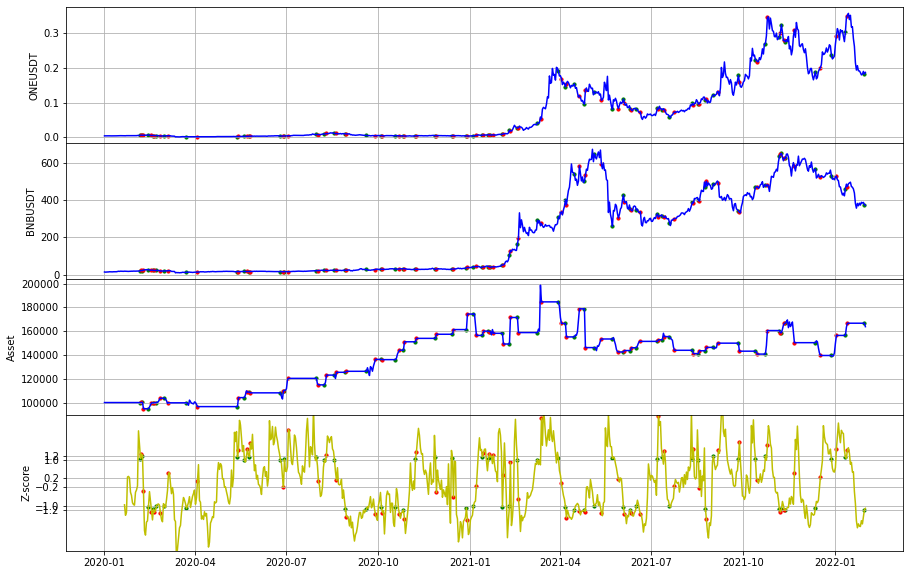

ONEUSDT_CELRUSDT 回測結果
-----------------------------ONEUSDT-CELRUSDT--------------------------
初始價格 100000
總損益:  17423.38911676
總交易次數:  55
平均損益:  316.78889303196706
勝率:  0.5818181818181818
獲利因子:  1.2098603817122187
賺賠比:  0.8695871493556573
最大資金回落:  28752.63583040872
夏普比率:  0.07289748347681796


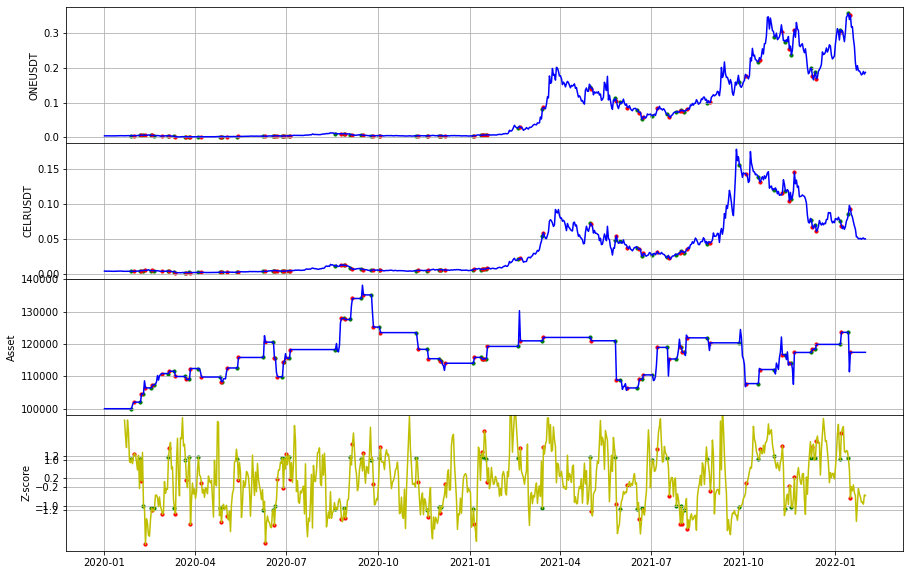

ONEUSDT_MATICUSDT 回測結果
-----------------------------ONEUSDT-MATICUSDT--------------------------
初始價格 100000
總損益:  -42447.86251411
總交易次數:  55
平均損益:  -771.7793184383987
勝率:  0.38181818181818183
獲利因子:  0.652392925408867
賺賠比:  1.0562552125667368
最大資金回落:  49090.09233989852
夏普比率:  -0.1373869522902832


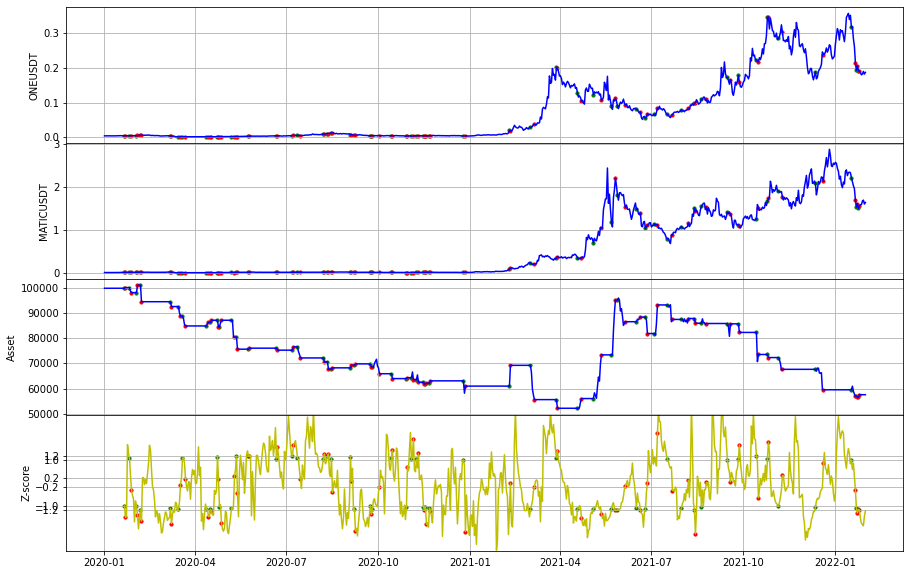

ONEUSDT_ATOMUSDT 回測結果，場上有單已平倉
-----------------------------ONEUSDT-ATOMUSDT--------------------------
初始價格 100000
總損益:  -38863.66227598
總交易次數:  68
平均損益:  -571.5244452349924
勝率:  0.47058823529411764
獲利因子:  0.6949121866041704
賺賠比:  0.7817762099296918
最大資金回落:  52842.685825324035
夏普比率:  -0.1269883578617705


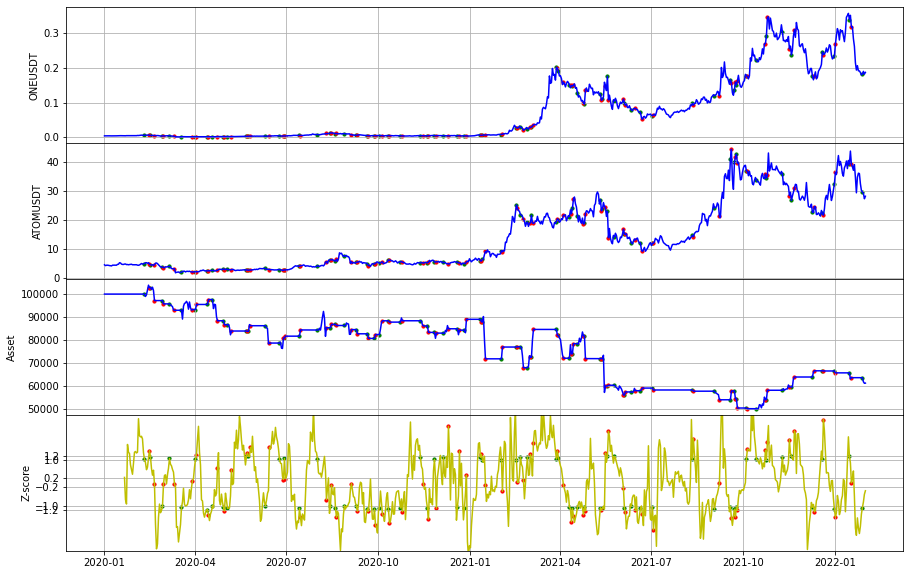

IOTAUSDT_LTCUSDT 回測結果
-----------------------------IOTAUSDT-LTCUSDT--------------------------
初始價格 100000
總損益:  5257.52182866
總交易次數:  45
平均損益:  116.8338184146217
勝率:  0.4888888888888889
獲利因子:  1.088403624766912
賺賠比:  1.1378765168017715
最大資金回落:  41449.255549955444
夏普比率:  0.031235466784616844


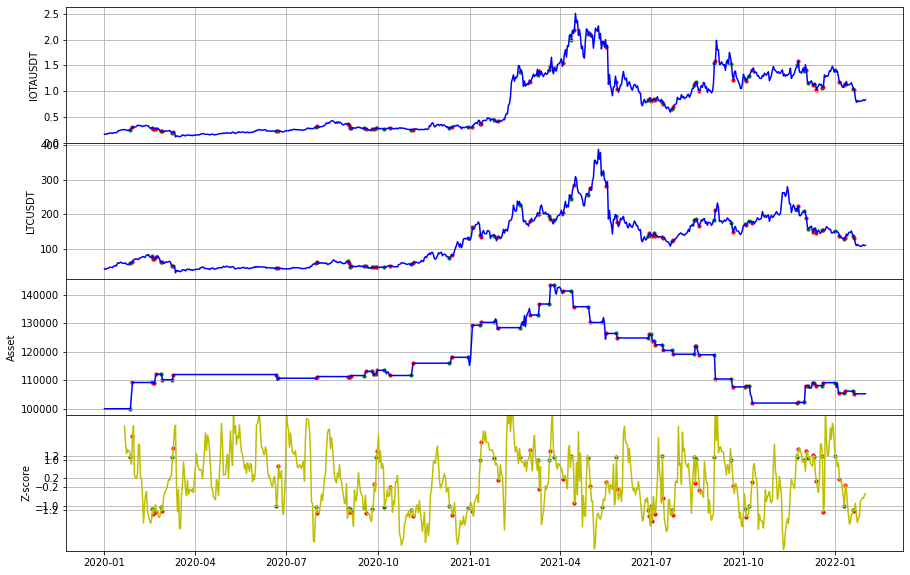

IOTAUSDT_TFUELUSDT 回測結果
-----------------------------IOTAUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  103642.60469349
總交易次數:  60
平均損益:  1727.3767448915469
勝率:  0.55
獲利因子:  1.7875765539345683
賺賠比:  1.4625626350373742
最大資金回落:  34563.7966914194
夏普比率:  0.20630293934064936


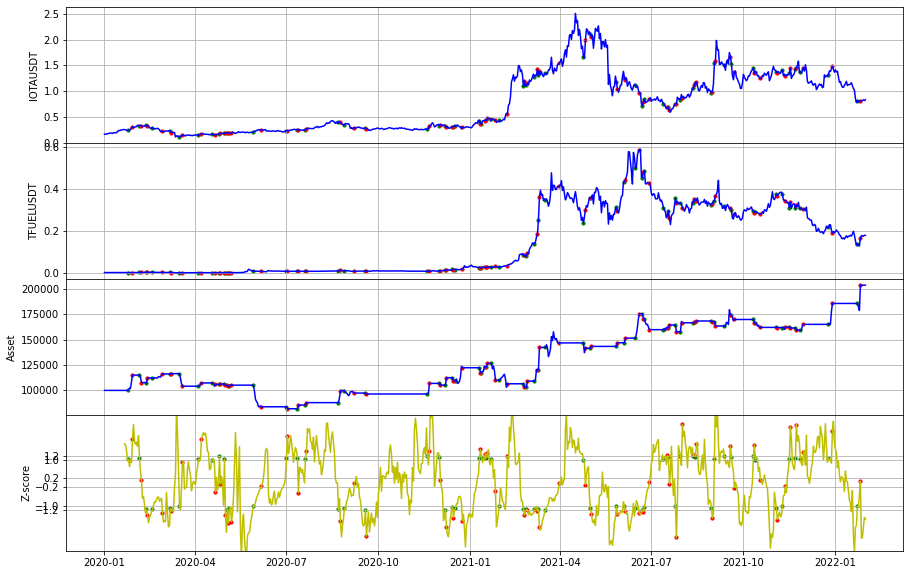

IOTAUSDT_ONGUSDT 回測結果，場上有單已平倉
-----------------------------IOTAUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -44815.49798167
總交易次數:  49
平均損益:  -914.6019996258906
勝率:  0.42857142857142855
獲利因子:  0.5278564785602088
賺賠比:  0.7038086380802784
最大資金回落:  54297.99035454083
夏普比率:  -0.21311551870143264


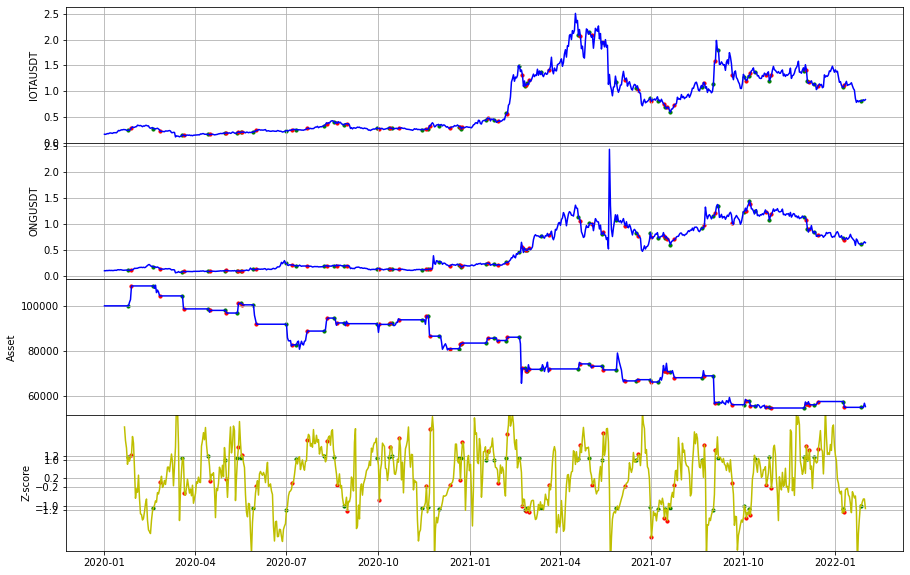

IOTAUSDT_HOTUSDT 回測結果
-----------------------------IOTAUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  -15984.11218981
總交易次數:  41
平均損益:  -389.85639487345355
勝率:  0.4146341463414634
獲利因子:  0.8675454620871933
賺賠比:  1.2247700641230963
最大資金回落:  55986.395844062325
夏普比率:  -0.04036810878714637


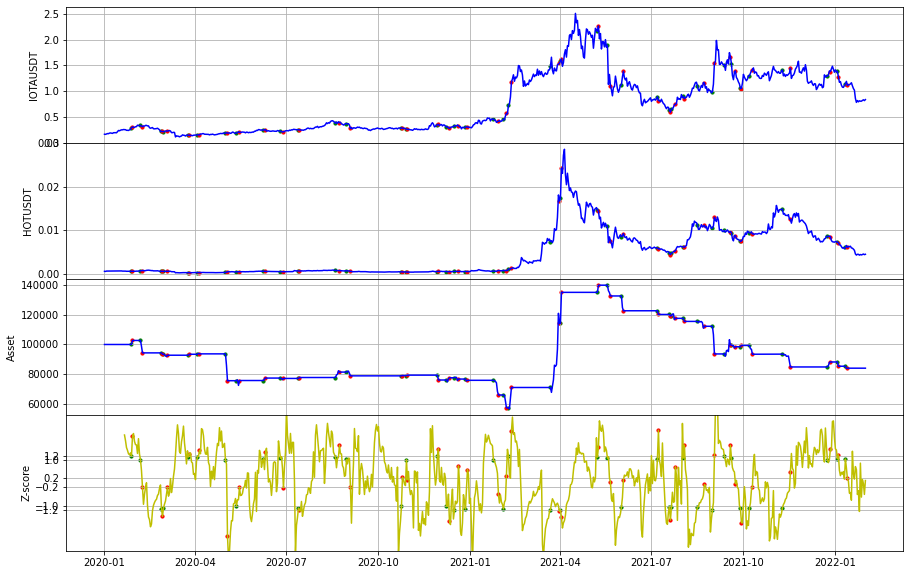

IOTAUSDT_XMRUSDT 回測結果
-----------------------------IOTAUSDT-XMRUSDT--------------------------
初始價格 100000
總損益:  -24197.37010311
總交易次數:  50
平均損益:  -483.9474020622176
勝率:  0.48
獲利因子:  0.73392180517981
賺賠比:  0.7950819556114608
最大資金回落:  46387.21004644096
夏普比率:  -0.09341797238710144


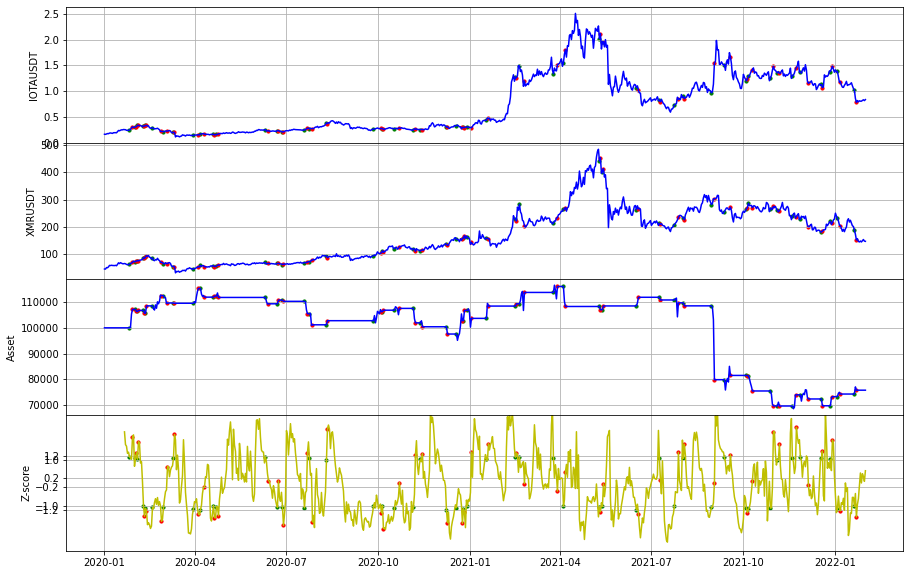

IOTAUSDT_THETAUSDT 回測結果
-----------------------------IOTAUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  9770.75593318
總交易次數:  63
平均損益:  155.09136401868005
勝率:  0.5238095238095238
獲利因子:  1.0816479022966354
賺賠比:  0.9833162748151233
最大資金回落:  56313.70919096698
夏普比率:  0.027291027531209346


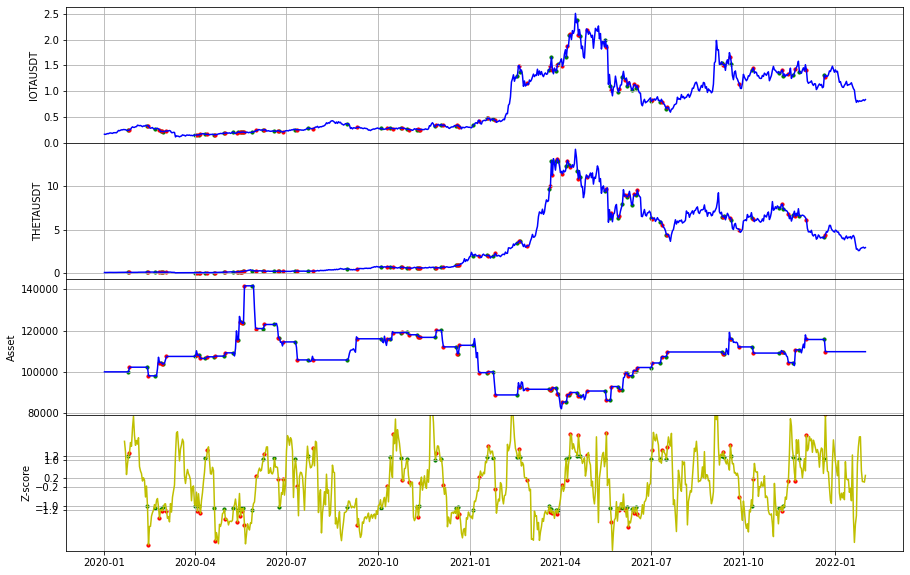

IOTAUSDT_MITHUSDT 回測結果
-----------------------------IOTAUSDT-MITHUSDT--------------------------
初始價格 100000
總損益:  -86796.17104080
總交易次數:  49
平均損益:  -1771.350429404159
勝率:  0.4897959183673469
獲利因子:  0.6682421000339298
賺賠比:  0.6960855208686769
最大資金回落:  187587.75322436058
夏普比率:  -0.07157629576550426


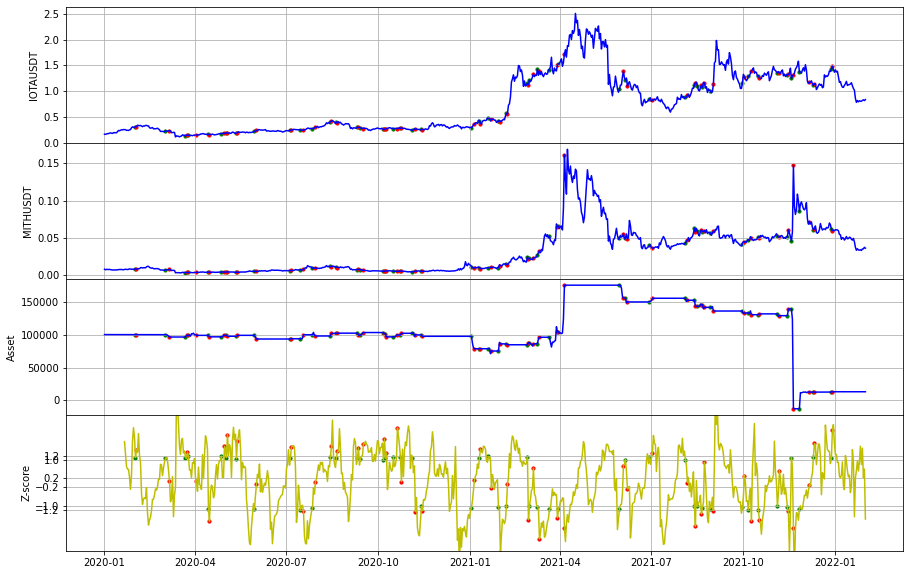

XLMUSDT_LTCUSDT 回測結果
-----------------------------XLMUSDT-LTCUSDT--------------------------
初始價格 100000
總損益:  2112.53161279
總交易次數:  55
平均損益:  38.40966568718008
勝率:  0.4909090909090909
獲利因子:  1.0371911627191561
賺賠比:  1.075605650227273
最大資金回落:  19685.23073058194
夏普比率:  0.01342552275549163


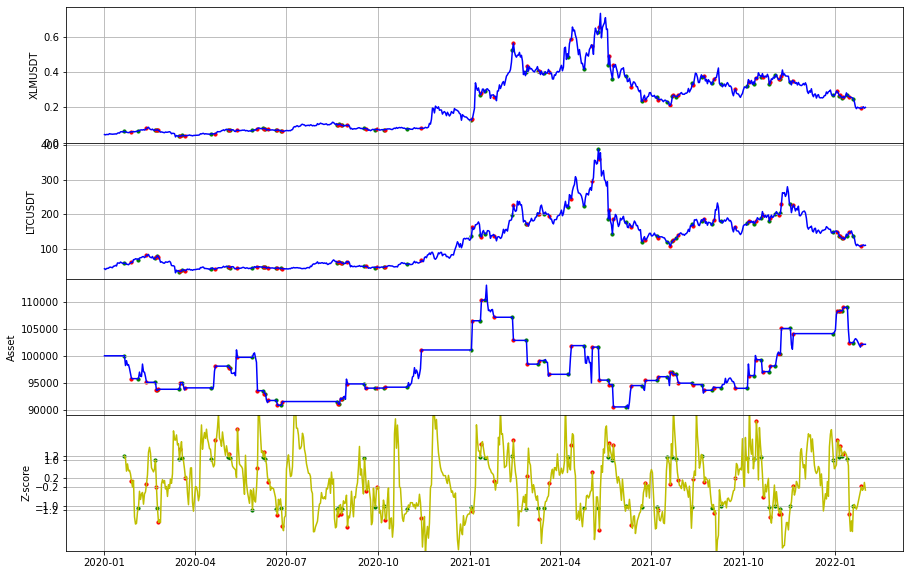

XLMUSDT_ICXUSDT 回測結果
-----------------------------XLMUSDT-ICXUSDT--------------------------
初始價格 100000
總損益:  -29802.81918130
總交易次數:  44
平均損益:  -677.336799574949
勝率:  0.5
獲利因子:  0.6278812242616933
賺賠比:  0.6278812242616932
最大資金回落:  38862.2284996423
夏普比率:  -0.14851215092914033


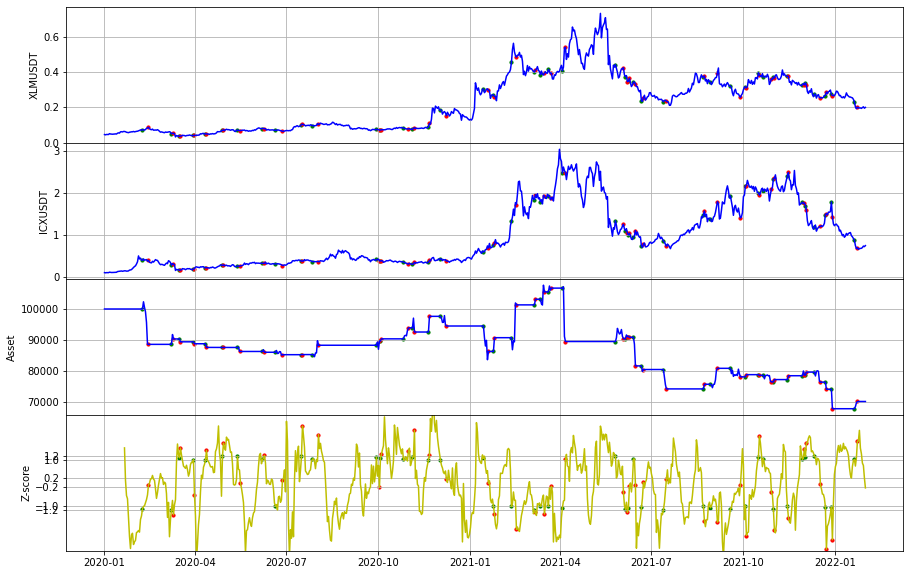

XLMUSDT_ZILUSDT 回測結果
-----------------------------XLMUSDT-ZILUSDT--------------------------
初始價格 100000
總損益:  -74446.11582675
總交易次數:  50
平均損益:  -1488.9223165350172
勝率:  0.5
獲利因子:  0.5436270814401453
賺賠比:  0.5436270814401453
最大資金回落:  119788.93030290508
夏普比率:  -0.09100708172186853


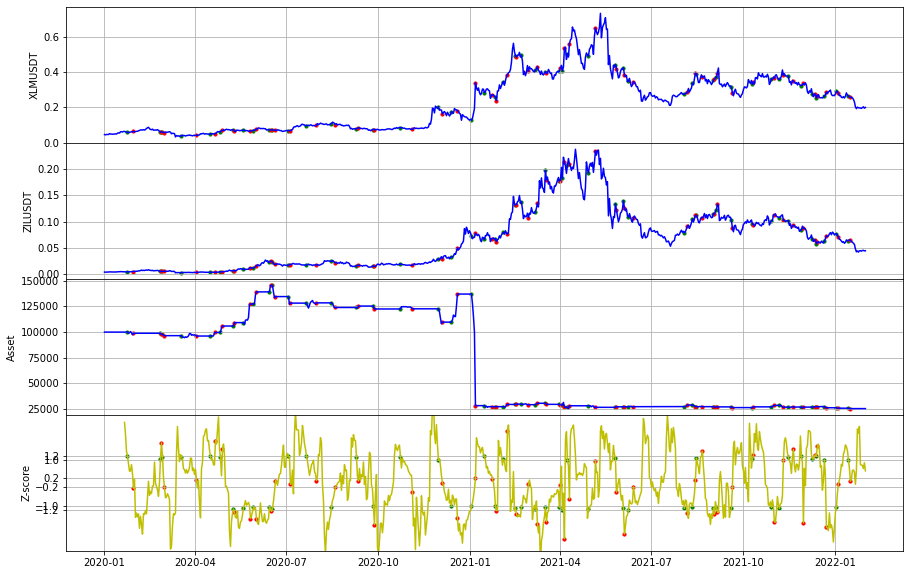

XLMUSDT_ZRXUSDT 回測結果
-----------------------------XLMUSDT-ZRXUSDT--------------------------
初始價格 100000
總損益:  95577.79514568
總交易次數:  54
平均損益:  1769.959169364378
勝率:  0.5370370370370371
獲利因子:  1.9186153985047156
賺賠比:  1.65397879181441
最大資金回落:  19105.1636137506
夏普比率:  0.22115246314027157


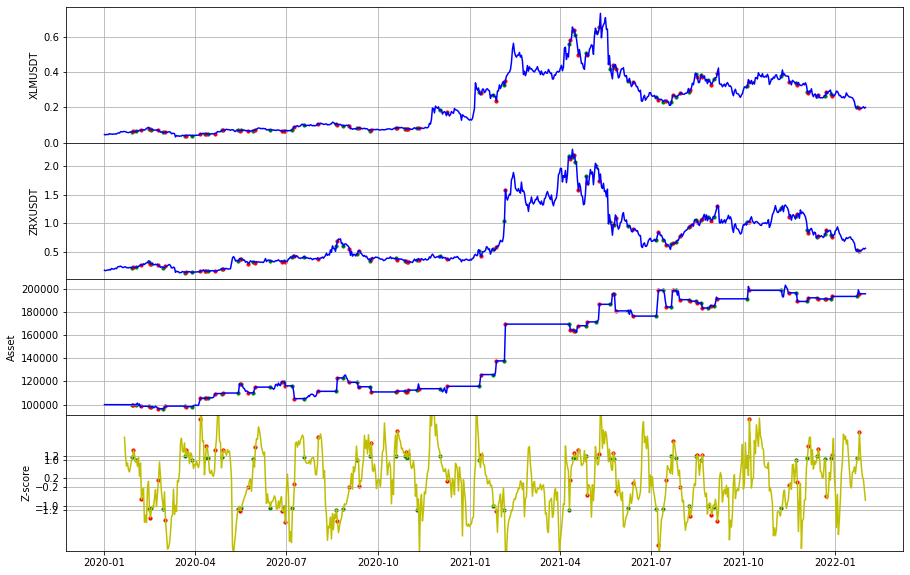

XLMUSDT_XMRUSDT 回測結果
-----------------------------XLMUSDT-XMRUSDT--------------------------
初始價格 100000
總損益:  5388.19743385
總交易次數:  56
平均損益:  96.21781131875936
勝率:  0.48214285714285715
獲利因子:  1.0691129767924632
賺賠比:  1.148306530628942
最大資金回落:  30652.24223527749
夏普比率:  0.024293074377622476


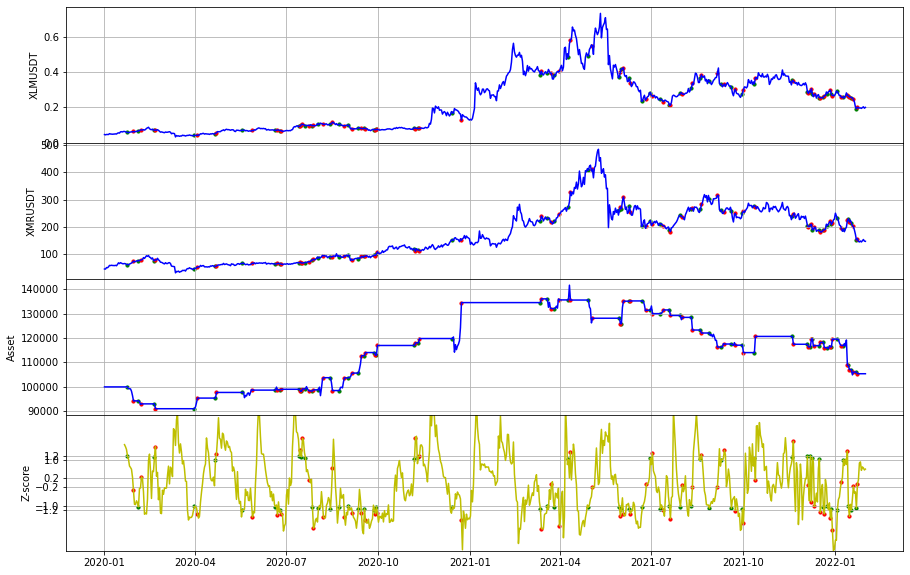

XLMUSDT_IOSTUSDT 回測結果
-----------------------------XLMUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  46545.46720572
總交易次數:  54
平均損益:  861.9530964022194
勝率:  0.48148148148148145
獲利因子:  1.5254199222308262
賺賠比:  1.6427599162485822
最大資金回落:  35154.813366865594
夏普比率:  0.11621668616230925


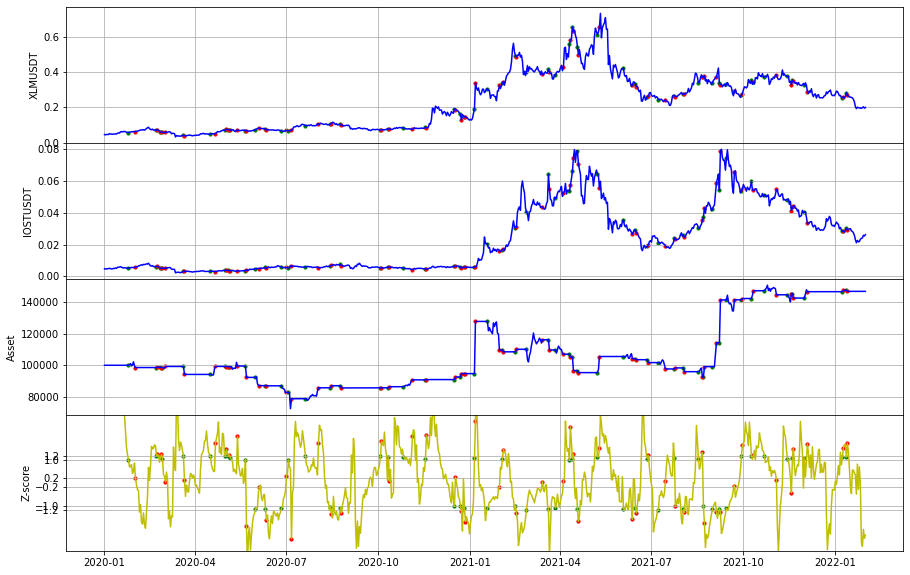

ONTUSDT_NEOUSDT 回測結果
-----------------------------ONTUSDT-NEOUSDT--------------------------
初始價格 100000
總損益:  -11906.68968754
總交易次數:  57
平均損益:  -208.88929276389229
勝率:  0.47368421052631576
獲利因子:  0.7215138821773389
賺賠比:  0.8016820913081543
最大資金回落:  16658.671283390286
夏普比率:  -0.10541592029300326


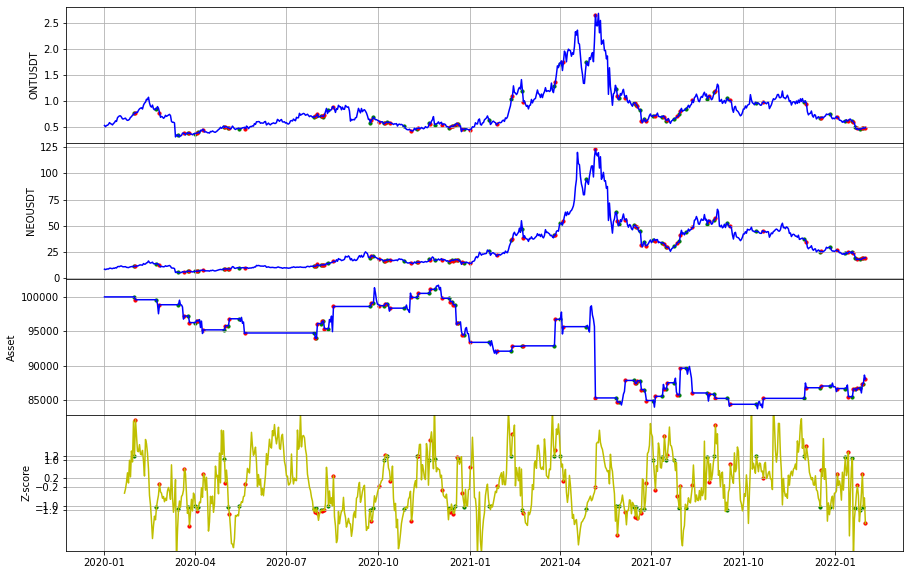

ONTUSDT_THETAUSDT 回測結果
-----------------------------ONTUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  65044.54495506
總交易次數:  65
平均損益:  1000.6853070009527
勝率:  0.5692307692307692
獲利因子:  1.5085036832391898
賺賠比:  1.1415703548837113
最大資金回落:  22023.981450102263
夏普比率:  0.1444288689770321


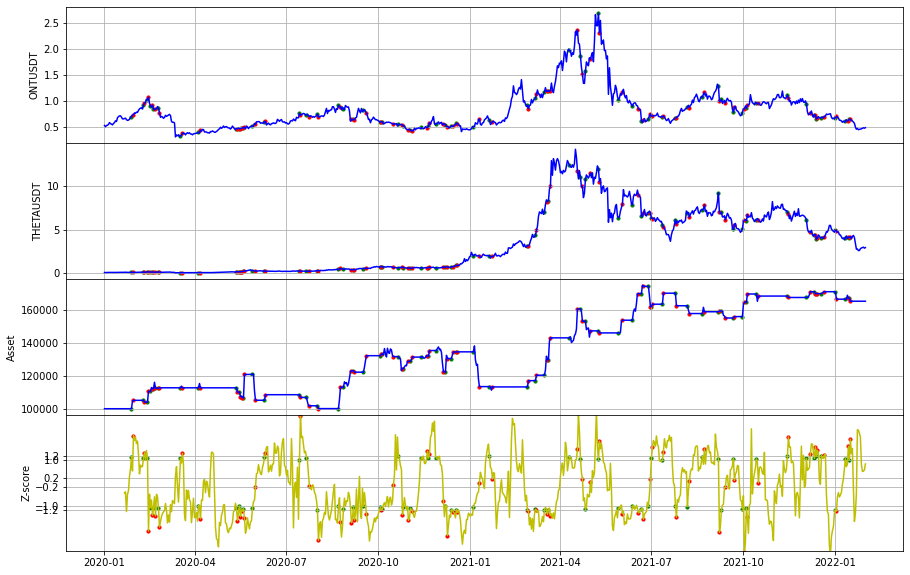

TRXUSDT_QTUMUSDT 回測結果，場上有單已平倉
-----------------------------TRXUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  -6008.57447263
總交易次數:  50
平均損益:  -120.17148945251596
勝率:  0.36
獲利因子:  0.9145751599020983
賺賠比:  1.625911395381508
最大資金回落:  20053.707318559784
夏普比率:  -0.027968121272834344


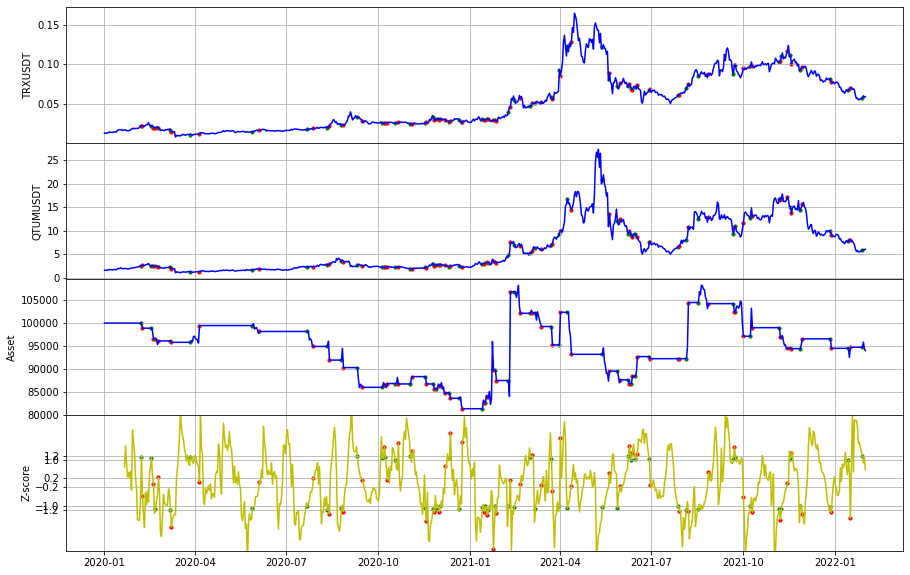

TRXUSDT_ADAUSDT 回測結果
-----------------------------TRXUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  43373.40669472
總交易次數:  54
平均損益:  803.211235087463
勝率:  0.5740740740740741
獲利因子:  1.380483148650607
賺賠比:  1.0242294328698052
最大資金回落:  37856.577551286086
夏普比率:  0.10642353492237072


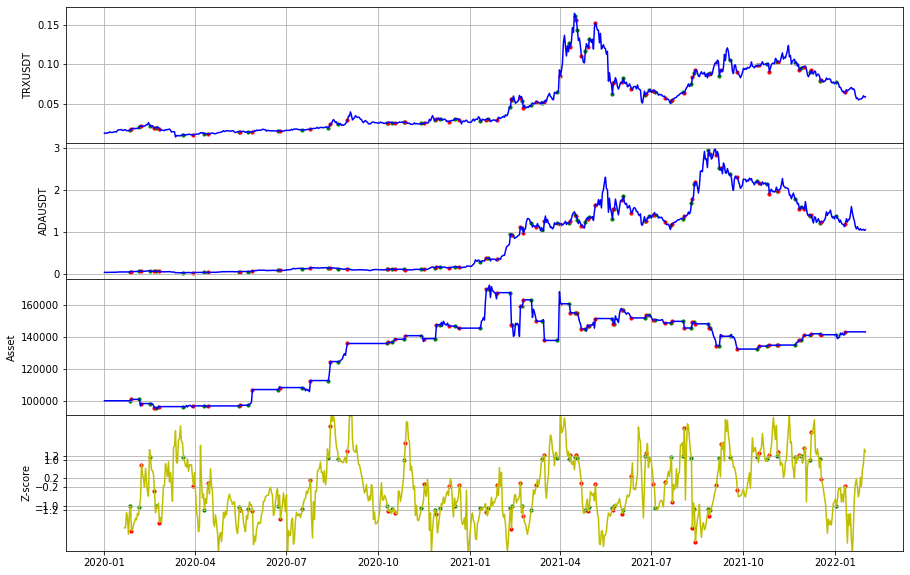

TRXUSDT_XRPUSDT 回測結果
-----------------------------TRXUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  -17992.22074039
總交易次數:  53
平均損益:  -339.4758630261747
勝率:  0.5283018867924528
獲利因子:  0.7585336305684355
賺賠比:  0.6772621701503887
最大資金回落:  27252.552937139306
夏普比率:  -0.09079536191541283


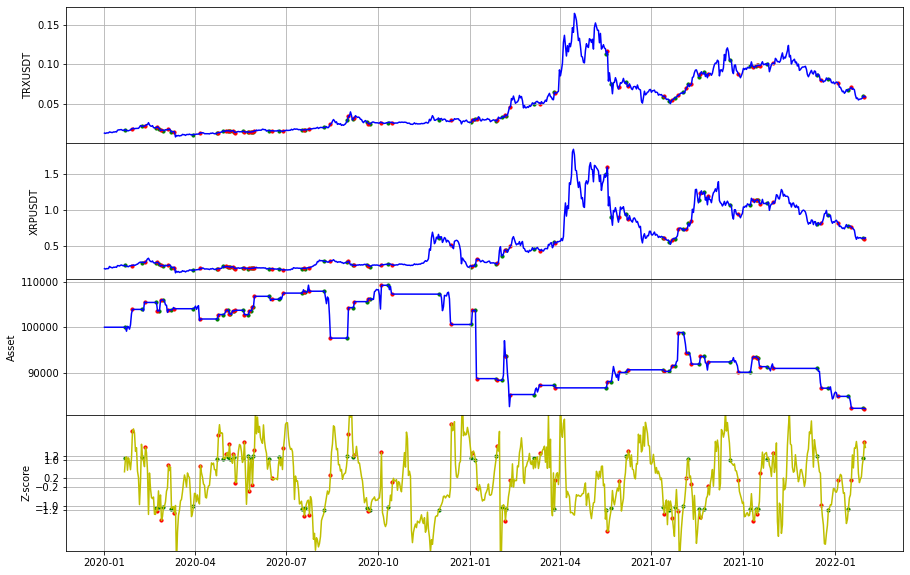

TRXUSDT_ETCUSDT 回測結果，場上有單已平倉
-----------------------------TRXUSDT-ETCUSDT--------------------------
初始價格 100000
總損益:  64995.01646222
總交易次數:  49
平均損益:  1326.428907392246
勝率:  0.4489795918367347
獲利因子:  1.9674021357766494
賺賠比:  2.3251116150087676
最大資金回落:  20864.17748416704
夏普比率:  0.14701175707710865


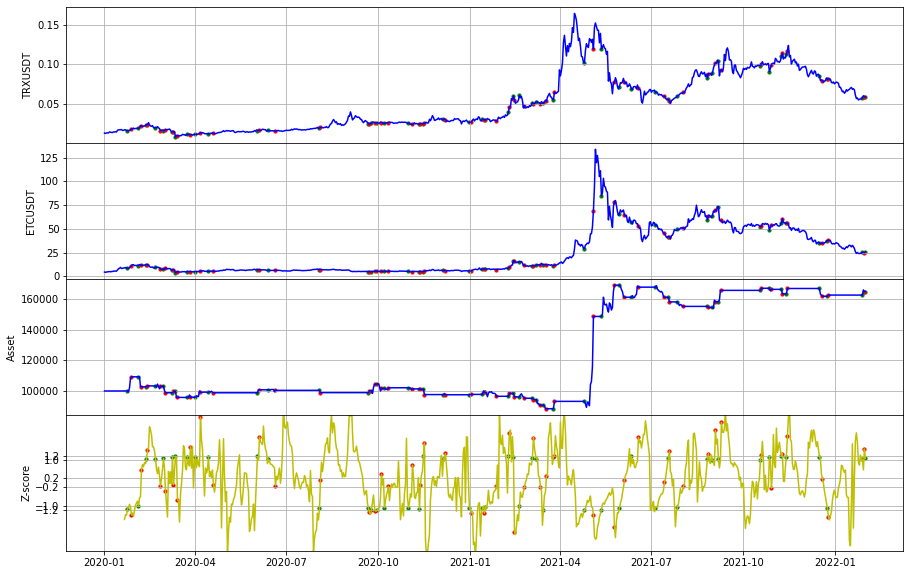

TRXUSDT_VETUSDT 回測結果
-----------------------------TRXUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -52616.92230207
總交易次數:  61
平均損益:  -862.5724967552072
勝率:  0.39344262295081966
獲利因子:  0.4074262871939408
賺賠比:  0.6281155260906587
最大資金回落:  63129.67093878312
夏普比率:  -0.3096800442573079


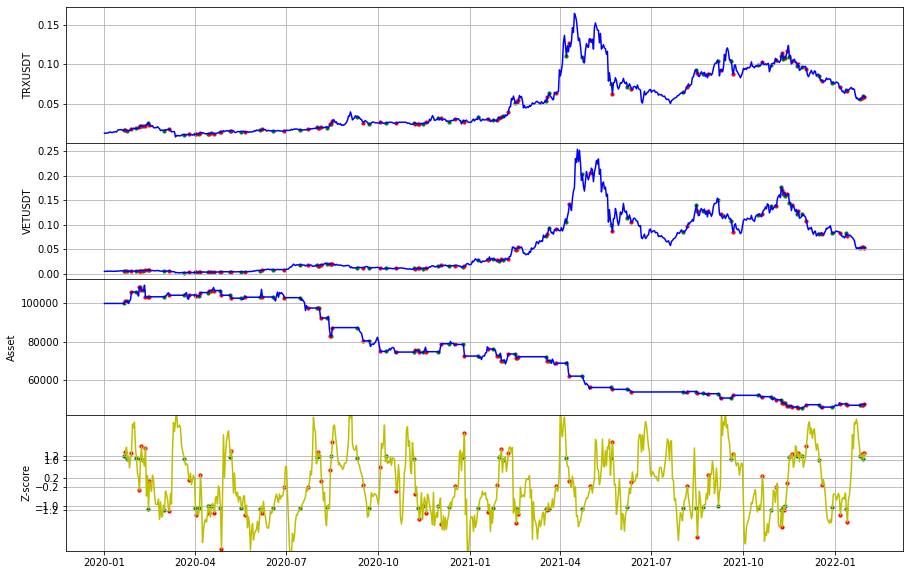

TRXUSDT_TFUELUSDT 回測結果
-----------------------------TRXUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  424.93113146
總交易次數:  50
平均損益:  8.498622629114543
勝率:  0.6
獲利因子:  1.004499267340134
賺賠比:  0.669666178226756
最大資金回落:  43703.67041167215
夏普比率:  0.00151832167633157


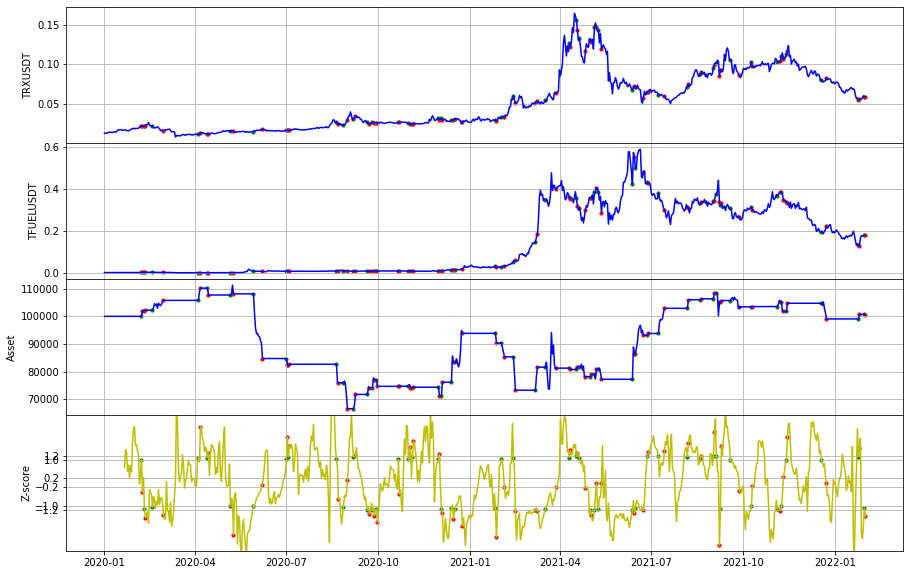

TRXUSDT_WAVESUSDT 回測結果
-----------------------------TRXUSDT-WAVESUSDT--------------------------
初始價格 100000
總損益:  6515.98980829
總交易次數:  48
平均損益:  135.74978767264292
勝率:  0.5208333333333334
獲利因子:  1.104957646786813
賺賠比:  1.0165610350438679
最大資金回落:  27327.210686793827
夏普比率:  0.03509031191184631


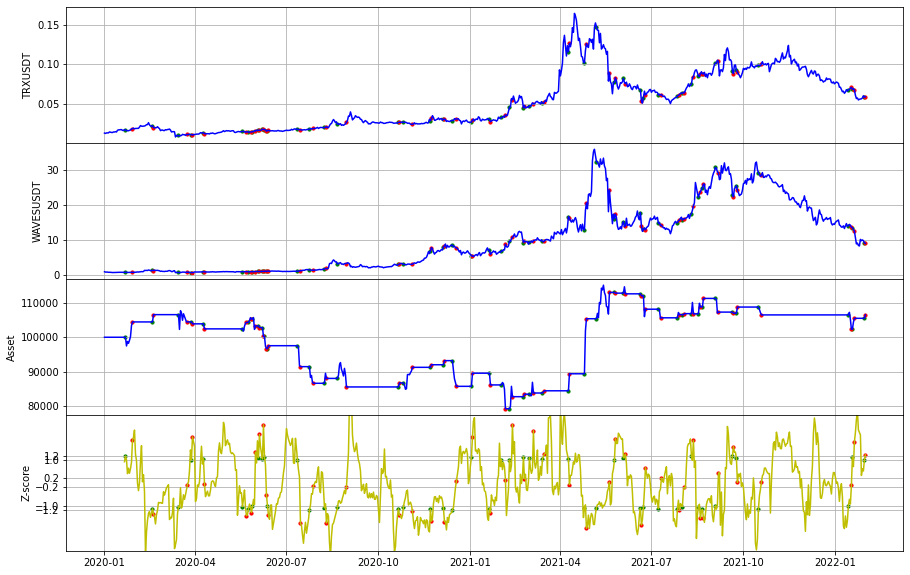

TRXUSDT_ONGUSDT 回測結果
-----------------------------TRXUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -32724.62220070
總交易次數:  53
平均損益:  -617.445701900039
勝率:  0.37735849056603776
獲利因子:  0.6737684057999116
賺賠比:  1.111717869569854
最大資金回落:  46043.62039220081
夏普比率:  -0.11475425218885077


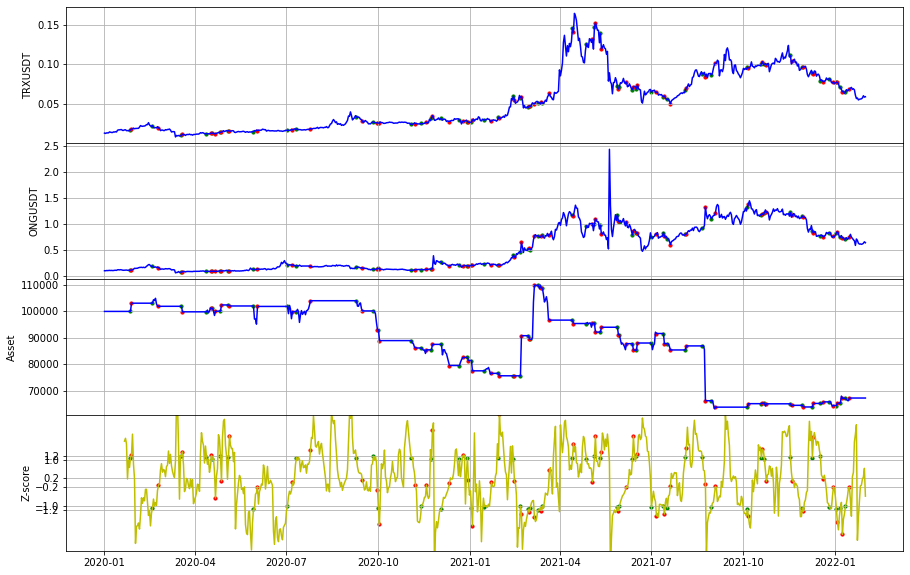

TRXUSDT_HOTUSDT 回測結果，場上有單已平倉
-----------------------------TRXUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  33956.41005881
總交易次數:  56
平均損益:  606.3644653358559
勝率:  0.5178571428571429
獲利因子:  1.2860645571311207
賺賠比:  1.153023396048591
最大資金回落:  54655.32712128441
夏普比率:  0.06455795317415652


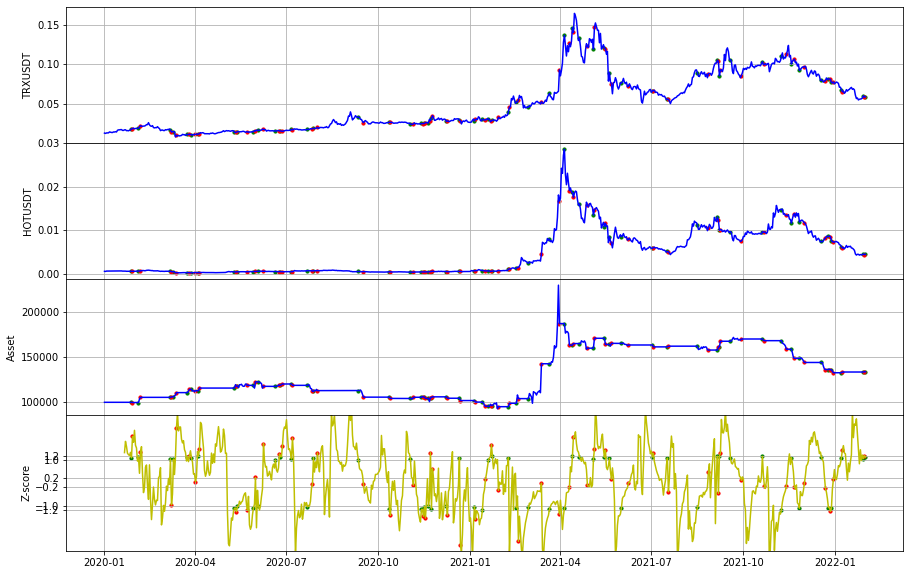

TRXUSDT_FETUSDT 回測結果
-----------------------------TRXUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  -29024.42318259
總交易次數:  59
平均損益:  -491.93937597610255
勝率:  0.4745762711864407
獲利因子:  0.8032102955697515
賺賠比:  0.8892685415236534
最大資金回落:  63344.232886317506
夏普比率:  -0.06997347948581549


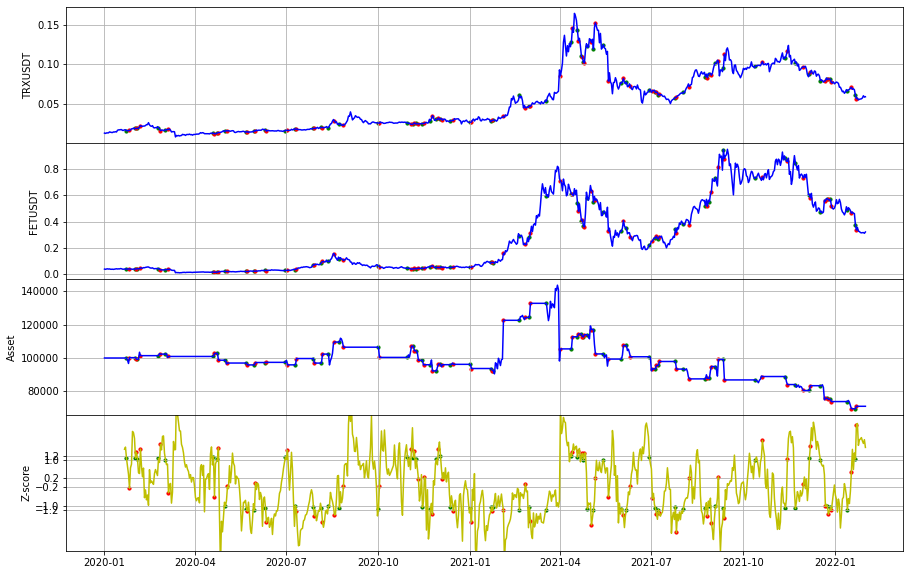

TRXUSDT_THETAUSDT 回測結果，場上有單已平倉
-----------------------------TRXUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -31016.63591747
總交易次數:  57
平均損益:  -544.1515073239685
勝率:  0.43859649122807015
獲利因子:  0.7158907452481175
賺賠比:  0.9163401539175903
最大資金回落:  49453.8522470516
夏普比率:  -0.1210344817712013


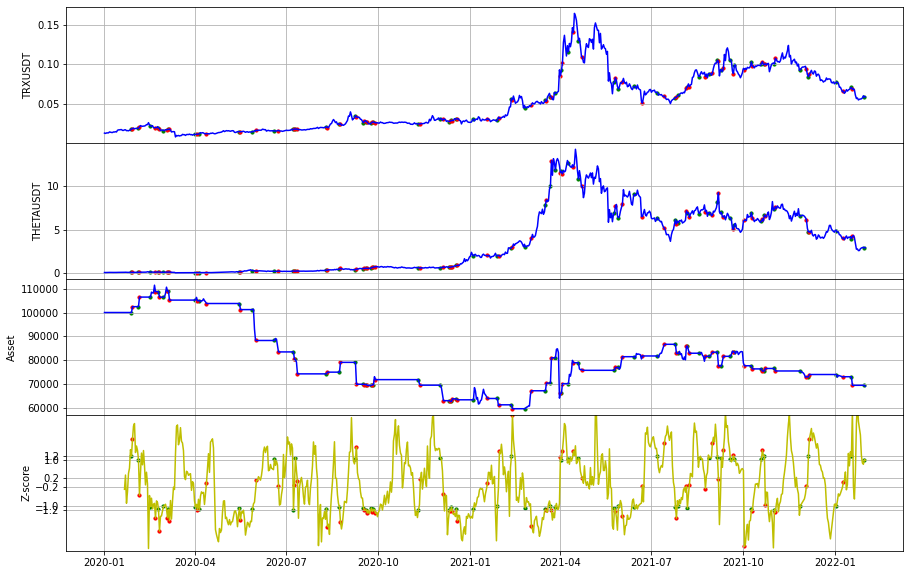

TRXUSDT_ENJUSDT 回測結果
-----------------------------TRXUSDT-ENJUSDT--------------------------
初始價格 100000
總損益:  -47266.24168719
總交易次數:  61
平均損益:  -774.8564211015012
勝率:  0.39344262295081966
獲利因子:  0.5143702035362977
賺賠比:  0.7929873971184588
最大資金回落:  47795.76731763007
夏普比率:  -0.2250715343667653


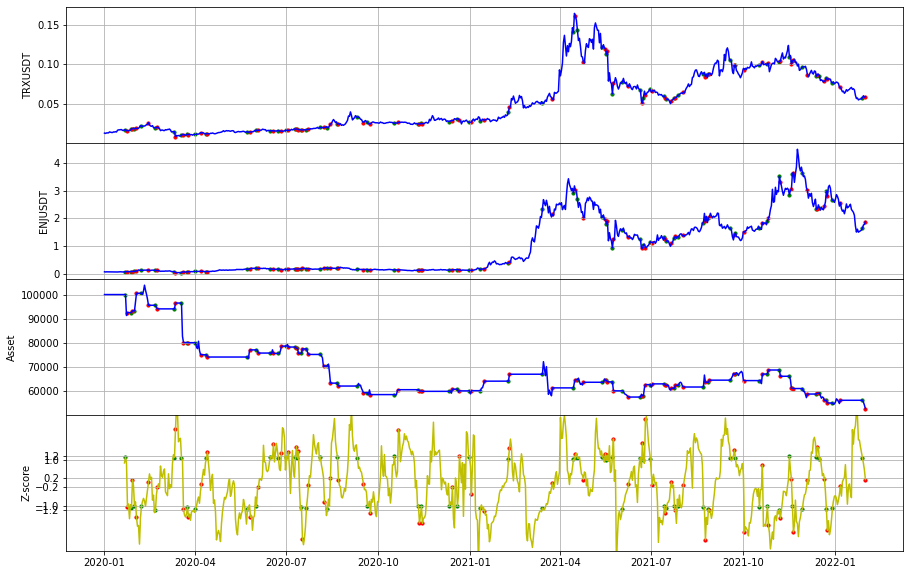

ETCUSDT_BNBUSDT 回測結果
-----------------------------ETCUSDT-BNBUSDT--------------------------
初始價格 100000
總損益:  45540.88184559
總交易次數:  50
平均損益:  910.8176369118504
勝率:  0.44
獲利因子:  1.5178620282830226
賺賠比:  1.9318243996329378
最大資金回落:  29574.616445671432
夏普比率:  0.11247378955641613


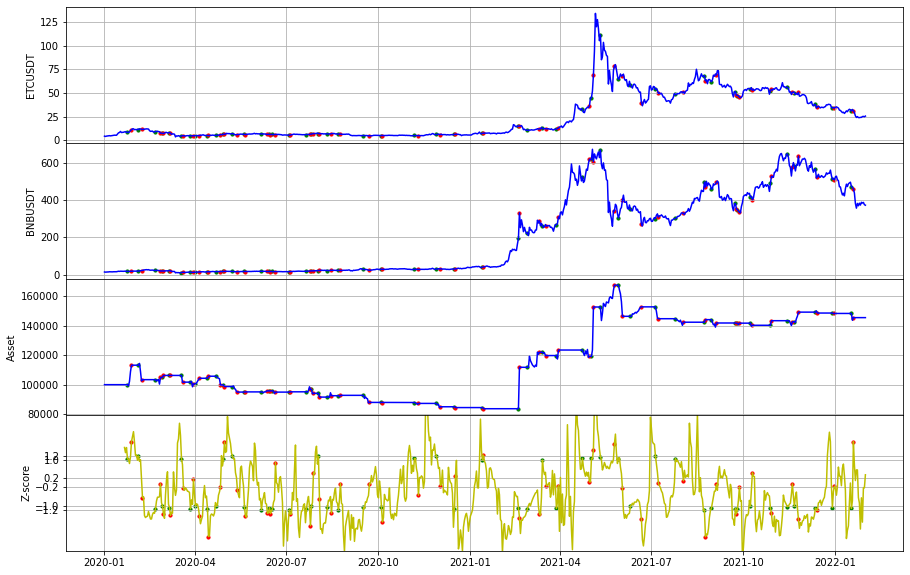

ETCUSDT_QTUMUSDT 回測結果
-----------------------------ETCUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  116350.85943034
總交易次數:  55
平均損益:  2115.470171460664
勝率:  0.5636363636363636
獲利因子:  2.966272742863019
賺賠比:  2.296469220281047
最大資金回落:  20694.192799737357
夏普比率:  0.31258301946936146


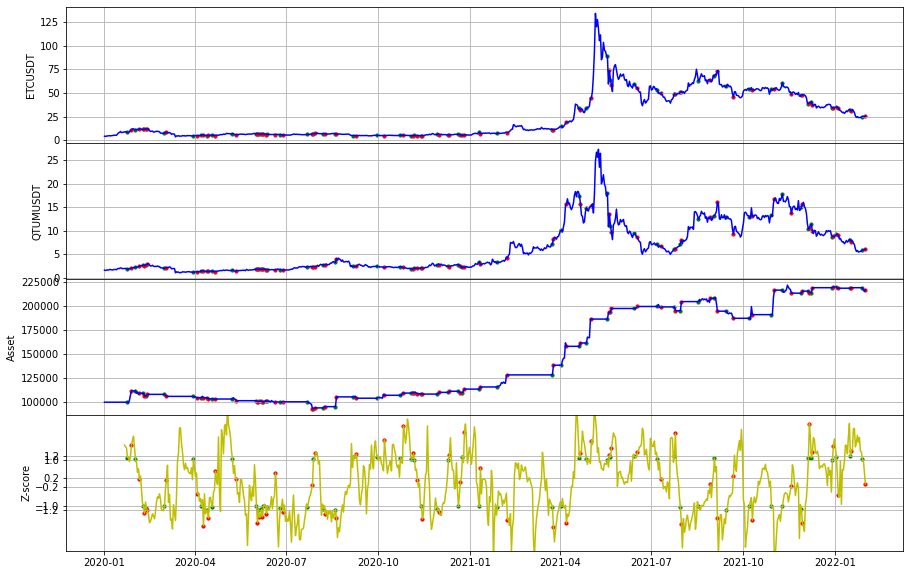

ETCUSDT_ADAUSDT 回測結果
-----------------------------ETCUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  15557.30604805
總交易次數:  58
平均損益:  268.2294146215356
勝率:  0.5862068965517241
獲利因子:  1.2265315299035477
賺賠比:  0.8657869622848572
最大資金回落:  20286.269198854425
夏普比率:  0.07072427786811412


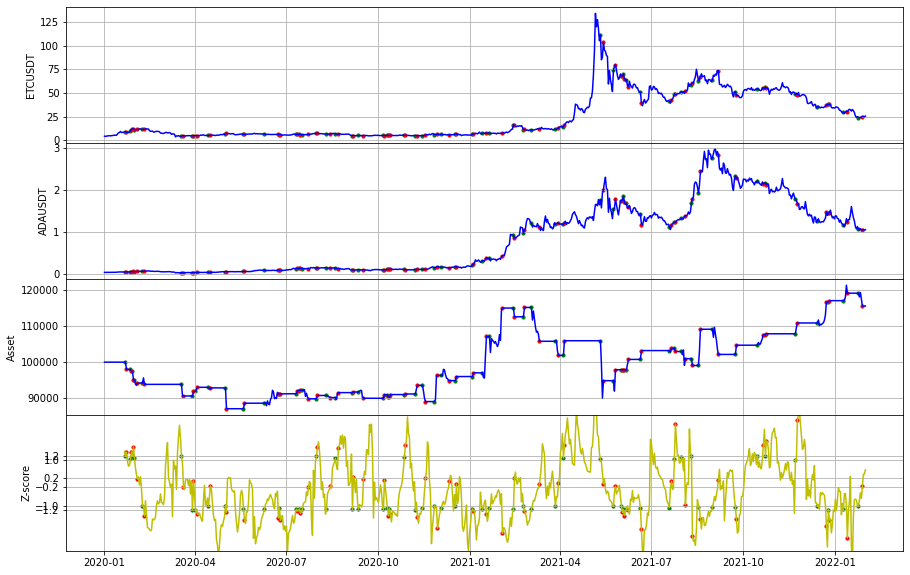

ETCUSDT_XRPUSDT 回測結果
-----------------------------ETCUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  -3299.74531190
總交易次數:  47
平均損益:  -70.20734706159621
勝率:  0.44680851063829785
獲利因子:  0.953064790179028
賺賠比:  1.1799849783168919
最大資金回落:  23408.843014931786
夏普比率:  -0.016097966963857832


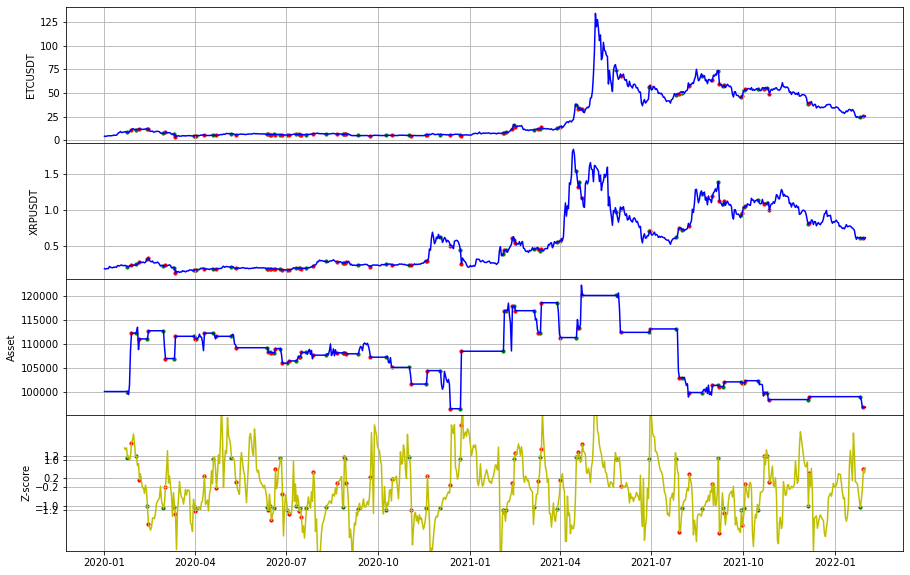

ETCUSDT_TRXUSDT 回測結果，場上有單已平倉
-----------------------------ETCUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  20145.74584831
總交易次數:  52
平均損益:  387.4181893906039
勝率:  0.5192307692307693
獲利因子:  1.335488833822216
賺賠比:  1.1871011856197475
最大資金回落:  14541.162116825086
夏普比率:  0.09817588939501384


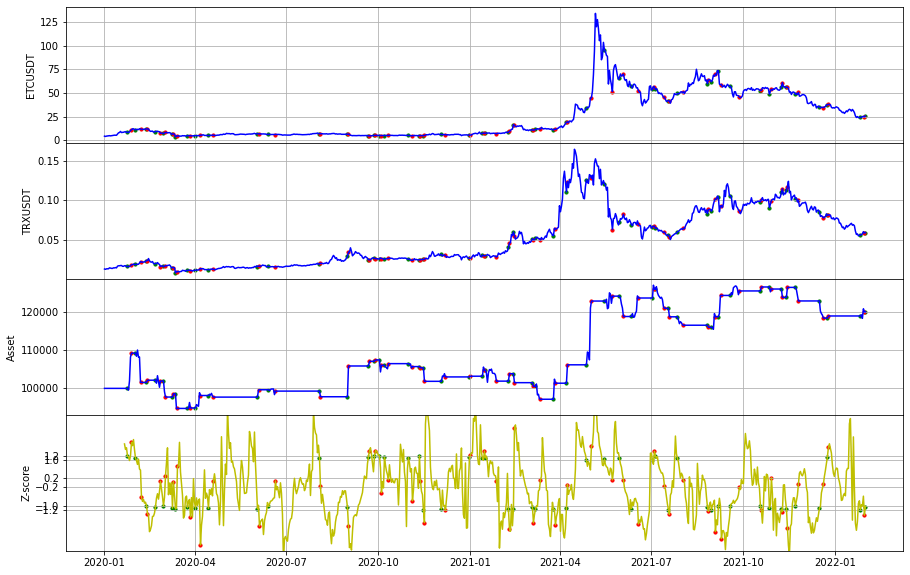

ETCUSDT_VETUSDT 回測結果，場上有單已平倉
-----------------------------ETCUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -26966.51480942
總交易次數:  61
平均損益:  -442.0740132692008
勝率:  0.4262295081967213
獲利因子:  0.6745240090509905
賺賠比:  0.9080130891071025
最大資金回落:  45672.45688546898
夏普比率:  -0.14069227629114786


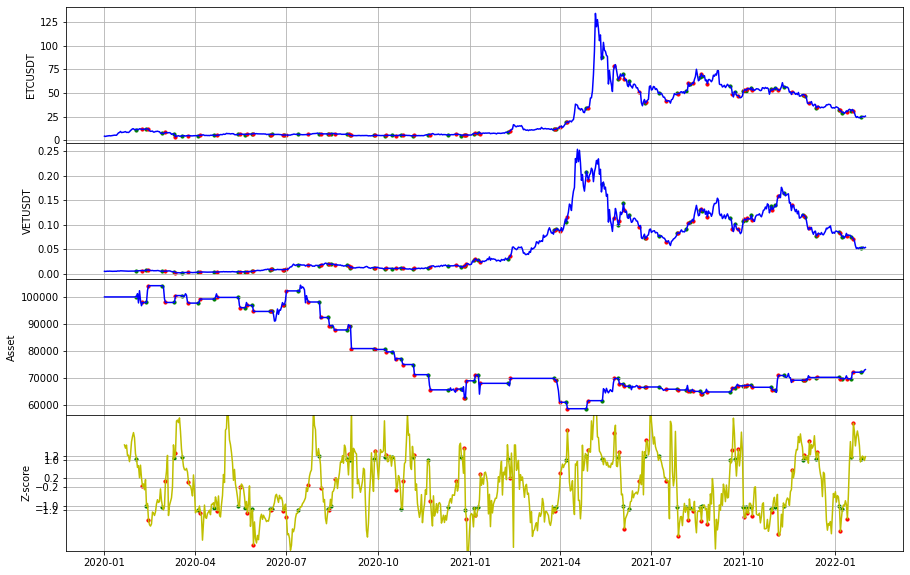

ETCUSDT_TFUELUSDT 回測結果
-----------------------------ETCUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  253430.03754990
總交易次數:  48
平均損益:  5279.792448956346
勝率:  0.5833333333333334
獲利因子:  2.261787594929473
賺賠比:  1.6155625678067662
最大資金回落:  111983.9850304951
夏普比率:  0.19715194435763245


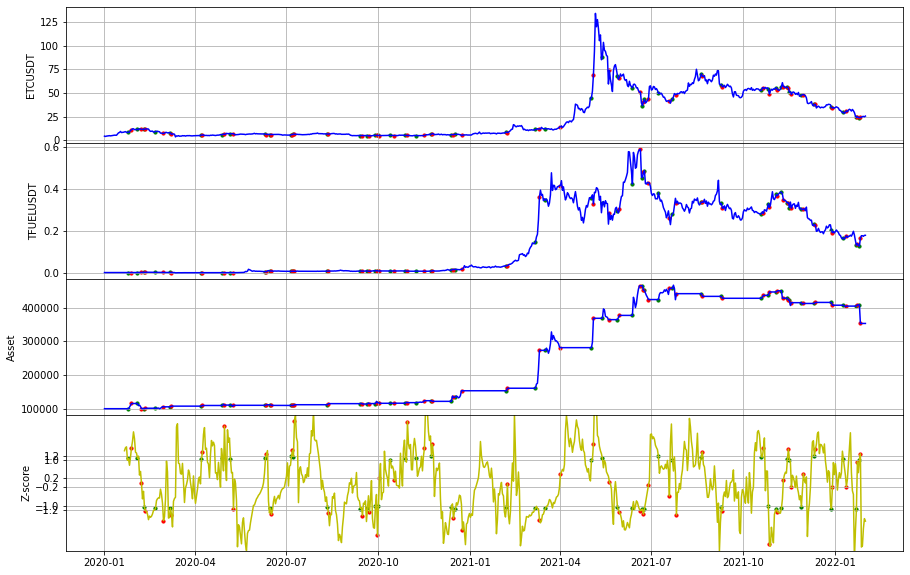

ETCUSDT_HOTUSDT 回測結果
-----------------------------ETCUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  132983.69955087
總交易次數:  50
平均損益:  2659.673991017352
勝率:  0.52
獲利因子:  3.169371123431404
賺賠比:  2.9255733447059113
最大資金回落:  19024.63434343433
夏普比率:  0.25183831902457593


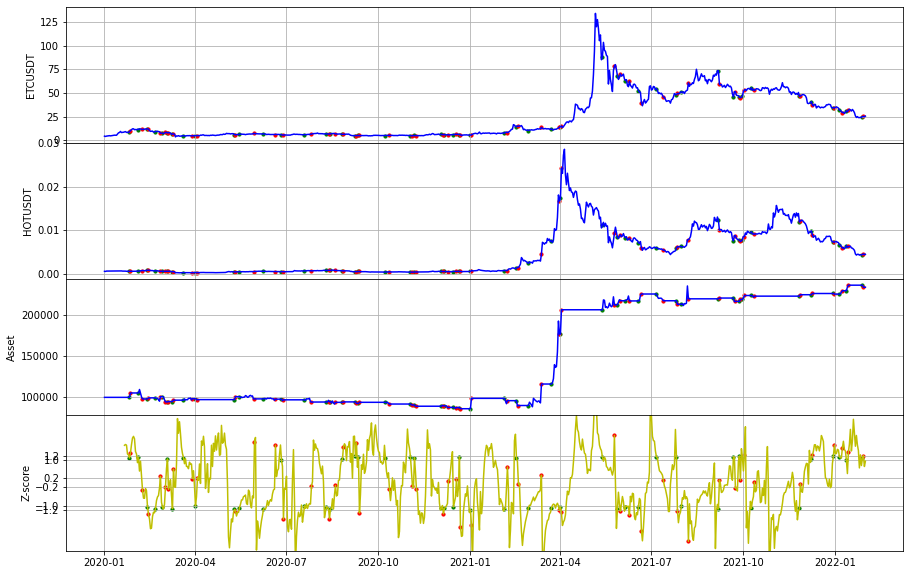

ETCUSDT_FETUSDT 回測結果
-----------------------------ETCUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  40738.41910524
總交易次數:  61
平均損益:  667.8429361513986
勝率:  0.5245901639344263
獲利因子:  1.2911001423401216
賺賠比:  1.170059503995735
最大資金回落:  38789.20551373104
夏普比率:  0.09250094333438362


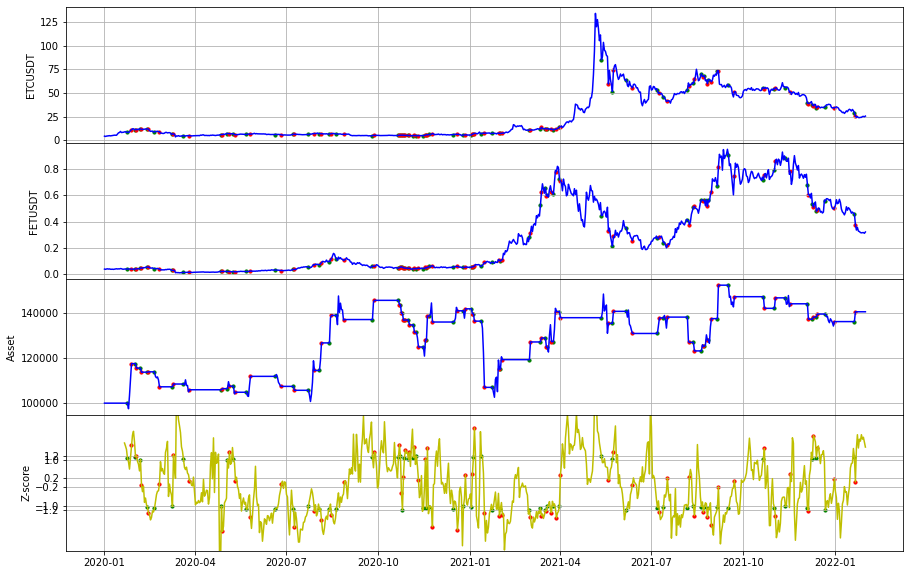

ETCUSDT_IOSTUSDT 回測結果
-----------------------------ETCUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  8479.94620988
總交易次數:  47
平均損益:  180.42438744427142
勝率:  0.5531914893617021
獲利因子:  1.1608245876635896
賺賠比:  0.9375890900359761
最大資金回落:  22795.932145572922
夏普比率:  0.053482501913131246


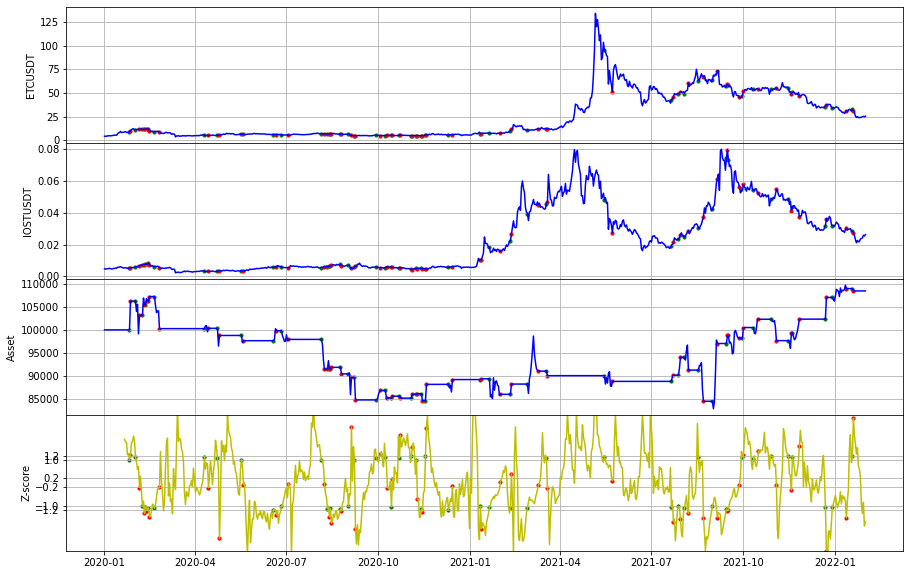

ETCUSDT_THETAUSDT 回測結果，場上有單已平倉
-----------------------------ETCUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  539.87262964
總交易次數:  66
平均損益:  8.17988832785561
勝率:  0.45454545454545453
獲利因子:  1.0040032606737563
賺賠比:  1.2048039128085075
最大資金回落:  41699.33091802256
夏普比率:  0.0014639989534348259


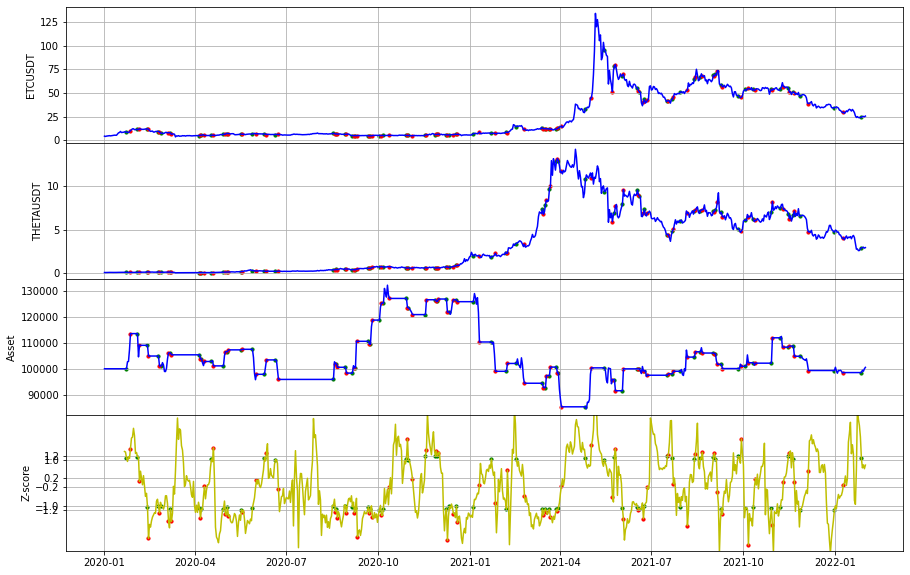

ICXUSDT_IOTAUSDT 回測結果
-----------------------------ICXUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  -40629.93857982
總交易次數:  57
平均損益:  -712.8059399967804
勝率:  0.3508771929824561
獲利因子:  0.5484961166983612
賺賠比:  1.0147178158919683
最大資金回落:  46188.19222811177
夏普比率:  -0.18455276444197358


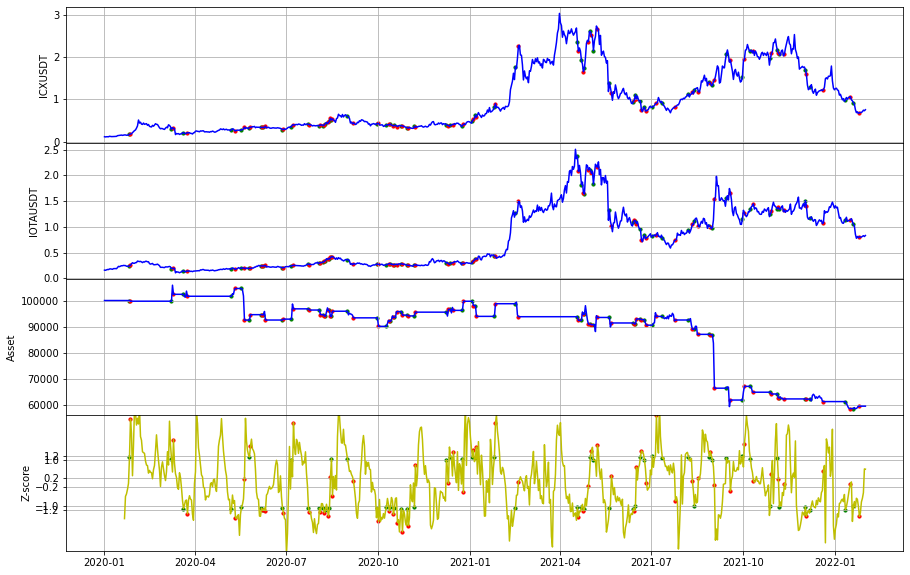

ICXUSDT_XLMUSDT 回測結果
-----------------------------ICXUSDT-XLMUSDT--------------------------
初始價格 100000
總損益:  -34048.18764788
總交易次數:  47
平均損益:  -724.4295244229484
勝率:  0.44680851063829785
獲利因子:  0.5366130029083263
賺賠比:  0.6643780036007848
最大資金回落:  35404.94759741435
夏普比率:  -0.22061783361108925


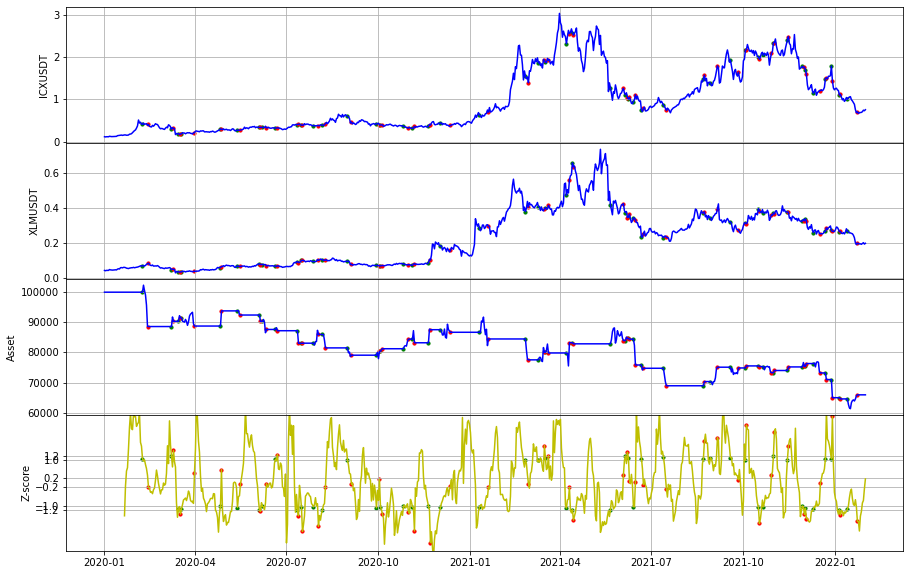

ICXUSDT_VETUSDT 回測結果
-----------------------------ICXUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -46037.15117116
總交易次數:  53
平均損益:  -868.6254937955191
勝率:  0.39622641509433965
獲利因子:  0.5477782113649506
賺賠比:  0.8347096554132581
最大資金回落:  50908.116382893706
夏普比率:  -0.19544123180732326


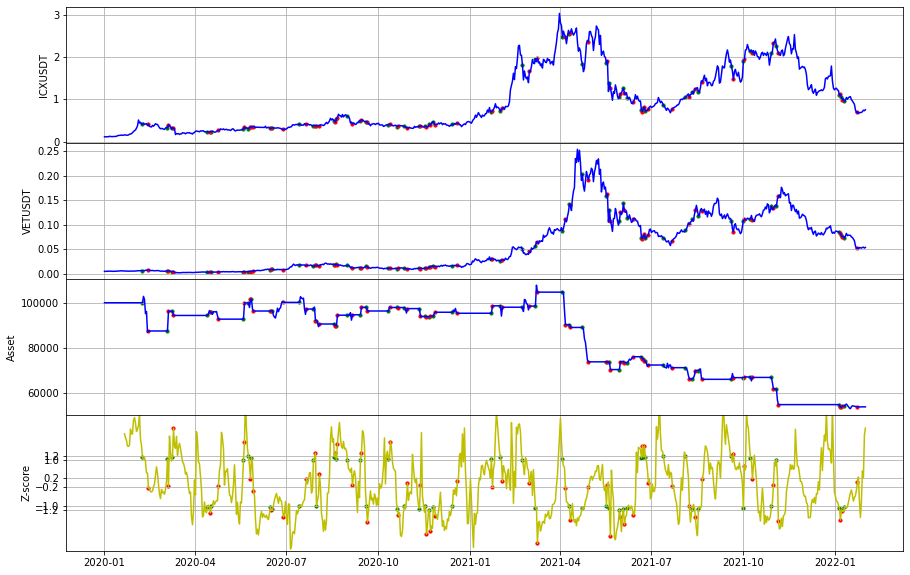

ICXUSDT_LINKUSDT 回測結果
-----------------------------ICXUSDT-LINKUSDT--------------------------
初始價格 100000
總損益:  -61725.85933961
總交易次數:  50
平均損益:  -1234.517186792194
勝率:  0.48
獲利因子:  0.36513402749055274
賺賠比:  0.3955618631147655
最大資金回落:  66896.41435799527
夏普比率:  -0.3123509860716009


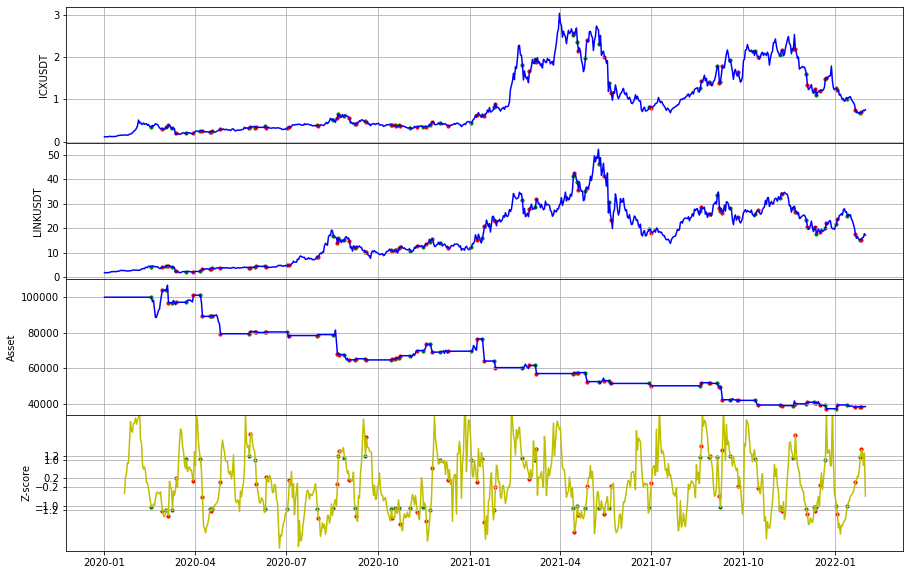

ICXUSDT_ZECUSDT 回測結果
-----------------------------ICXUSDT-ZECUSDT--------------------------
初始價格 100000
總損益:  -36040.33701244
總交易次數:  52
平均損益:  -693.0834040853339
勝率:  0.34615384615384615
獲利因子:  0.656986823746312
賺賠比:  1.2409751115208114
最大資金回落:  44614.03569413038
夏普比率:  -0.17613781864603317


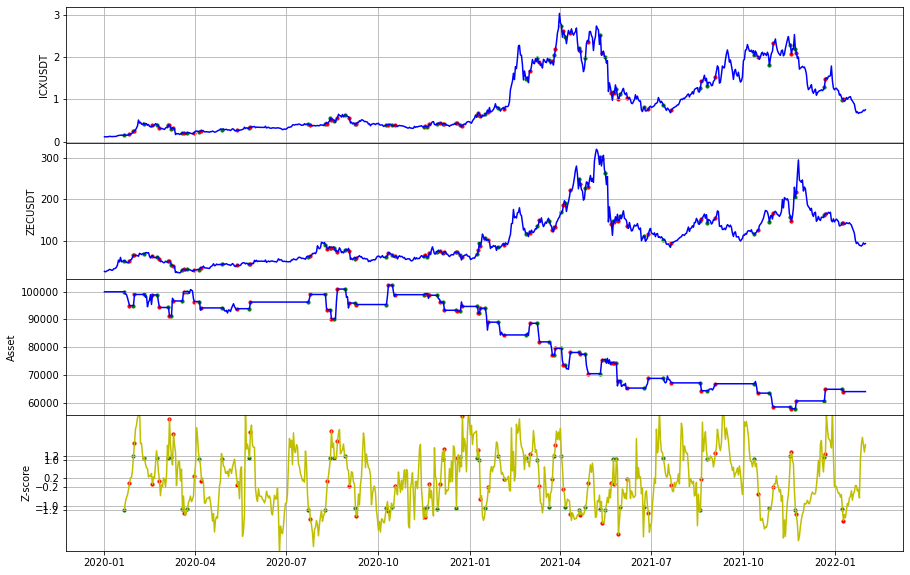

ICXUSDT_IOSTUSDT 回測結果
-----------------------------ICXUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  -38620.52010656
總交易次數:  46
平均損益:  -839.5765240557164
勝率:  0.5434782608695652
獲利因子:  0.6250822967161654
賺賠比:  0.525069129241579
最大資金回落:  65022.768525065156
夏普比率:  -0.14276826543461107


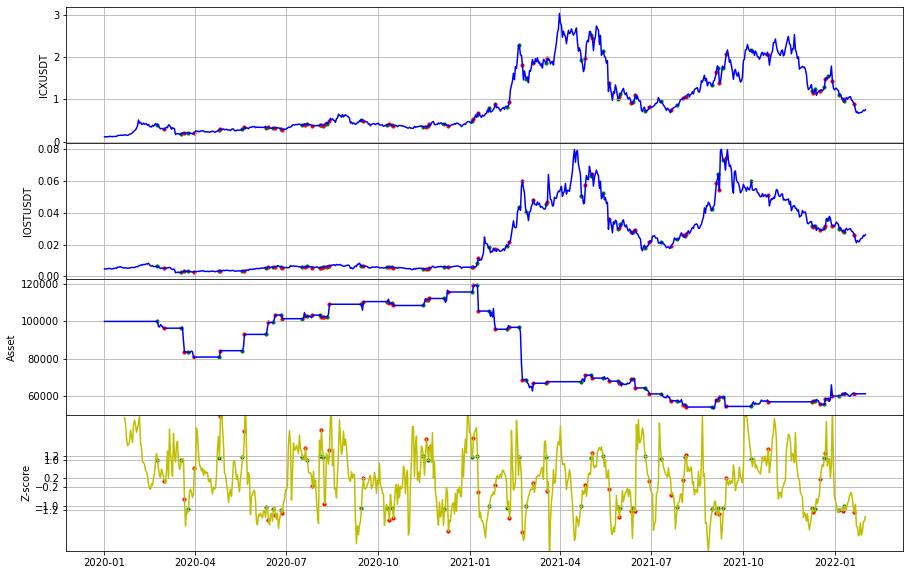

ICXUSDT_DASHUSDT 回測結果
-----------------------------ICXUSDT-DASHUSDT--------------------------
初始價格 100000
總損益:  -42468.52372112
總交易次數:  59
平均損益:  -719.8054867986937
勝率:  0.3559322033898305
獲利因子:  0.5607366698496715
賺賠比:  1.0146663549660722
最大資金回落:  49216.11250973089
夏普比率:  -0.17584564796412755


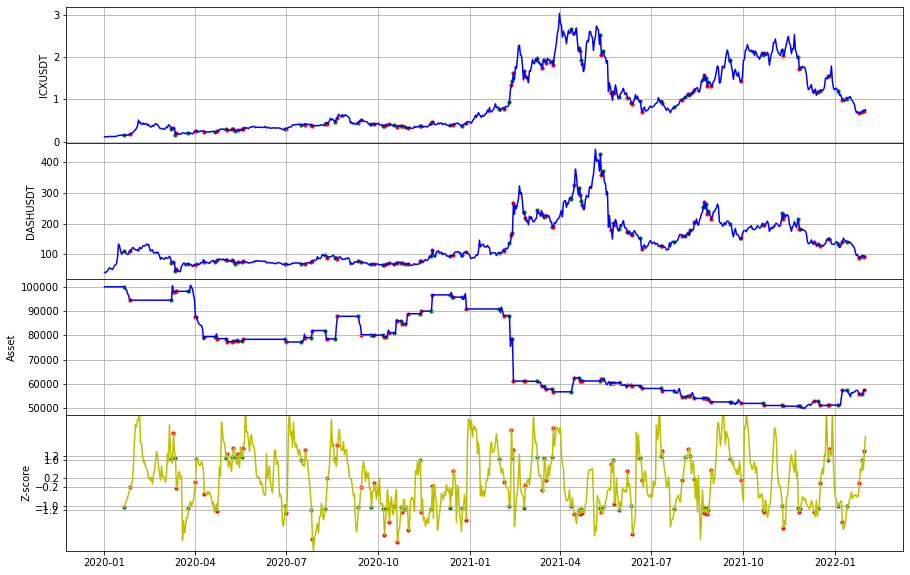

ICXUSDT_MITHUSDT 回測結果，場上有單已平倉
-----------------------------ICXUSDT-MITHUSDT--------------------------
初始價格 100000
總損益:  -81737.27747227
總交易次數:  49
平均損益:  -1668.1077035156534
勝率:  0.42857142857142855
獲利因子:  0.46054388744433195
賺賠比:  0.5921278552855697
最大資金回落:  85372.95547441379
夏普比率:  -0.15307962580357867


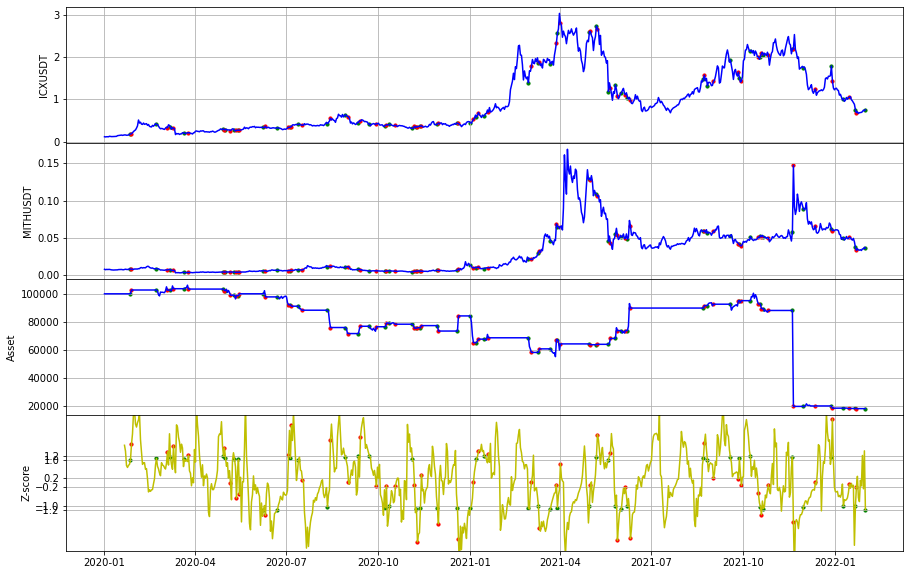

NULSUSDT_NEOUSDT 回測結果，場上有單已平倉
-----------------------------NULSUSDT-NEOUSDT--------------------------
初始價格 100000
總損益:  34759.54049532
總交易次數:  60
平均損益:  579.3256749219188
勝率:  0.5166666666666667
獲利因子:  1.3192844408143218
賺賠比:  1.2341693156004947
最大資金回落:  25260.83860175073
夏普比率:  0.09271943627588208


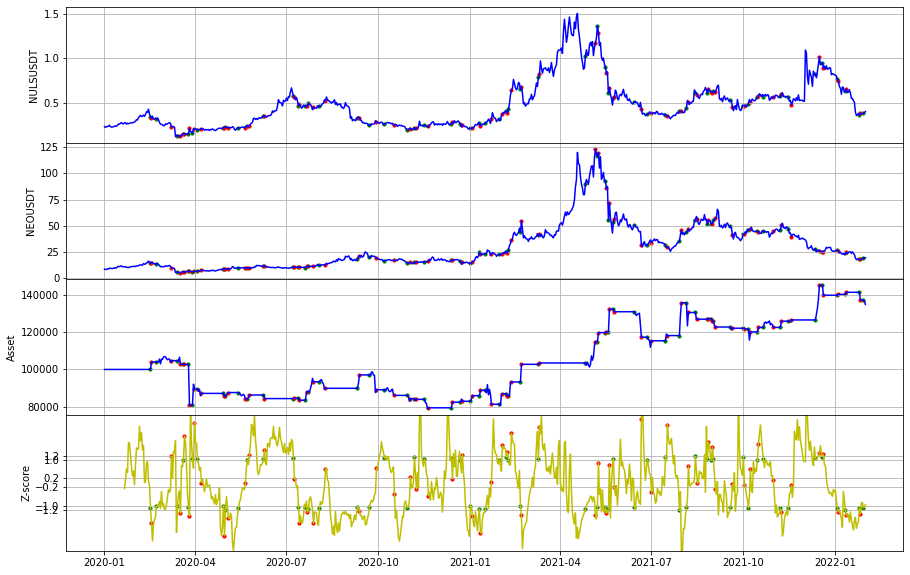

NULSUSDT_LTCUSDT 回測結果
-----------------------------NULSUSDT-LTCUSDT--------------------------
初始價格 100000
總損益:  39240.61843289
總交易次數:  58
平均損益:  676.5623867740295
勝率:  0.4827586206896552
獲利因子:  1.361457082290527
賺賠比:  1.4587040167398502
最大資金回落:  20778.787998620668
夏普比率:  0.10946480609022308


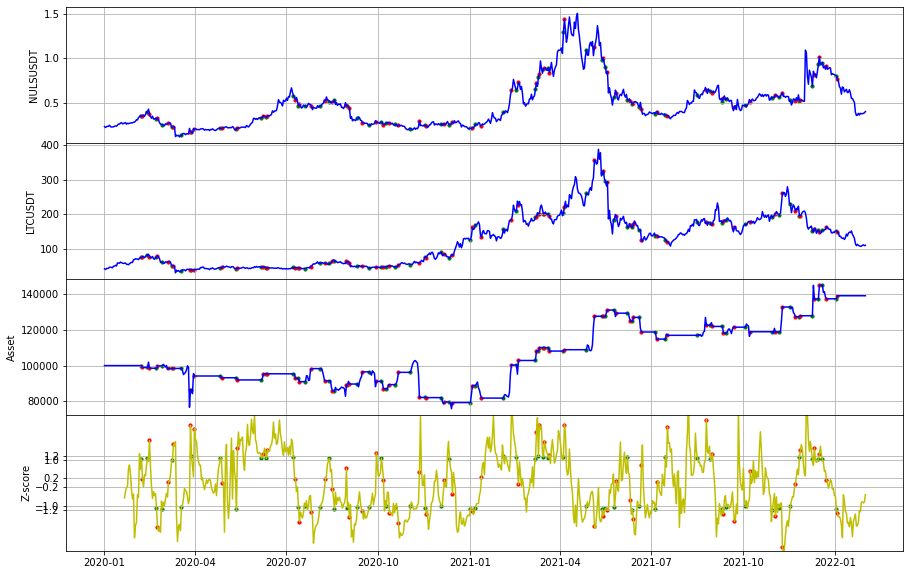

NULSUSDT_IOTAUSDT 回測結果
-----------------------------NULSUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  1885.02832936
總交易次數:  54
平均損益:  34.90793202520769
勝率:  0.5740740740740741
獲利因子:  1.0143650549043648
賺賠比:  0.7525934278322707
最大資金回落:  59749.94128824545
夏普比率:  0.004985909133760361


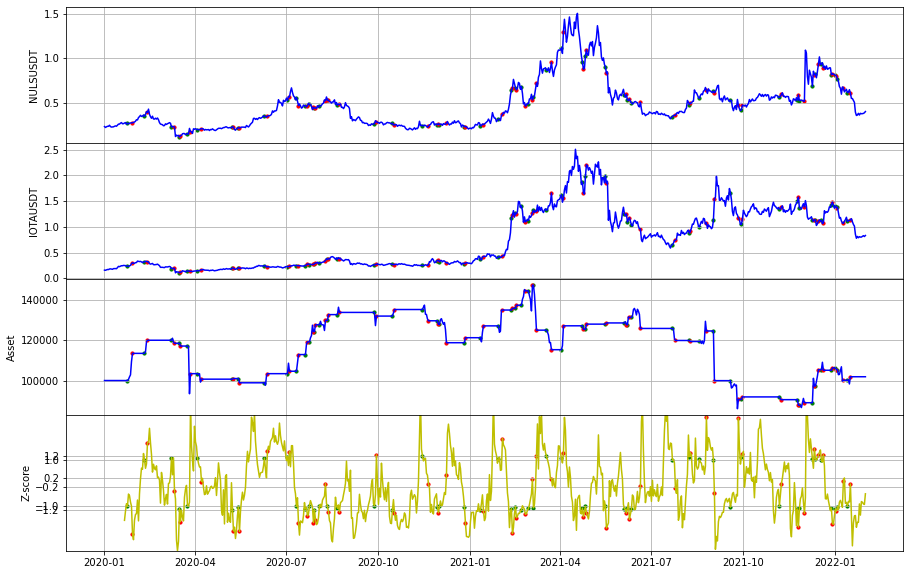

NULSUSDT_ONTUSDT 回測結果，場上有單已平倉
-----------------------------NULSUSDT-ONTUSDT--------------------------
初始價格 100000
總損益:  54103.66053324
總交易次數:  43
平均損益:  1258.2246635636534
勝率:  0.627906976744186
獲利因子:  1.9986138147710015
賺賠比:  1.1843637420865196
最大資金回落:  12629.990064229176
夏普比率:  0.2554183232142027


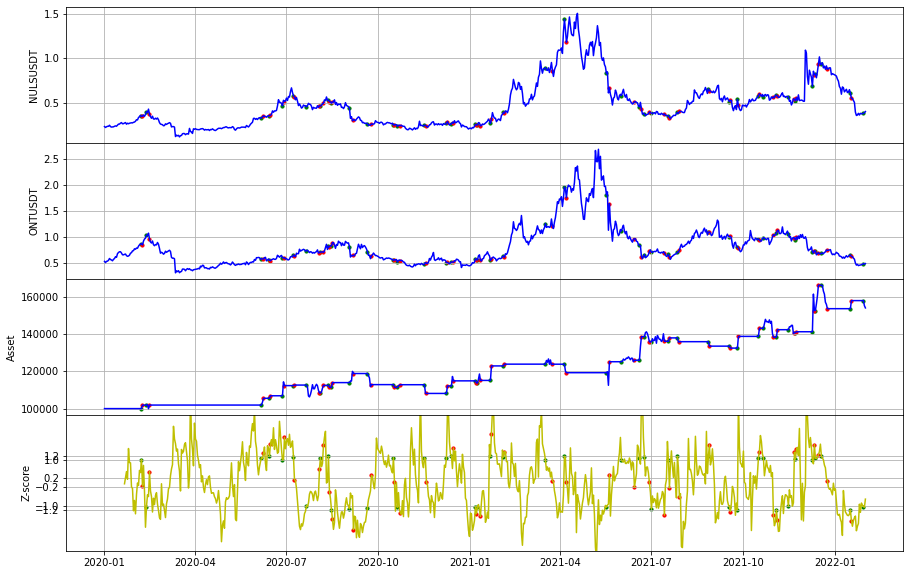

NULSUSDT_ICXUSDT 回測結果
-----------------------------NULSUSDT-ICXUSDT--------------------------
初始價格 100000
總損益:  29193.98805393
總交易次數:  52
平均損益:  561.4228471908835
勝率:  0.5
獲利因子:  1.3331298537478102
賺賠比:  1.3331298537478102
最大資金回落:  44066.44221797706
夏普比率:  0.07611111313538979


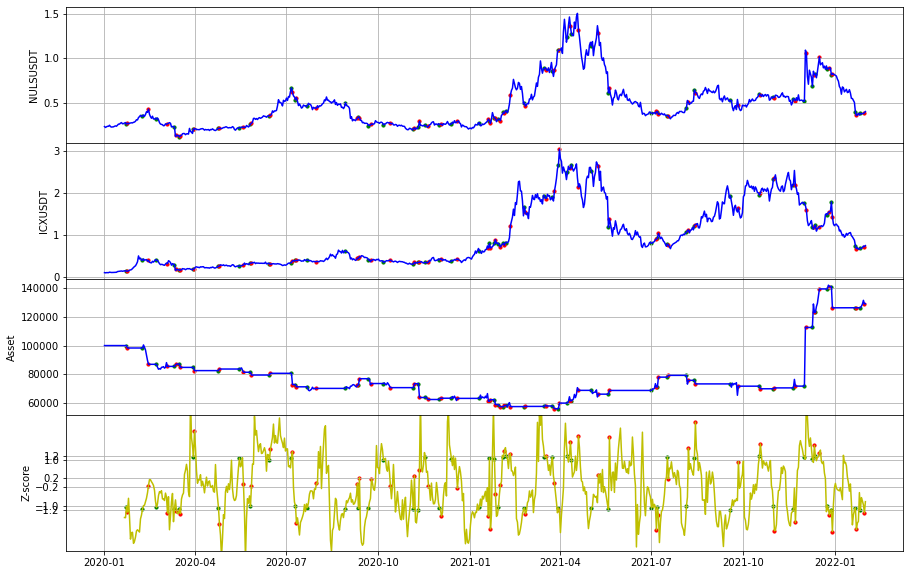

NULSUSDT_LINKUSDT 回測結果
-----------------------------NULSUSDT-LINKUSDT--------------------------
初始價格 100000
總損益:  230888.96484926
總交易次數:  53
平均損益:  4356.395563193592
勝率:  0.660377358490566
獲利因子:  3.383559755595173
賺賠比:  1.7401164457346605
最大資金回落:  26942.92948803096
夏普比率:  0.2511675043732959


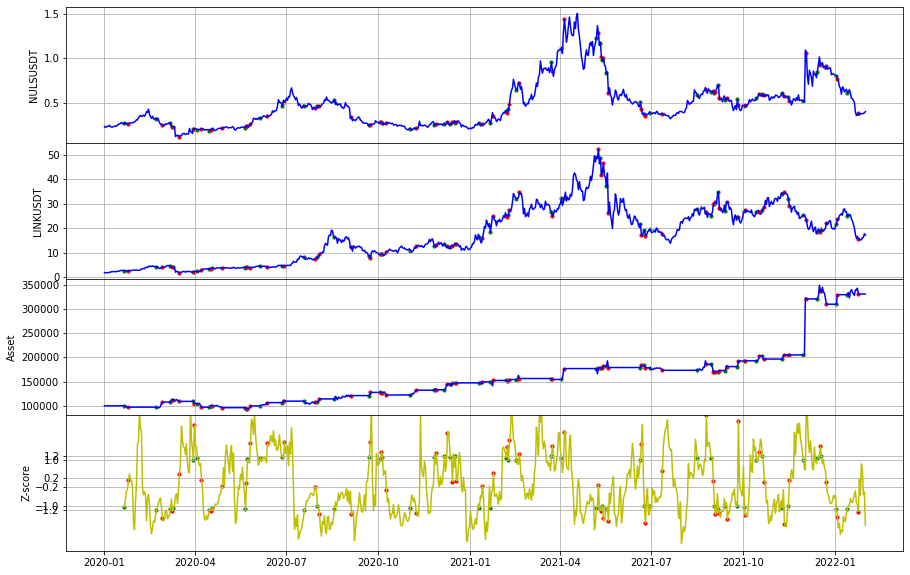

NULSUSDT_HOTUSDT 回測結果，場上有單已平倉
-----------------------------NULSUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  28789.10378270
總交易次數:  55
平均損益:  523.4382505945946
勝率:  0.4
獲利因子:  1.251447308600054
賺賠比:  1.877170962900081
最大資金回落:  46593.595986224886
夏普比率:  0.057948062781539716


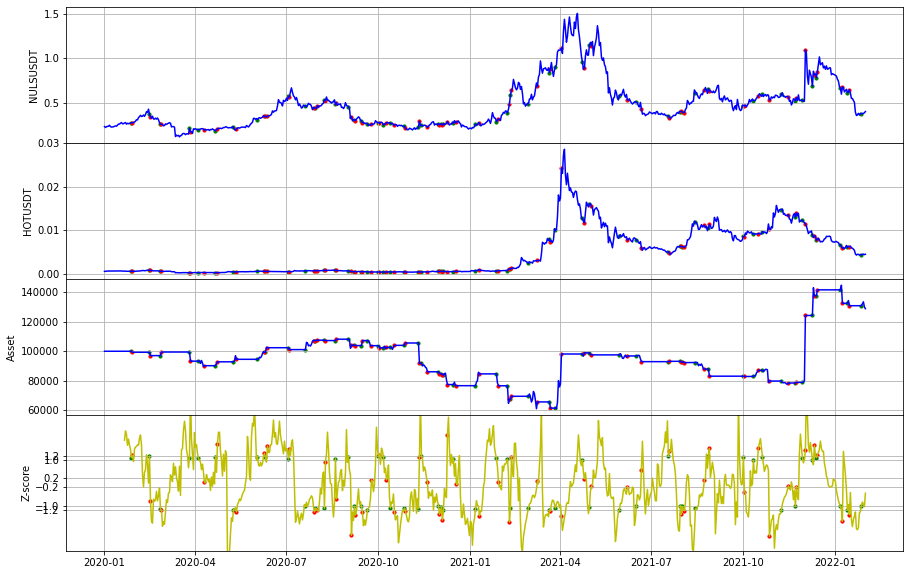

NULSUSDT_ZILUSDT 回測結果
-----------------------------NULSUSDT-ZILUSDT--------------------------
初始價格 100000
總損益:  -34230.93228458
總交易次數:  57
平均損益:  -600.5426716592143
勝率:  0.47368421052631576
獲利因子:  0.6284035727595547
賺賠比:  0.698226191955061
最大資金回落:  35820.62279707523
夏普比率:  -0.16334751302384923


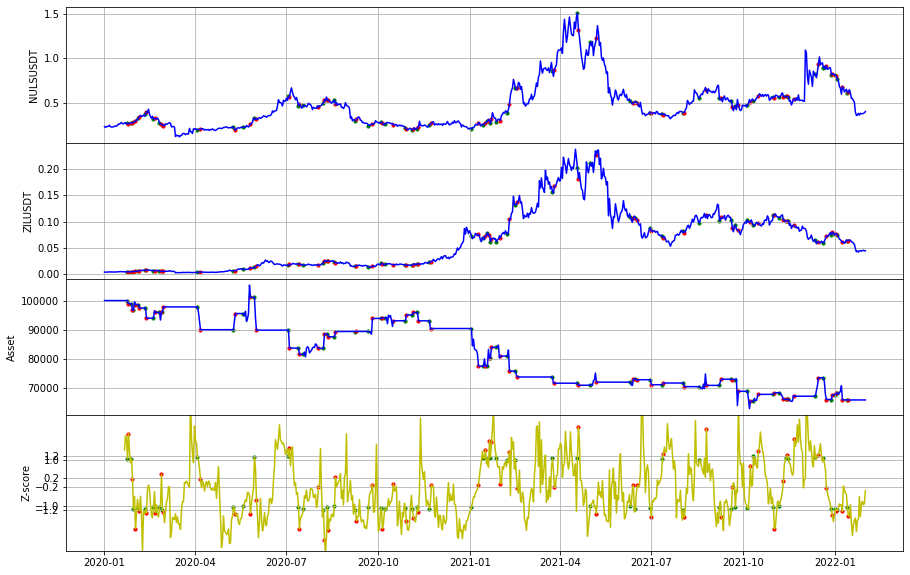

NULSUSDT_ZRXUSDT 回測結果
-----------------------------NULSUSDT-ZRXUSDT--------------------------
初始價格 100000
總損益:  25785.18197010
總交易次數:  42
平均損益:  613.9329040499003
勝率:  0.42857142857142855
獲利因子:  1.2844527805934476
賺賠比:  1.71260370745793
最大資金回落:  29045.245344685245
夏普比率:  0.07860872882261548


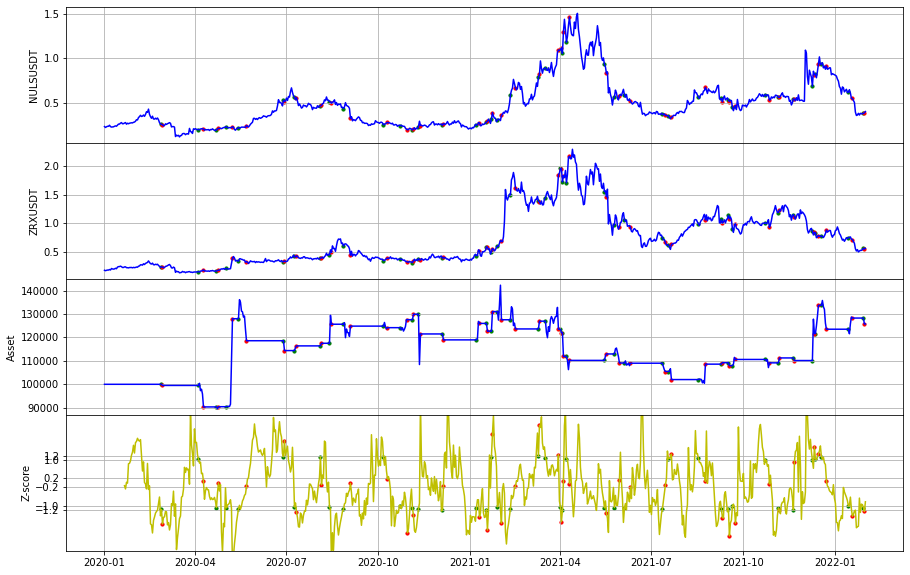

NULSUSDT_ZECUSDT 回測結果
-----------------------------NULSUSDT-ZECUSDT--------------------------
初始價格 100000
總損益:  -50725.72837460
總交易次數:  66
平均損益:  -768.5716420393376
勝率:  0.5151515151515151
獲利因子:  0.7156977362561155
賺賠比:  0.6735978694175205
最大資金回落:  93350.35369789788
夏普比率:  -0.08200844774468728


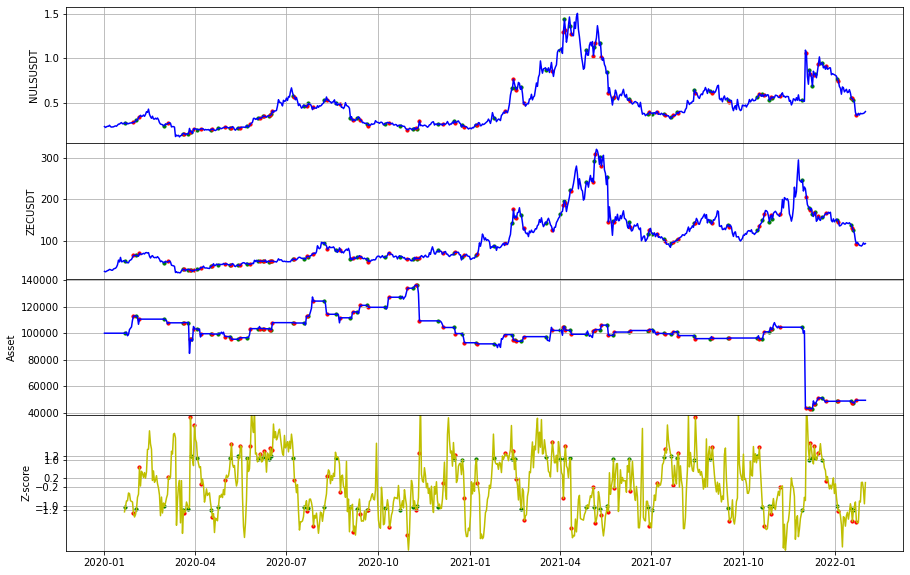

NULSUSDT_DASHUSDT 回測結果
-----------------------------NULSUSDT-DASHUSDT--------------------------
初始價格 100000
總損益:  39758.69618135
總交易次數:  51
平均損益:  779.5822780656499
勝率:  0.5882352941176471
獲利因子:  1.4013693350828615
賺賠比:  0.9809585345580032
最大資金回落:  42844.955693395255
夏普比率:  0.12312850792803111


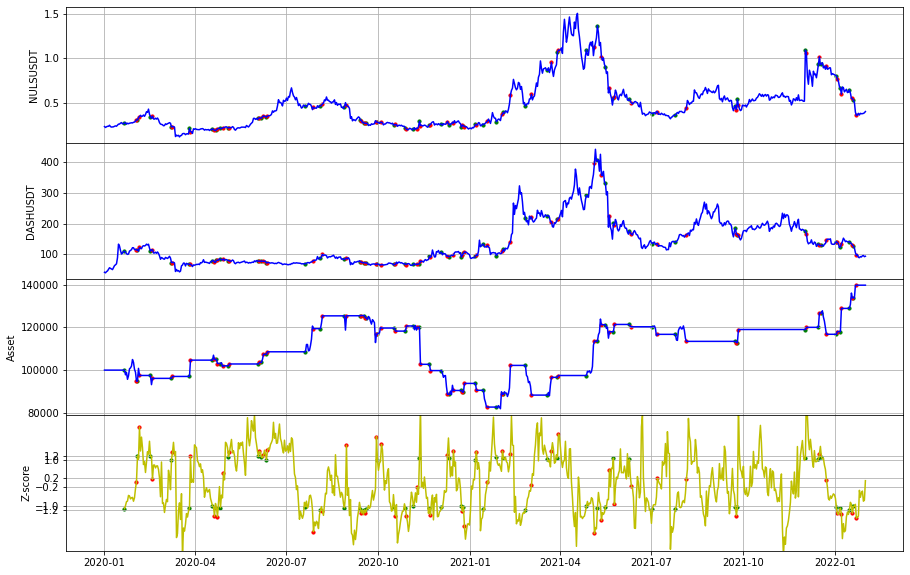

VETUSDT_QTUMUSDT 回測結果
-----------------------------VETUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  -17090.14473404
總交易次數:  43
平均損益:  -397.44522637308324
勝率:  0.3953488372093023
獲利因子:  0.7429763867479471
賺賠比:  1.1363168267909778
最大資金回落:  46631.215238900535
夏普比率:  -0.10120745637271199


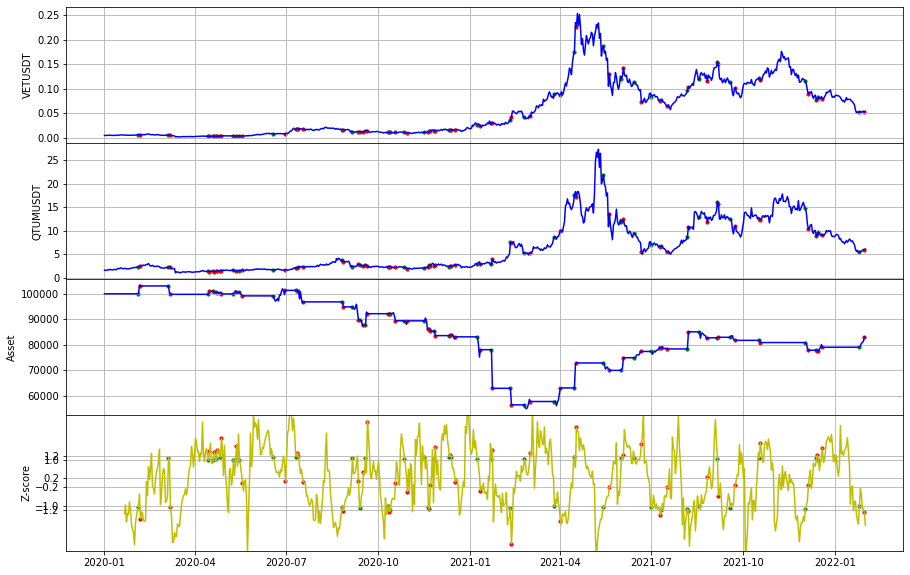

VETUSDT_ADAUSDT 回測結果
-----------------------------VETUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  -12211.23482144
總交易次數:  47
平均損益:  -259.81350683911546
勝率:  0.48936170212765956
獲利因子:  0.8270125994797295
賺賠比:  0.8629696690223264
最大資金回落:  31435.516180176113
夏普比率:  -0.05810558671428165


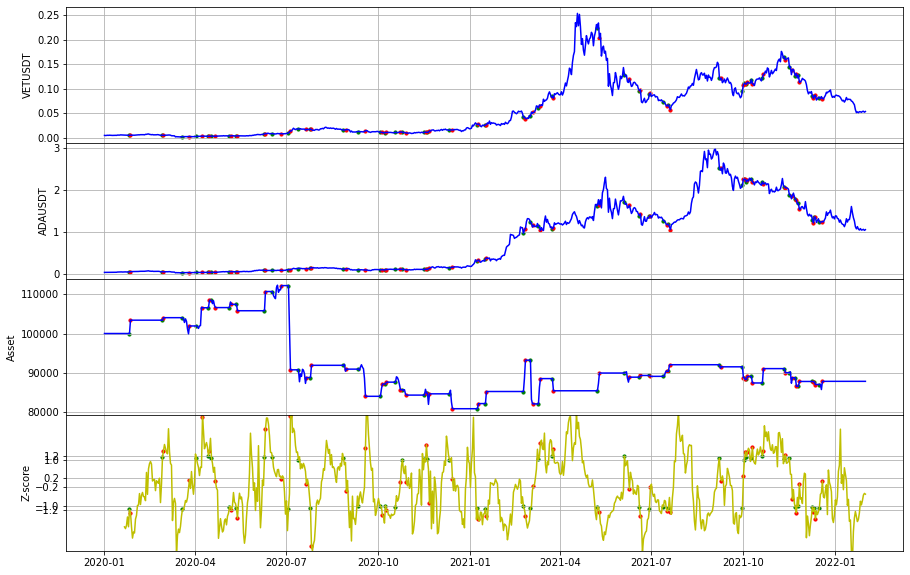

VETUSDT_XRPUSDT 回測結果
-----------------------------VETUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  -58343.18800557
總交易次數:  53
平均損益:  -1100.8148680296345
勝率:  0.41509433962264153
獲利因子:  0.41925583505015357
賺賠比:  0.5907695857524891
最大資金回落:  70943.62998998904
夏普比率:  -0.18651467239605932


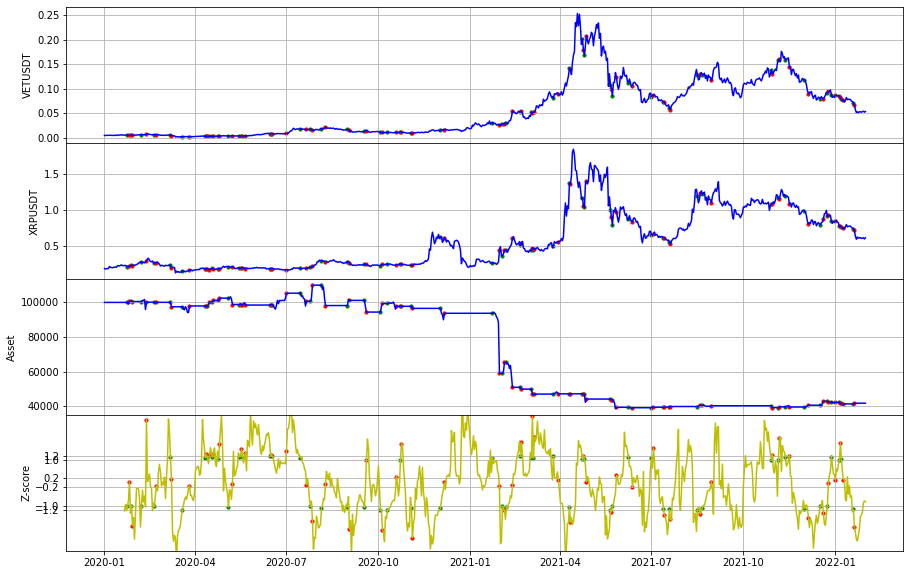

VETUSDT_TRXUSDT 回測結果，場上有單已平倉
-----------------------------VETUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  -35099.67695307
總交易次數:  61
平均損益:  -575.4045402142586
勝率:  0.3770491803278688
獲利因子:  0.5711473181678036
賺賠比:  0.9188022074873363
最大資金回落:  45640.136283244596
夏普比率:  -0.1898167153658618


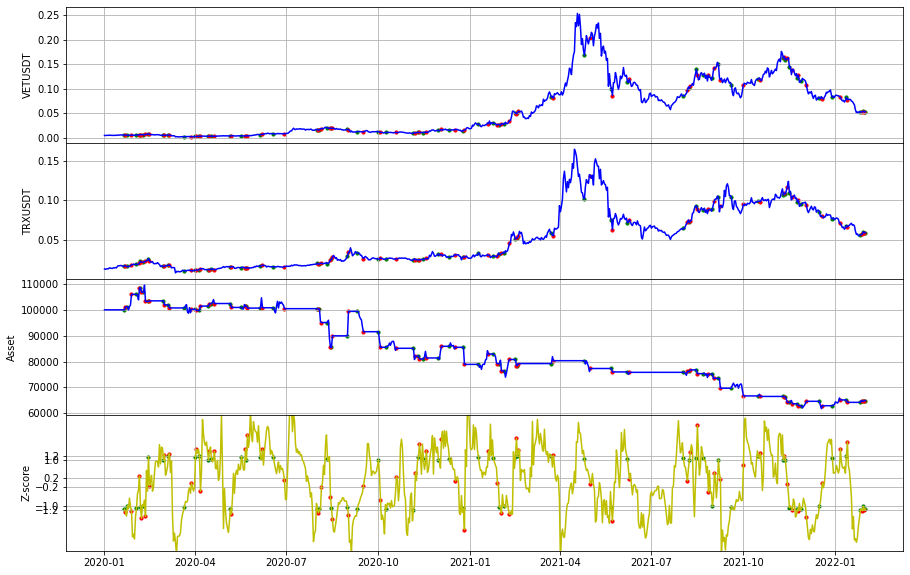

VETUSDT_ETCUSDT 回測結果，場上有單已平倉
-----------------------------VETUSDT-ETCUSDT--------------------------
初始價格 100000
總損益:  -13020.56555296
總交易次數:  63
平均損益:  -206.67564369785546
勝率:  0.4603174603174603
獲利因子:  0.8486459866471237
賺賠比:  0.9949642602069724
最大資金回落:  49384.462928748355
夏普比率:  -0.05584016179553768


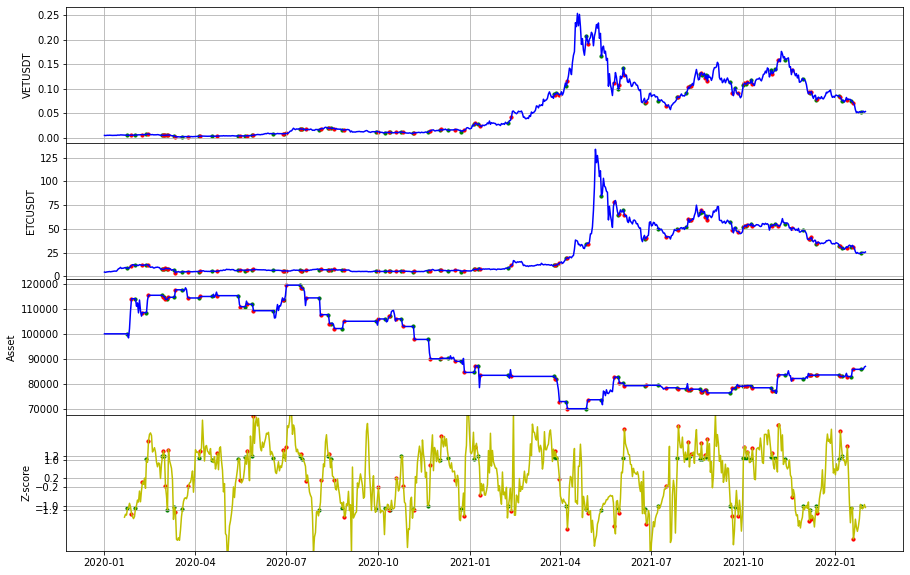

VETUSDT_ICXUSDT 回測結果
-----------------------------VETUSDT-ICXUSDT--------------------------
初始價格 100000
總損益:  -32181.73440631
總交易次數:  55
平均損益:  -585.1224437511314
勝率:  0.4
獲利因子:  0.7006451073295744
賺賠比:  1.0509676609943617
最大資金回落:  35013.51772383382
夏普比率:  -0.1302042479088935


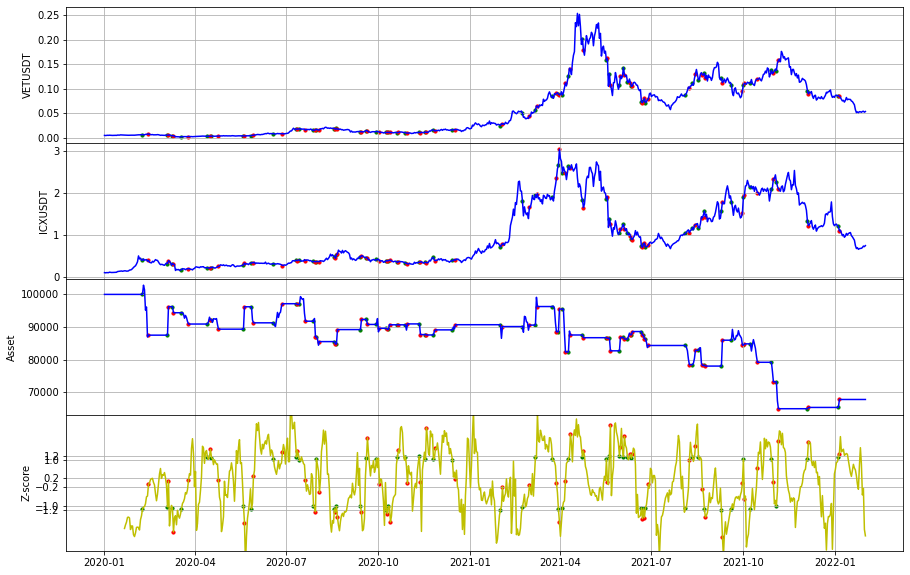

VETUSDT_TFUELUSDT 回測結果
-----------------------------VETUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  170775.27114530
總交易次數:  58
平均損益:  2944.4012266430937
勝率:  0.603448275862069
獲利因子:  1.9805790607672793
賺賠比:  1.3015233827899264
最大資金回落:  59455.527795792266
夏普比率:  0.1720569953409602


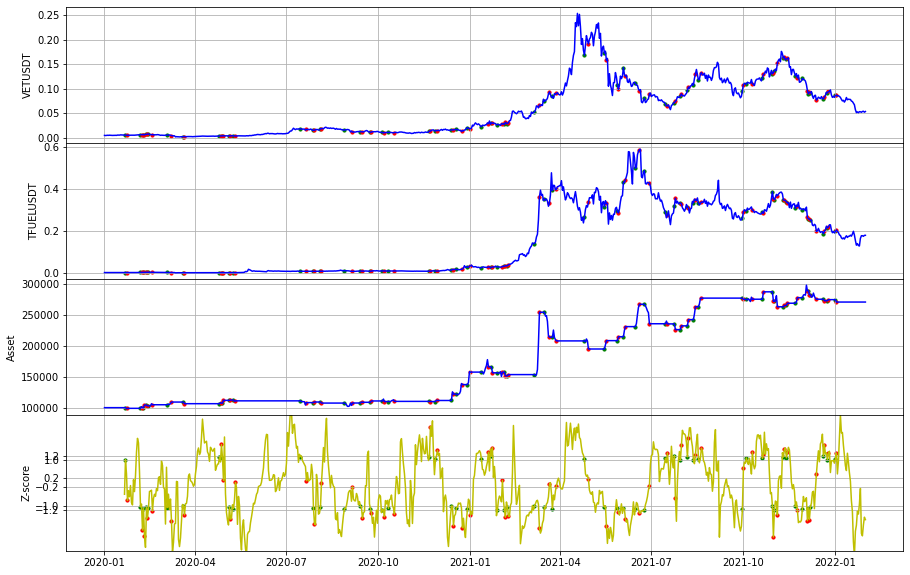

VETUSDT_WAVESUSDT 回測結果
-----------------------------VETUSDT-WAVESUSDT--------------------------
初始價格 100000
總損益:  -11465.57672123
總交易次數:  52
平均損益:  -220.49186002363086
勝率:  0.46153846153846156
獲利因子:  0.8796352310687632
賺賠比:  1.026241102913557
最大資金回落:  42584.5568108688
夏普比率:  -0.040112534866894964


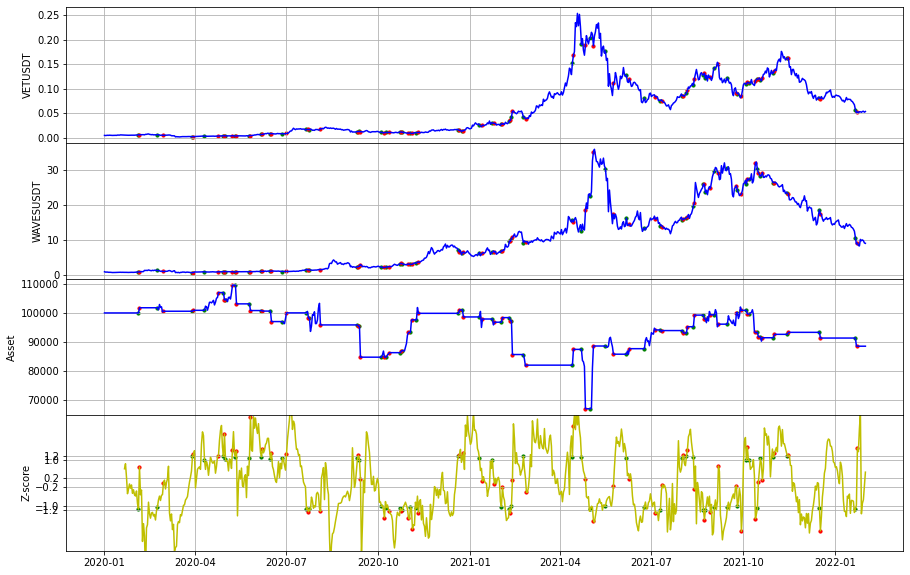

VETUSDT_ONGUSDT 回測結果
-----------------------------VETUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -23482.54467860
總交易次數:  65
平均損益:  -361.26991813237925
勝率:  0.4153846153846154
獲利因子:  0.7964611861807059
賺賠比:  1.1209453731432157
最大資金回落:  40690.19817906339
夏普比率:  -0.08112727856303435


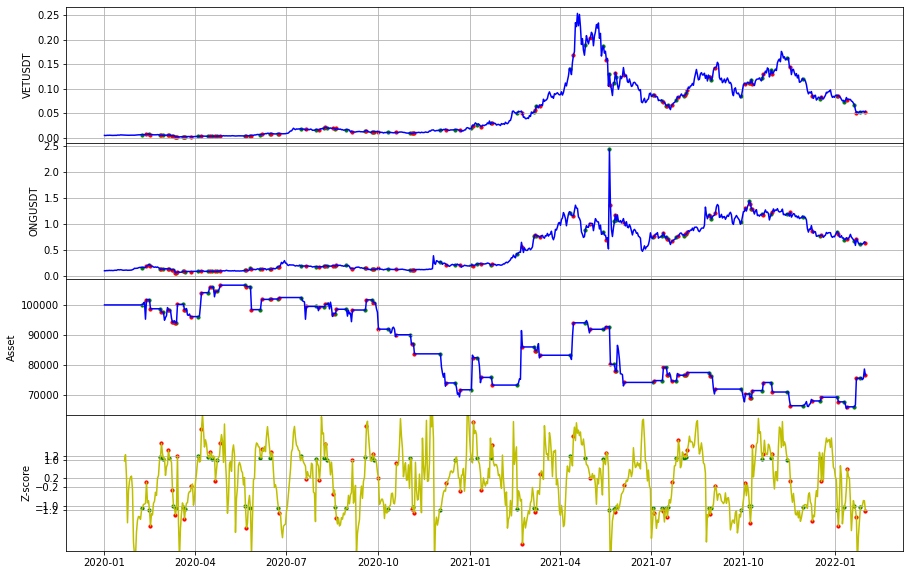

VETUSDT_HOTUSDT 回測結果，場上有單已平倉
-----------------------------VETUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  -13598.13909583
總交易次數:  66
平均損益:  -206.03241054292712
勝率:  0.5151515151515151
獲利因子:  0.8804959531113378
賺賠比:  0.8287020735165532
最大資金回落:  45177.16777998977
夏普比率:  -0.03918311920412138


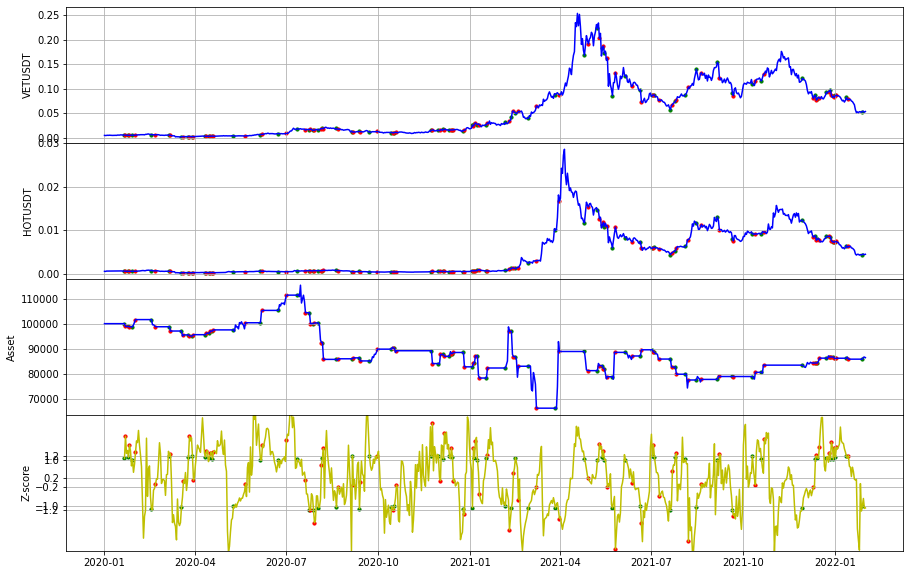

VETUSDT_FETUSDT 回測結果
-----------------------------VETUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  65439.27473439
總交易次數:  54
平均損益:  1211.8384210071881
勝率:  0.6111111111111112
獲利因子:  1.3830745757238307
賺賠比:  0.8801383663697103
最大資金回落:  63037.259746067575
夏普比率:  0.11277964968744889


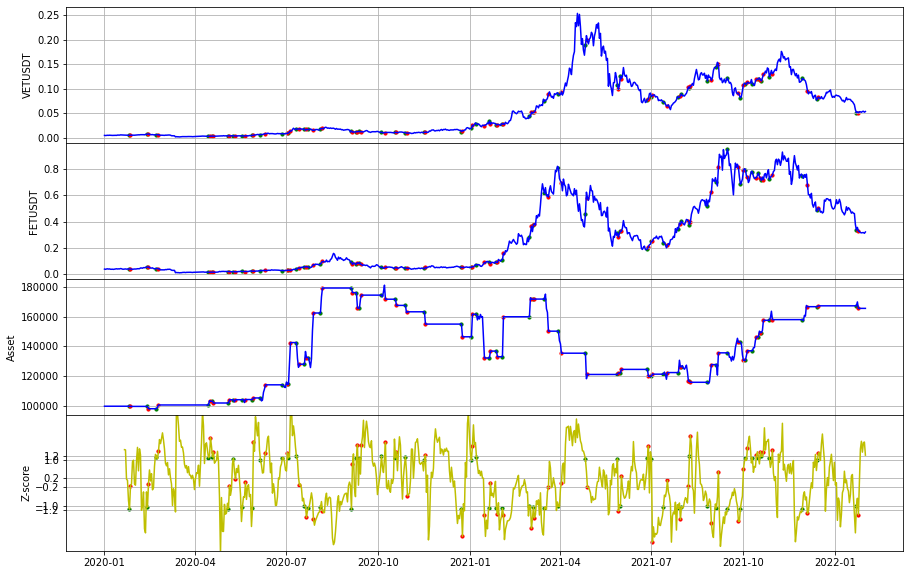

VETUSDT_IOSTUSDT 回測結果
-----------------------------VETUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  8752.44222564
總交易次數:  50
平均損益:  175.04884451273304
勝率:  0.52
獲利因子:  1.1145944083708044
賺賠比:  1.0288563769576655
最大資金回落:  29193.445363032777
夏普比率:  0.04149017797637551


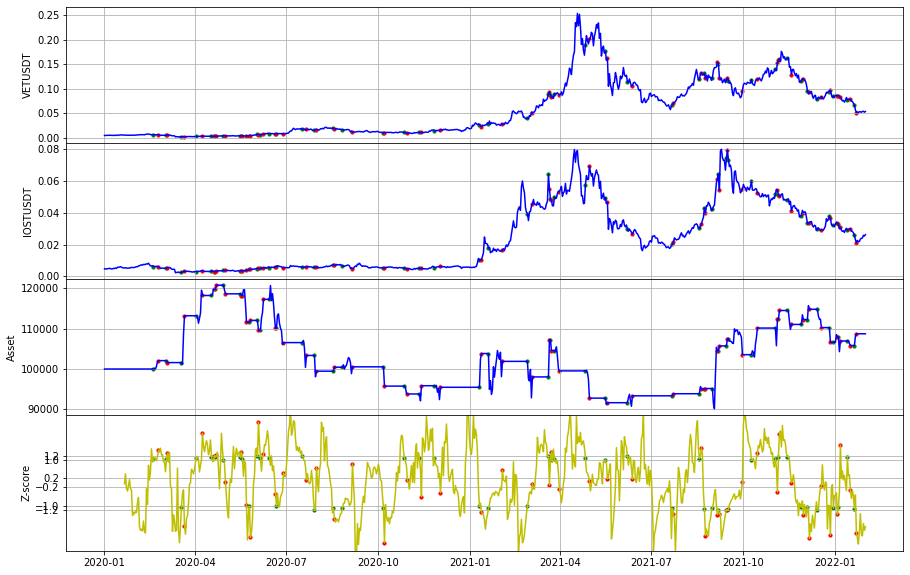

VETUSDT_THETAUSDT 回測結果
-----------------------------VETUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -35064.60365401
總交易次數:  65
平均損益:  -539.455440830974
勝率:  0.47692307692307695
獲利因子:  0.7405804215888235
賺賠比:  0.8122494946458064
最大資金回落:  59872.73675878893
夏普比率:  -0.0856391826676367


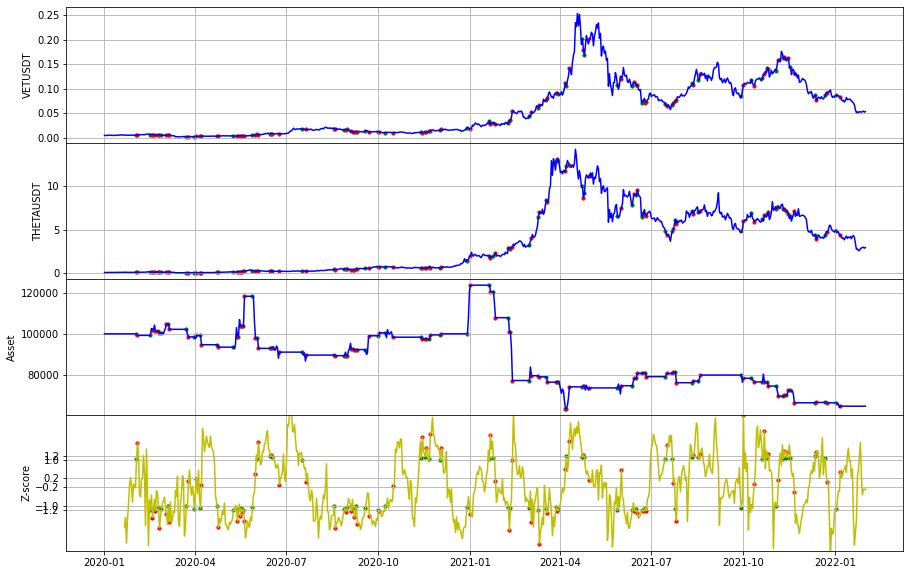

TFUELUSDT_BNBUSDT 回測結果
-----------------------------TFUELUSDT-BNBUSDT--------------------------
初始價格 100000
總損益:  38761.23536212
總交易次數:  52
平均損益:  745.4083723485505
勝率:  0.5192307692307693
獲利因子:  1.2724045805609692
賺賠比:  1.1781523894083046
最大資金回落:  63581.89420416608
夏普比率:  0.08421801220854001


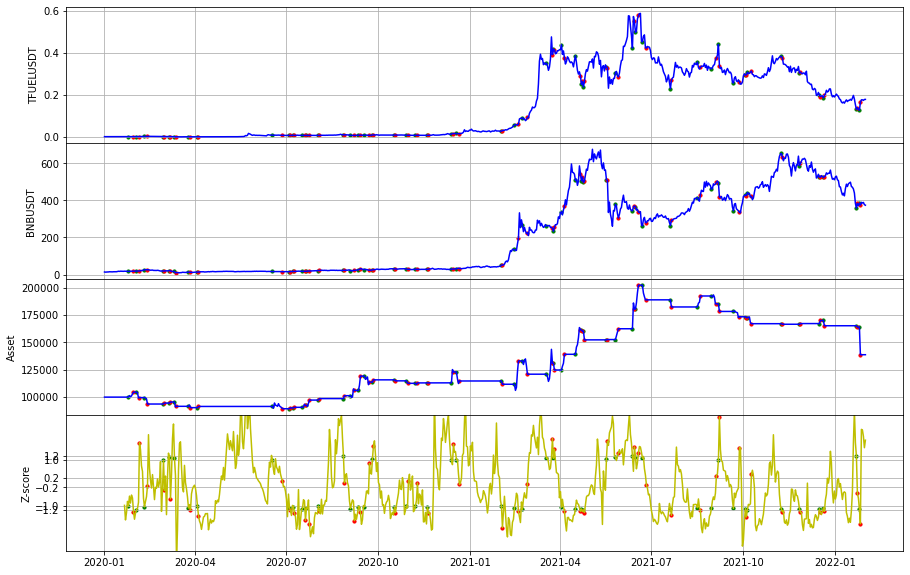

TFUELUSDT_NEOUSDT 回測結果
-----------------------------TFUELUSDT-NEOUSDT--------------------------
初始價格 100000
總損益:  32536.44030352
總交易次數:  58
平均損益:  560.9731086814005
勝率:  0.603448275862069
獲利因子:  1.3437626827978566
賺賠比:  0.8830440486957343
最大資金回落:  24234.44539382073
夏普比率:  0.0997771814666258


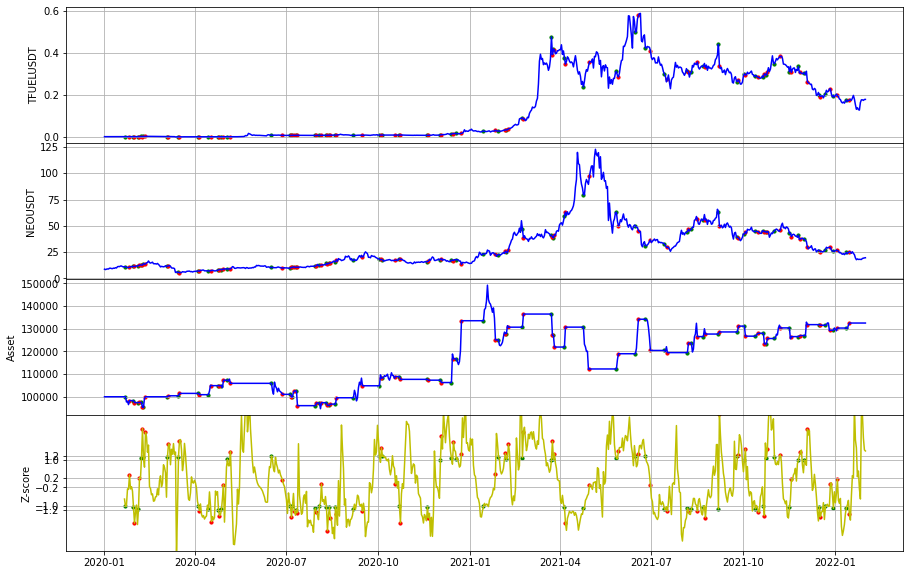

TFUELUSDT_QTUMUSDT 回測結果
-----------------------------TFUELUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  77550.45030682
總交易次數:  52
平均損益:  1491.3548135926999
勝率:  0.5
獲利因子:  1.6408954086350465
賺賠比:  1.6408954086350467
最大資金回落:  40035.63183006452
夏普比率:  0.1498429945723049


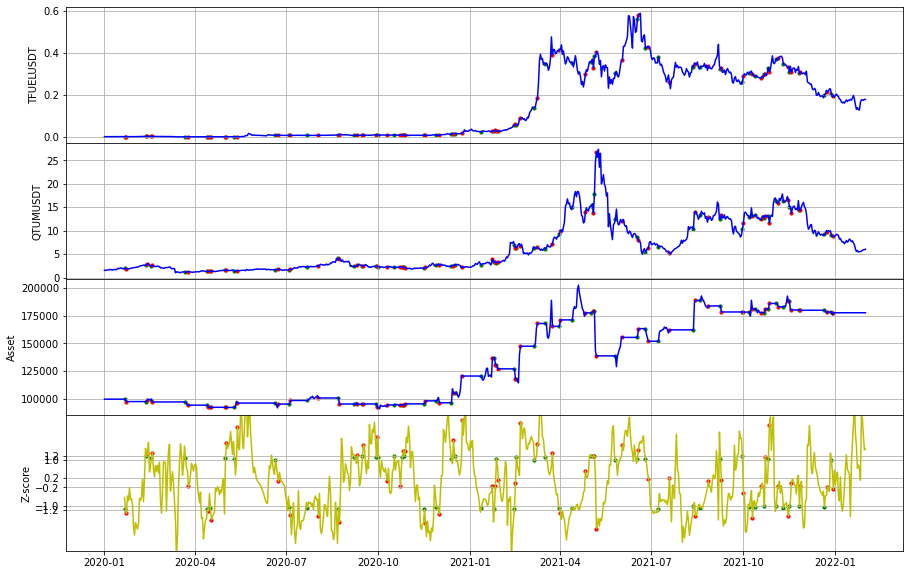

TFUELUSDT_ADAUSDT 回測結果
-----------------------------TFUELUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  28403.05743992
總交易次數:  53
平均損益:  535.9067441493938
勝率:  0.4528301886792453
獲利因子:  1.2444666785296445
賺賠比:  1.5037305698899872
最大資金回落:  41313.71593862792
夏普比率:  0.07888446992785053


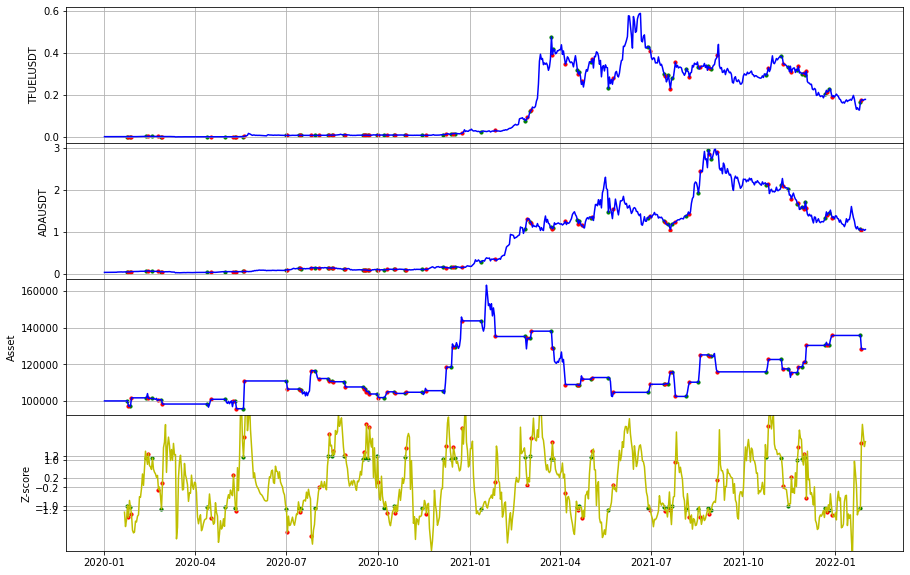

TFUELUSDT_XRPUSDT 回測結果
-----------------------------TFUELUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  -55366.43327162
總交易次數:  43
平均損益:  -1287.591471433094
勝率:  0.4418604651162791
獲利因子:  0.4136441947027035
賺賠比:  0.5224979301507834
最大資金回落:  65387.681401200985
夏普比率:  -0.1921509077983756


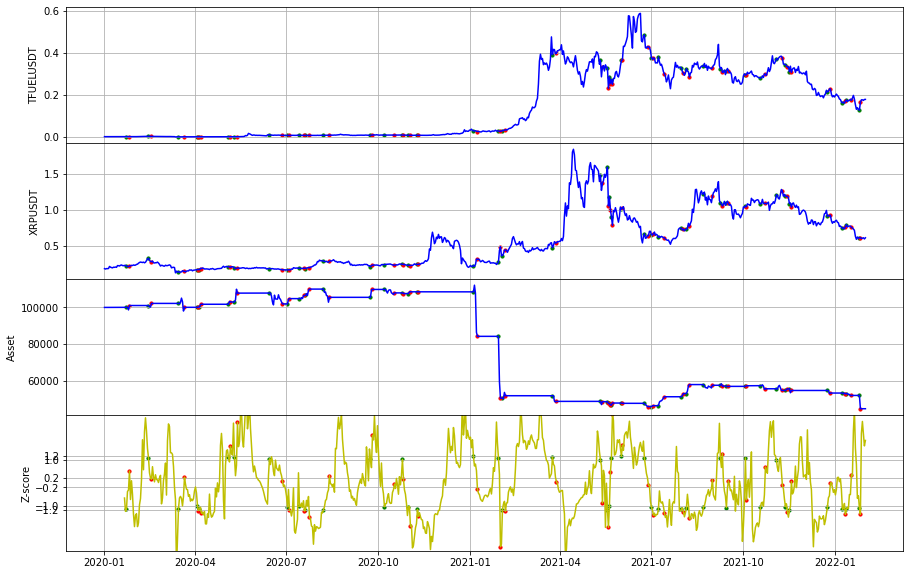

TFUELUSDT_IOTAUSDT 回測結果
-----------------------------TFUELUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  58078.58710399
總交易次數:  54
平均損益:  1075.5293908146666
勝率:  0.5185185185185185
獲利因子:  1.6143094776936107
賺賠比:  1.499001657858353
最大資金回落:  32699.372942689486
夏普比率:  0.16895157379540793


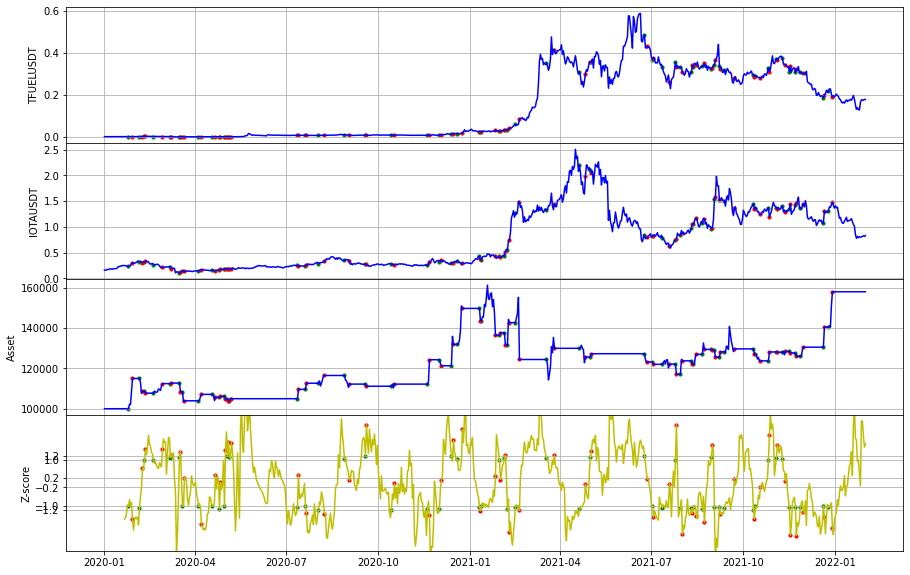

TFUELUSDT_TRXUSDT 回測結果
-----------------------------TFUELUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  4554.45255965
總交易次數:  45
平均損益:  101.21005688117778
勝率:  0.6
獲利因子:  1.060691781355123
賺賠比:  0.7071278542367487
最大資金回落:  29079.730373088998
夏普比率:  0.02068091420868233


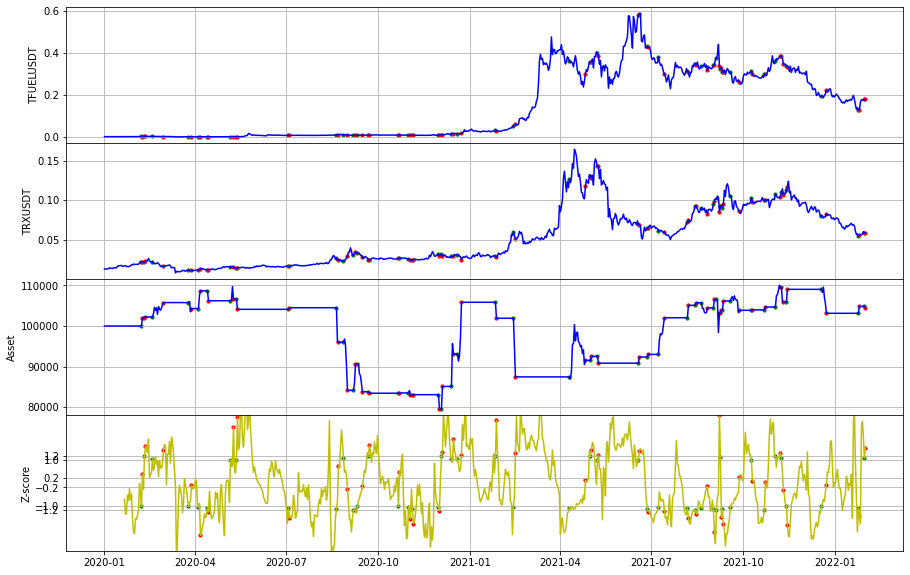

TFUELUSDT_ETCUSDT 回測結果
-----------------------------TFUELUSDT-ETCUSDT--------------------------
初始價格 100000
總損益:  208071.28721182
總交易次數:  46
平均損益:  4523.288852430965
勝率:  0.5652173913043478
獲利因子:  3.0031162066991794
賺賠比:  2.3100893897685992
最大資金回落:  27790.005324628262
夏普比率:  0.2499752024618592


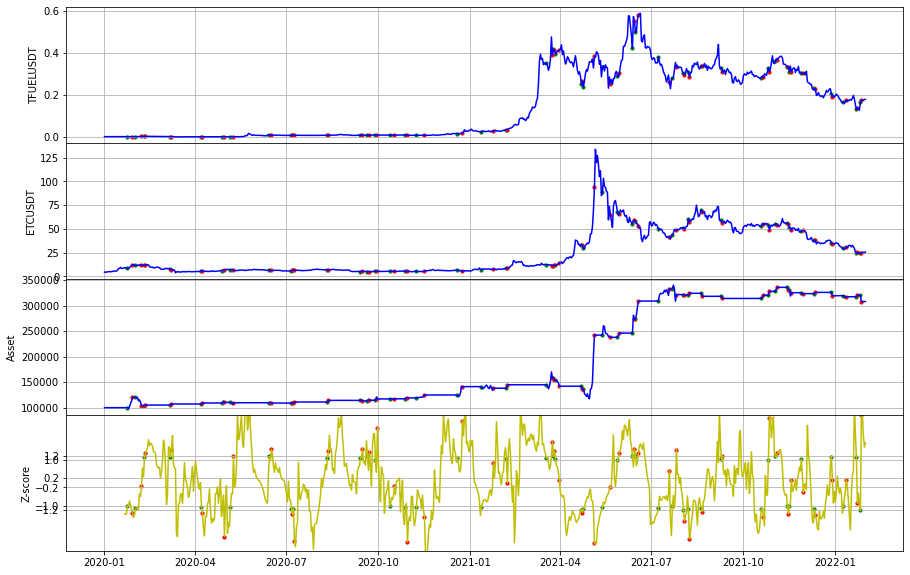

TFUELUSDT_VETUSDT 回測結果
-----------------------------TFUELUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  51470.24118700
總交易次數:  52
平均損益:  989.8123305191795
勝率:  0.6153846153846154
獲利因子:  1.385316973253466
賺賠比:  0.8658231082834162
最大資金回落:  32422.789138065316
夏普比率:  0.10077564589646365


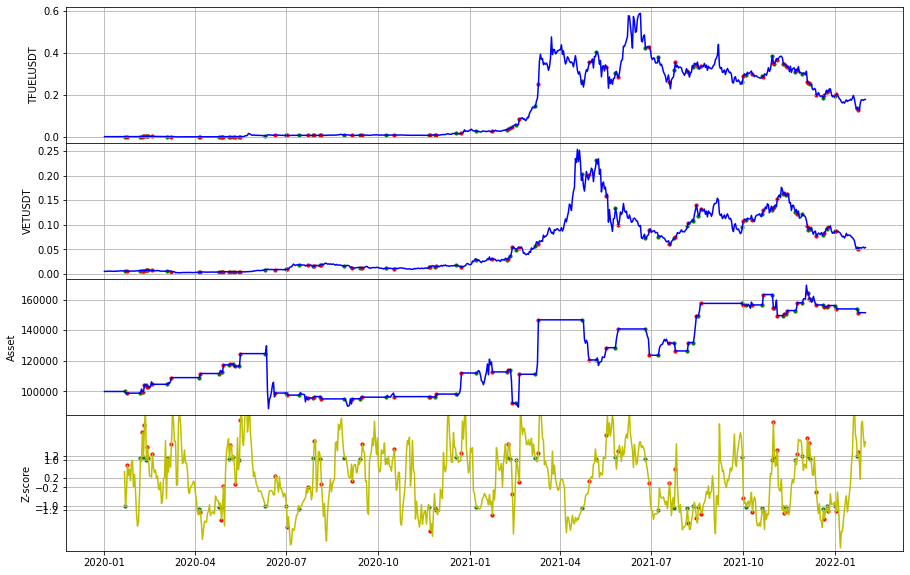

TFUELUSDT_WAVESUSDT 回測結果
-----------------------------TFUELUSDT-WAVESUSDT--------------------------
初始價格 100000
總損益:  -7380.93446740
總交易次數:  44
平均損益:  -167.74851062281695
勝率:  0.5909090909090909
獲利因子:  0.9133754368788034
賺賠比:  0.6323368409160947
最大資金回落:  50101.49897944594
夏普比率:  -0.02561017902752355


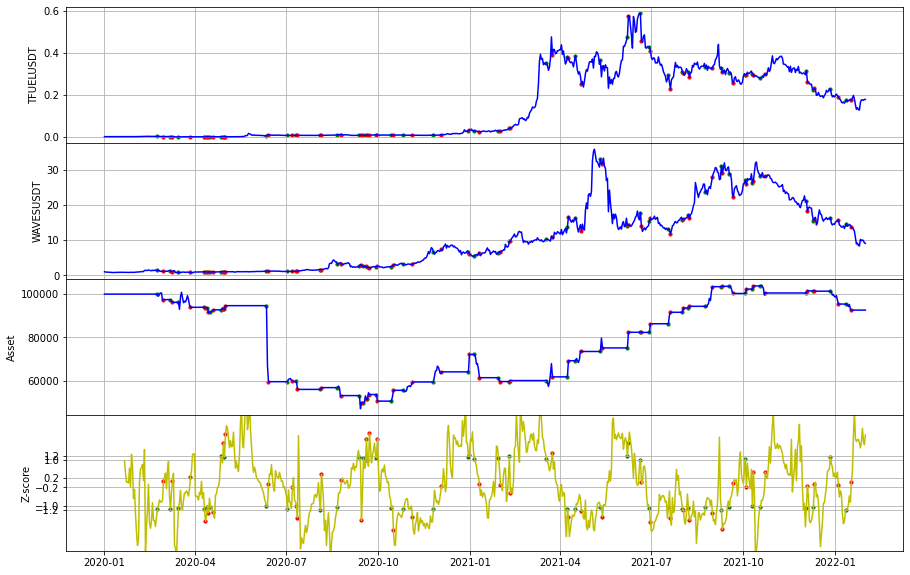

TFUELUSDT_ONGUSDT 回測結果，場上有單已平倉
-----------------------------TFUELUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  38994.06084131
總交易次數:  57
平均損益:  684.10633054937
勝率:  0.49122807017543857
獲利因子:  1.1743729071827806
賺賠比:  1.2163147967250227
最大資金回落:  70950.97207774862
夏普比率:  0.04126647676001803


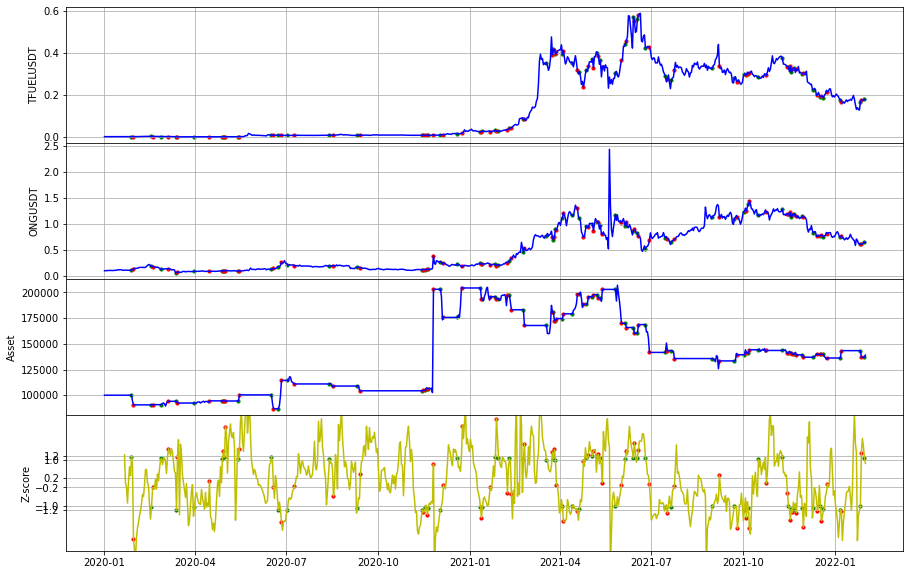

TFUELUSDT_HOTUSDT 回測結果
-----------------------------TFUELUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  4910.60952759
總交易次數:  44
平均損益:  111.60476199076352
勝率:  0.45454545454545453
獲利因子:  1.0679666667053966
賺賠比:  1.2815600000464757
最大資金回落:  19291.902318323817
夏普比率:  0.022812461746279853


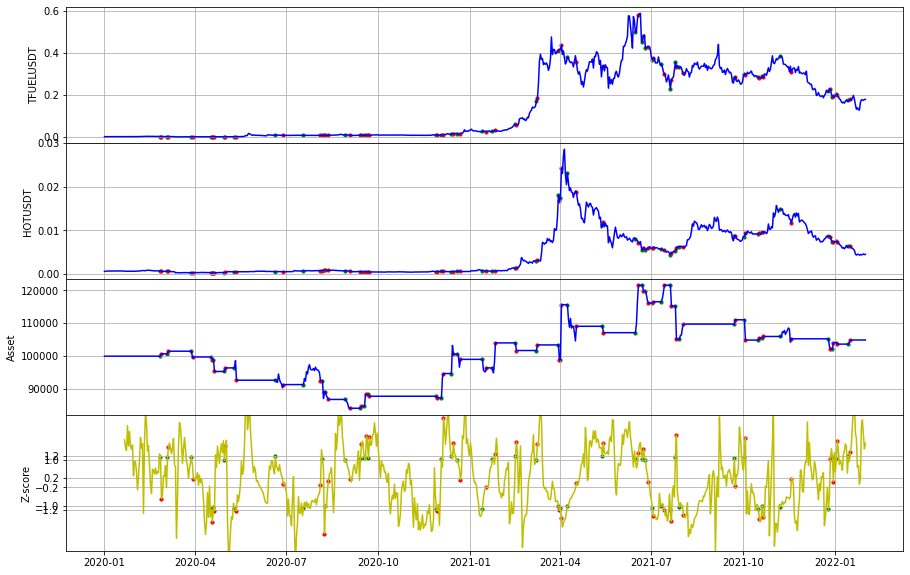

TFUELUSDT_XMRUSDT 回測結果
-----------------------------TFUELUSDT-XMRUSDT--------------------------
初始價格 100000
總損益:  5724.69625560
總交易次數:  62
平均損益:  92.33381057425305
勝率:  0.5967741935483871
獲利因子:  1.0536853784404518
賺賠比:  0.7119495800273322
最大資金回落:  29385.55213445981
夏普比率:  0.019517118179233472


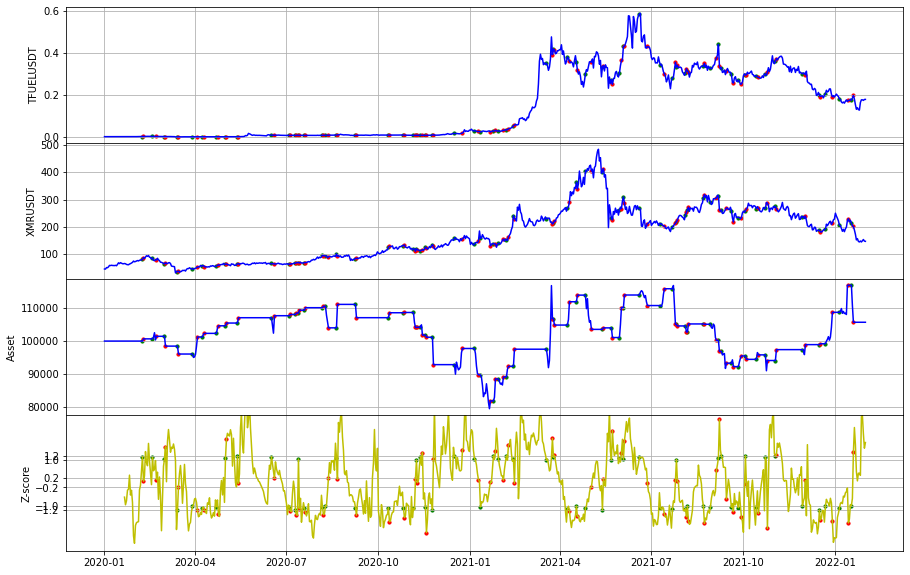

TFUELUSDT_IOSTUSDT 回測結果，場上有單已平倉
-----------------------------TFUELUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  -39397.57962420
總交易次數:  55
平均損益:  -716.3196295309692
勝率:  0.5818181818181818
獲利因子:  0.6220823587966228
賺賠比:  0.4276816216726781
最大資金回落:  69953.25588150774
夏普比率:  -0.12787811273619054


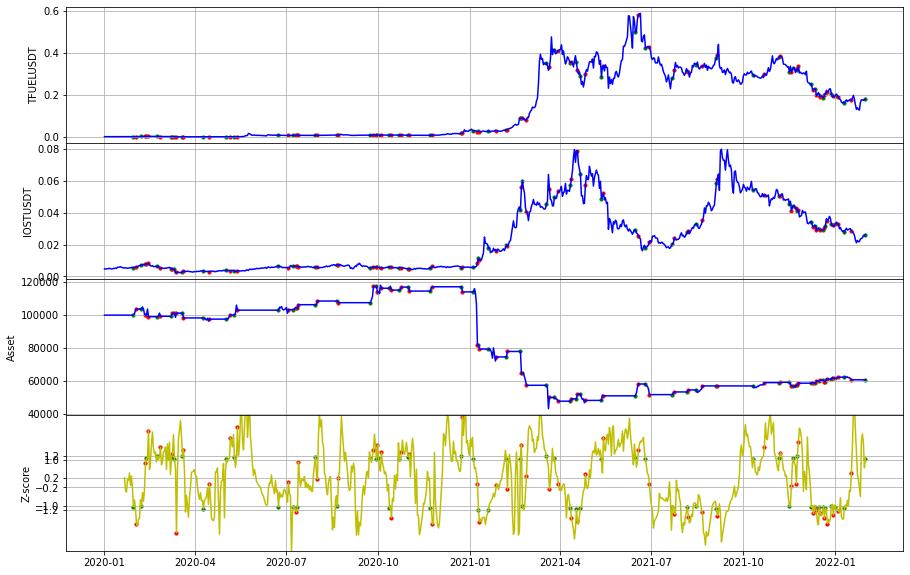

TFUELUSDT_MITHUSDT 回測結果
-----------------------------TFUELUSDT-MITHUSDT--------------------------
初始價格 100000
總損益:  -20559.23270739
總交易次數:  60
平均損益:  -342.65387845654357
勝率:  0.4
獲利因子:  0.8564789247505787
賺賠比:  1.2847183871258683
最大資金回落:  67661.89163671549
夏普比率:  -0.04260284329201871


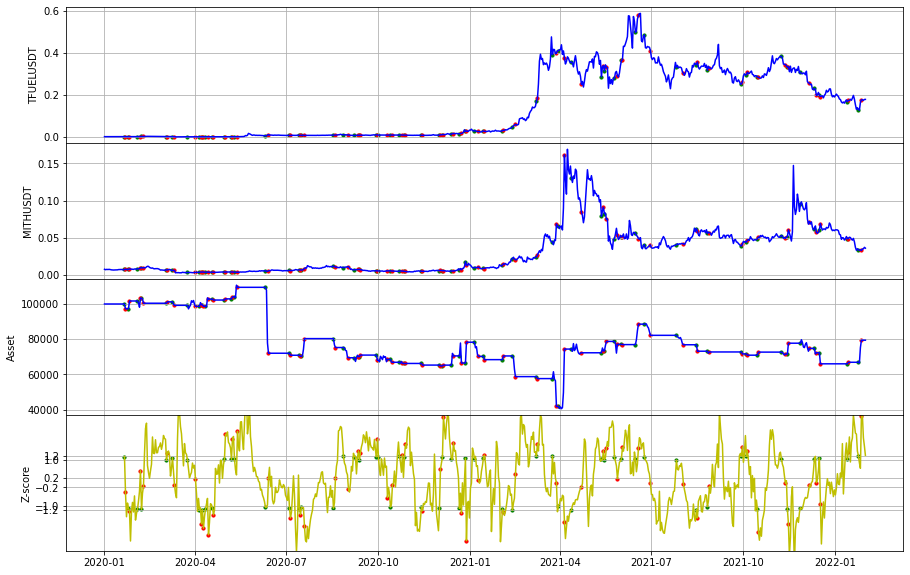

LINKUSDT_LTCUSDT 回測結果
-----------------------------LINKUSDT-LTCUSDT--------------------------
初始價格 100000
總損益:  -11995.77651504
總交易次數:  60
平均損益:  -199.9296085839269
勝率:  0.43333333333333335
獲利因子:  0.8578436003628525
賺賠比:  1.1217954773975762
最大資金回落:  27018.435646523067
夏普比率:  -0.0536114730607493


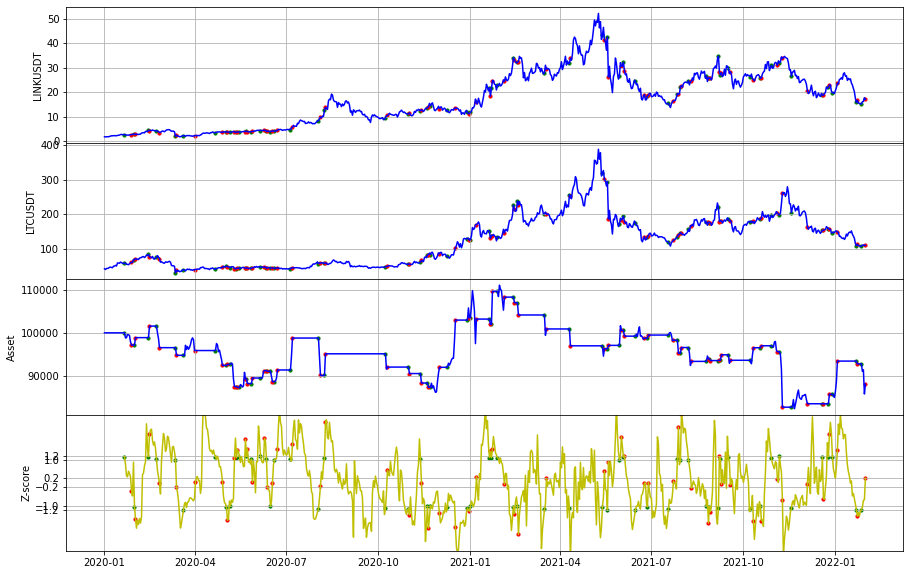

LINKUSDT_ICXUSDT 回測結果
-----------------------------LINKUSDT-ICXUSDT--------------------------
初始價格 100000
總損益:  -60273.32095192
總交易次數:  50
平均損益:  -1205.4664190383928
勝率:  0.44
獲利因子:  0.3761291607411222
賺賠比:  0.4787098409432464
最大資金回落:  61672.390060246005
夏普比率:  -0.30454966529584804


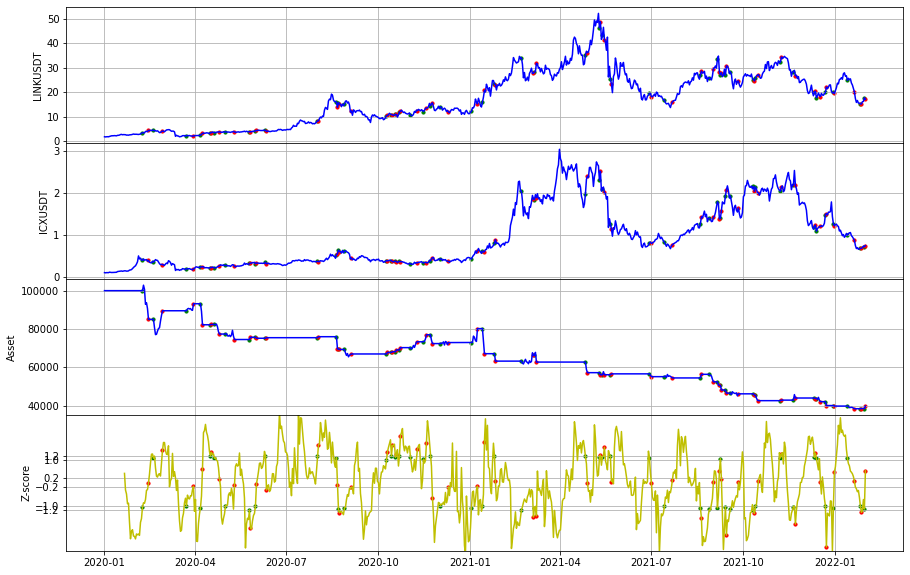

LINKUSDT_TFUELUSDT 回測結果
-----------------------------LINKUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  143844.22781591
總交易次數:  60
平均損益:  2397.403796931775
勝率:  0.5833333333333334
獲利因子:  1.882174712849886
賺賠比:  1.34441050917849
最大資金回落:  57473.839265595336
夏普比率:  0.20866566691822738


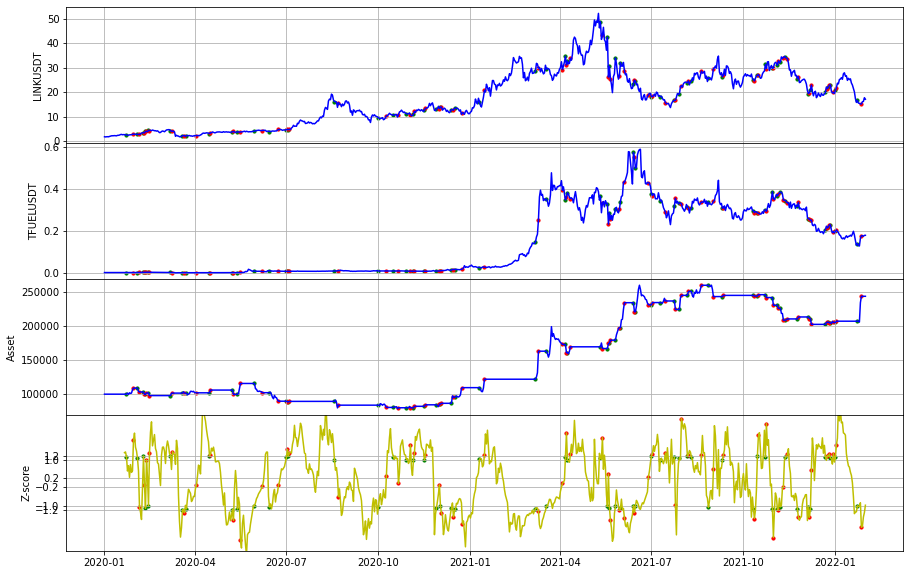

LINKUSDT_ZRXUSDT 回測結果
-----------------------------LINKUSDT-ZRXUSDT--------------------------
初始價格 100000
總損益:  -4224.69129405
總交易次數:  63
平均損益:  -67.0585919690202
勝率:  0.4126984126984127
獲利因子:  0.9638590356104412
賺賠比:  1.3716455506763972
最大資金回落:  46512.50796828879
夏普比率:  -0.012040732104104142


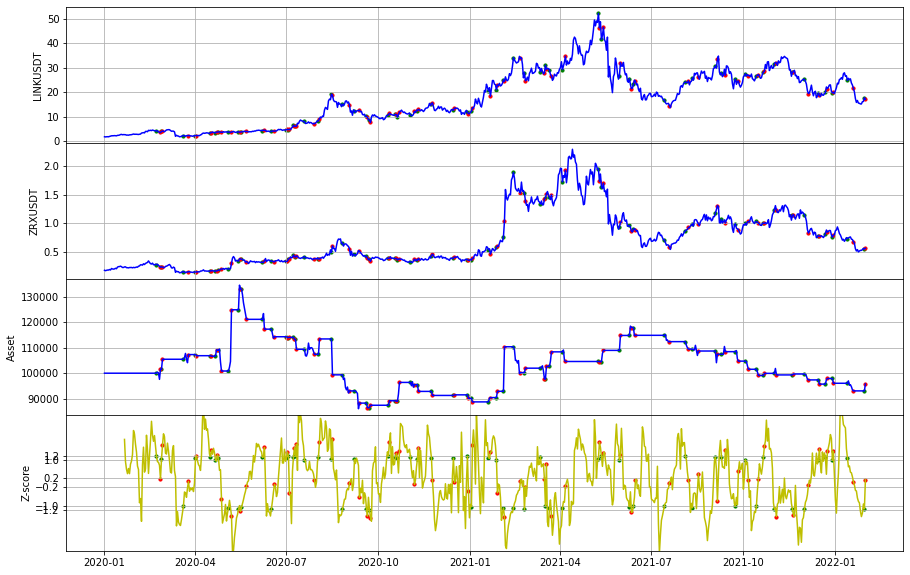

WAVESUSDT_ADAUSDT 回測結果
-----------------------------WAVESUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  7927.31939840
總交易次數:  45
平均損益:  176.16265329778997
勝率:  0.4444444444444444
獲利因子:  1.0909731999509185
賺賠比:  1.363716499938648
最大資金回落:  38655.211144948786
夏普比率:  0.030416616375804752


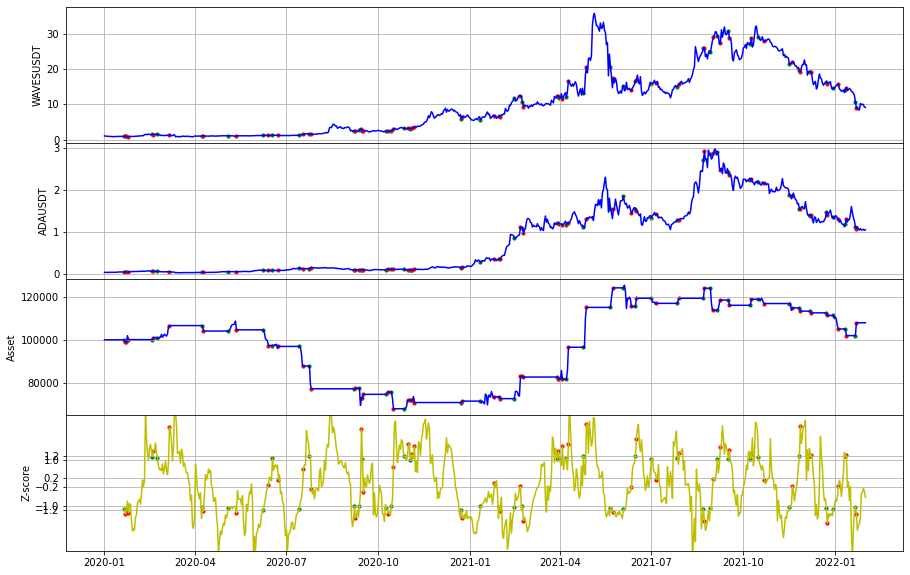

WAVESUSDT_XRPUSDT 回測結果
-----------------------------WAVESUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  -52240.37793556
總交易次數:  47
平均損益:  -1111.497402884225
勝率:  0.40425531914893614
獲利因子:  0.4011300888480317
賺賠比:  0.5911390783023625
最大資金回落:  56620.56354693817
夏普比率:  -0.22637593273902124


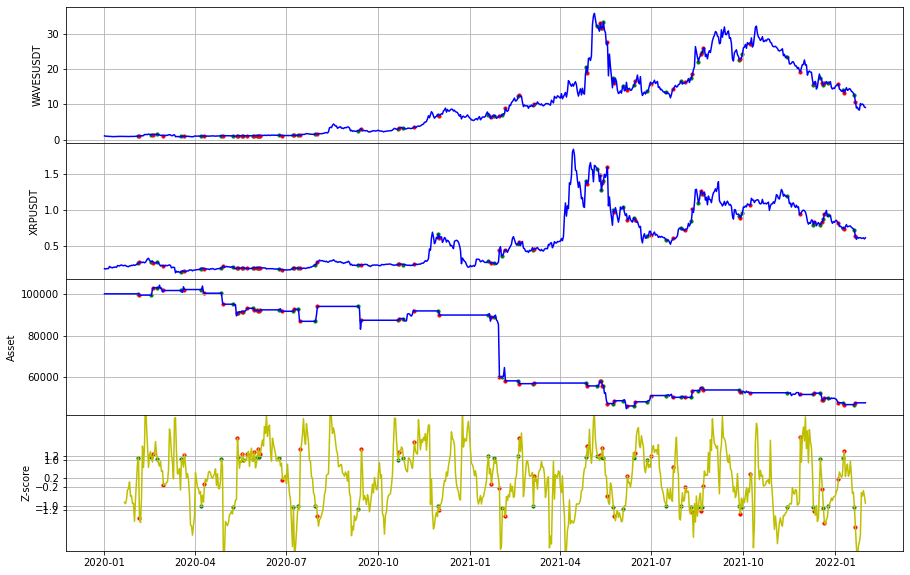

WAVESUSDT_TRXUSDT 回測結果，場上有單已平倉
-----------------------------WAVESUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  -12376.32634259
總交易次數:  54
平均損益:  -229.19122856643204
勝率:  0.48148148148148145
獲利因子:  0.8514396299274247
賺賠比:  0.9169349860756881
最大資金回落:  35915.801863657936
夏普比率:  -0.05847277460351913


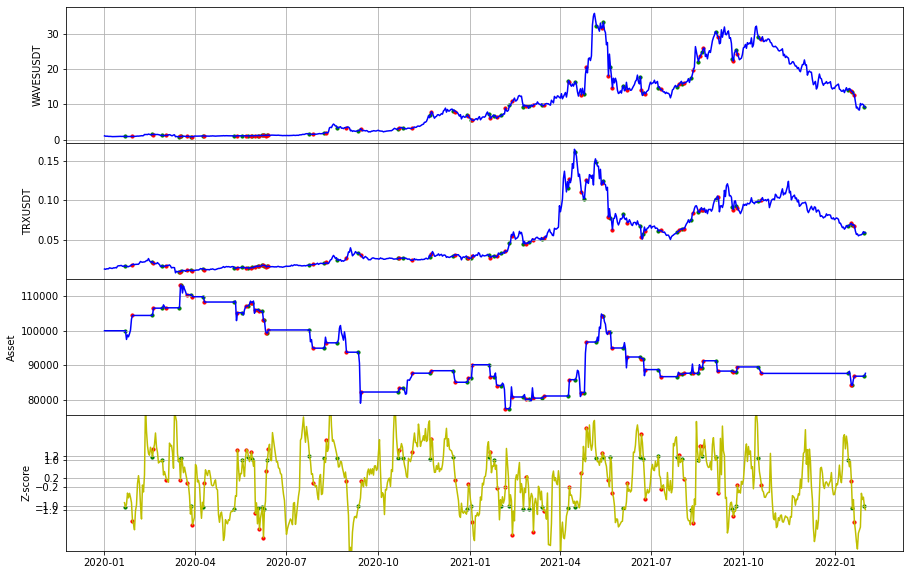

WAVESUSDT_VETUSDT 回測結果
-----------------------------WAVESUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -13923.94723152
總交易次數:  50
平均損益:  -278.47894463041916
勝率:  0.5
獲利因子:  0.8554318140768651
賺賠比:  0.8554318140768651
最大資金回落:  32445.967234609037
夏普比率:  -0.056403578669730635


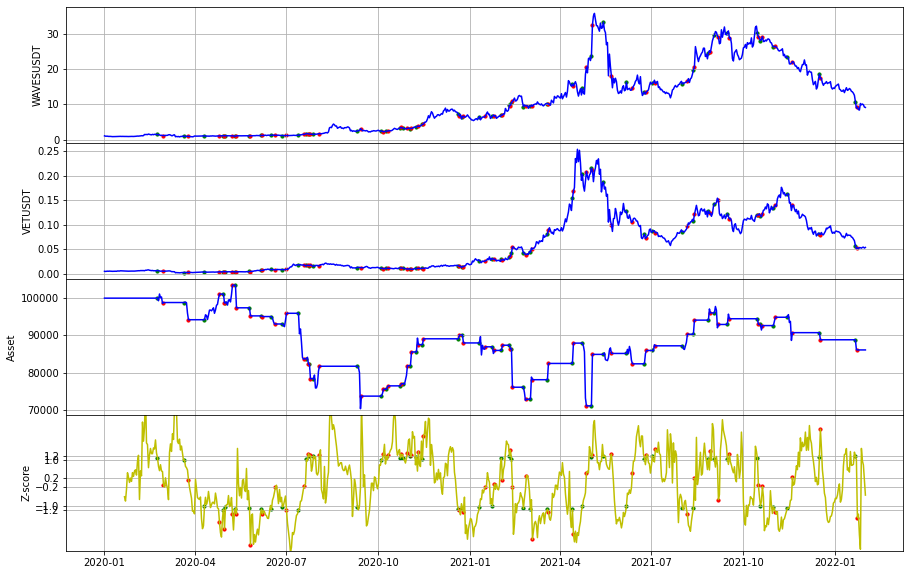

WAVESUSDT_TFUELUSDT 回測結果
-----------------------------WAVESUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  8423.69653504
總交易次數:  48
平均損益:  175.4936778133439
勝率:  0.5
獲利因子:  1.0911140863164275
賺賠比:  1.0911140863164273
最大資金回落:  35037.59774474663
夏普比率:  0.031990492753386224


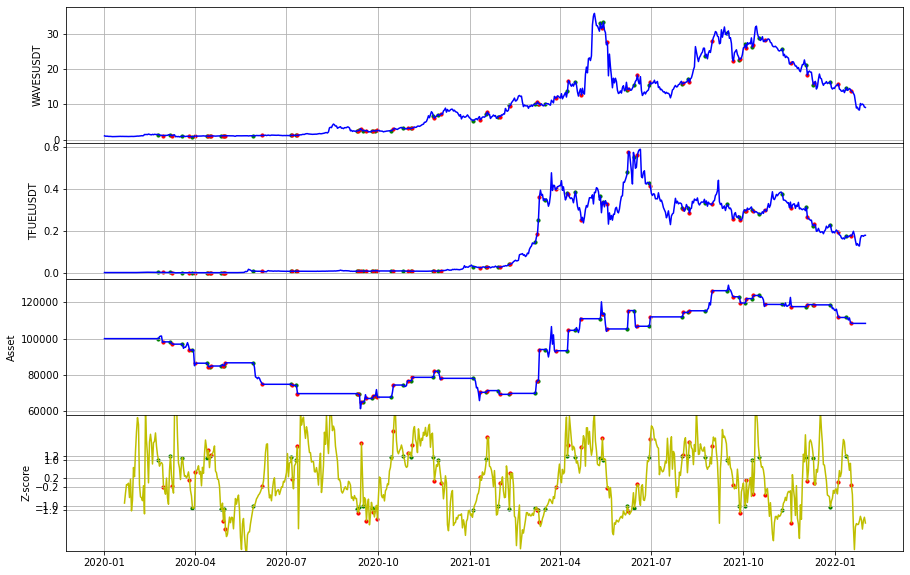

WAVESUSDT_ONGUSDT 回測結果
-----------------------------WAVESUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -33244.88899825
總交易次數:  40
平均損益:  -831.1222249562801
勝率:  0.6
獲利因子:  0.8314413551837618
賺賠比:  0.5542942367891746
最大資金回落:  148356.83044502232
夏普比率:  -0.04520086223797467


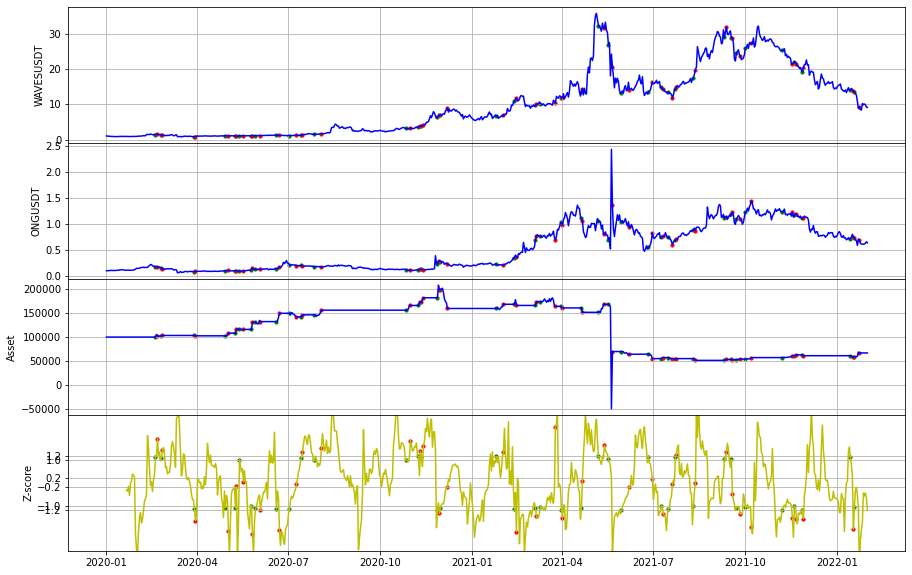

WAVESUSDT_HOTUSDT 回測結果
-----------------------------WAVESUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  234680.10401804
總交易次數:  40
平均損益:  5867.0026004510755
勝率:  0.5
獲利因子:  2.470429920771057
賺賠比:  2.470429920771057
最大資金回落:  58306.6801170712
夏普比率:  0.19755684812257007


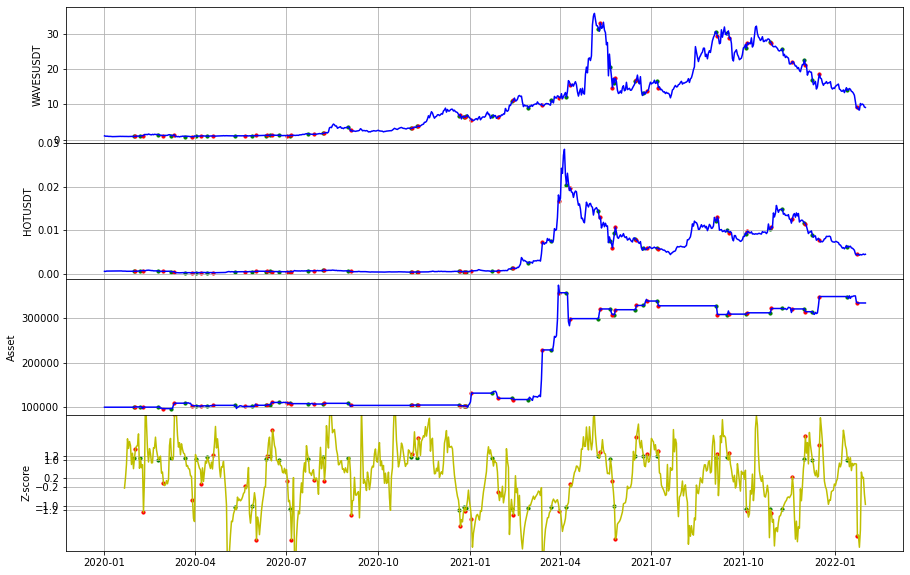

WAVESUSDT_FETUSDT 回測結果
-----------------------------WAVESUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  52400.67895978
總交易次數:  69
平均損益:  759.430129851841
勝率:  0.5217391304347826
獲利因子:  1.2594543322912615
賺賠比:  1.154499804600323
最大資金回落:  60256.634758800414
夏普比率:  0.08753618839343098


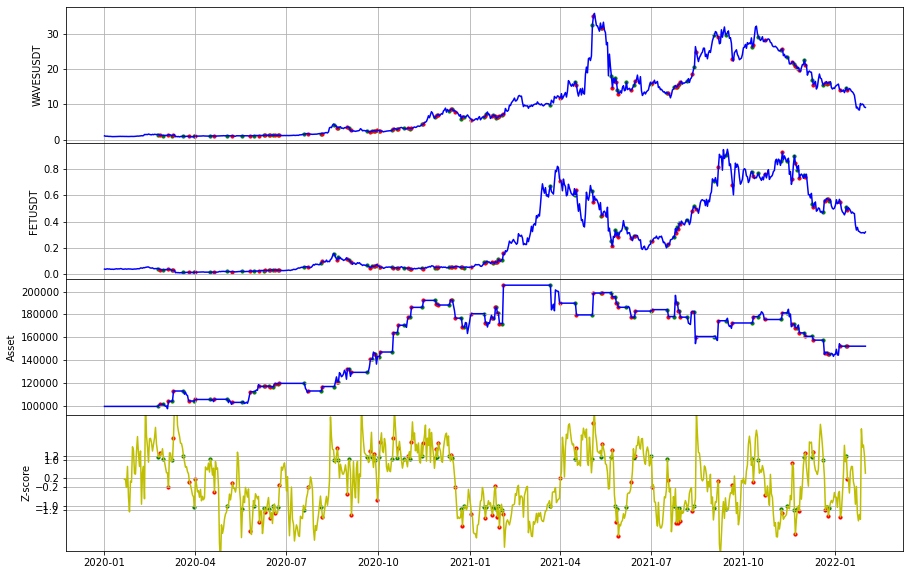

WAVESUSDT_OMGUSDT 回測結果
-----------------------------WAVESUSDT-OMGUSDT--------------------------
初始價格 100000
總損益:  -18847.85739988
總交易次數:  47
平均損益:  -401.01824255069494
勝率:  0.44680851063829785
獲利因子:  0.797580492192674
賺賠比:  0.9874806093814059
最大資金回落:  38560.809759665455
夏普比率:  -0.05870670027076651


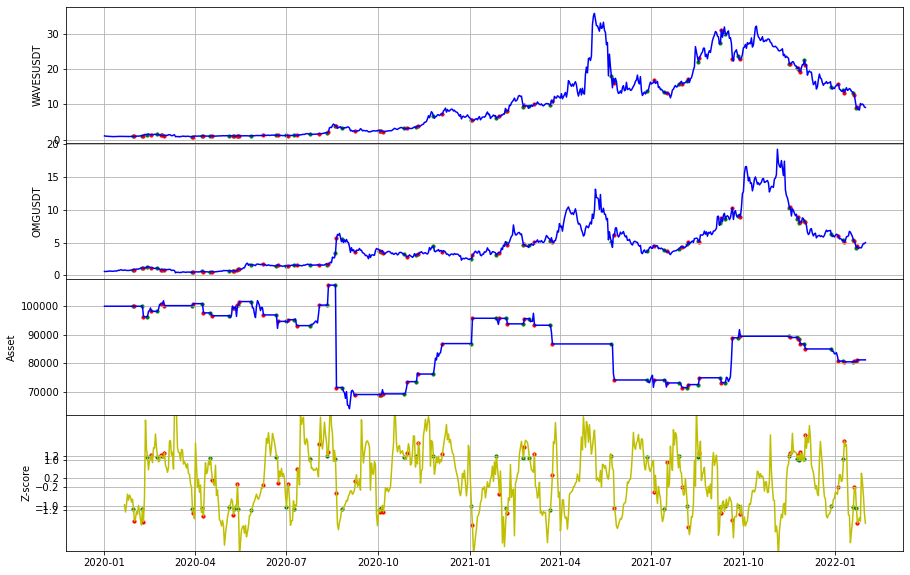

WAVESUSDT_THETAUSDT 回測結果
-----------------------------WAVESUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -34316.17282930
總交易次數:  56
平均損益:  -612.7888005231717
勝率:  0.48214285714285715
獲利因子:  0.7814375296741142
賺賠比:  0.839321791131456
最大資金回落:  67404.56482191023
夏普比率:  -0.07330712289964574


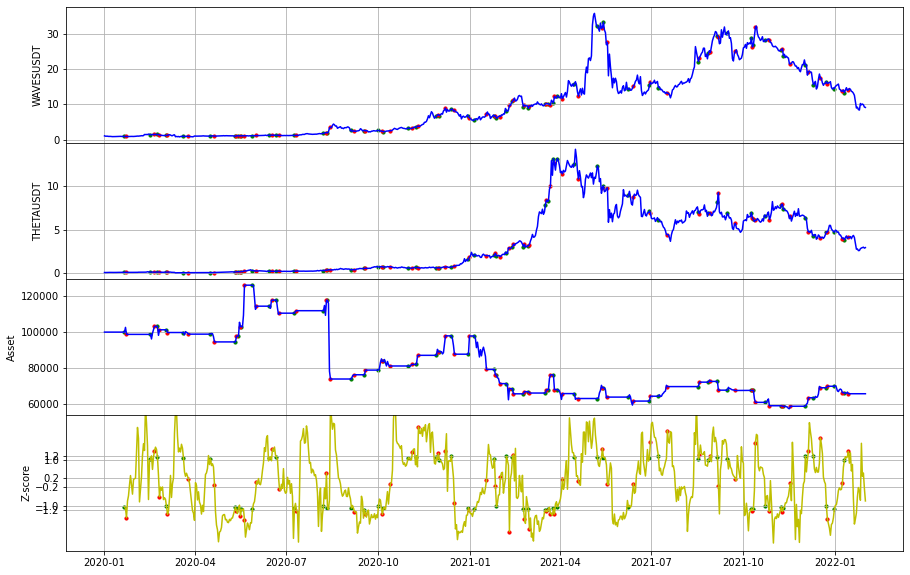

ONGUSDT_ETHUSDT 回測結果
-----------------------------ONGUSDT-ETHUSDT--------------------------
初始價格 100000
總損益:  13986.95978200
總交易次數:  54
平均損益:  259.0177737407532
勝率:  0.6851851851851852
獲利因子:  1.0534335910682258
賺賠比:  0.48401002832864426
最大資金回落:  172725.3435013662
夏普比率:  0.010529939073263


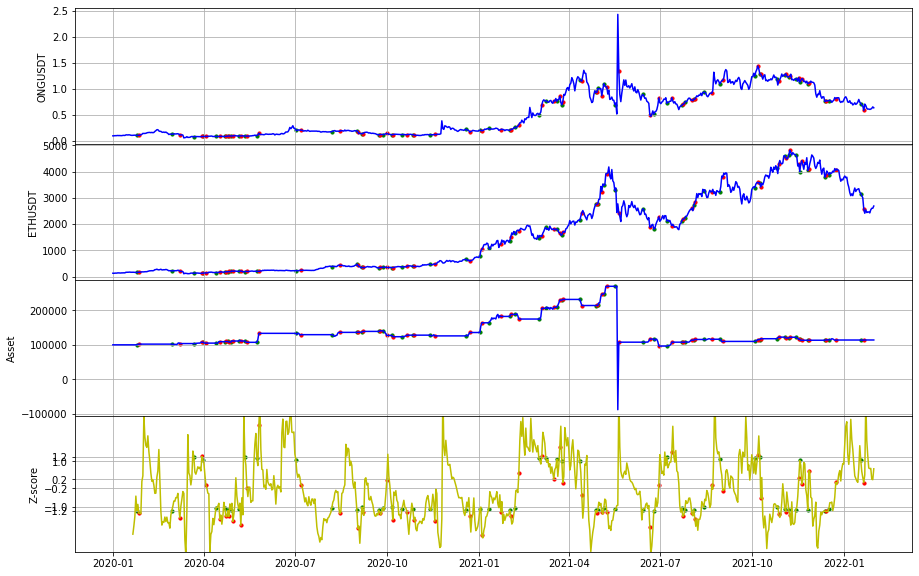

ONGUSDT_BNBUSDT 回測結果，場上有單已平倉
-----------------------------ONGUSDT-BNBUSDT--------------------------
初始價格 100000
總損益:  84207.45022123
總交易次數:  51
平均損益:  1651.1264749260554
勝率:  0.47058823529411764
獲利因子:  1.9539638027832305
賺賠比:  2.116794119681833
最大資金回落:  19659.316511616693
夏普比率:  0.2259435407274066


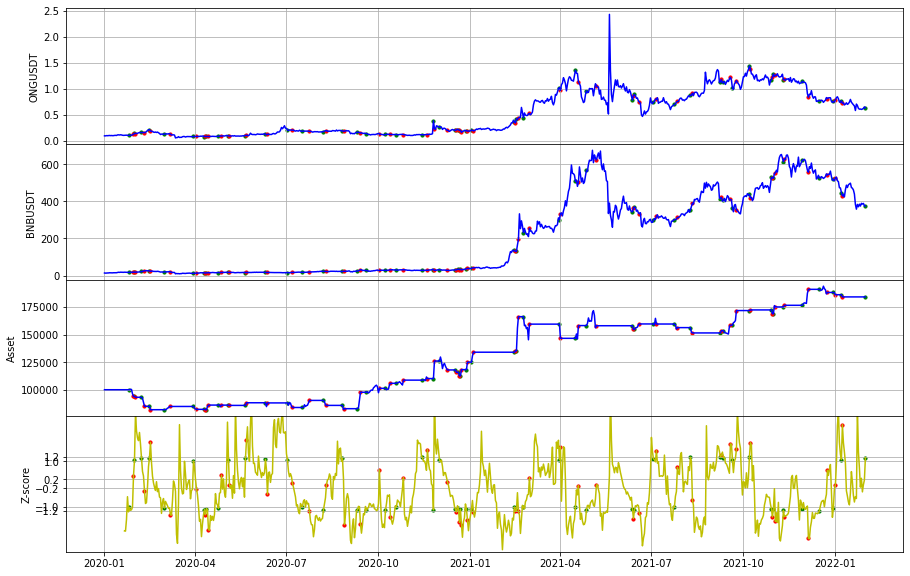

ONGUSDT_QTUMUSDT 回測結果，場上有單已平倉
-----------------------------ONGUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  -78790.03167416
總交易次數:  53
平均損益:  -1486.6043712106273
勝率:  0.4716981132075472
獲利因子:  0.6433846614171848
賺賠比:  0.7205908207872469
最大資金回落:  153347.57747610184
夏普比率:  -0.0649882939144102


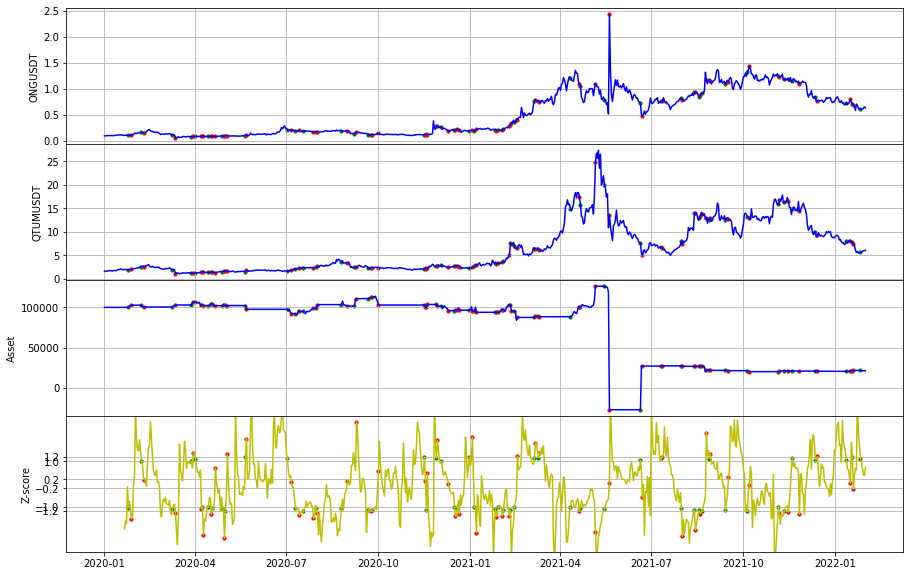

ONGUSDT_ADAUSDT 回測結果
-----------------------------ONGUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  -25453.54556255
總交易次數:  60
平均損益:  -424.2257593758812
勝率:  0.5
獲利因子:  0.7835993807241575
賺賠比:  0.7835993807241575
最大資金回落:  54181.429205125096
夏普比率:  -0.07821251685467179


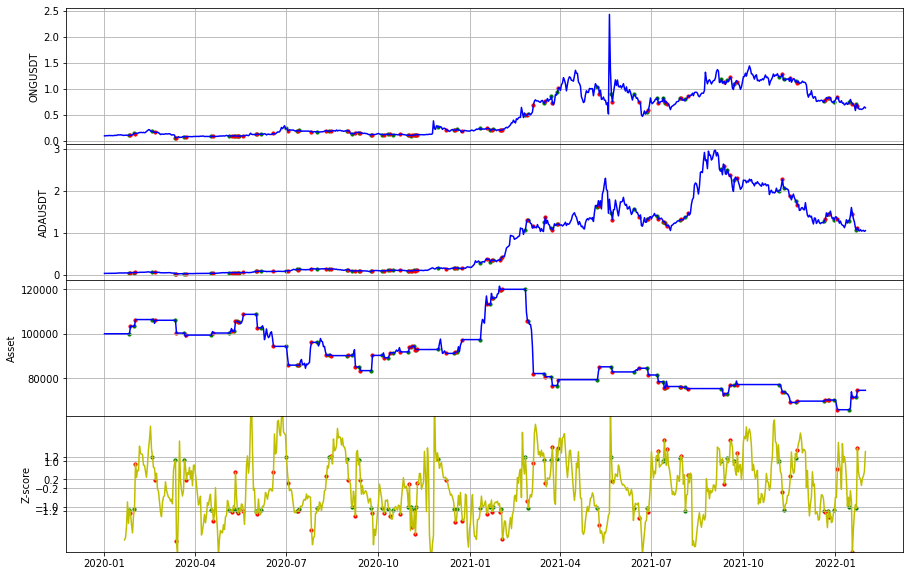

ONGUSDT_XRPUSDT 回測結果
-----------------------------ONGUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  -20909.79682413
總交易次數:  52
平均損益:  -402.11147738717966
勝率:  0.4230769230769231
獲利因子:  0.7536692863519687
賺賠比:  1.027730845025412
最大資金回落:  39957.21502488233
夏普比率:  -0.09929797242726776


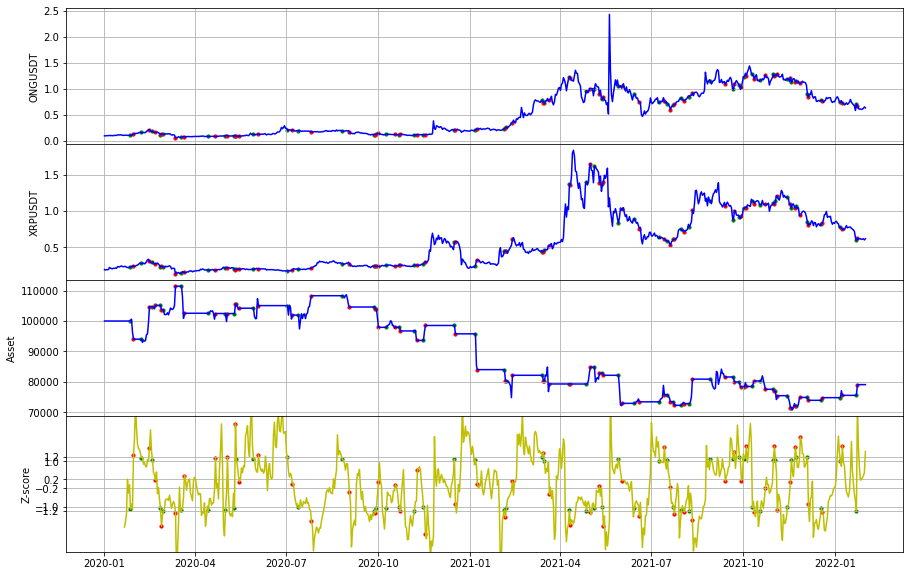

ONGUSDT_IOTAUSDT 回測結果，場上有單已平倉
-----------------------------ONGUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  -38278.97300141
總交易次數:  48
平均損益:  -797.4786041961346
勝率:  0.4583333333333333
獲利因子:  0.6371333755791274
賺賠比:  0.7240151995217358
最大資金回落:  50832.9670571673
夏普比率:  -0.1494901645499555


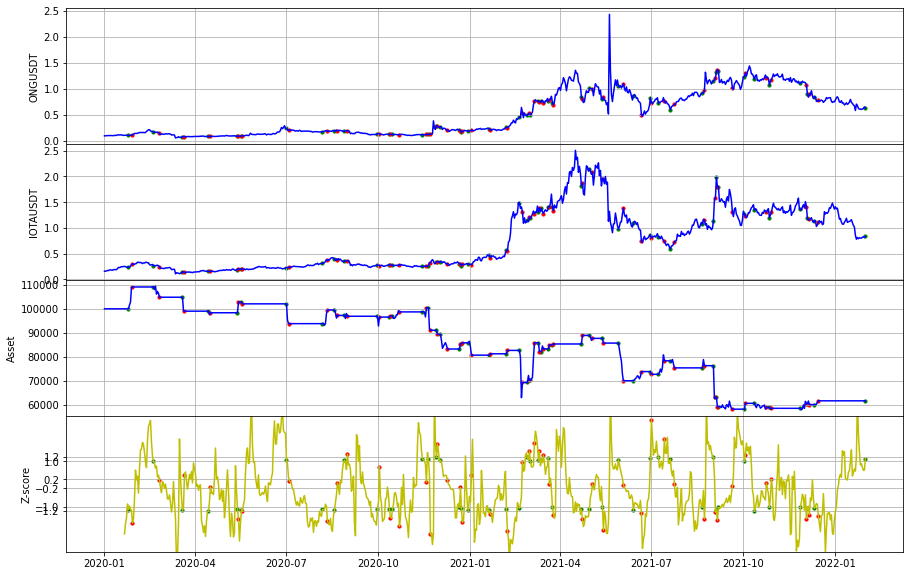

ONGUSDT_TRXUSDT 回測結果
-----------------------------ONGUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  -40599.09517131
總交易次數:  47
平均損益:  -863.8105355597315
勝率:  0.3404255319148936
獲利因子:  0.48724766114094137
賺賠比:  0.9440423434605739
最大資金回落:  43731.17142080498
夏普比率:  -0.20442471276023758


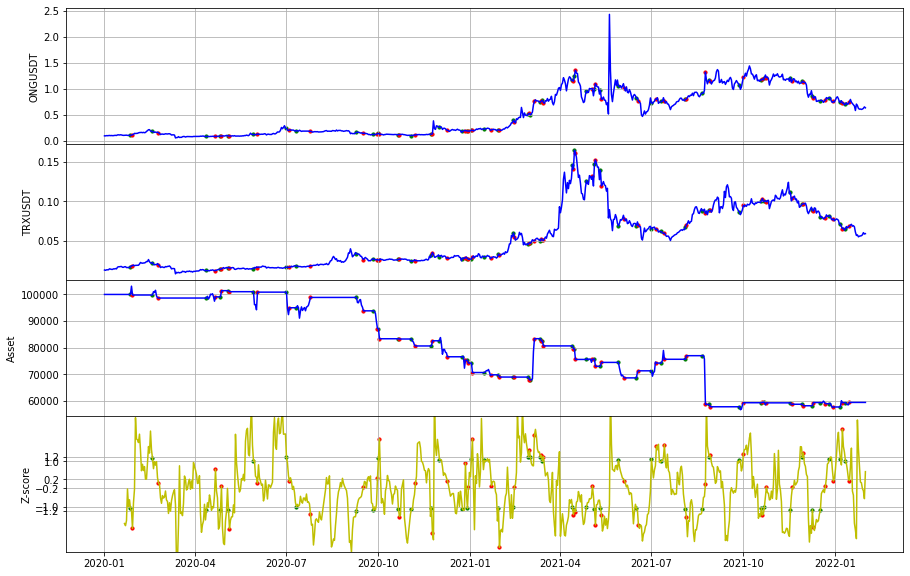

ONGUSDT_VETUSDT 回測結果
-----------------------------ONGUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -20763.13911817
總交易次數:  64
平均損益:  -324.4240487214788
勝率:  0.4375
獲利因子:  0.8423364232936202
賺賠比:  1.0830039728060832
最大資金回落:  46535.831984855206
夏普比率:  -0.06069418111275623


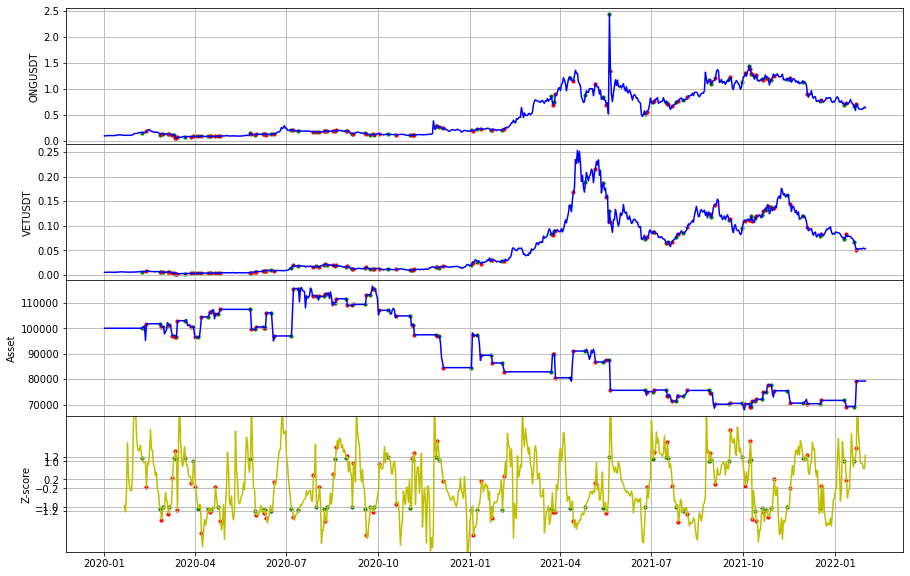

ONGUSDT_TFUELUSDT 回測結果，場上有單已平倉
-----------------------------ONGUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  77004.02620450
總交易次數:  59
平均損益:  1305.152986516928
勝率:  0.5084745762711864
獲利因子:  1.5128421876288112
賺賠比:  1.4624141147078507
最大資金回落:  31333.269755838555
夏普比率:  0.10771663270705539


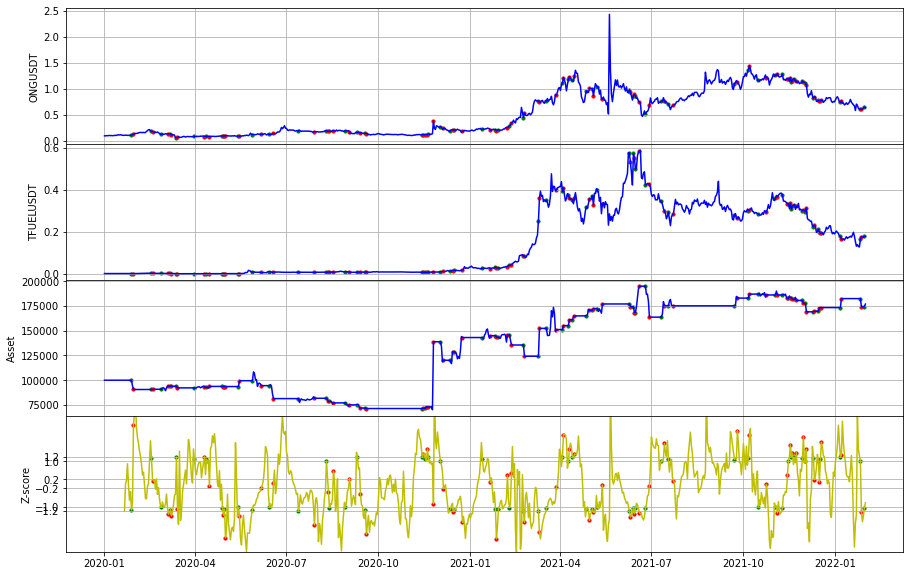

ONGUSDT_WAVESUSDT 回測結果，場上有單已平倉
-----------------------------ONGUSDT-WAVESUSDT--------------------------
初始價格 100000
總損益:  -12253.02502928
總交易次數:  47
平均損益:  -260.70266019744537
勝率:  0.574468085106383
獲利因子:  0.9364915706740207
賺賠比:  0.6590125867706071
最大資金回落:  126787.7604036
夏普比率:  -0.015412135571135285


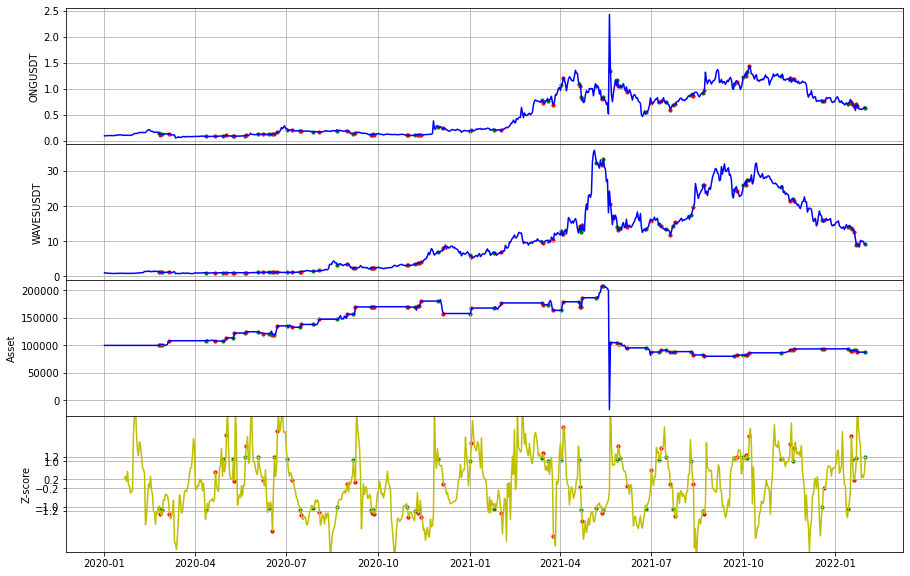

ONGUSDT_HOTUSDT 回測結果
-----------------------------ONGUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  -34388.87250331
總交易次數:  62
平均損益:  -554.6592339243831
勝率:  0.5
獲利因子:  0.7813235676448549
賺賠比:  0.7813235676448549
最大資金回落:  96982.71062748203
夏普比率:  -0.05416546364499212


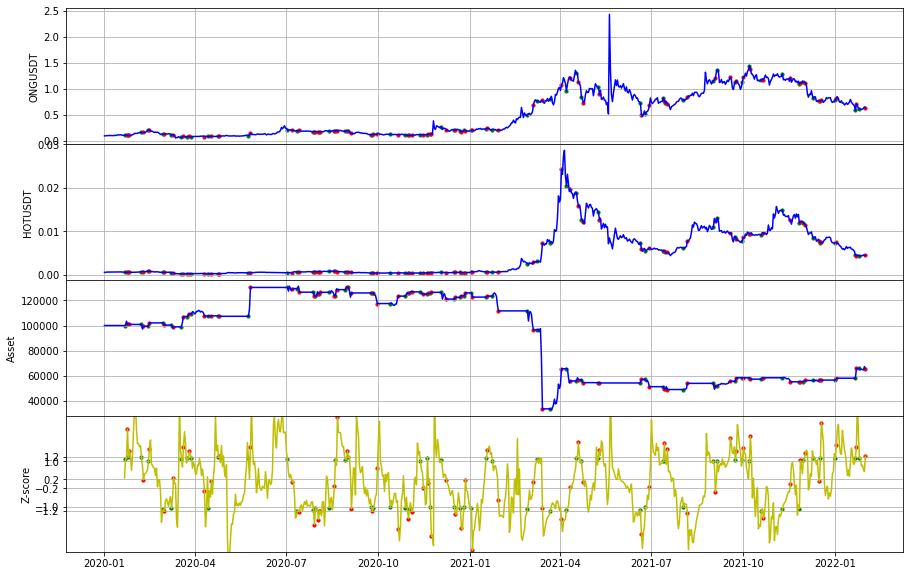

ONGUSDT_FETUSDT 回測結果
-----------------------------ONGUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  -48820.25940082
總交易次數:  49
平均損益:  -996.3318245065989
勝率:  0.3469387755102041
獲利因子:  0.6299220678792427
賺賠比:  1.1857356571844568
最大資金回落:  102150.34565356105
夏普比率:  -0.1557305555293033


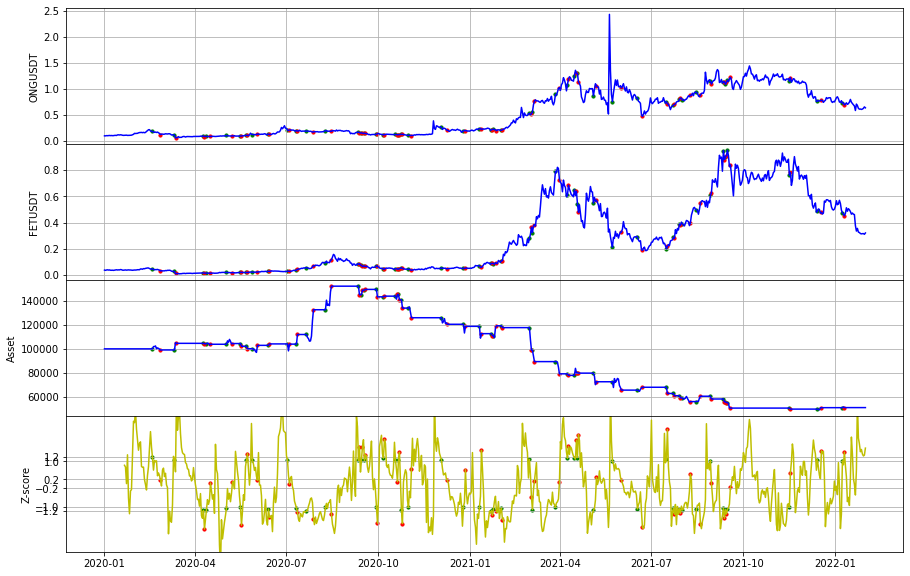

ONGUSDT_ZECUSDT 回測結果
-----------------------------ONGUSDT-ZECUSDT--------------------------
初始價格 100000
總損益:  -70682.83813331
總交易次數:  54
平均損益:  -1308.9414469131386
勝率:  0.5
獲利因子:  0.6743359127642684
賺賠比:  0.6743359127642684
最大資金回落:  145079.4138779419
夏普比率:  -0.06069392372655137


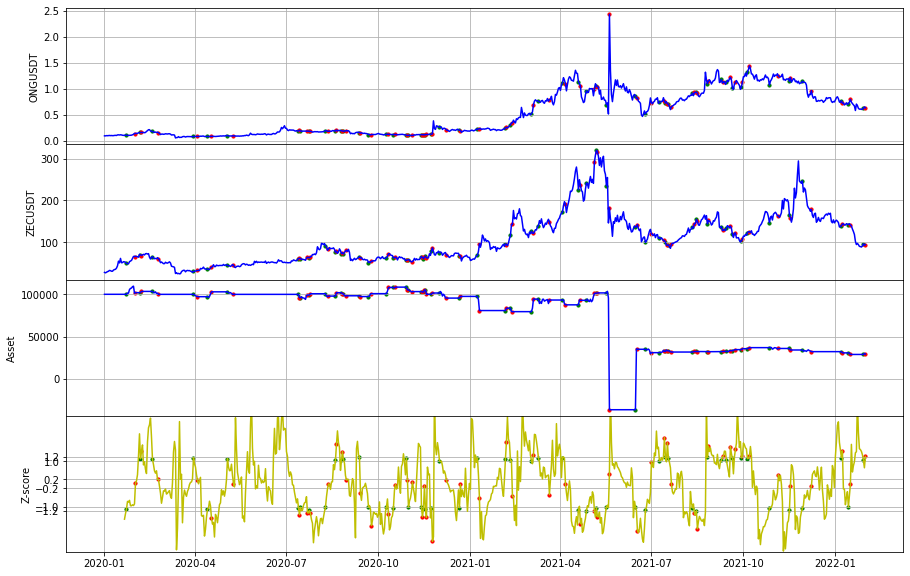

ONGUSDT_IOSTUSDT 回測結果
-----------------------------ONGUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  -98635.02500187
總交易次數:  59
平均損益:  -1671.7800847774479
勝率:  0.423728813559322
獲利因子:  0.12022034638785561
賺賠比:  0.16349967108748362
最大資金回落:  101470.87335803584
夏普比率:  -0.19859286227194786


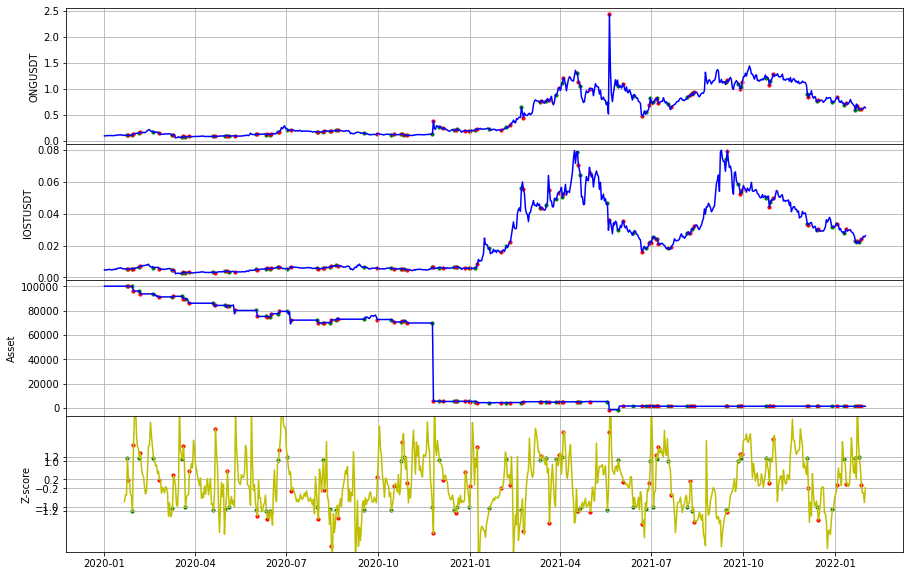

ONGUSDT_CELRUSDT 回測結果
-----------------------------ONGUSDT-CELRUSDT--------------------------
初始價格 100000
總損益:  121874.33734205
總交易次數:  54
平均損益:  2256.9321730008955
勝率:  0.5925925925925926
獲利因子:  1.8409094350242807
賺賠比:  1.265625236579193
最大資金回落:  43594.29791121627
夏普比率:  0.16560127771858088


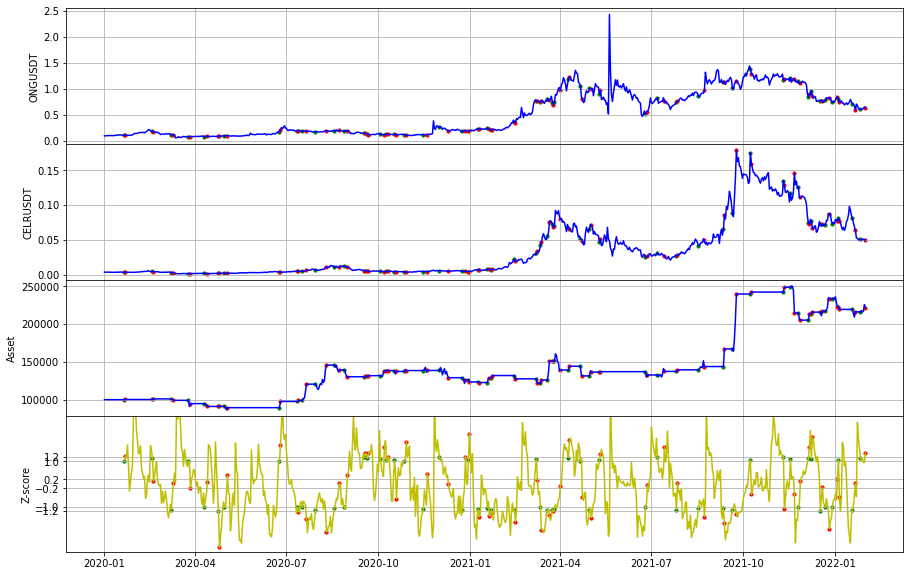

ONGUSDT_MITHUSDT 回測結果，場上有單已平倉
-----------------------------ONGUSDT-MITHUSDT--------------------------
初始價格 100000
總損益:  212380.02645284
總交易次數:  50
平均損益:  4247.600529056765
勝率:  0.42
獲利因子:  2.2261349161257074
賺賠比:  3.0741863127450246
最大資金回落:  56532.03798433457
夏普比率:  0.178438782228813


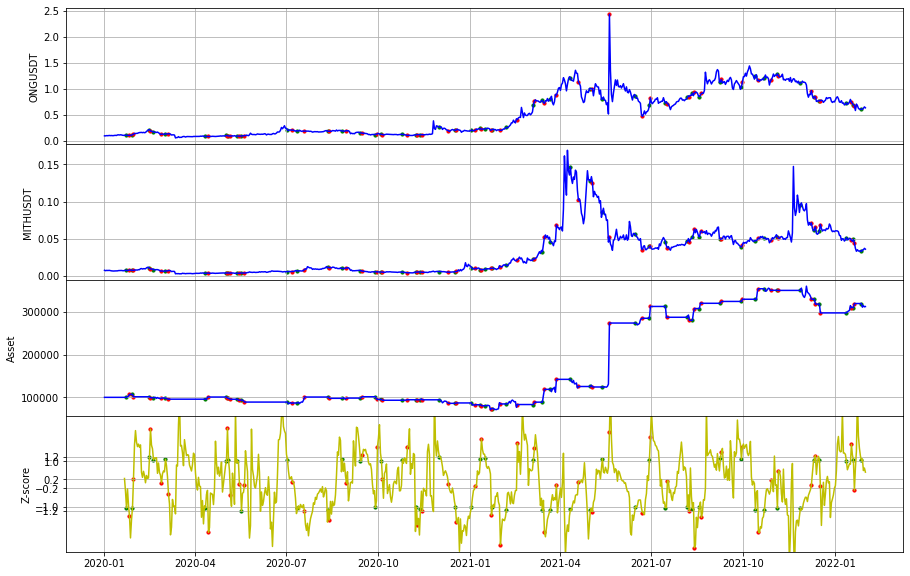

HOTUSDT_BNBUSDT 回測結果
-----------------------------HOTUSDT-BNBUSDT--------------------------
初始價格 100000
總損益:  154841.69032806
總交易次數:  57
平均損益:  2716.5208829484764
勝率:  0.5789473684210527
獲利因子:  2.174653654028808
賺賠比:  1.5815662938391333
最大資金回落:  36382.80888073964
夏普比率:  0.2094771407485302


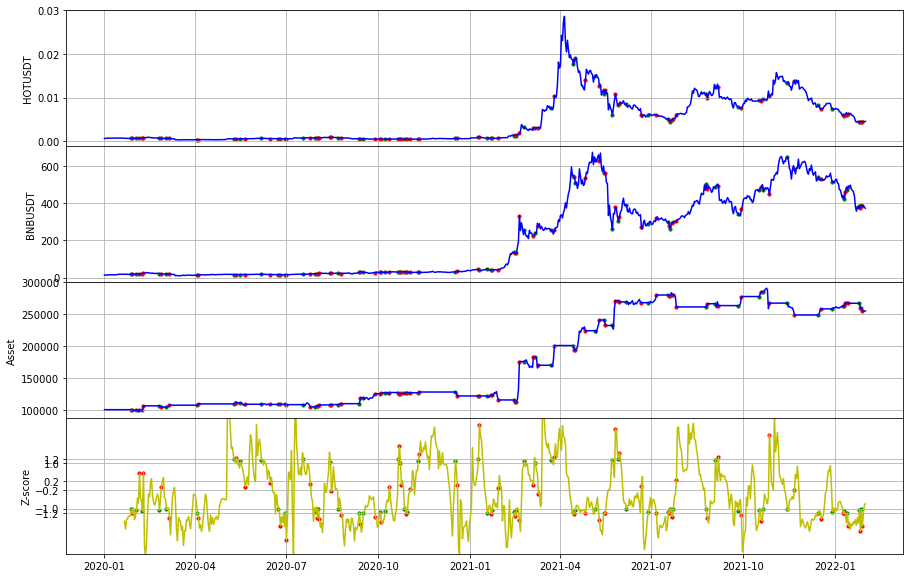

HOTUSDT_NEOUSDT 回測結果
-----------------------------HOTUSDT-NEOUSDT--------------------------
初始價格 100000
總損益:  218997.61951930
總交易次數:  62
平均損益:  3532.219669666115
勝率:  0.6451612903225806
獲利因子:  3.841226796597757
賺賠比:  2.1126747381287663
最大資金回落:  25181.37272196573
夏普比率:  0.33488069780124535


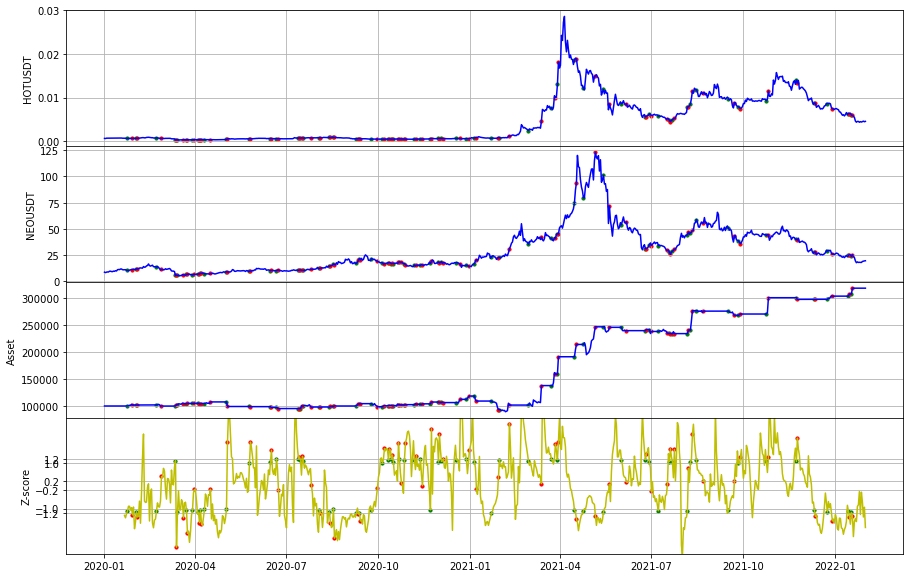

HOTUSDT_LTCUSDT 回測結果，場上有單已平倉
-----------------------------HOTUSDT-LTCUSDT--------------------------
初始價格 100000
總損益:  21244.95070954
總交易次數:  58
平均損益:  366.29225361267663
勝率:  0.5
獲利因子:  1.2439908219942861
賺賠比:  1.2439908219942861
最大資金回落:  34413.32388234147
夏普比率:  0.07510066499297939


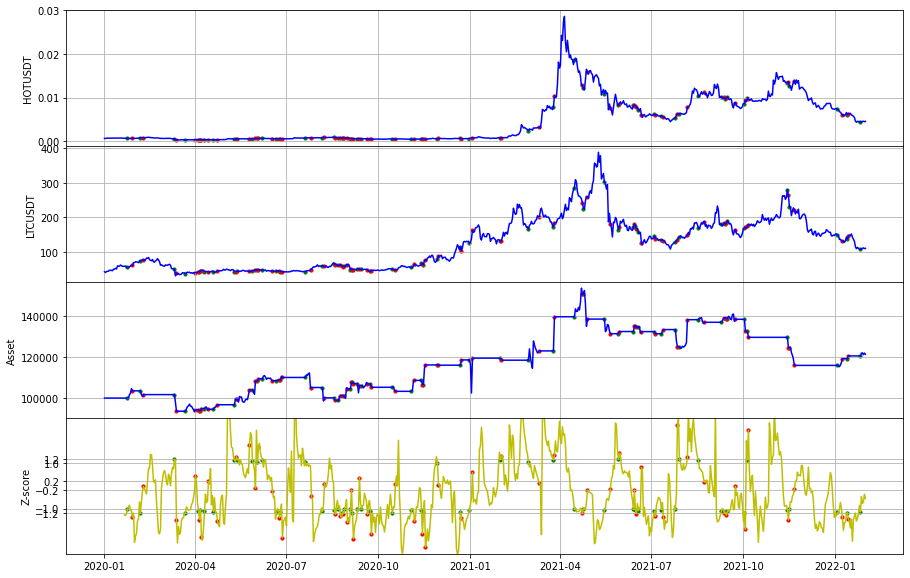

HOTUSDT_QTUMUSDT 回測結果
-----------------------------HOTUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  -42282.96397101
總交易次數:  44
平均損益:  -960.9764538864966
勝率:  0.36363636363636365
獲利因子:  0.43667056040049773
賺賠比:  0.764173480700871
最大資金回落:  52664.781933460166
夏普比率:  -0.2986956998324116


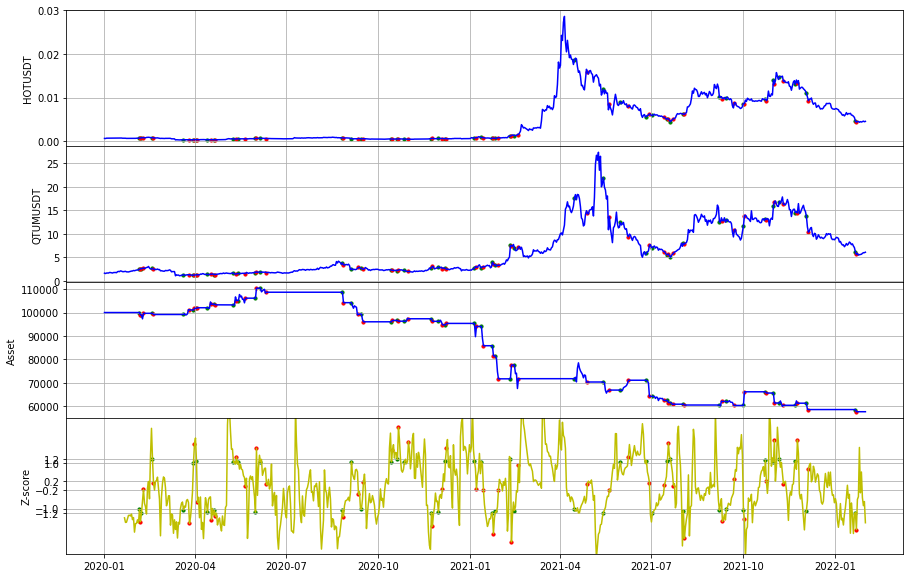

HOTUSDT_ADAUSDT 回測結果
-----------------------------HOTUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  -21930.45954846
總交易次數:  49
平均損益:  -447.5603989481267
勝率:  0.42857142857142855
獲利因子:  0.757137699247767
賺賠比:  1.0095169323303559
最大資金回落:  32803.72799431914
夏普比率:  -0.09764119201350885


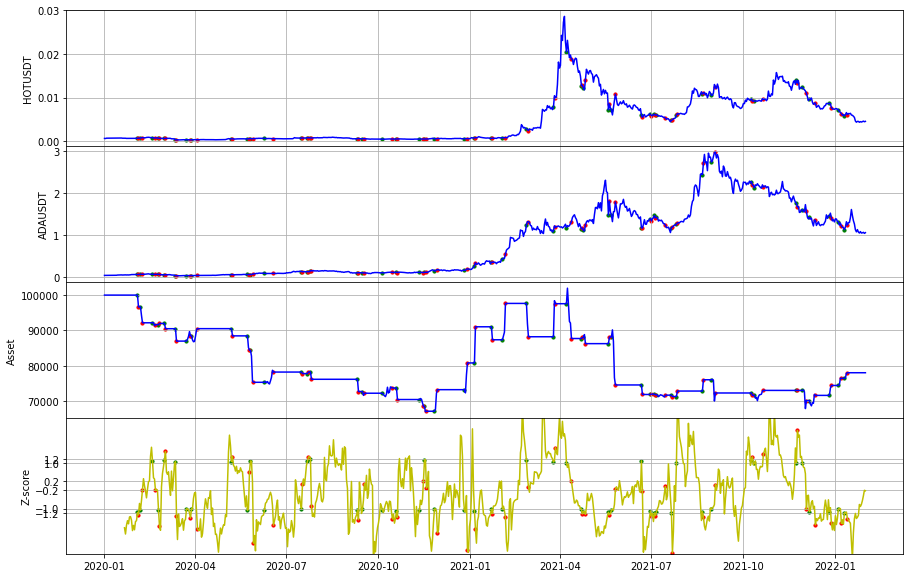

HOTUSDT_XRPUSDT 回測結果
-----------------------------HOTUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  241817.13576490
總交易次數:  51
平均損益:  4741.512465978368
勝率:  0.5686274509803921
獲利因子:  3.6467270752263783
賺賠比:  2.766482608792425
最大資金回落:  38345.304901367694
夏普比率:  0.2963926833727031


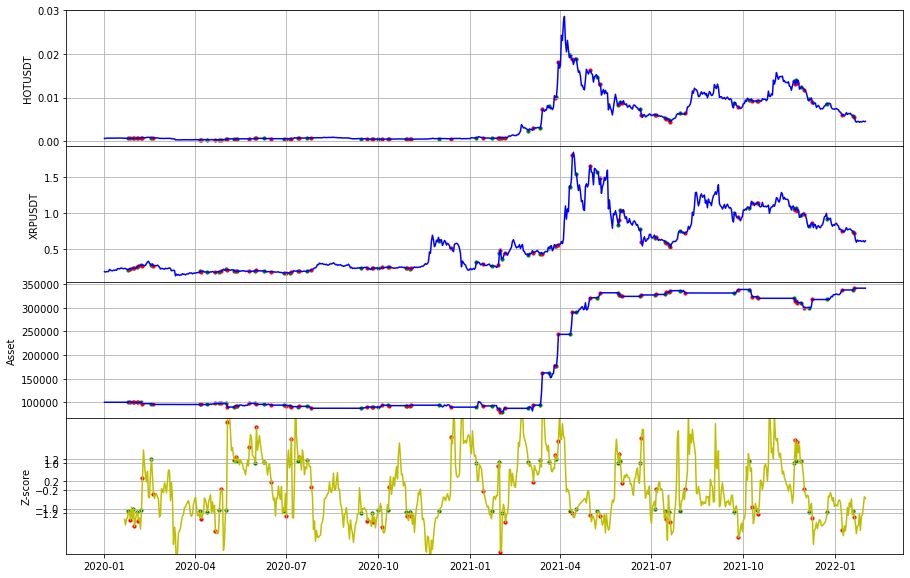

HOTUSDT_IOTAUSDT 回測結果
-----------------------------HOTUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  -45288.38342918
總交易次數:  40
平均損益:  -1132.2095857295149
勝率:  0.425
獲利因子:  0.4781084320821399
賺賠比:  0.6468525845817186
最大資金回落:  50230.16155781754
夏普比率:  -0.21921312835601853


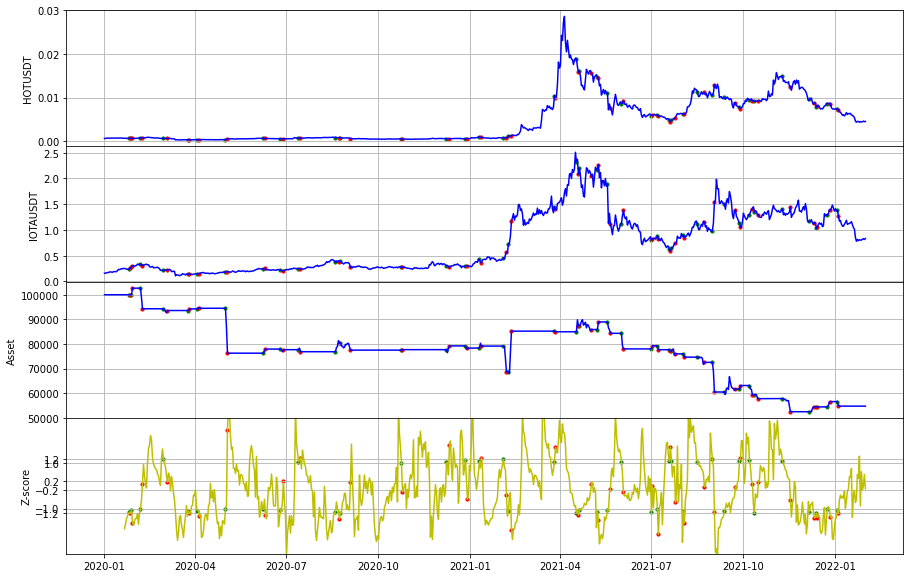

HOTUSDT_TRXUSDT 回測結果，場上有單已平倉
-----------------------------HOTUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  80907.22873814
總交易次數:  58
平均損益:  1394.9522196230562
勝率:  0.5862068965517241
獲利因子:  1.9129873737708654
賺賠比:  1.3503440285441402
最大資金回落:  39171.363260276354
夏普比率:  0.15558616958707228


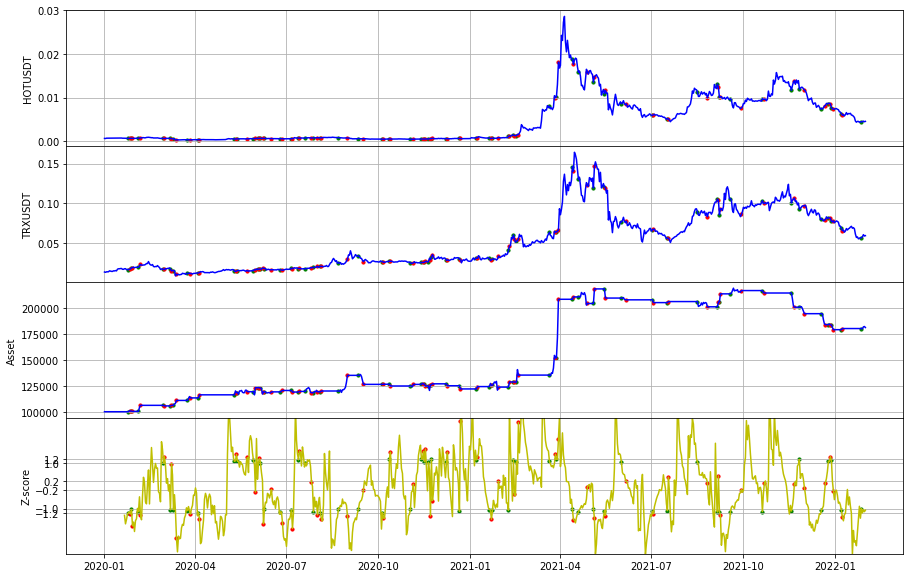

HOTUSDT_ETCUSDT 回測結果，場上有單已平倉
-----------------------------HOTUSDT-ETCUSDT--------------------------
初始價格 100000
總損益:  163325.29116053
總交易次數:  52
平均損益:  3140.8709838563946
勝率:  0.5192307692307693
獲利因子:  3.3943435632696652
賺賠比:  3.142910706731171
最大資金回落:  33058.91859182638
夏普比率:  0.2228087254960759


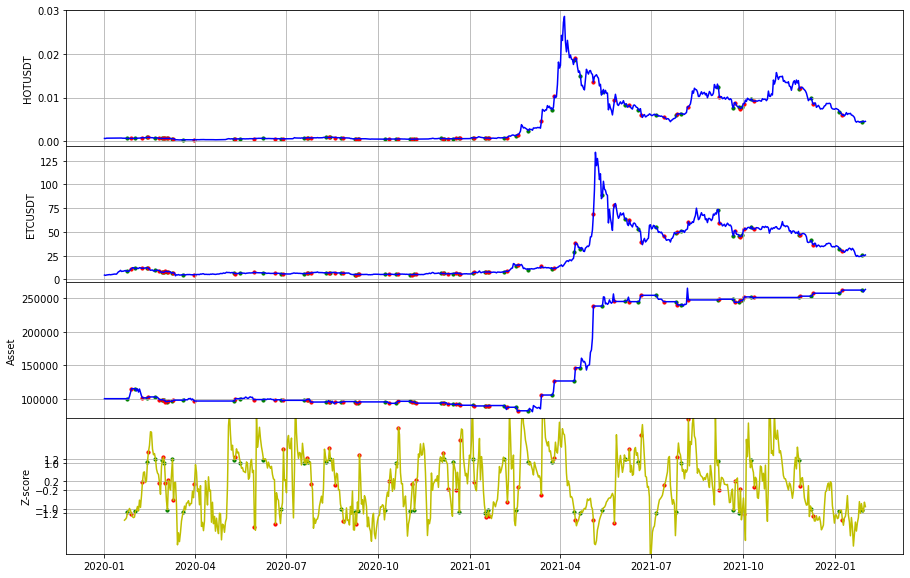

HOTUSDT_ICXUSDT 回測結果
-----------------------------HOTUSDT-ICXUSDT--------------------------
初始價格 100000
總損益:  61974.58938109
總交易次數:  56
平均損益:  1106.6890960908115
勝率:  0.4642857142857143
獲利因子:  1.5608818627095715
賺賠比:  1.8010175338956593
最大資金回落:  25011.476414619305
夏普比率:  0.12917350998725904


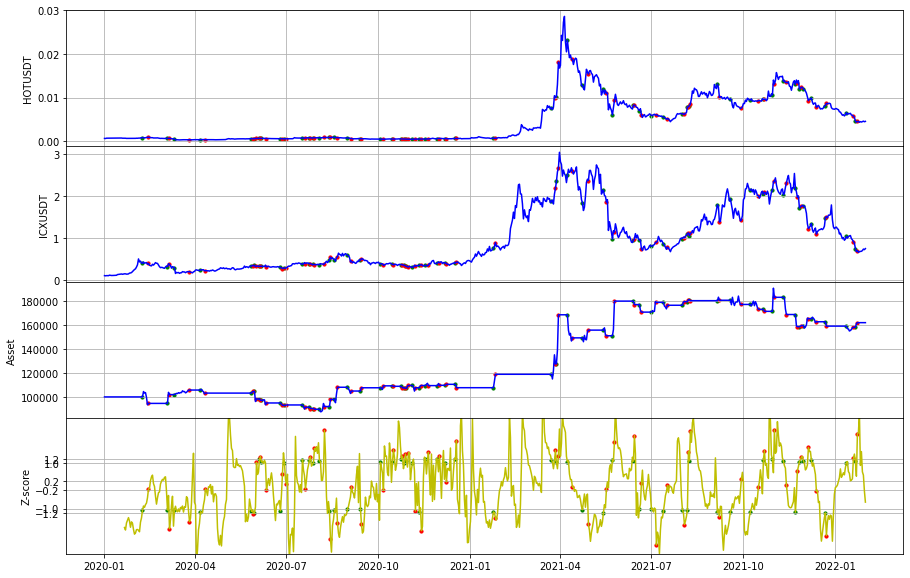

HOTUSDT_VETUSDT 回測結果，場上有單已平倉
-----------------------------HOTUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -27603.81924799
總交易次數:  59
平均損益:  -467.86134318626455
勝率:  0.4067796610169492
獲利因子:  0.6917831368276592
賺賠比:  1.00885040787367
最大資金回落:  50044.89266093621
夏普比率:  -0.12315633381320333


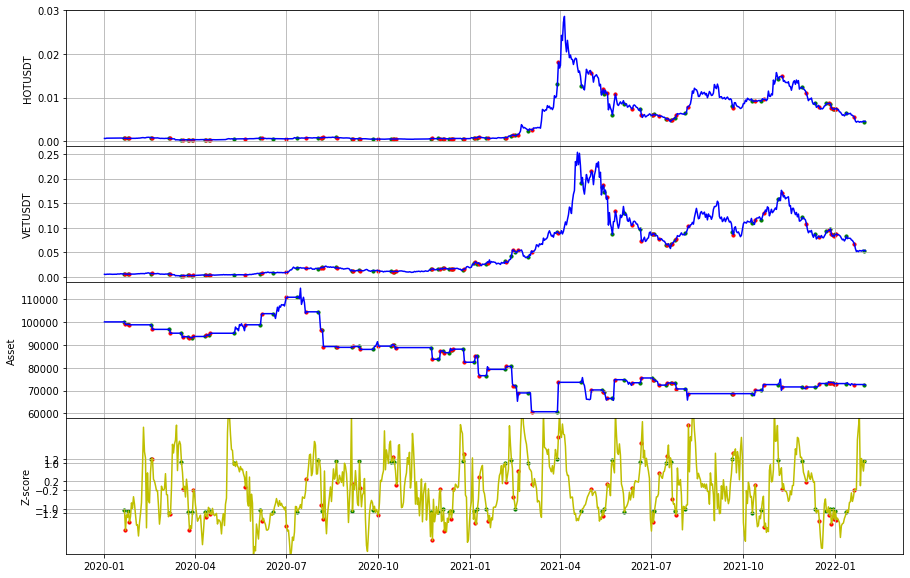

HOTUSDT_TFUELUSDT 回測結果
-----------------------------HOTUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  -6837.19068072
總交易次數:  51
平均損益:  -134.06256236714498
勝率:  0.45098039215686275
獲利因子:  0.9346505759328655
賺賠比:  1.1378354837443578
最大資金回落:  44399.97377404453
夏普比率:  -0.021073791015371008


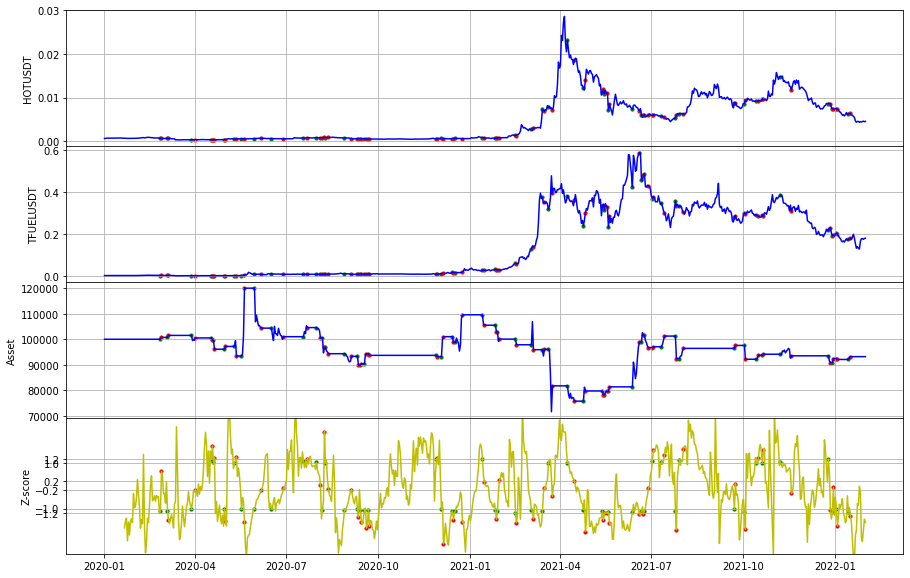

HOTUSDT_WAVESUSDT 回測結果
-----------------------------HOTUSDT-WAVESUSDT--------------------------
初始價格 100000
總損益:  143125.83754774
總交易次數:  43
平均損益:  3328.5078499474275
勝率:  0.5348837209302325
獲利因子:  2.475986689311474
賺賠比:  2.153031903749108
最大資金回落:  22385.55534806804
夏普比率:  0.25783266250993453


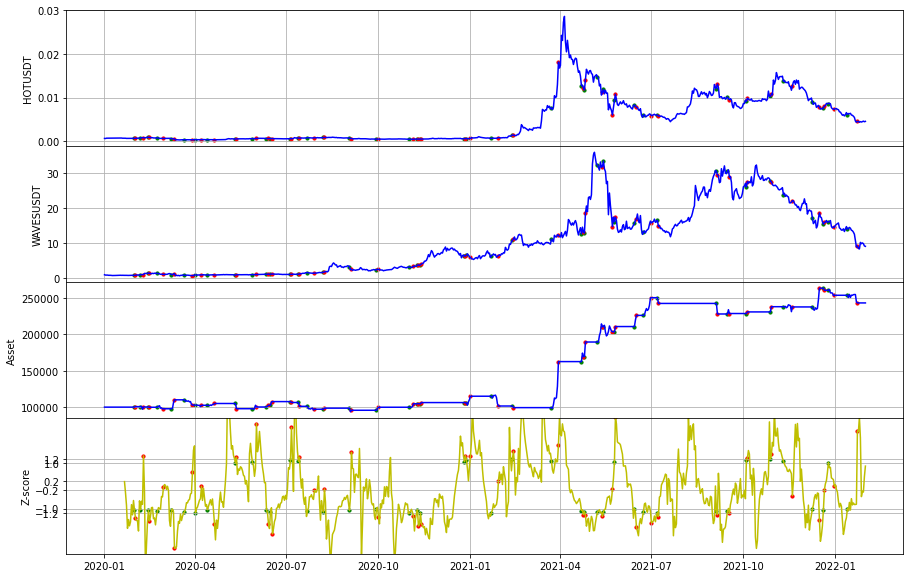

HOTUSDT_ONGUSDT 回測結果
-----------------------------HOTUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -56926.79400656
總交易次數:  61
平均損益:  -933.226131255143
勝率:  0.5245901639344263
獲利因子:  0.6703618303025572
賺賠比:  0.6075154087116925
最大資金回落:  103310.46975631597
夏普比率:  -0.07859245700326714


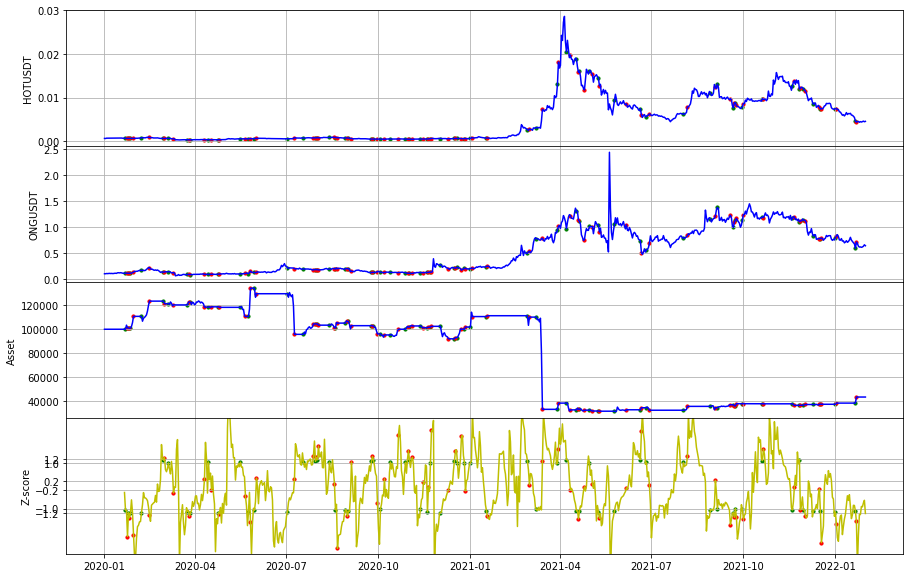

HOTUSDT_FETUSDT 回測結果
-----------------------------HOTUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  -45891.81660976
總交易次數:  47
平均損益:  -976.4216299947947
勝率:  0.3404255319148936
獲利因子:  0.5260896282196392
賺賠比:  1.019298654675551
最大資金回落:  52990.29568702837
夏普比率:  -0.24312939167398284


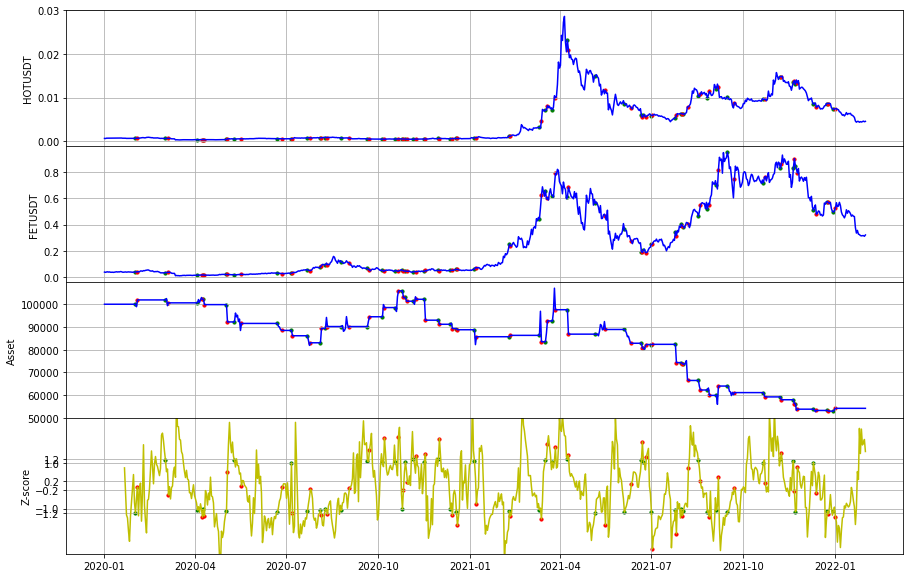

HOTUSDT_XMRUSDT 回測結果
-----------------------------HOTUSDT-XMRUSDT--------------------------
初始價格 100000
總損益:  31114.33290300
總交易次數:  51
平均損益:  610.0849588824169
勝率:  0.5490196078431373
獲利因子:  1.3874180775252027
賺賠比:  1.1396648493957022
最大資金回落:  21879.682200047406
夏普比率:  0.09091450368878541


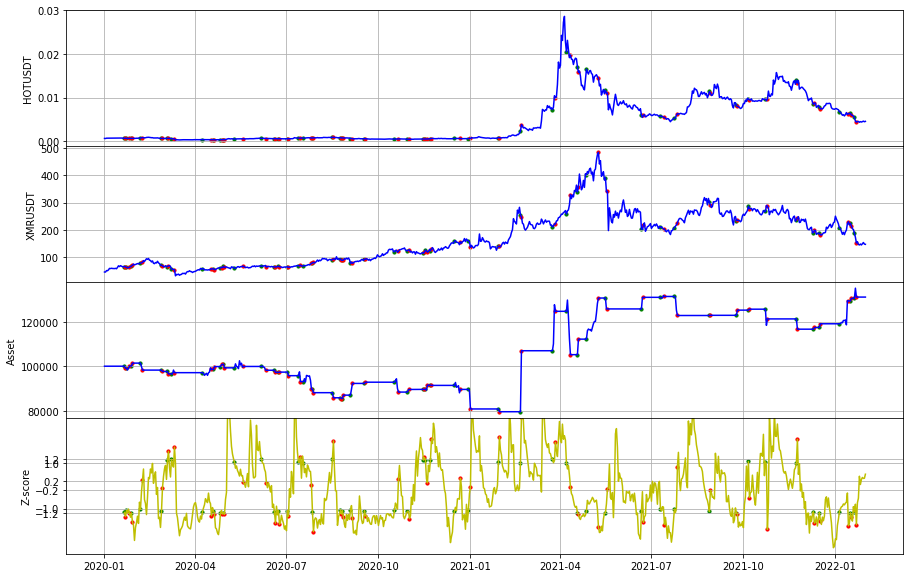

HOTUSDT_ZECUSDT 回測結果
-----------------------------HOTUSDT-ZECUSDT--------------------------
初始價格 100000
總損益:  13711.23255304
總交易次數:  51
平均損益:  268.8476971184102
勝率:  0.45098039215686275
獲利因子:  1.1320744413901187
賺賠比:  1.3781775808227532
最大資金回落:  48146.38380625352
夏普比率:  0.04265566865156001


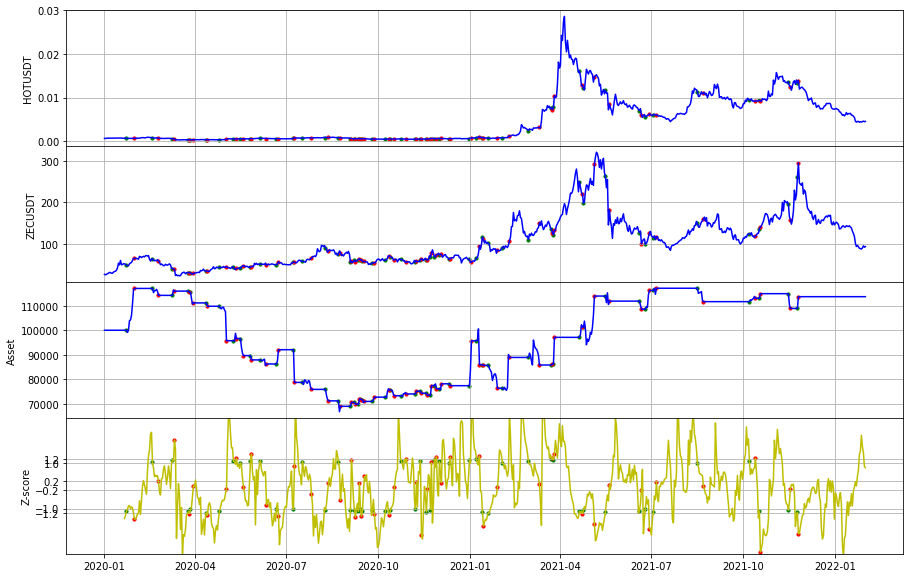

HOTUSDT_IOSTUSDT 回測結果
-----------------------------HOTUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  -37752.83152534
總交易次數:  55
平均損益:  -686.4151186426337
勝率:  0.41818181818181815
獲利因子:  0.5687631942380286
賺賠比:  0.7913227050268223
最大資金回落:  52355.0872586206
夏普比率:  -0.17090207132733373


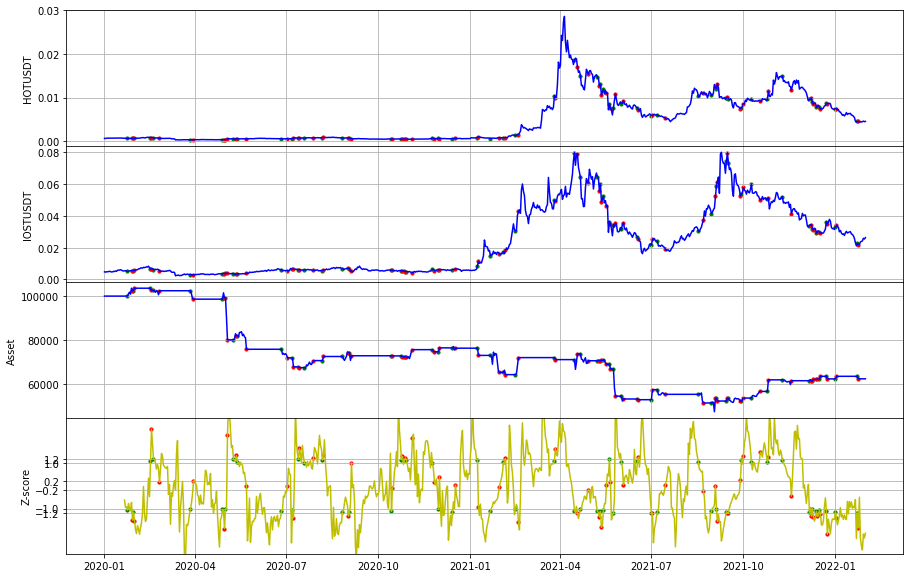

HOTUSDT_CELRUSDT 回測結果，場上有單已平倉
-----------------------------HOTUSDT-CELRUSDT--------------------------
初始價格 100000
總損益:  12404.45297519
總交易次數:  54
平均損益:  229.71209213322004
勝率:  0.42592592592592593
獲利因子:  1.0797714184960028
賺賠比:  1.4553440857989604
最大資金回落:  40889.73324074733
夏普比率:  0.022700981904574334


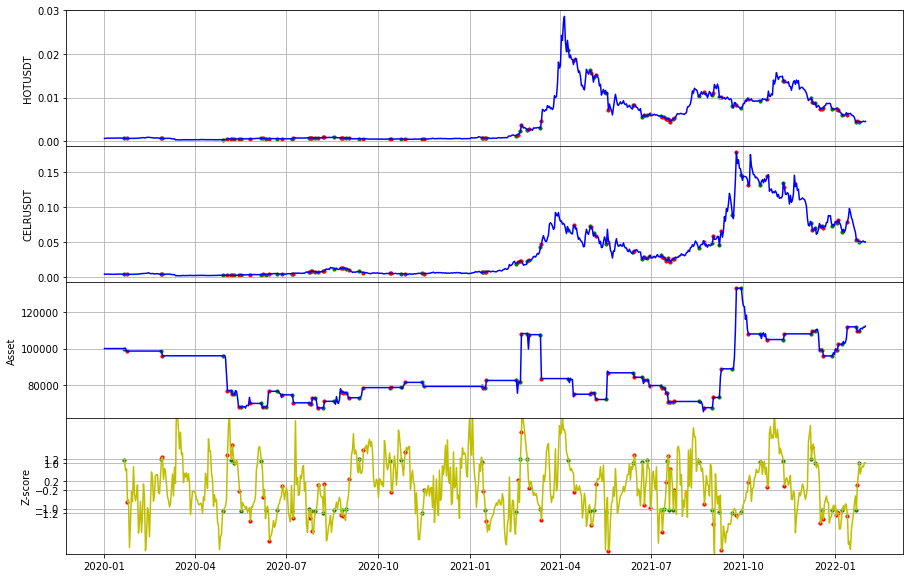

HOTUSDT_DASHUSDT 回測結果，場上有單已平倉
-----------------------------HOTUSDT-DASHUSDT--------------------------
初始價格 100000
總損益:  -12493.39079976
總交易次數:  51
平均損益:  -244.9684470540504
勝率:  0.47058823529411764
獲利因子:  0.8329170208929629
賺賠比:  0.9370316485045833
最大資金回落:  29823.21080637272
夏普比率:  -0.062132109864939875


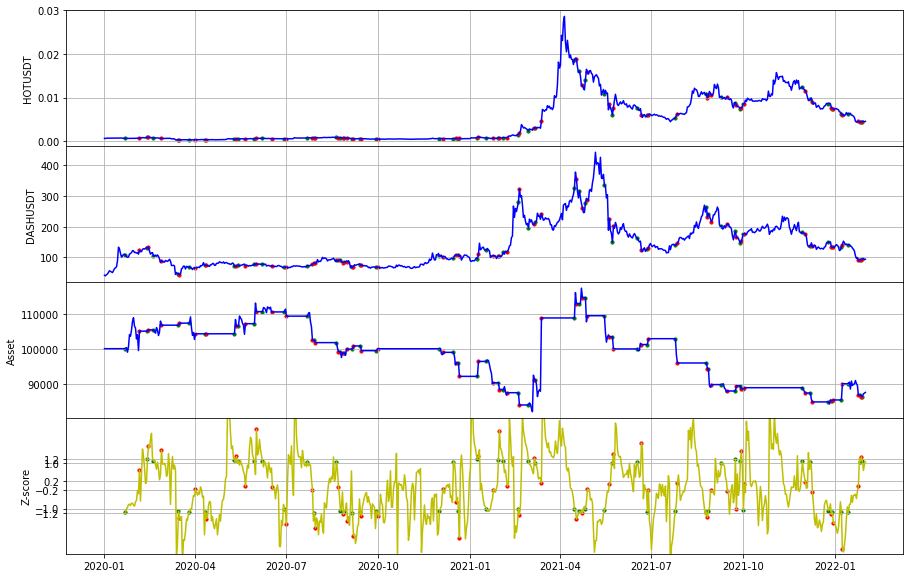

HOTUSDT_MITHUSDT 回測結果
-----------------------------HOTUSDT-MITHUSDT--------------------------
初始價格 100000
總損益:  25280.93052884
總交易次數:  57
平均損益:  443.52509699713744
勝率:  0.43859649122807015
獲利因子:  1.2285149991975786
賺賠比:  1.5724991989729005
最大資金回落:  41557.264250919994
夏普比率:  0.05859592050590534


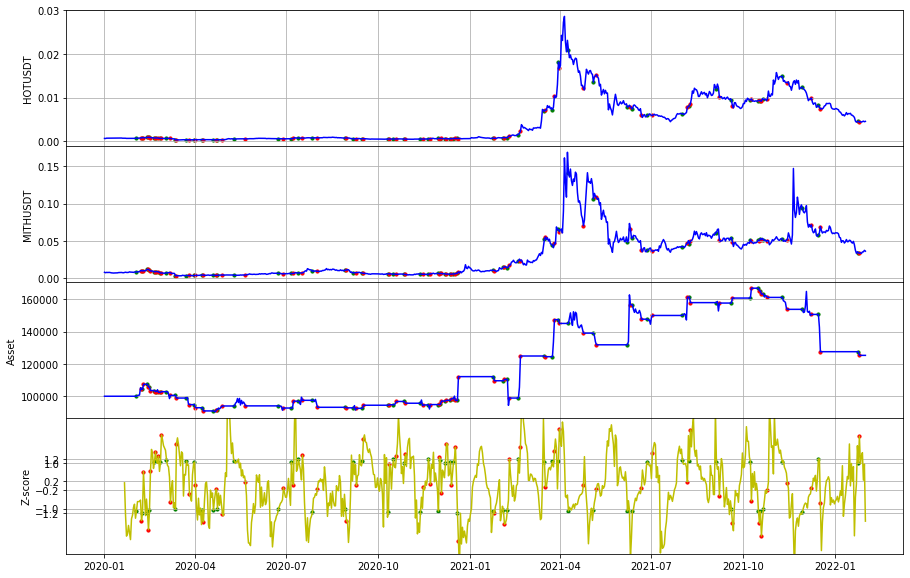

ZILUSDT_XLMUSDT 回測結果
-----------------------------ZILUSDT-XLMUSDT--------------------------
初始價格 100000
總損益:  4313.74309777
總交易次數:  46
平均損益:  93.77702386461264
勝率:  0.5
獲利因子:  1.0485401255096989
賺賠比:  1.0485401255096989
最大資金回落:  36401.56578198436
夏普比率:  0.014665913593363326


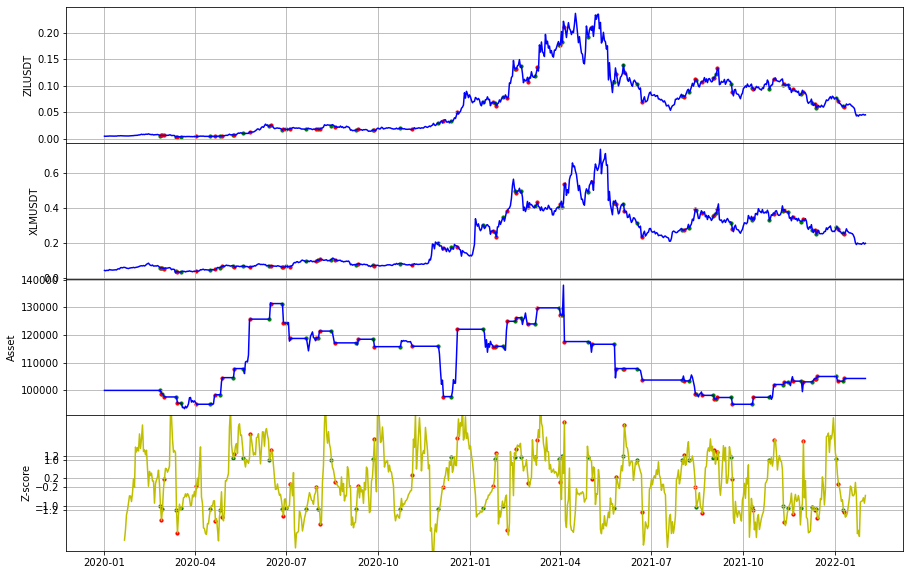

ZILUSDT_ZRXUSDT 回測結果
-----------------------------ZILUSDT-ZRXUSDT--------------------------
初始價格 100000
總損益:  -289.50001949
總交易次數:  46
平均損益:  -6.293478684647277
勝率:  0.45652173913043476
獲利因子:  0.996934425334348
賺賠比:  1.1868266968266046
最大資金回落:  29527.15503743317
夏普比率:  -0.0009943000580245314


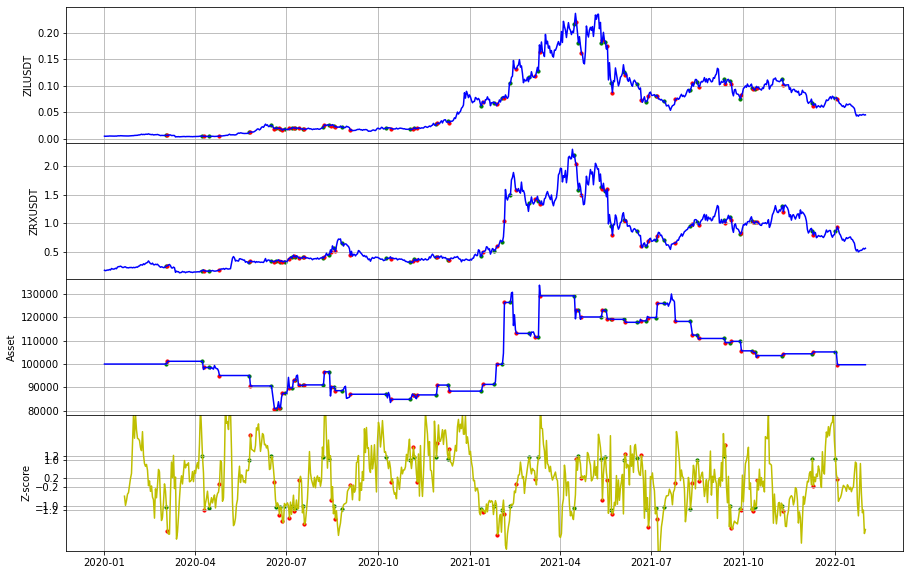

ZILUSDT_DASHUSDT 回測結果，場上有單已平倉
-----------------------------ZILUSDT-DASHUSDT--------------------------
初始價格 100000
總損益:  -37883.87807383
總交易次數:  60
平均損益:  -631.3979678970934
勝率:  0.48333333333333334
獲利因子:  0.6640498610191559
賺賠比:  0.709846403158408
最大資金回落:  50630.799629389614
夏普比率:  -0.11715349897948618


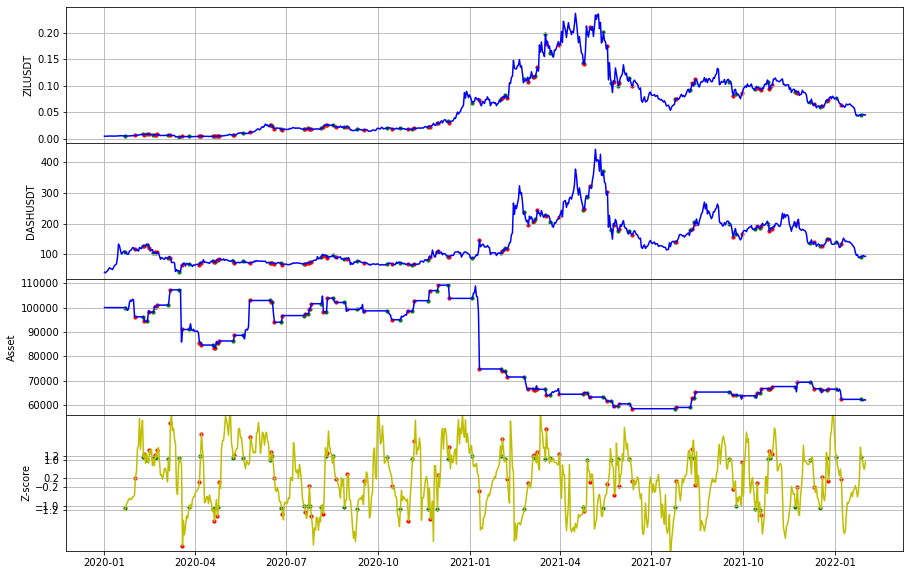

ZRXUSDT_LTCUSDT 回測結果
-----------------------------ZRXUSDT-LTCUSDT--------------------------
初始價格 100000
總損益:  97745.45343705
總交易次數:  66
平均損益:  1480.9917187432447
勝率:  0.5303030303030303
獲利因子:  1.5510898762251792
賺賠比:  1.3738224617994443
最大資金回落:  56568.59455364797
夏普比率:  0.1258487401998253


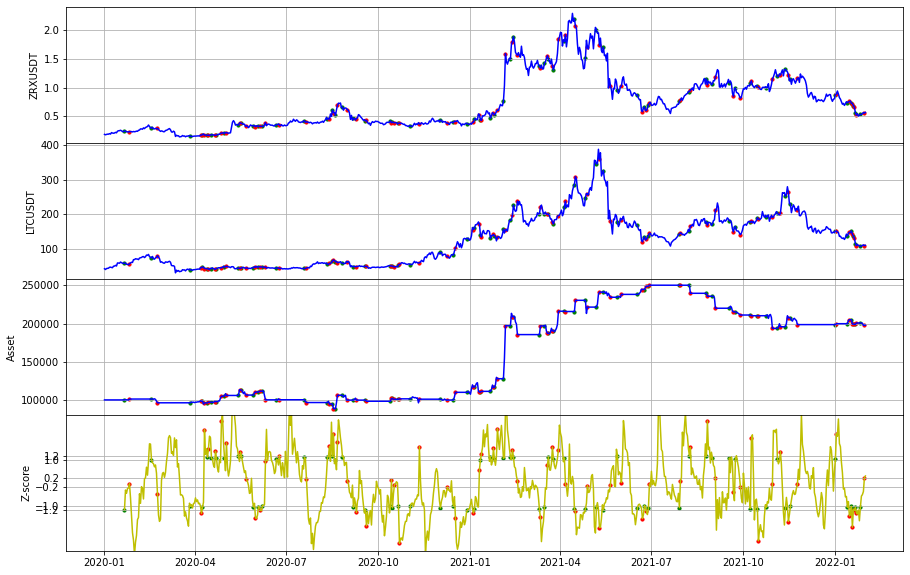

ZRXUSDT_IOTAUSDT 回測結果
-----------------------------ZRXUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  -12100.86834723
總交易次數:  61
平均損益:  -198.3748909382378
勝率:  0.47540983606557374
獲利因子:  0.8776132005891454
賺賠比:  0.9684007730638846
最大資金回落:  33432.75689515806
夏普比率:  -0.048994955831256154


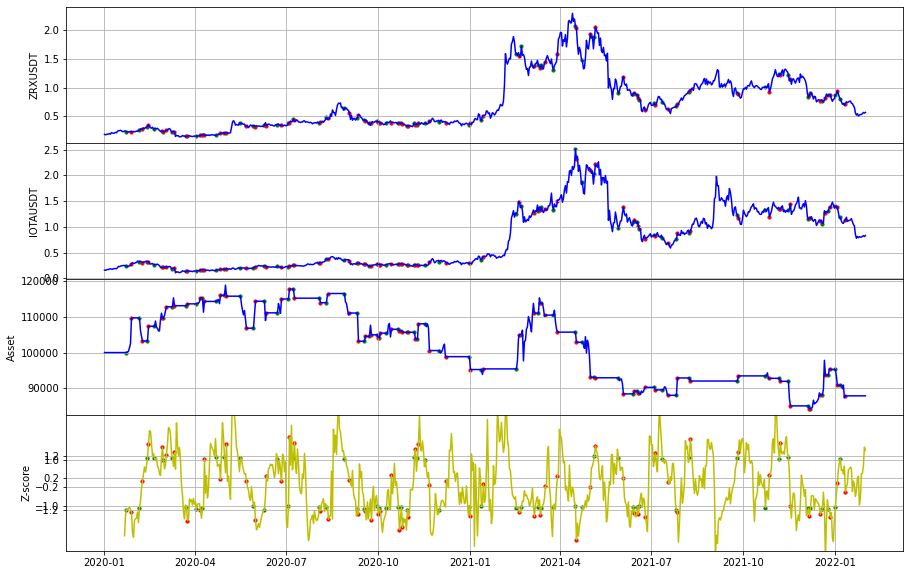

ZRXUSDT_XLMUSDT 回測結果
-----------------------------ZRXUSDT-XLMUSDT--------------------------
初始價格 100000
總損益:  32957.46695700
總交易次數:  51
平均損益:  646.224842294162
勝率:  0.47058823529411764
獲利因子:  1.388996860485689
賺賠比:  1.5626214680464003
最大資金回落:  25604.490241144304
夏普比率:  0.11421466312877443


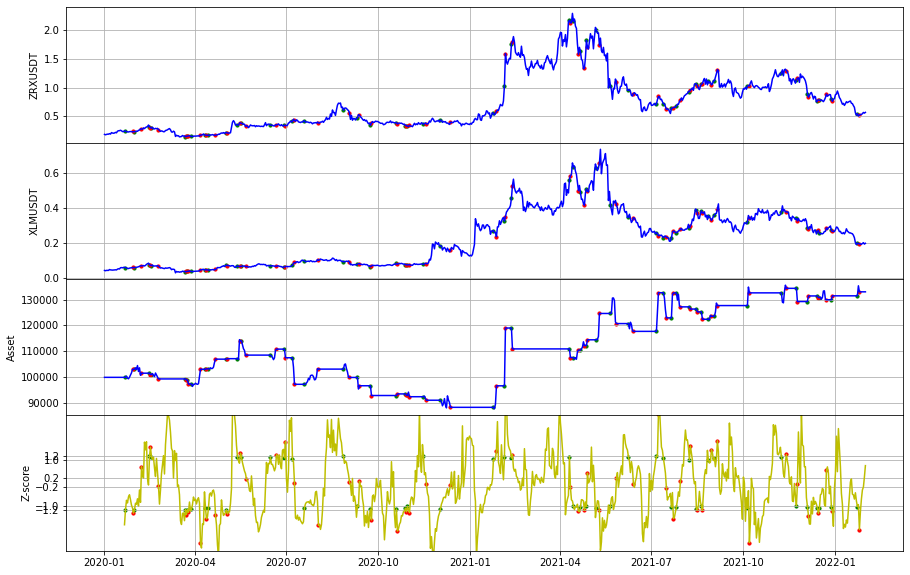

ZRXUSDT_NULSUSDT 回測結果
-----------------------------ZRXUSDT-NULSUSDT--------------------------
初始價格 100000
總損益:  89741.69837981
總交易次數:  50
平均損益:  1794.833967596123
勝率:  0.5
獲利因子:  1.9498460435533345
賺賠比:  1.9498460435533347
最大資金回落:  16949.47436320437
夏普比率:  0.21841224032063244


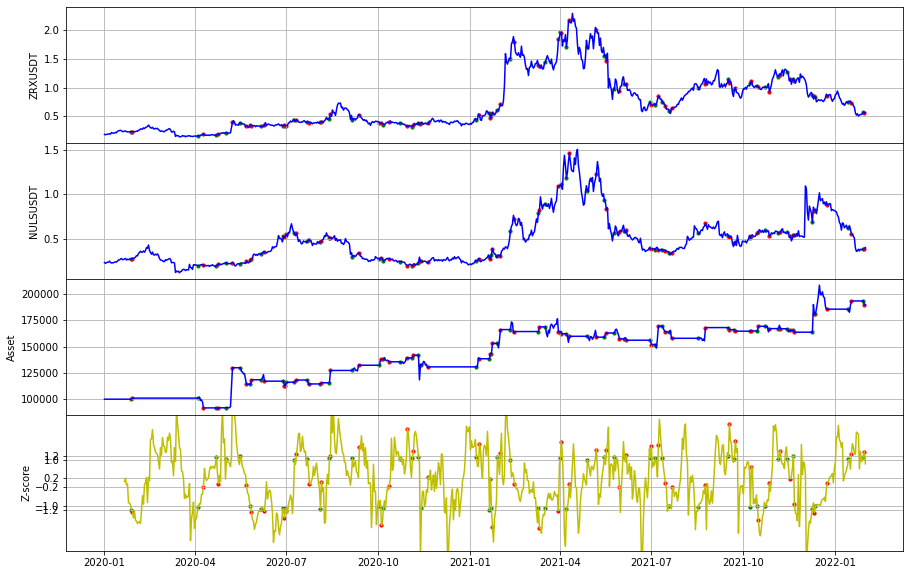

ZRXUSDT_LINKUSDT 回測結果
-----------------------------ZRXUSDT-LINKUSDT--------------------------
初始價格 100000
總損益:  6633.72419917
總交易次數:  58
平均損益:  114.37455515812853
勝率:  0.39655172413793105
獲利因子:  1.0488368639394492
賺賠比:  1.596056097299162
最大資金回落:  41405.894246592434
夏普比率:  0.01607956953337355


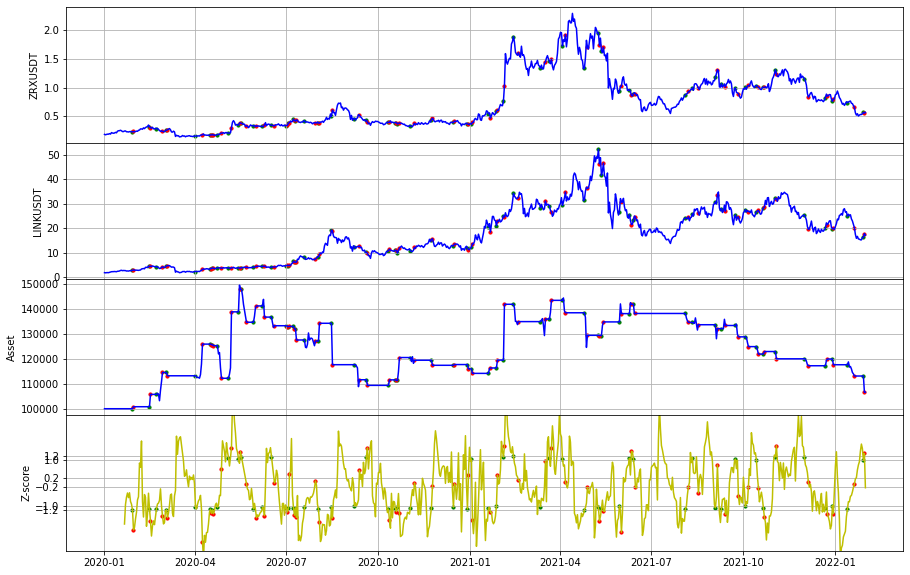

ZRXUSDT_ZILUSDT 回測結果
-----------------------------ZRXUSDT-ZILUSDT--------------------------
初始價格 100000
總損益:  9501.32247030
總交易次數:  54
平均損益:  175.950416116612
勝率:  0.5
獲利因子:  1.08425107528205
賺賠比:  1.08425107528205
最大資金回落:  38659.40386047507
夏普比率:  0.026519461790153208


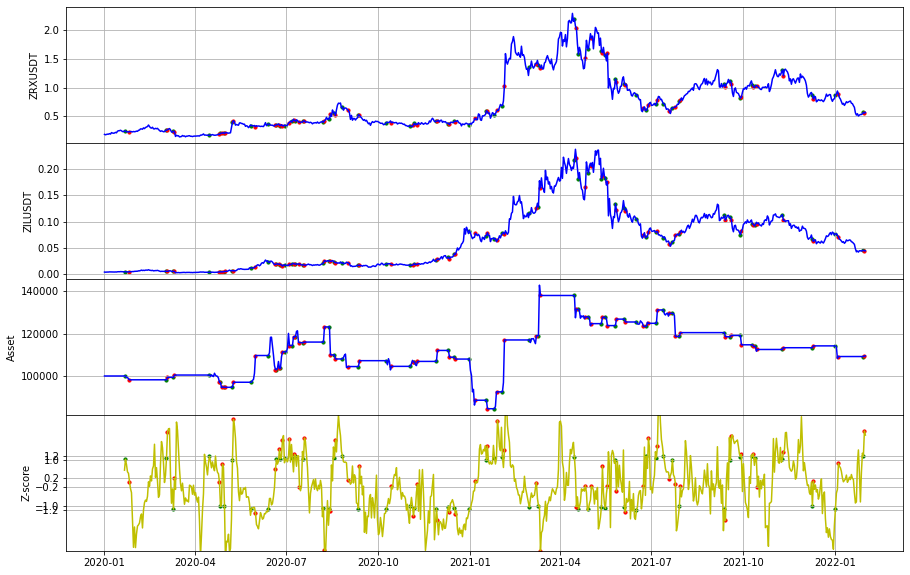

ZRXUSDT_ZECUSDT 回測結果
-----------------------------ZRXUSDT-ZECUSDT--------------------------
初始價格 100000
總損益:  16609.47100282
總交易次數:  50
平均損益:  332.18942005645863
勝率:  0.42
獲利因子:  1.145781578487806
賺賠比:  1.582269798864113
最大資金回落:  48758.60563851113
夏普比率:  0.04476512671613163


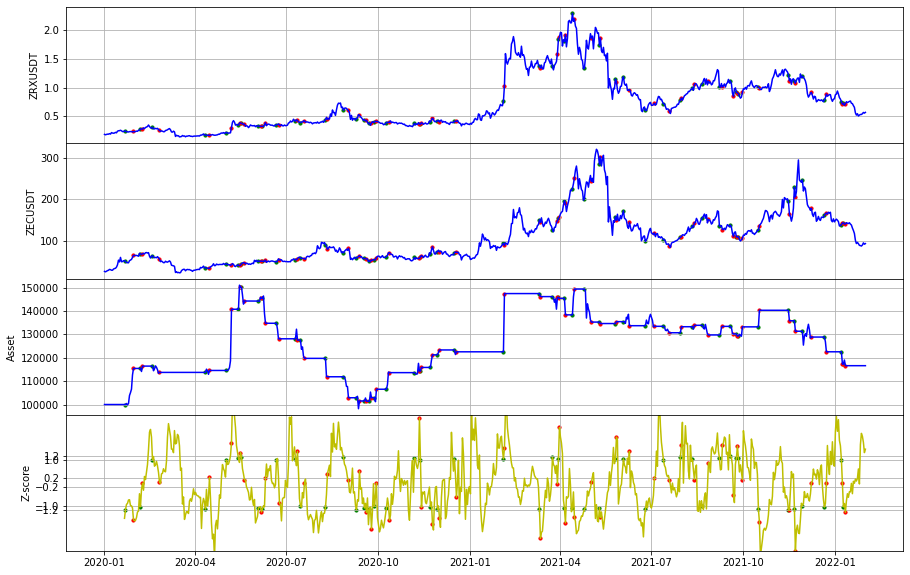

ZRXUSDT_DASHUSDT 回測結果
-----------------------------ZRXUSDT-DASHUSDT--------------------------
初始價格 100000
總損益:  13884.47857762
總交易次數:  54
平均損益:  257.11997365962696
勝率:  0.5925925925925926
獲利因子:  1.1230669261116717
賺賠比:  0.7721085117017742
最大資金回落:  33035.45763931499
夏普比率:  0.03667618173232341


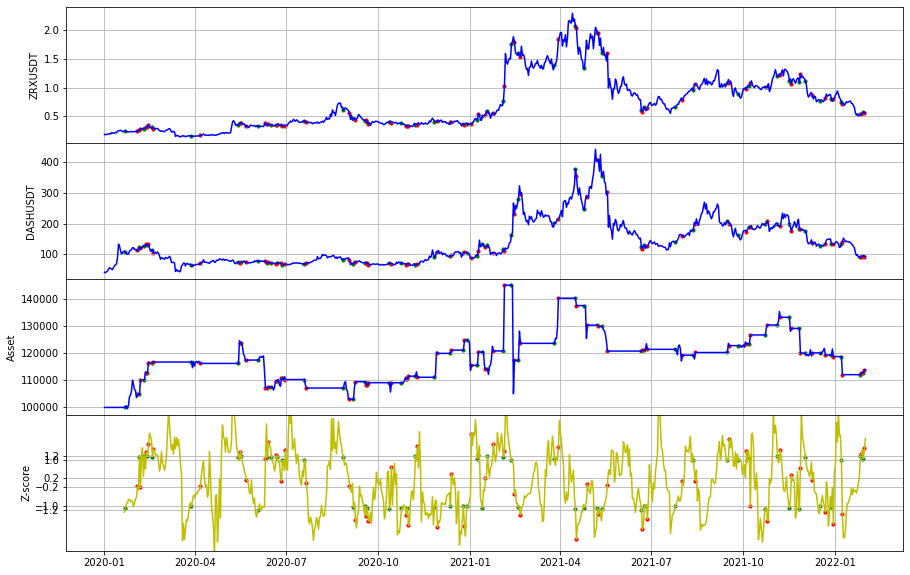

FETUSDT_ETHUSDT 回測結果
-----------------------------FETUSDT-ETHUSDT--------------------------
初始價格 100000
總損益:  39602.67141621
總交易次數:  64
平均損益:  618.7917408782441
勝率:  0.609375
獲利因子:  1.3424643204210671
賺賠比:  0.8605540515519662
最大資金回落:  30960.820425613332
夏普比率:  0.1076885964674588


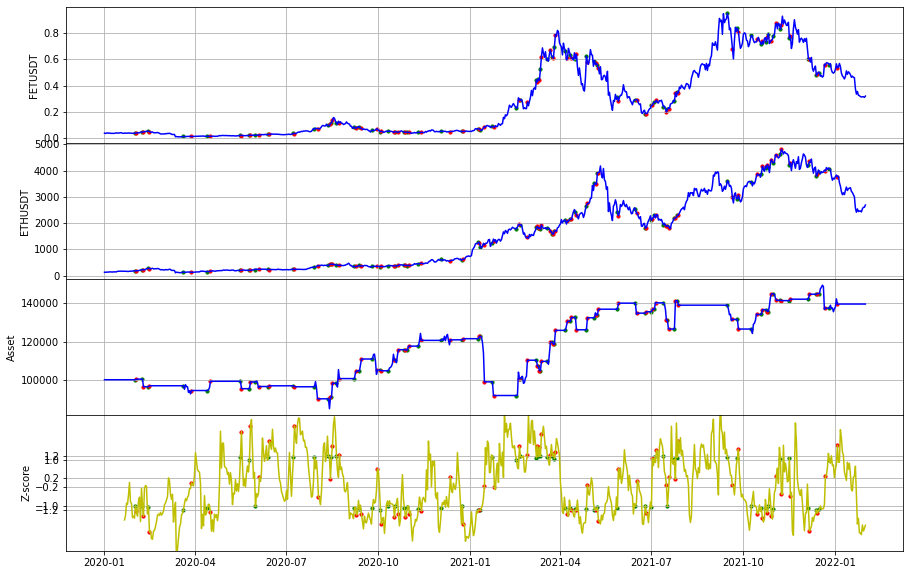

FETUSDT_BNBUSDT 回測結果
-----------------------------FETUSDT-BNBUSDT--------------------------
初始價格 100000
總損益:  6675.70017587
總交易次數:  67
平均損益:  99.63731605772001
勝率:  0.44776119402985076
獲利因子:  1.044598893440367
賺賠比:  1.2883386352431192
最大資金回落:  47531.926160506
夏普比率:  0.014194480407927453


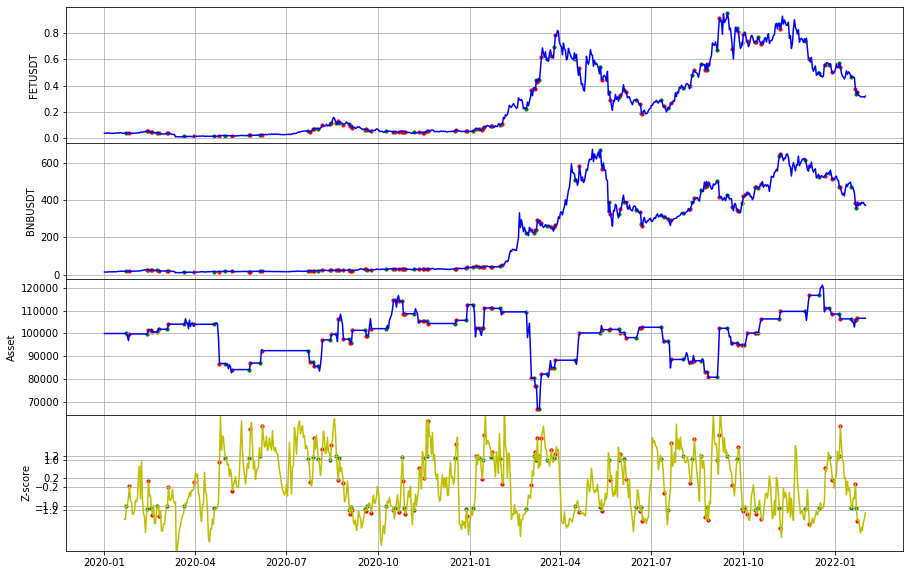

FETUSDT_QTUMUSDT 回測結果
-----------------------------FETUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  -37950.28610478
總交易次數:  64
平均損益:  -592.9732203872536
勝率:  0.359375
獲利因子:  0.6538548428223391
賺賠比:  1.1655673285093873
最大資金回落:  61686.468965572305
夏普比率:  -0.12432515713384909


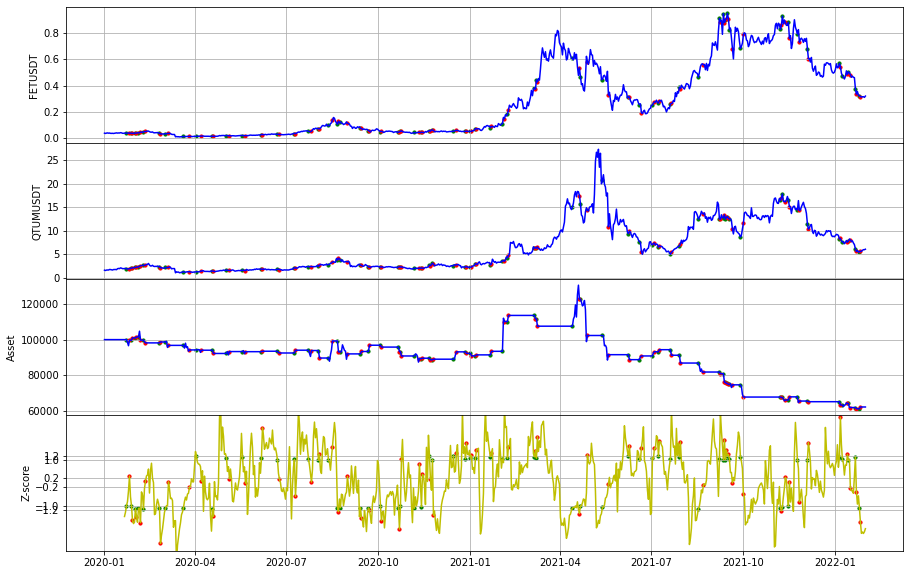

FETUSDT_ADAUSDT 回測結果，場上有單已平倉
-----------------------------FETUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  6999.03855759
總交易次數:  61
平均損益:  114.73833700975204
勝率:  0.5737704918032787
獲利因子:  1.0567827785308141
賺賠比:  0.7850386354800334
最大資金回落:  33199.42472836969
夏普比率:  0.020090861186512782


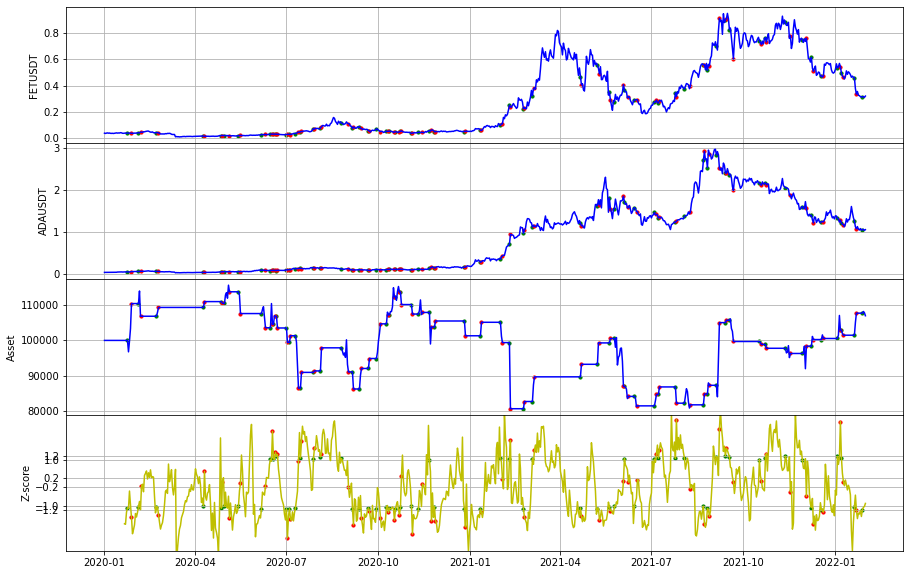

FETUSDT_XRPUSDT 回測結果
-----------------------------FETUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  62279.23413211
總交易次數:  55
平均損益:  1132.349711492845
勝率:  0.4909090909090909
獲利因子:  1.6618039698227243
賺賠比:  1.7233522650013435
最大資金回落:  16022.934967958136
夏普比率:  0.17564960642382668


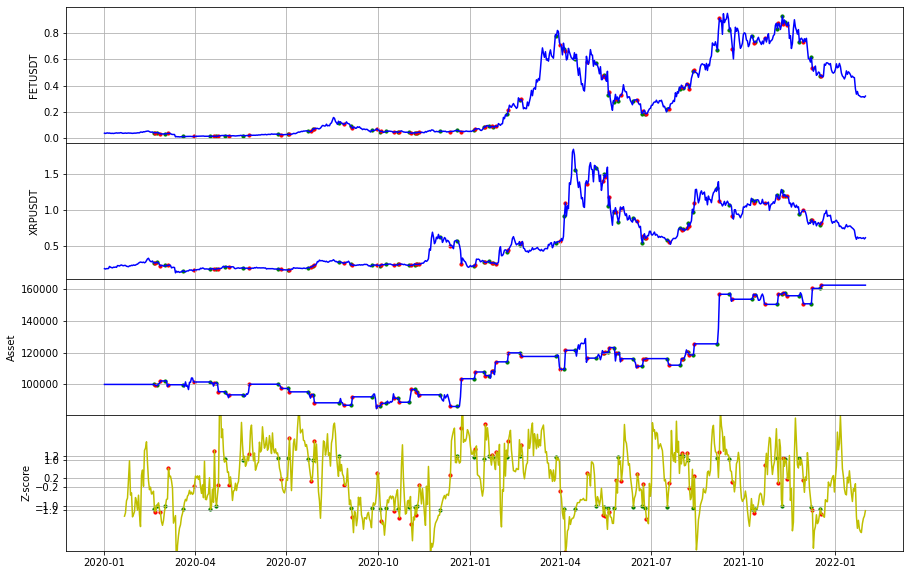

FETUSDT_TRXUSDT 回測結果
-----------------------------FETUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  -17449.91586799
總交易次數:  47
平均損益:  -371.27480570186657
勝率:  0.5106382978723404
獲利因子:  0.8511050046671498
賺賠比:  0.8156422961393518
最大資金回落:  47665.496651832524
夏普比率:  -0.05403835586647697


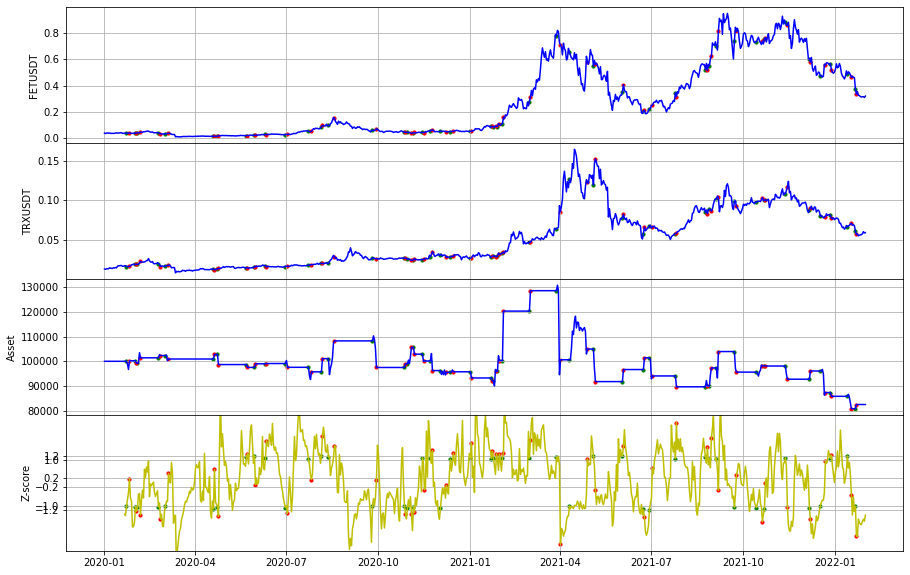

FETUSDT_WAVESUSDT 回測結果，場上有單已平倉
-----------------------------FETUSDT-WAVESUSDT--------------------------
初始價格 100000
總損益:  -18074.77258070
總交易次數:  68
平均損益:  -265.80547912795566
勝率:  0.5294117647058824
獲利因子:  0.8780260966155291
賺賠比:  0.7804676414360259
最大資金回落:  44810.73411786195
夏普比率:  -0.03836254523151234


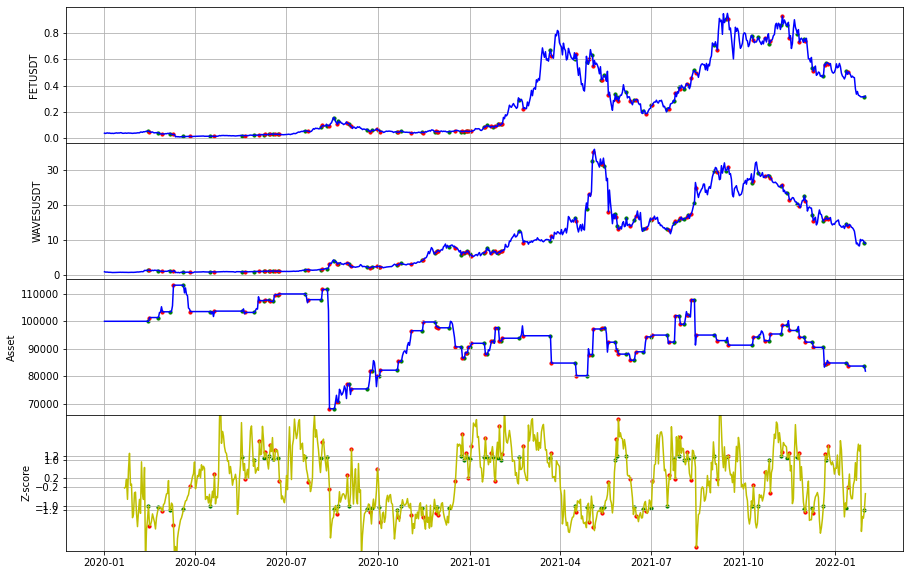

FETUSDT_ONGUSDT 回測結果
-----------------------------FETUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -48166.91839180
總交易次數:  47
平均損益:  -1024.8280508894184
勝率:  0.44680851063829785
獲利因子:  0.5708045943812462
賺賠比:  0.7067104501863049
最大資金回落:  73541.88533245386
夏普比率:  -0.1848482773826919


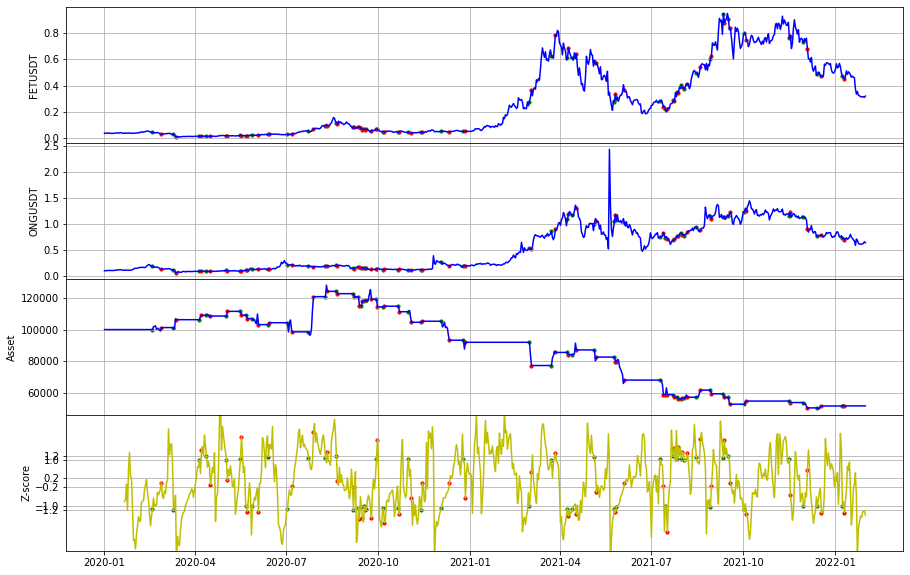

FETUSDT_HOTUSDT 回測結果
-----------------------------FETUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  -20522.61442788
總交易次數:  47
平均損益:  -436.65137080589443
勝率:  0.3617021276595745
獲利因子:  0.8098265248543286
賺賠比:  1.429105632095874
最大資金回落:  38773.71852553918
夏普比率:  -0.0633849104024581


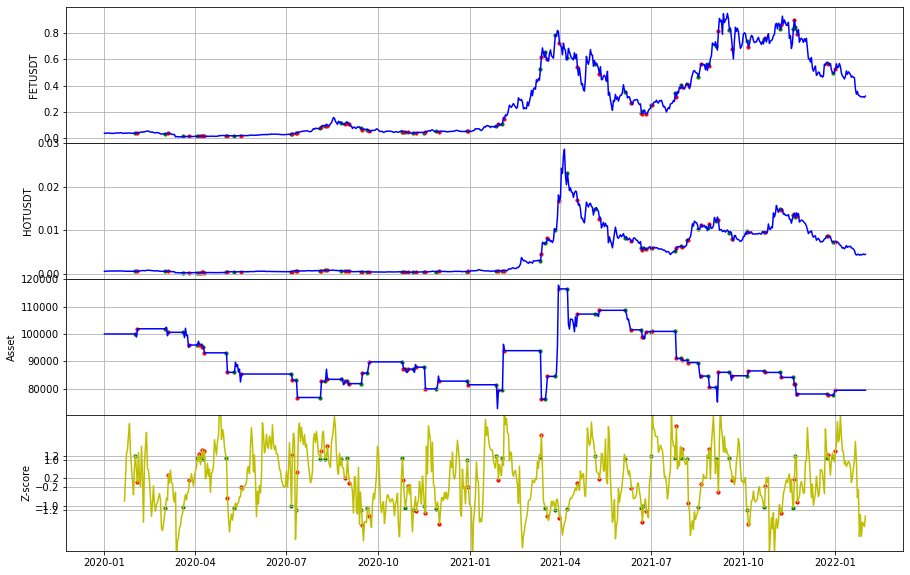

FETUSDT_IOSTUSDT 回測結果
-----------------------------FETUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  -16862.51370109
總交易次數:  52
平均損益:  -324.27910963640505
勝率:  0.46153846153846156
獲利因子:  0.8361441401553823
賺賠比:  0.9755014968479461
最大資金回落:  42047.708971305896
夏普比率:  -0.05794847768187807


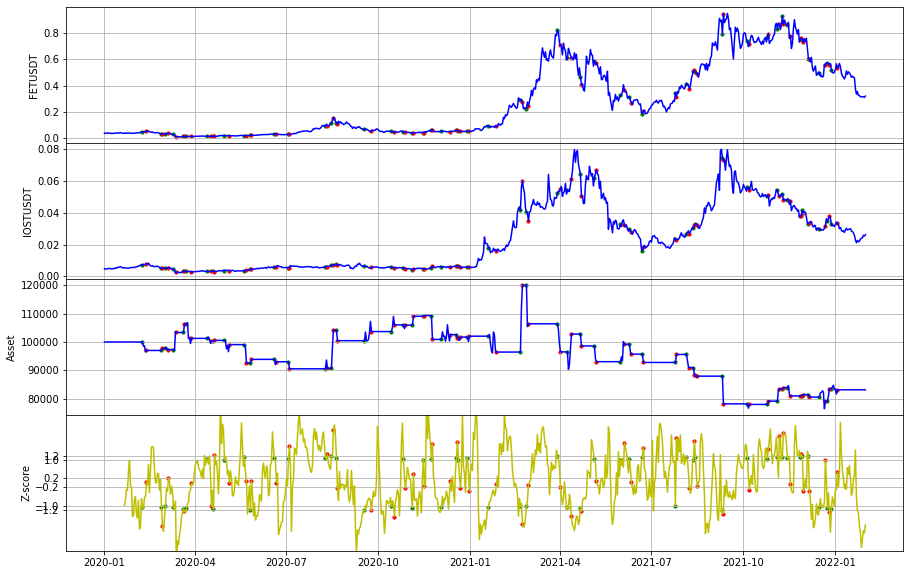

FETUSDT_CELRUSDT 回測結果
-----------------------------FETUSDT-CELRUSDT--------------------------
初始價格 100000
總損益:  -33401.91805421
總交易次數:  56
平均損益:  -596.4628223966445
勝率:  0.5535714285714286
獲利因子:  0.6642850017287428
賺賠比:  0.5357137110715668
最大資金回落:  52953.9437437271
夏普比率:  -0.13130262584110358


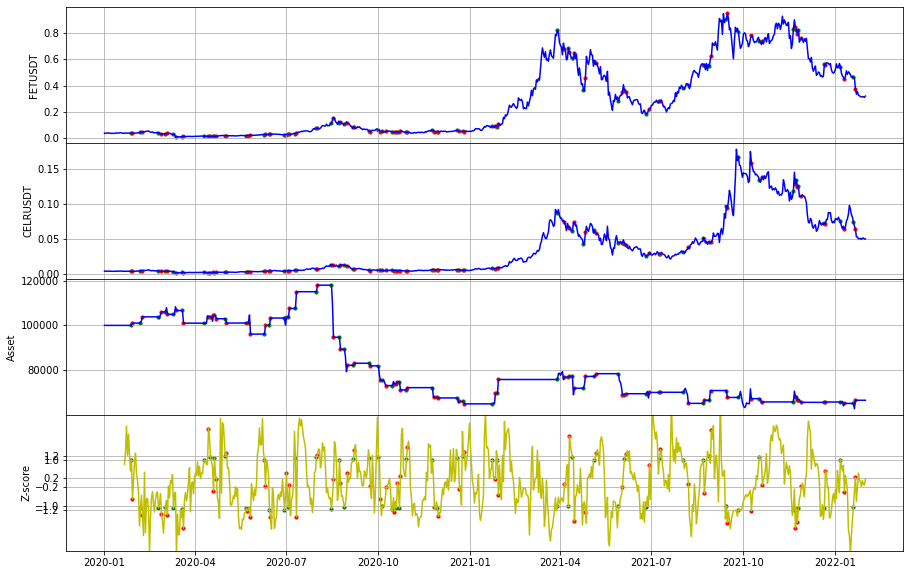

FETUSDT_OMGUSDT 回測結果
-----------------------------FETUSDT-OMGUSDT--------------------------
初始價格 100000
總損益:  -3048.05016262
總交易次數:  50
平均損益:  -60.961003252429364
勝率:  0.48
獲利因子:  0.9745952229113161
賺賠比:  1.0558114914872592
最大資金回落:  78884.52877062053
夏普比率:  -0.008819843118530594


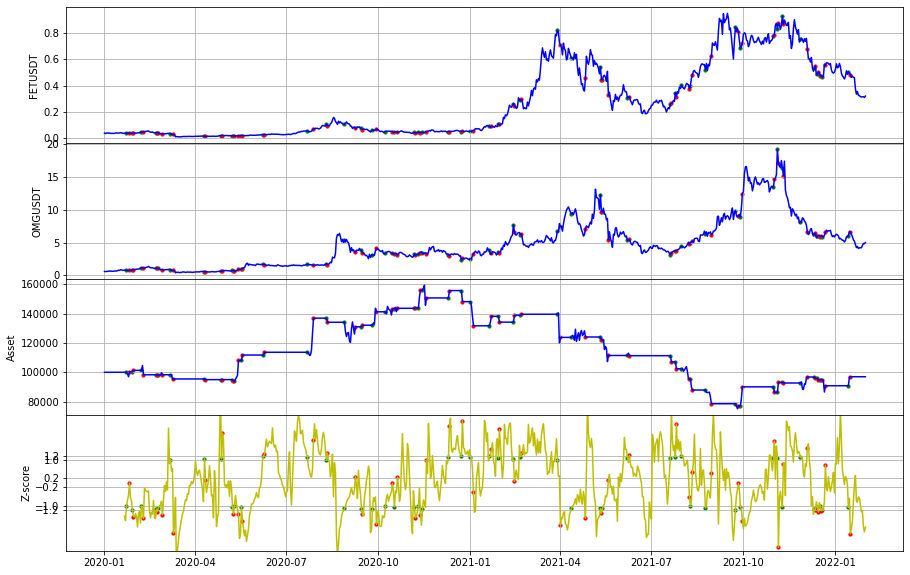

FETUSDT_ATOMUSDT 回測結果
-----------------------------FETUSDT-ATOMUSDT--------------------------
初始價格 100000
總損益:  50818.73342909
總交易次數:  56
平均損益:  907.4773826623538
勝率:  0.5357142857142857
獲利因子:  1.482331729507574
賺賠比:  1.2846874989065642
最大資金回落:  32083.32687308482
夏普比率:  0.14345092407929108


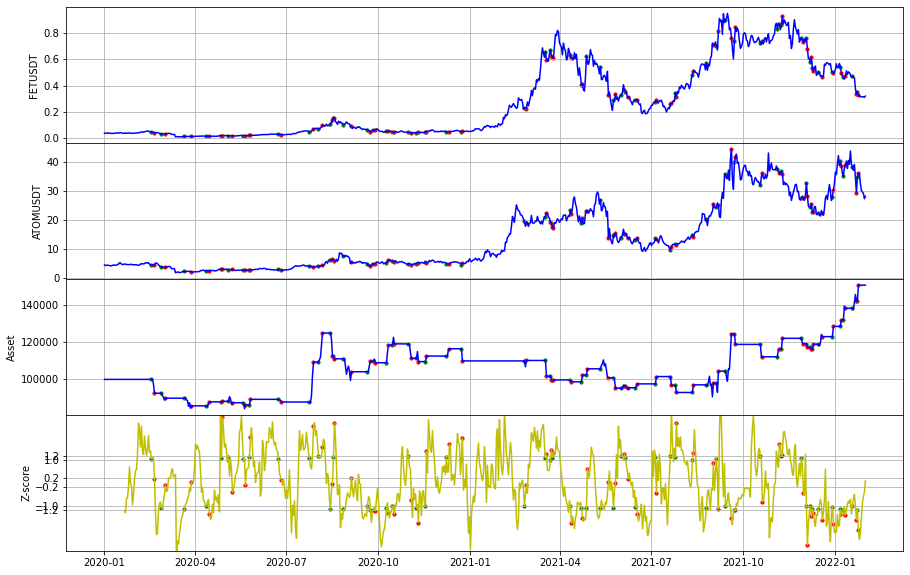

BATUSDT_ENJUSDT 回測結果
-----------------------------BATUSDT-ENJUSDT--------------------------
初始價格 100000
總損益:  -30013.00988575
總交易次數:  49
平均損益:  -612.5104058316941
勝率:  0.32653061224489793
獲利因子:  0.4430991392375133
賺賠比:  0.9138919746773713
最大資金回落:  33285.96832585192
夏普比率:  -0.29279429292269654


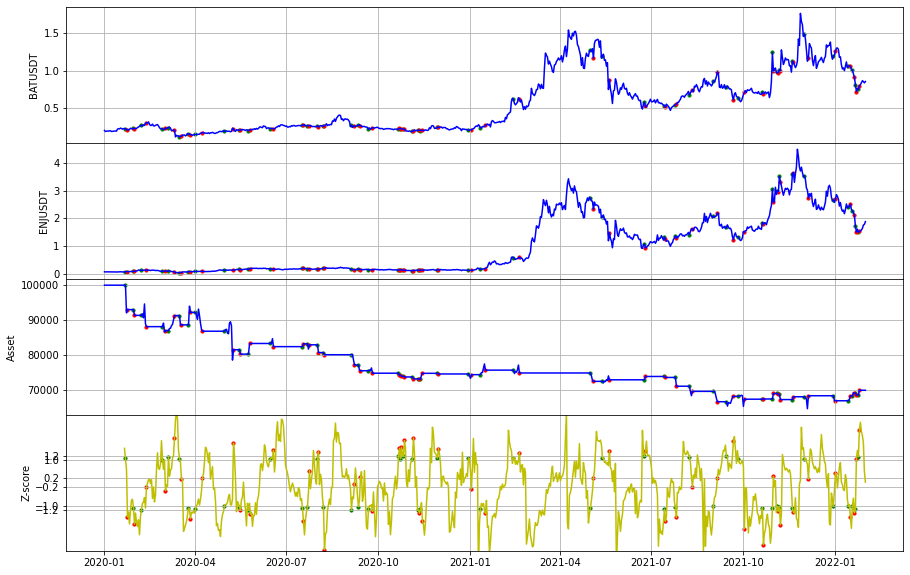

BATUSDT_ATOMUSDT 回測結果
-----------------------------BATUSDT-ATOMUSDT--------------------------
初始價格 100000
總損益:  5744.37109068
總交易次數:  59
平均損益:  97.36222187599554
勝率:  0.5254237288135594
獲利因子:  1.0518182745333755
賺賠比:  0.9500294092559521
最大資金回落:  33546.167382298954
夏普比率:  0.01788988398963922


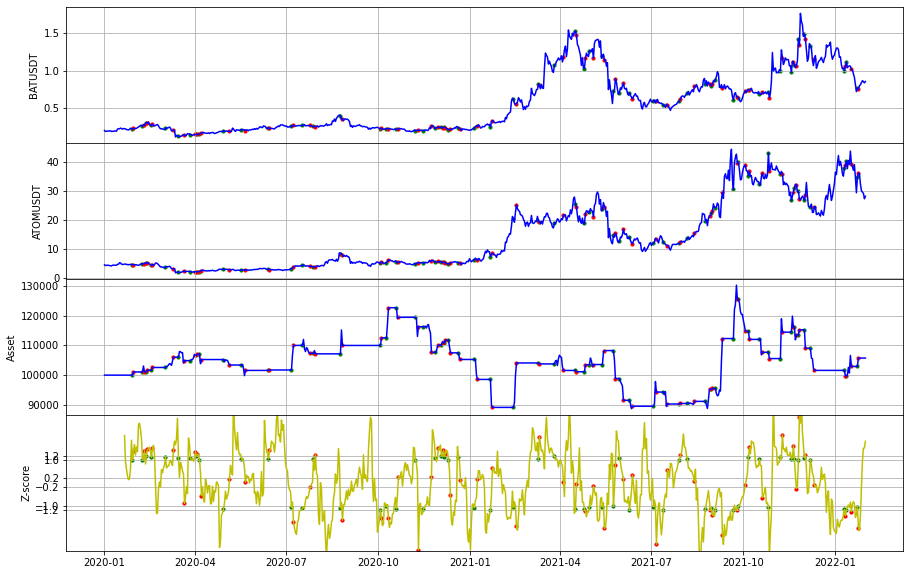

XMRUSDT_XLMUSDT 回測結果
-----------------------------XMRUSDT-XLMUSDT--------------------------
初始價格 100000
總損益:  7137.64934811
總交易次數:  60
平均損益:  118.96082246851098
勝率:  0.5333333333333333
獲利因子:  1.091050406373137
賺賠比:  0.9546691055764949
最大資金回落:  26148.58311848766
夏普比率:  0.03164126277782923


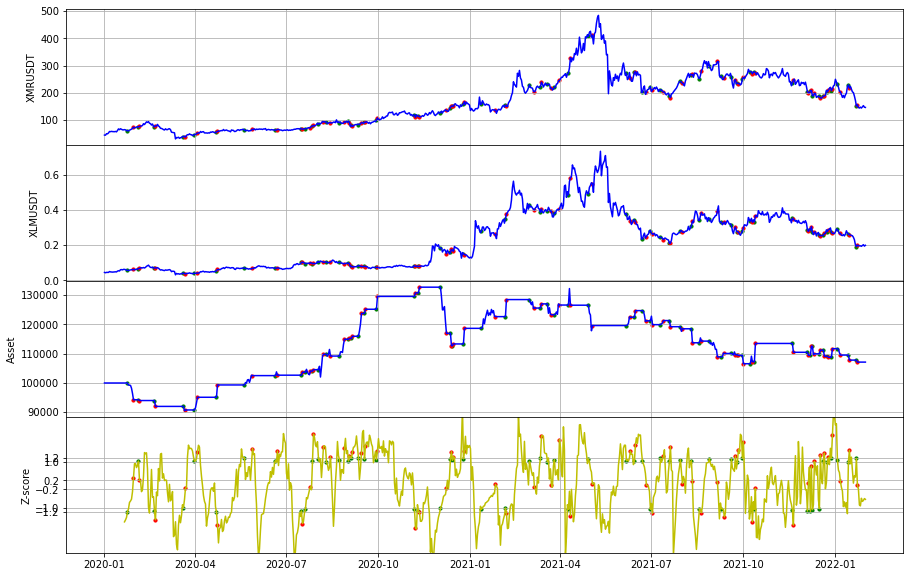

XMRUSDT_TFUELUSDT 回測結果
-----------------------------XMRUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  33759.17937569
總交易次數:  63
平均損益:  535.8599900902593
勝率:  0.5873015873015873
獲利因子:  1.3205563046434168
賺賠比:  0.9279584843440226
最大資金回落:  30734.160761617706
夏普比率:  0.09392037998632549


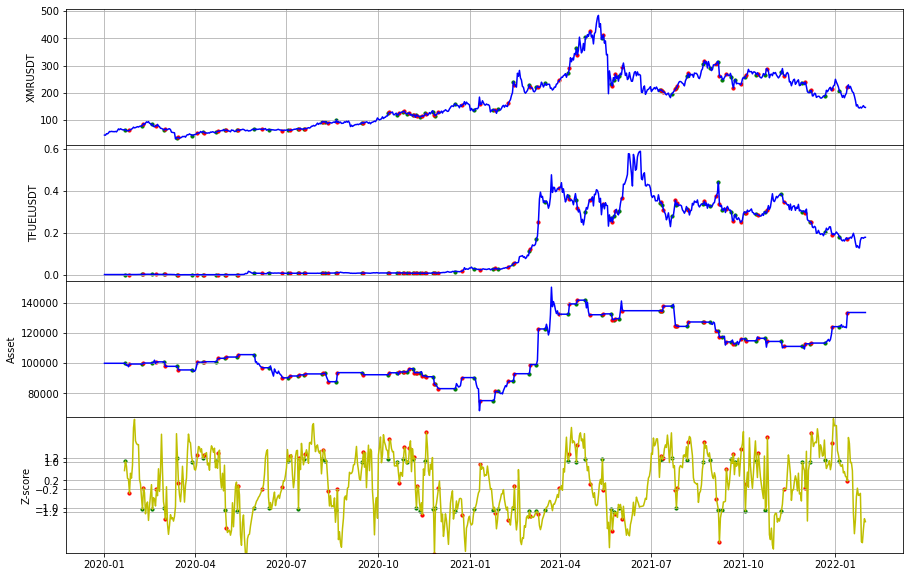

XMRUSDT_ONGUSDT 回測結果
-----------------------------XMRUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -17279.45249250
總交易次數:  61
平均損益:  -283.2697129917448
勝率:  0.4098360655737705
獲利因子:  0.8620148020421649
賺賠比:  1.2413013149407175
最大資金回落:  41619.27374449551
夏普比率:  -0.044601101860750295


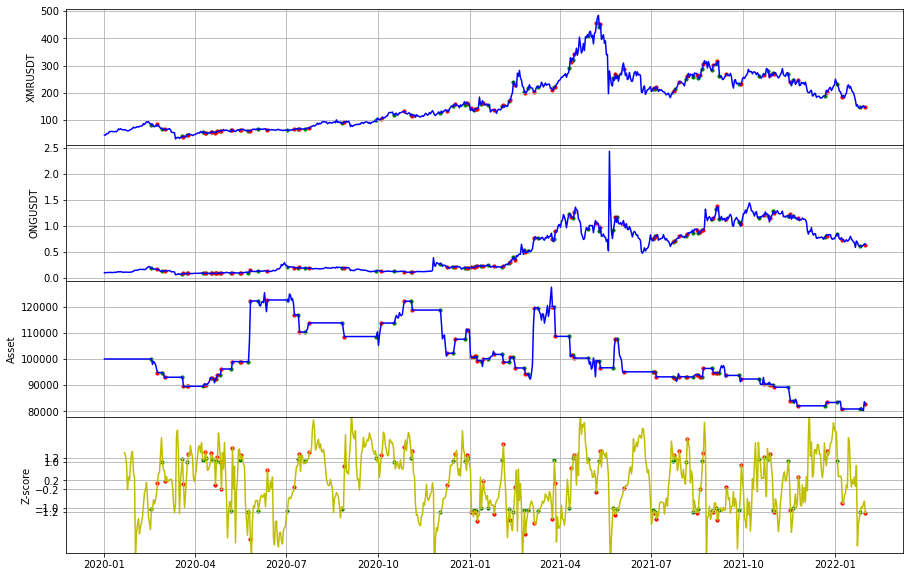

XMRUSDT_HOTUSDT 回測結果
-----------------------------XMRUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  149964.06353685
總交易次數:  49
平均損益:  3060.4910925887666
勝率:  0.5510204081632653
獲利因子:  2.322411492615891
賺賠比:  1.8923352902796147
最大資金回落:  60196.872230280715
夏普比率:  0.17905469897057788


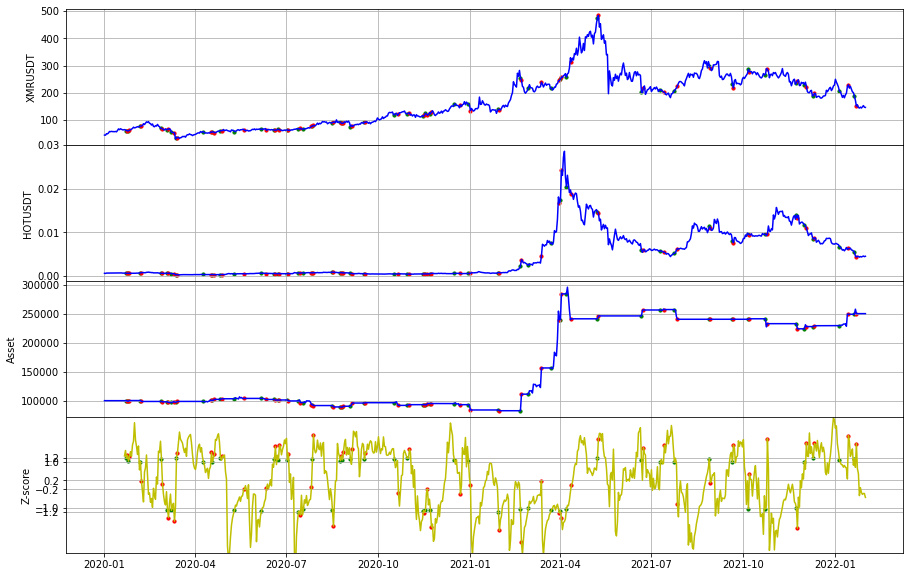

XMRUSDT_THETAUSDT 回測結果
-----------------------------XMRUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -16858.69702817
總交易次數:  51
平均損益:  -330.5626868269339
勝率:  0.45098039215686275
獲利因子:  0.8584368566969808
賺賠比:  1.0450535646745853
最大資金回落:  54557.390585045796
夏普比率:  -0.05150811809787863


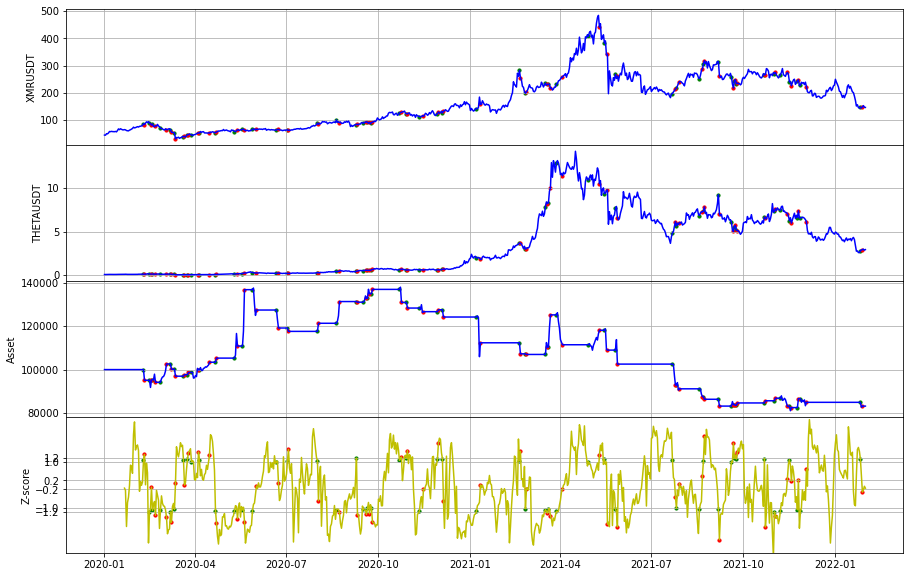

ZECUSDT_BTCUSDT 回測結果，場上有單已平倉
-----------------------------ZECUSDT-BTCUSDT--------------------------
初始價格 100000
總損益:  -6336.83354428
總交易次數:  59
平均損益:  -107.40395837757461
勝率:  0.4745762711864407
獲利因子:  0.9007473537637788
賺賠比:  0.9972559988098979
最大資金回落:  36434.08353068543
夏普比率:  -0.03622460158608519


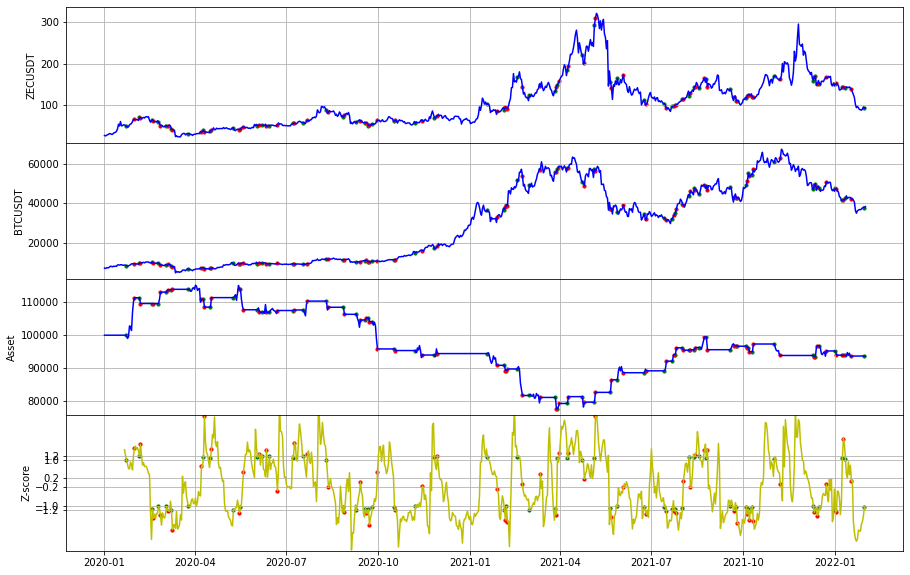

ZECUSDT_IOTAUSDT 回測結果
-----------------------------ZECUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  -39938.40660815
總交易次數:  62
平均損益:  -644.1678485185041
勝率:  0.43548387096774194
獲利因子:  0.5904063896153703
賺賠比:  0.7653416161680726
最大資金回落:  57286.40659140273
夏普比率:  -0.14679545151941517


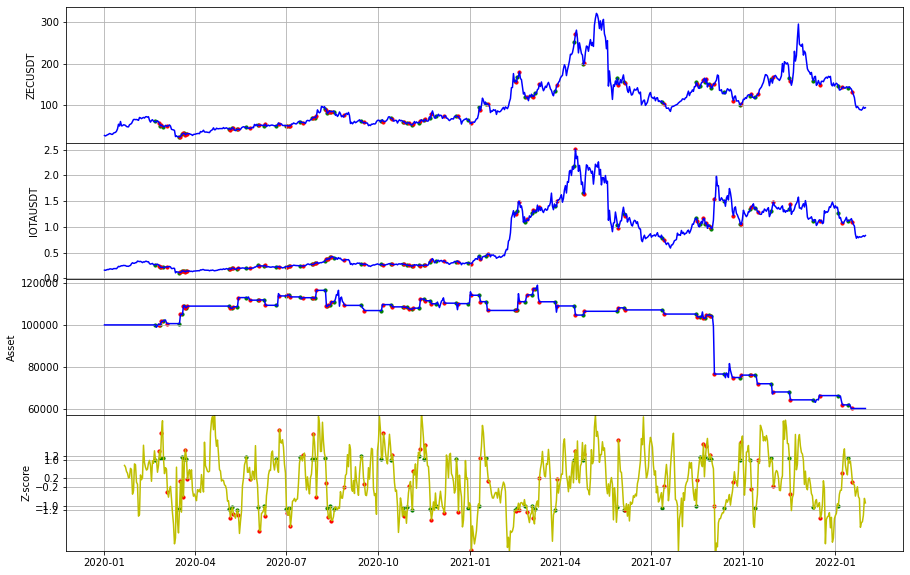

ZECUSDT_TRXUSDT 回測結果，場上有單已平倉
-----------------------------ZECUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  -902.37921015
總交易次數:  52
平均損益:  -17.35344634897774
勝率:  0.4230769230769231
獲利因子:  0.9917710827834533
賺賠比:  1.3524151128865274
最大資金回落:  45219.77921392504
夏普比率:  -0.003053317957546501


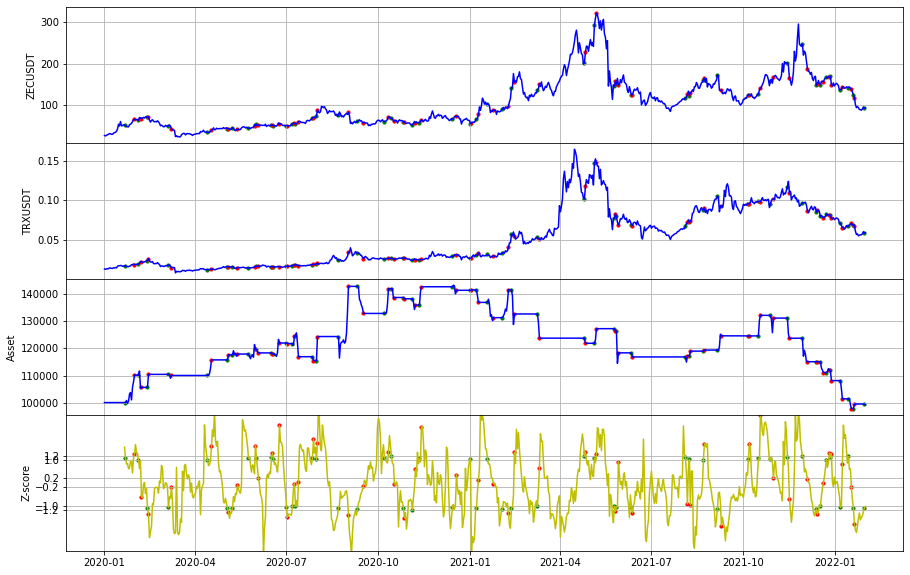

ZECUSDT_ICXUSDT 回測結果
-----------------------------ZECUSDT-ICXUSDT--------------------------
初始價格 100000
總損益:  -33558.74392821
總交易次數:  56
平均損益:  -599.2632844323309
勝率:  0.39285714285714285
獲利因子:  0.7306380694715406
賺賠比:  1.1291679255469265
最大資金回落:  61247.42001231193
夏普比率:  -0.12529000362198822


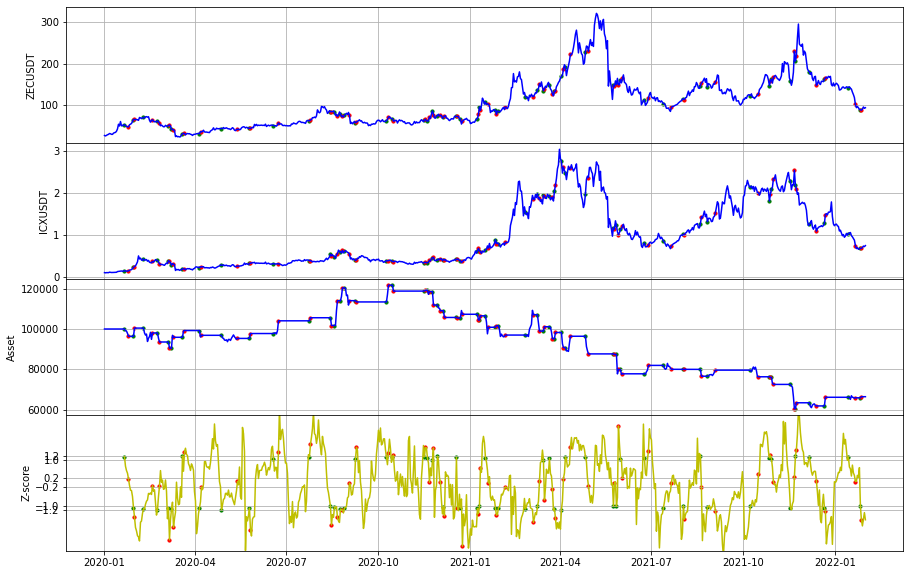

ZECUSDT_NULSUSDT 回測結果
-----------------------------ZECUSDT-NULSUSDT--------------------------
初始價格 100000
總損益:  27166.90036462
總交易次數:  64
平均損益:  424.4828181972209
勝率:  0.53125
獲利因子:  1.2094628546386865
賺賠比:  1.0671731070341353
最大資金回落:  39647.778807411916
夏普比率:  0.06689136331323621


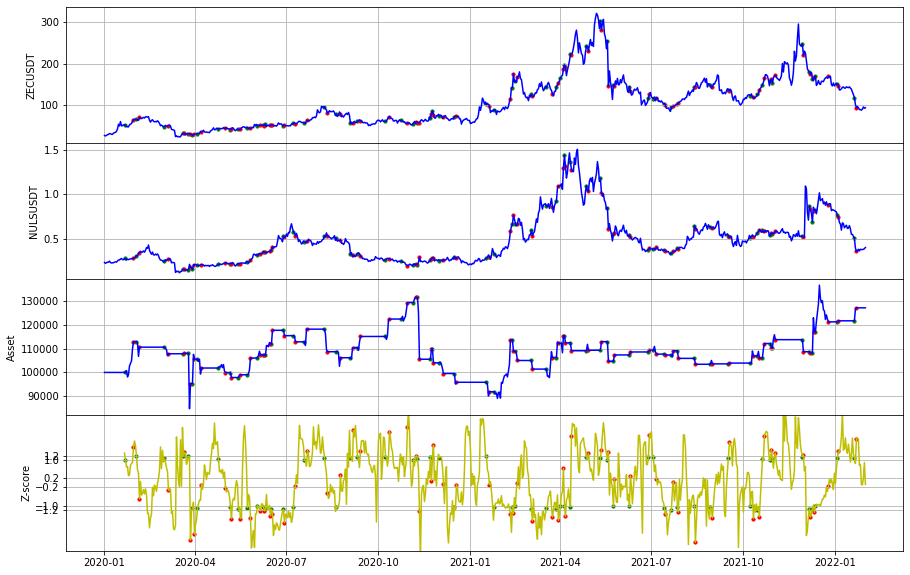

ZECUSDT_VETUSDT 回測結果
-----------------------------ZECUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -29566.81176406
總交易次數:  54
平均損益:  -547.5335511863011
勝率:  0.46296296296296297
獲利因子:  0.7200266807192044
賺賠比:  0.8352309496342771
最大資金回落:  62171.58054094952
夏普比率:  -0.11953010348605043


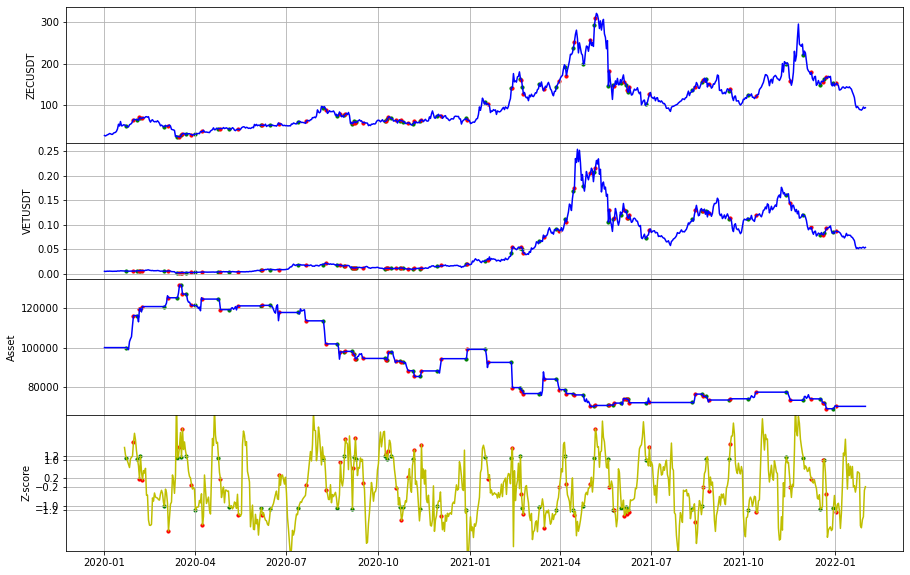

ZECUSDT_TFUELUSDT 回測結果
-----------------------------ZECUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  79973.13580594
總交易次數:  55
平均損益:  1454.057014653472
勝率:  0.5272727272727272
獲利因子:  1.3994281355132174
賺賠比:  1.2546597077015054
最大資金回落:  55293.96987756659
夏普比率:  0.10565673094266932


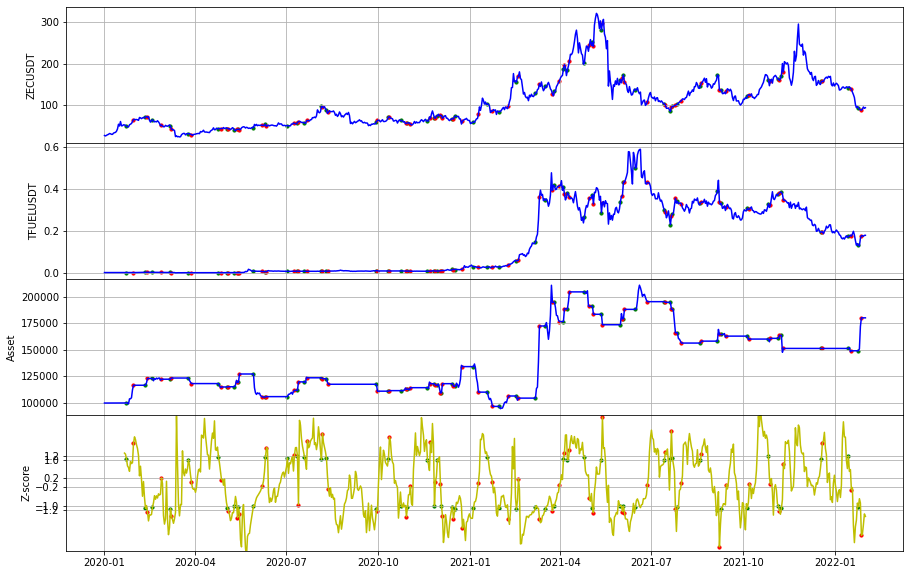

ZECUSDT_LINKUSDT 回測結果
-----------------------------ZECUSDT-LINKUSDT--------------------------
初始價格 100000
總損益:  3043.20263588
總交易次數:  38
平均損益:  80.08427989147727
勝率:  0.5
獲利因子:  1.0490744969134833
賺賠比:  1.0490744969134833
最大資金回落:  28580.71697206823
夏普比率:  0.019123681066085346


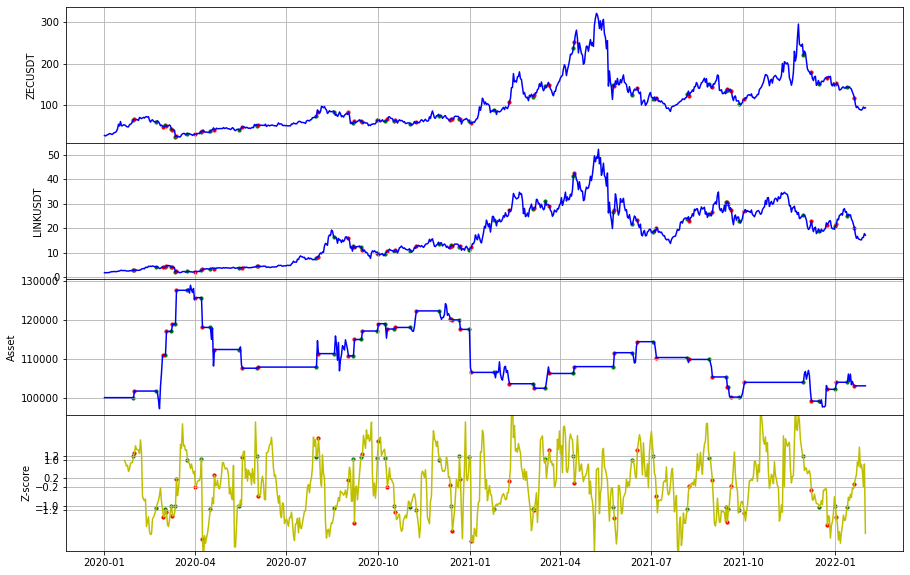

ZECUSDT_ONGUSDT 回測結果，場上有單已平倉
-----------------------------ZECUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -38165.68144158
總交易次數:  56
平均損益:  -681.5300257425412
勝率:  0.5357142857142857
獲利因子:  0.8498007317102184
賺賠比:  0.7364939674821893
最大資金回落:  167291.31737770623
夏普比率:  -0.02484861310704825


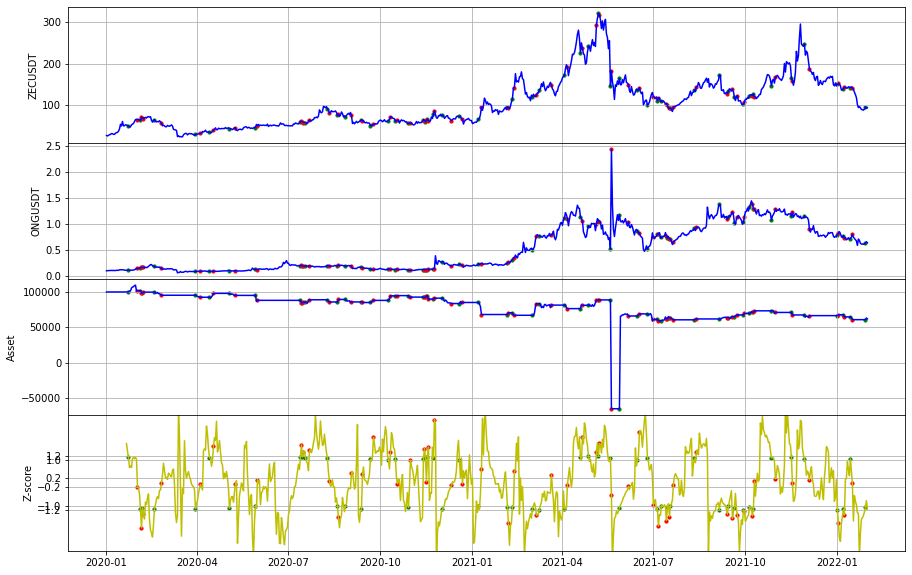

ZECUSDT_HOTUSDT 回測結果
-----------------------------ZECUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  78777.32346941
總交易次數:  55
平均損益:  1432.3149721711663
勝率:  0.45454545454545453
獲利因子:  1.6765387236348852
賺賠比:  2.0118464683618624
最大資金回落:  36529.67922543391
夏普比率:  0.10557537137072455


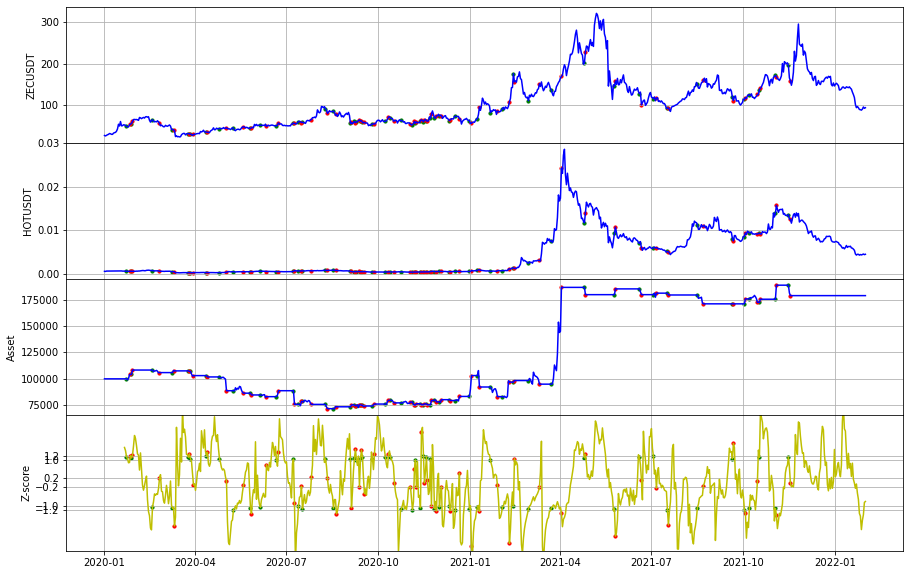

ZECUSDT_ZRXUSDT 回測結果
-----------------------------ZECUSDT-ZRXUSDT--------------------------
初始價格 100000
總損益:  5364.37582122
總交易次數:  53
平均損益:  101.21463813628718
勝率:  0.39622641509433965
獲利因子:  1.046715428082004
賺賠比:  1.5949949380297201
最大資金回落:  39950.22915980371
夏普比率:  0.015320548656451105


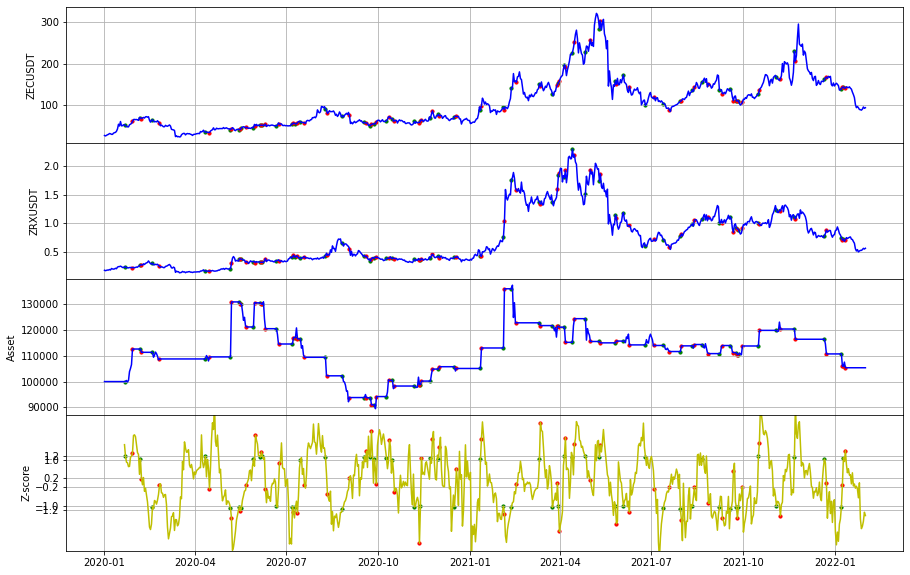

ZECUSDT_FETUSDT 回測結果
-----------------------------ZECUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  -8602.93375767
總交易次數:  44
平均損益:  -195.5212217651758
勝率:  0.45454545454545453
獲利因子:  0.9205750871878756
賺賠比:  1.1046901046254507
最大資金回落:  43414.52861514241
夏普比率:  -0.02815034441728802


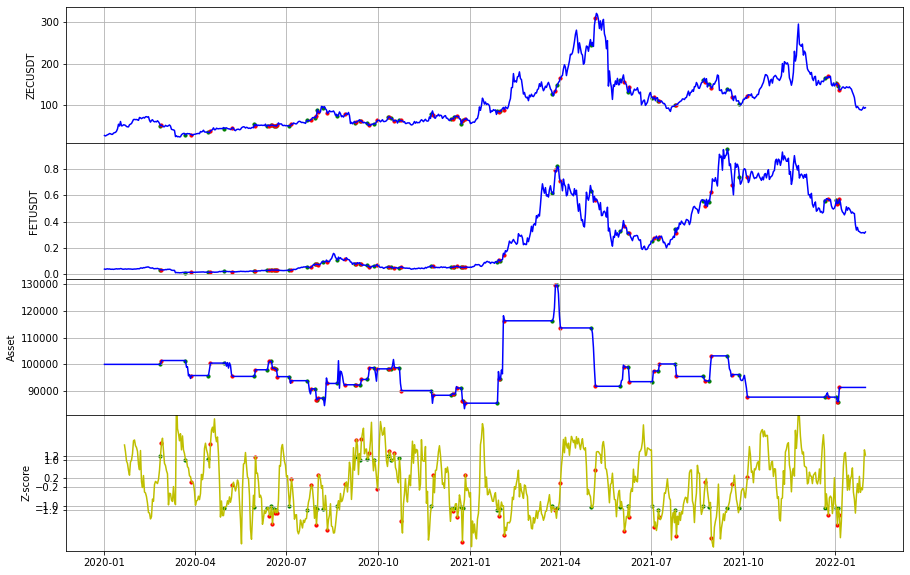

ZECUSDT_XMRUSDT 回測結果
-----------------------------ZECUSDT-XMRUSDT--------------------------
初始價格 100000
總損益:  -2864.76793771
總交易次數:  63
平均損益:  -45.47250694775121
勝率:  0.4603174603174603
獲利因子:  0.971113862416478
賺賠比:  1.1385472869710431
最大資金回落:  22559.905037224336
夏普比率:  -0.010956381621443398


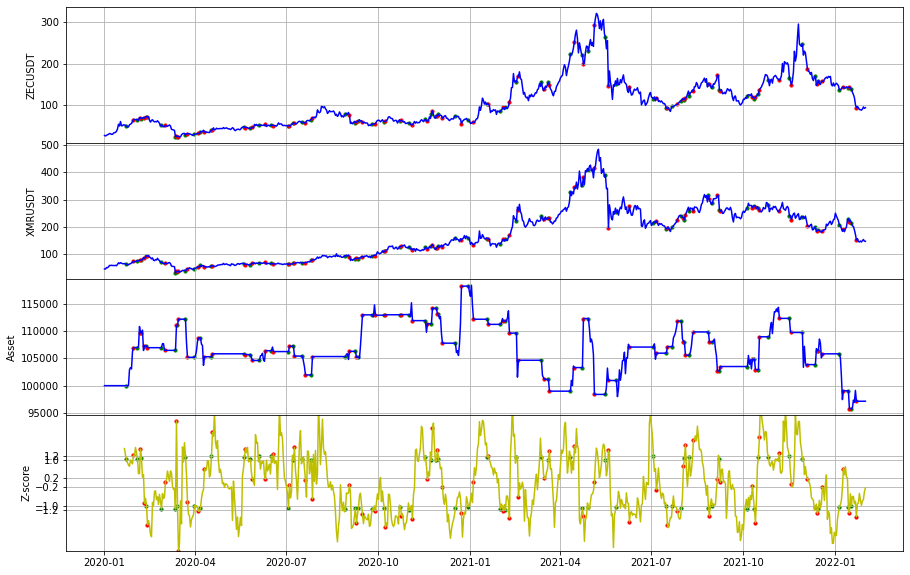

ZECUSDT_THETAUSDT 回測結果
-----------------------------ZECUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -6716.61255650
總交易次數:  61
平均損益:  -110.10840256559923
勝率:  0.5573770491803278
獲利因子:  0.9691997556666048
賺賠比:  0.7696586294999509
最大資金回落:  118801.94112053016
夏普比率:  -0.009241111596657539


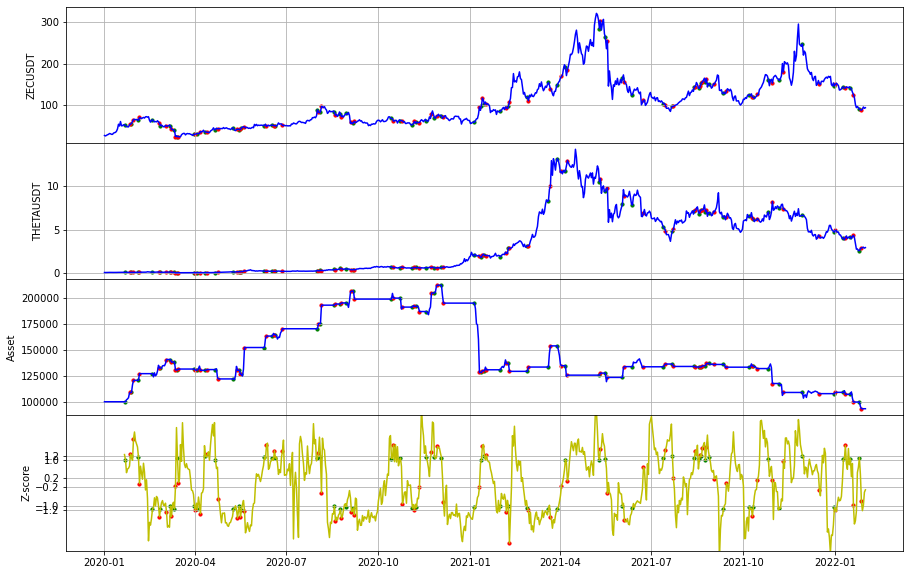

ZECUSDT_ENJUSDT 回測結果
-----------------------------ZECUSDT-ENJUSDT--------------------------
初始價格 100000
總損益:  22481.21514451
總交易次數:  56
平均損益:  401.45027043772564
勝率:  0.5357142857142857
獲利因子:  1.1833700252343717
賺賠比:  1.025587355203122
最大資金回落:  27310.809208490828
夏普比率:  0.061730020624416


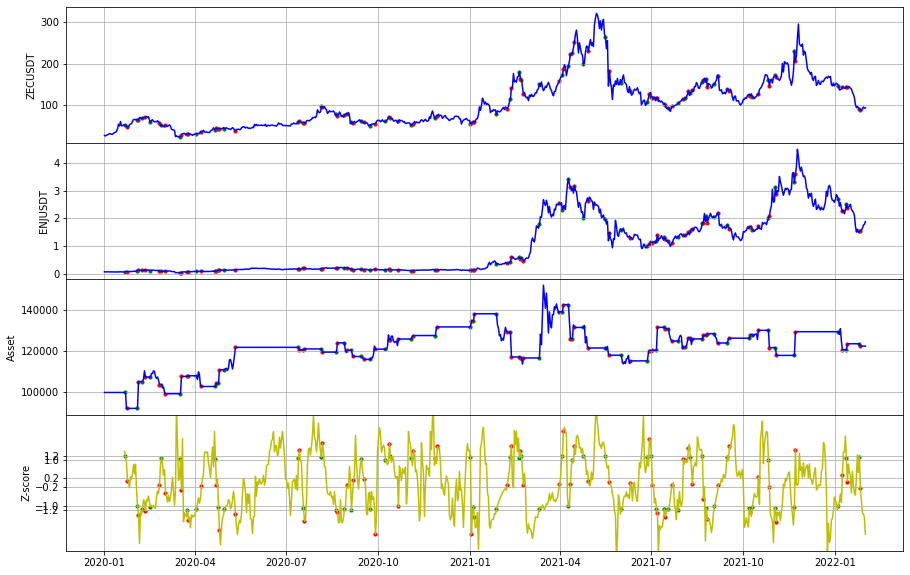

ZECUSDT_MITHUSDT 回測結果
-----------------------------ZECUSDT-MITHUSDT--------------------------
初始價格 100000
總損益:  31438.87643087
總交易次數:  53
平均損益:  593.1863477522335
勝率:  0.5094339622641509
獲利因子:  1.3458013704693512
賺賠比:  1.2959568752667823
最大資金回落:  37005.98148860599
夏普比率:  0.06191597600216562


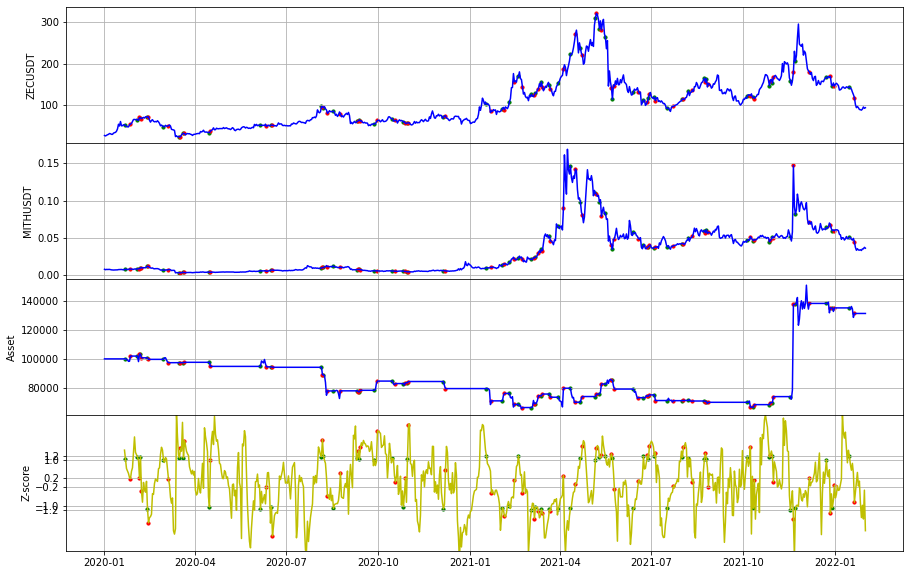

IOSTUSDT_QTUMUSDT 回測結果
-----------------------------IOSTUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  9027.51139327
總交易次數:  48
平均損益:  188.0731540265224
勝率:  0.5416666666666666
獲利因子:  1.1280148774132923
賺賠比:  0.9544741270420164
最大資金回落:  30320.134157619832
夏普比率:  0.039694170084919496


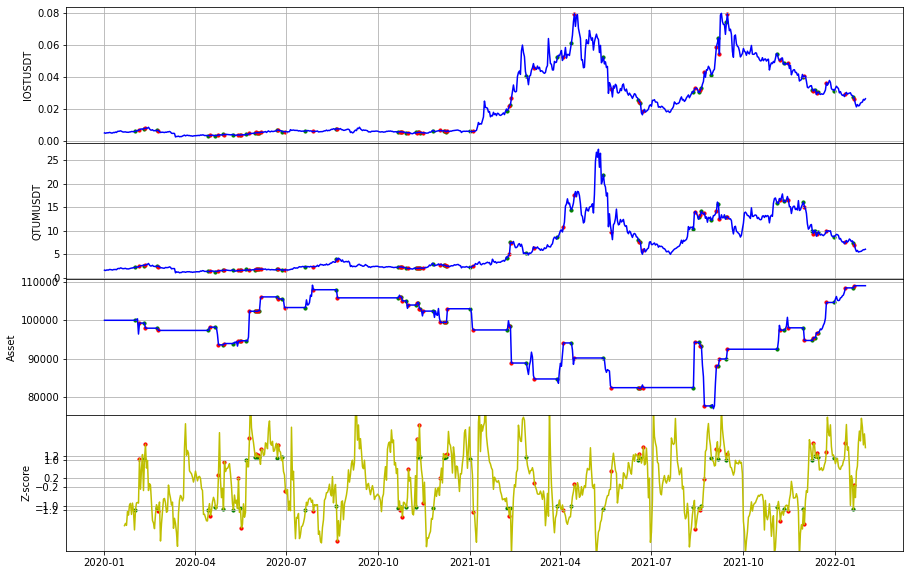

IOSTUSDT_XRPUSDT 回測結果
-----------------------------IOSTUSDT-XRPUSDT--------------------------
初始價格 100000
總損益:  29733.57819588
總交易次數:  46
平均損益:  646.3821346930275
勝率:  0.5869565217391305
獲利因子:  1.5671671827917373
賺賠比:  1.1028213508534448
最大資金回落:  20023.61369230674
夏普比率:  0.14566171710725778


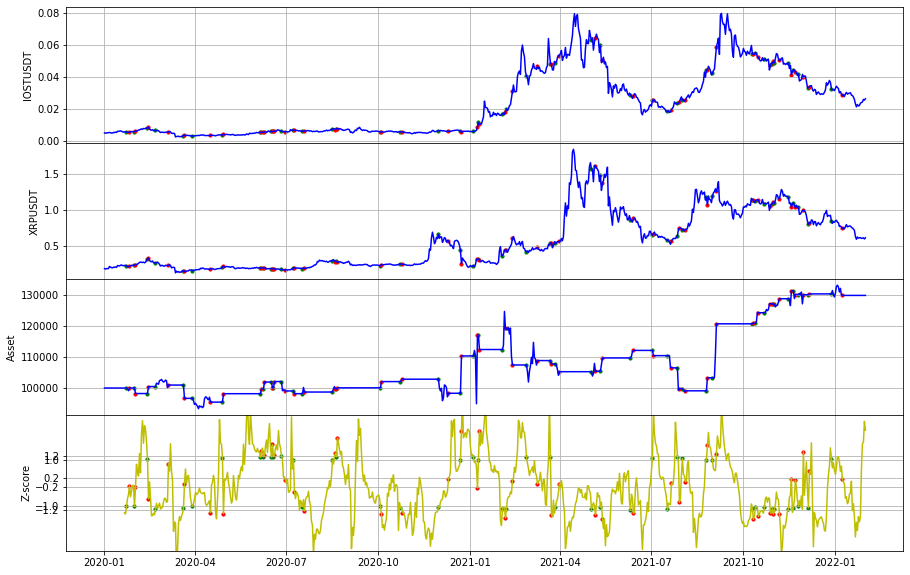

IOSTUSDT_TRXUSDT 回測結果
-----------------------------IOSTUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  3575.68107910
總交易次數:  57
平均損益:  62.73124700179375
勝率:  0.43859649122807015
獲利因子:  1.0469528905149854
賺賠比:  1.3400996998591814
最大資金回落:  25533.03229120774
夏普比率:  0.01486455544273461


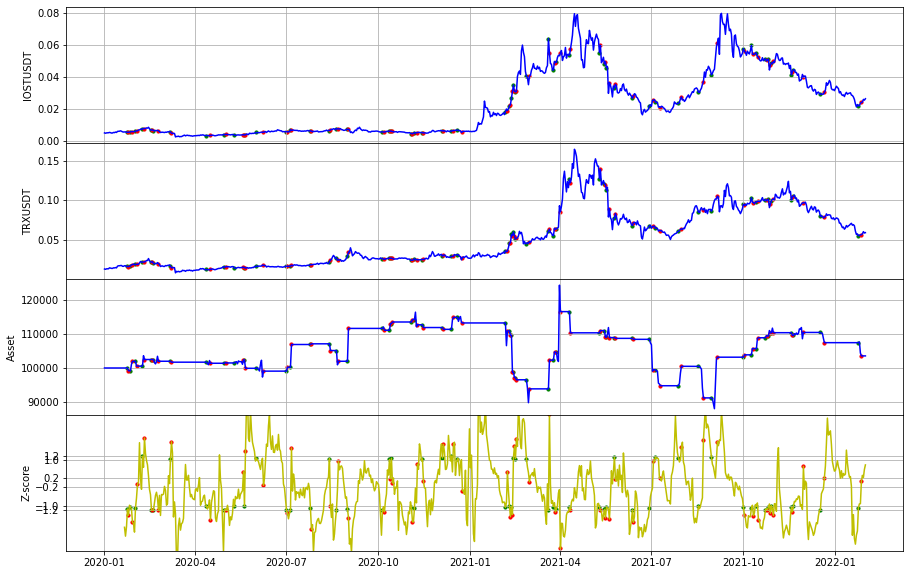

IOSTUSDT_ICXUSDT 回測結果
-----------------------------IOSTUSDT-ICXUSDT--------------------------
初始價格 100000
總損益:  -25111.57514983
總交易次數:  43
平均損益:  -583.990119763403
勝率:  0.5581395348837209
獲利因子:  0.7144066043074183
賺賠比:  0.5655718950767062
最大資金回落:  59519.735879110005
夏普比率:  -0.09717624358045827


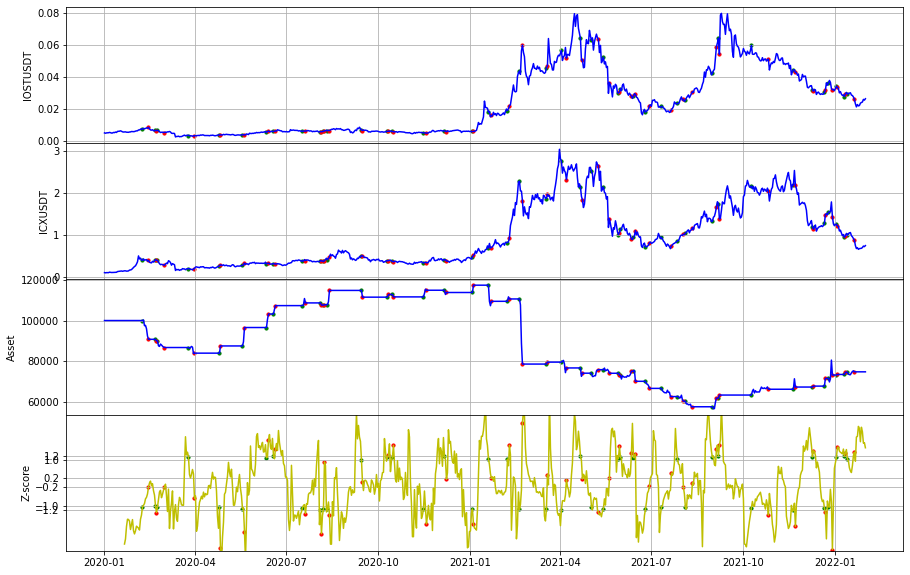

IOSTUSDT_VETUSDT 回測結果
-----------------------------IOSTUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  12179.05826561
總交易次數:  51
平均損益:  238.80506403148735
勝率:  0.5294117647058824
獲利因子:  1.1788876000554842
賺賠比:  1.0479000889382084
最大資金回落:  34180.79367533384
夏普比率:  0.058435925278320824


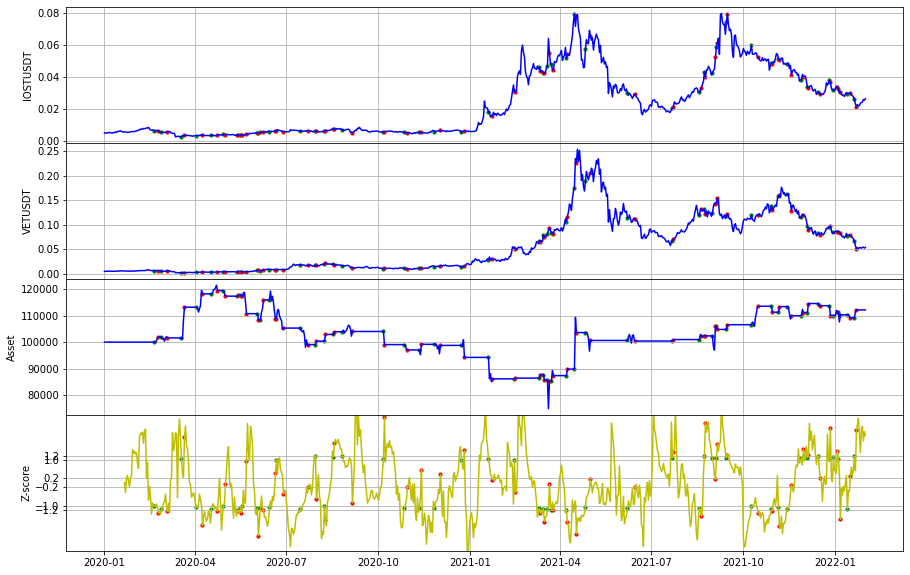

IOSTUSDT_TFUELUSDT 回測結果，場上有單已平倉
-----------------------------IOSTUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  -44677.15550533
總交易次數:  62
平均損益:  -720.5992823441018
勝率:  0.5645161290322581
獲利因子:  0.6305811134844177
賺賠比:  0.46843168430271026
最大資金回落:  77581.47641206955
夏普比率:  -0.09342705269145743


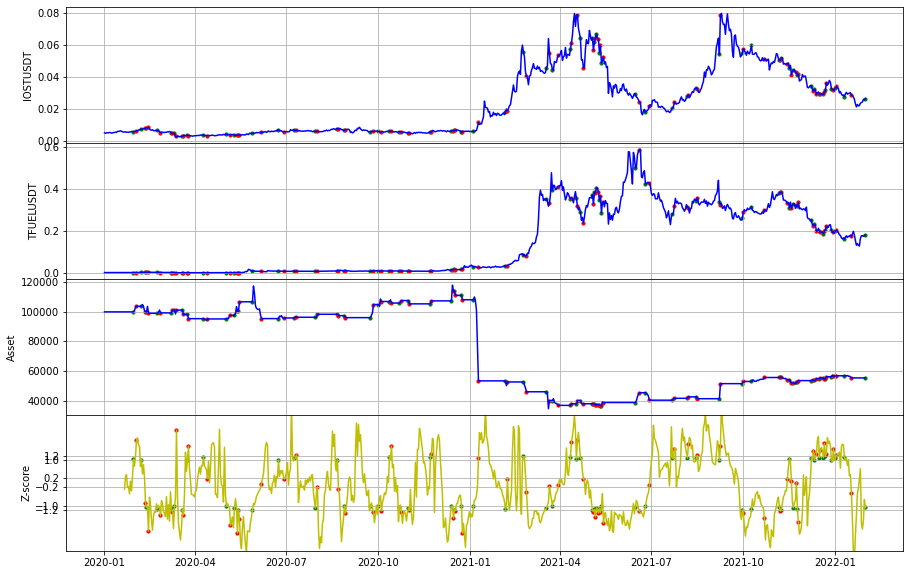

IOSTUSDT_ONGUSDT 回測結果
-----------------------------IOSTUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -98649.58786298
總交易次數:  53
平均損益:  -1861.31297854685
勝率:  0.39622641509433965
獲利因子:  0.16027668928190847
賺賠比:  0.24423114557243195
最大資金回落:  101599.7280769084
夏普比率:  -0.16108920378727454


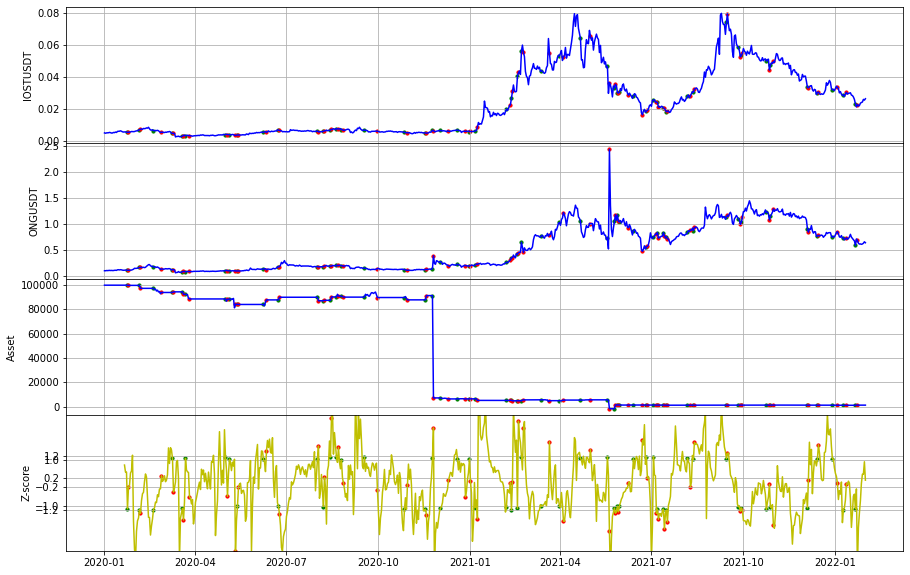

IOSTUSDT_HOTUSDT 回測結果
-----------------------------IOSTUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  -18980.56023625
總交易次數:  58
平均損益:  -327.2510385559485
勝率:  0.4482758620689655
獲利因子:  0.834989400569484
賺賠比:  1.027679262239365
最大資金回落:  49547.55029355665
夏普比率:  -0.044513076798669615


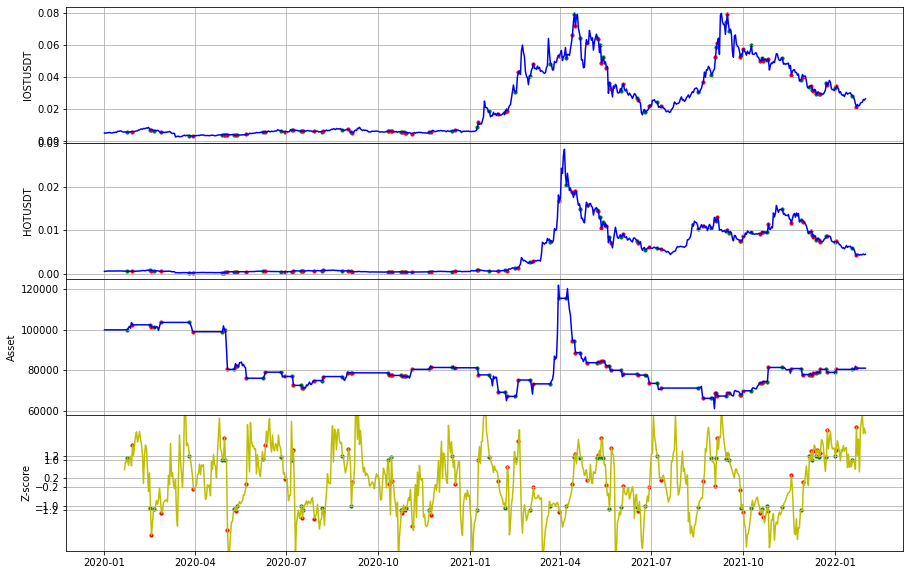

IOSTUSDT_THETAUSDT 回測結果
-----------------------------IOSTUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  37849.42695714
總交易次數:  54
平均損益:  700.915314021093
勝率:  0.5925925925925926
獲利因子:  1.2611218201692151
賺賠比:  0.8670212513663355
最大資金回落:  89760.57804201587
夏普比率:  0.05447548029551094


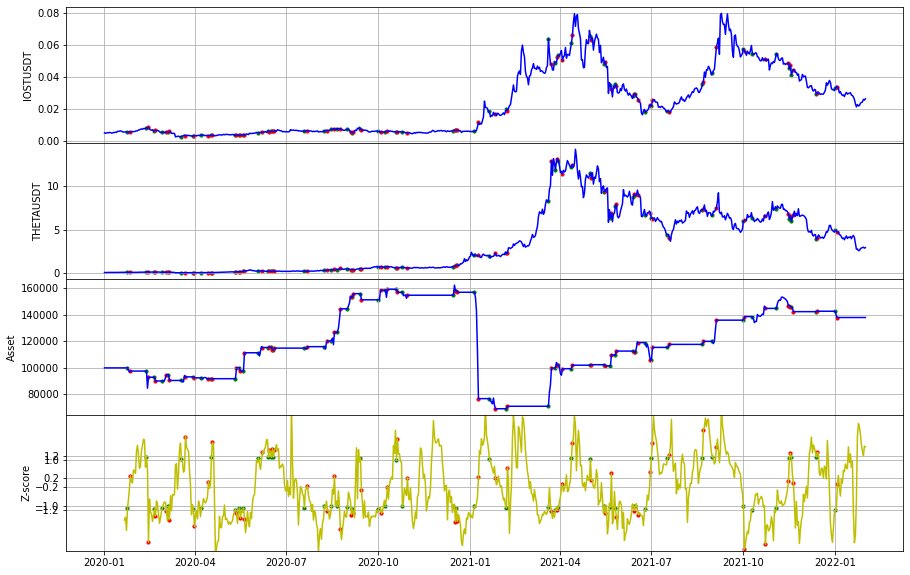

CELRUSDT_ETHUSDT 回測結果
-----------------------------CELRUSDT-ETHUSDT--------------------------
初始價格 100000
總損益:  99366.79707383
總交易次數:  60
平均損益:  1656.1132845638151
勝率:  0.5166666666666667
獲利因子:  1.6912017608620378
賺賠比:  1.5820919698386804
最大資金回落:  34316.92325719565
夏普比率:  0.18028427849886303


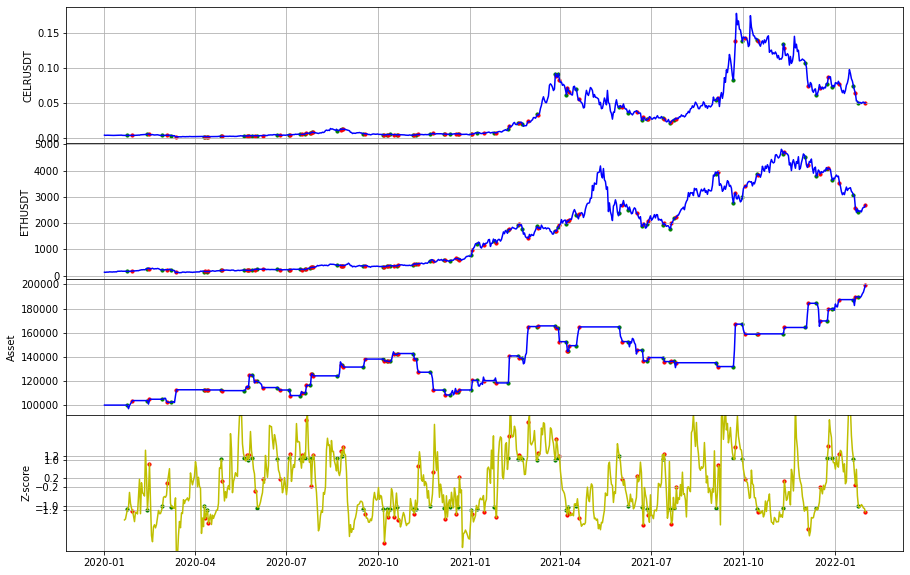

CELRUSDT_BNBUSDT 回測結果，場上有單已平倉
-----------------------------CELRUSDT-BNBUSDT--------------------------
初始價格 100000
總損益:  93933.04444167
總交易次數:  59
平均損益:  1592.0854990112994
勝率:  0.5423728813559322
獲利因子:  1.6143176582207657
賺賠比:  1.362080524123771
最大資金回落:  29514.225173913845
夏普比率:  0.16797458924683667


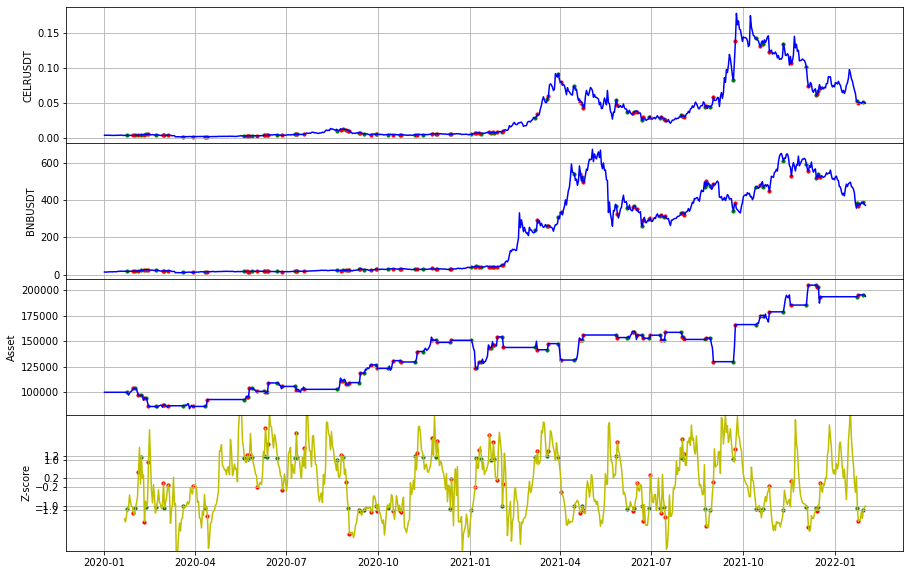

CELRUSDT_ADAUSDT 回測結果，場上有單已平倉
-----------------------------CELRUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  37458.29640777
總交易次數:  60
平均損益:  624.3049401295546
勝率:  0.55
獲利因子:  1.3519115548455043
賺賠比:  1.1061094539645036
最大資金回落:  21395.836362157395
夏普比率:  0.09552129339533652


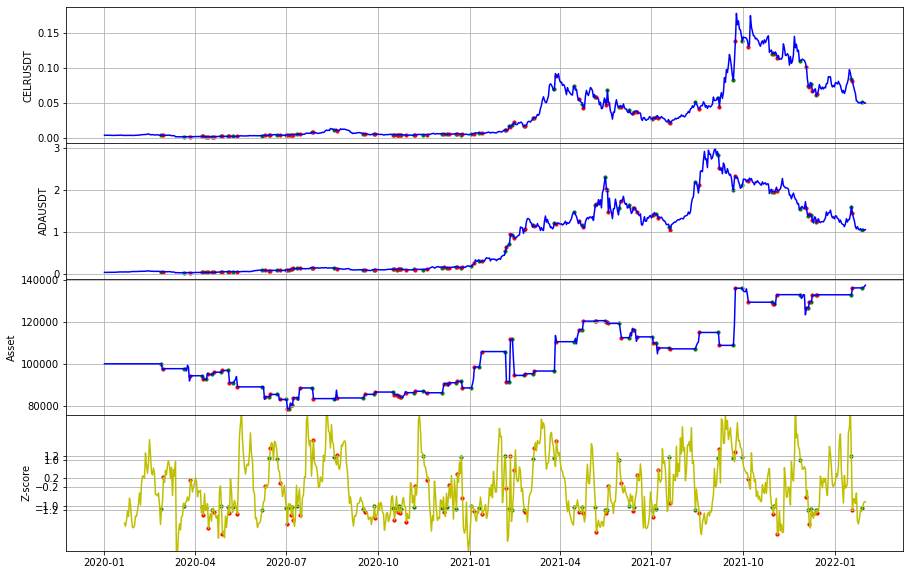

CELRUSDT_ONEUSDT 回測結果
-----------------------------CELRUSDT-ONEUSDT--------------------------
初始價格 100000
總損益:  23018.58674833
總交易次數:  68
平均損益:  338.5086286519624
勝率:  0.5735294117647058
獲利因子:  1.2707118661091379
賺賠比:  0.9448883106965386
最大資金回落:  20986.91473585862
夏普比率:  0.09207877488760656


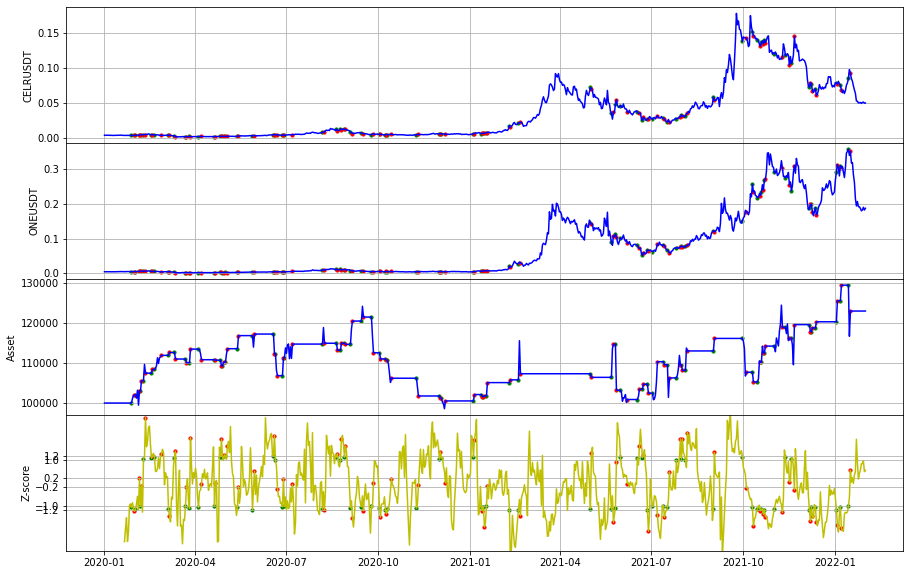

CELRUSDT_ONGUSDT 回測結果
-----------------------------CELRUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  16099.71703108
總交易次數:  52
平均損益:  309.6099429053639
勝率:  0.46153846153846156
獲利因子:  1.1164120586593131
賺賠比:  1.302480735102532
最大資金回落:  38754.8231646729
夏普比率:  0.03797454095175342


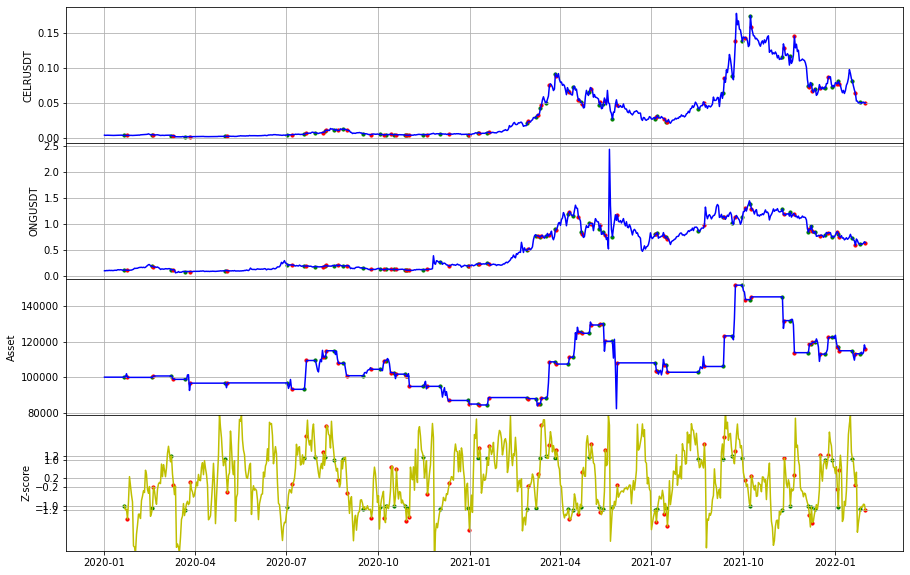

CELRUSDT_FETUSDT 回測結果
-----------------------------CELRUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  -64222.30926258
總交易次數:  55
平均損益:  -1167.678350228813
勝率:  0.45454545454545453
獲利因子:  0.4207783695406948
賺賠比:  0.5049340434488337
最大資金回落:  70870.06892370805
夏普比率:  -0.28167323434400793


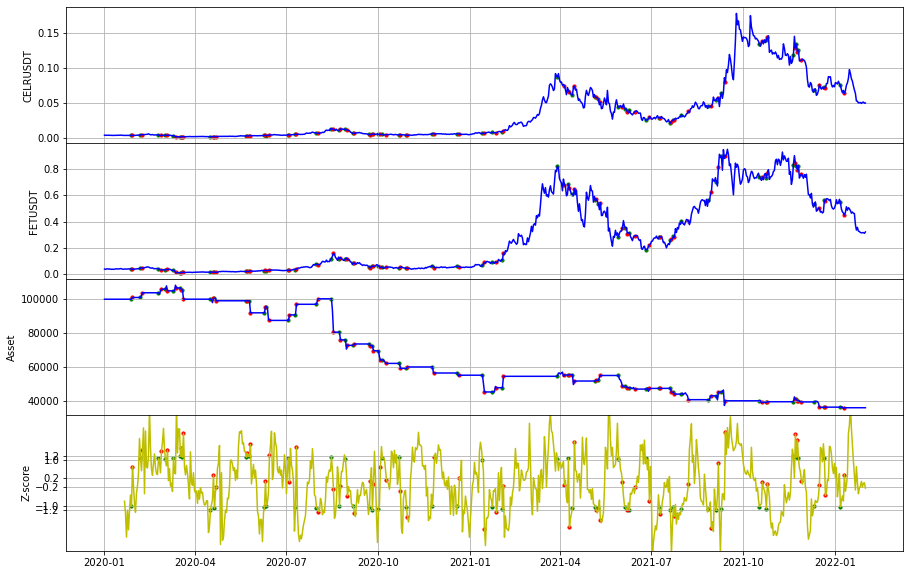

CELRUSDT_MATICUSDT 回測結果，場上有單已平倉
-----------------------------CELRUSDT-MATICUSDT--------------------------
初始價格 100000
總損益:  105418.44759075
總交易次數:  47
平均損益:  2242.9456934201075
勝率:  0.5319148936170213
獲利因子:  1.6785683641424403
賺賠比:  1.4771401604453473
最大資金回落:  43945.36529515052
夏普比率:  0.19011018346336708


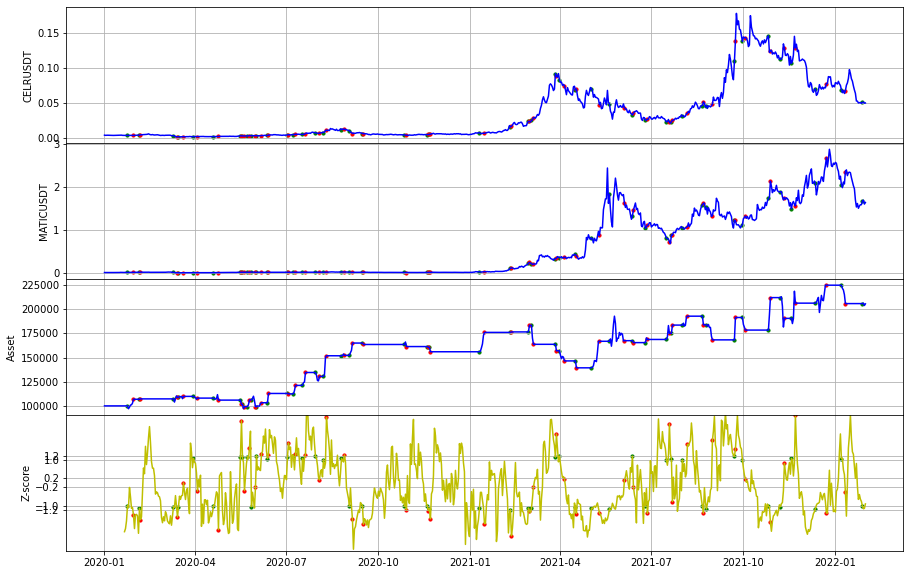

DASHUSDT_NEOUSDT 回測結果
-----------------------------DASHUSDT-NEOUSDT--------------------------
初始價格 100000
總損益:  5217.81088104
總交易次數:  53
平均損益:  98.44926190634042
勝率:  0.49056603773584906
獲利因子:  1.0637833573429294
賺賠比:  1.1046981018561188
最大資金回落:  25740.914483771703
夏普比率:  0.01528145950849105


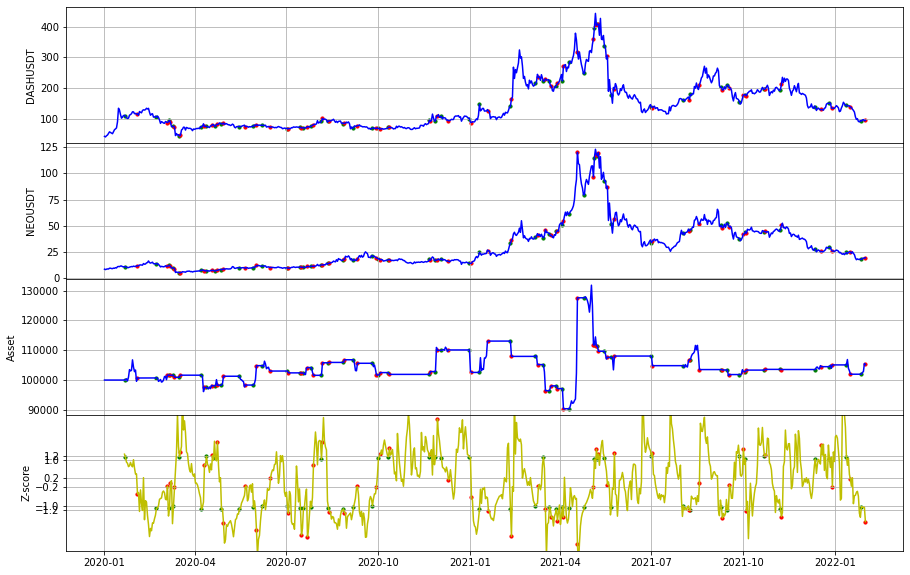

DASHUSDT_LTCUSDT 回測結果
-----------------------------DASHUSDT-LTCUSDT--------------------------
初始價格 100000
總損益:  -23185.95956827
總交易次數:  55
平均損益:  -421.56290124133176
勝率:  0.41818181818181815
獲利因子:  0.5955472479215504
賺賠比:  0.8285874753691136
最大資金回落:  25507.821216928613
夏普比率:  -0.1687628873663256


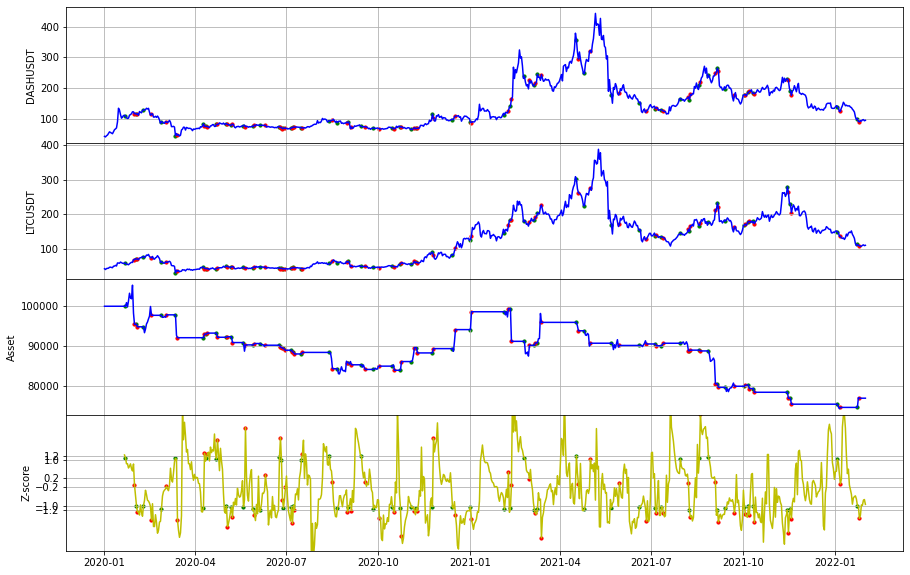

DASHUSDT_EOSUSDT 回測結果
-----------------------------DASHUSDT-EOSUSDT--------------------------
初始價格 100000
總損益:  -37436.18316558
總交易次數:  58
平均損益:  -645.4514338893117
勝率:  0.3620689655172414
獲利因子:  0.40537446783352443
賺賠比:  0.7142312052304953
最大資金回落:  40605.700101634306
夏普比率:  -0.2383987032914322


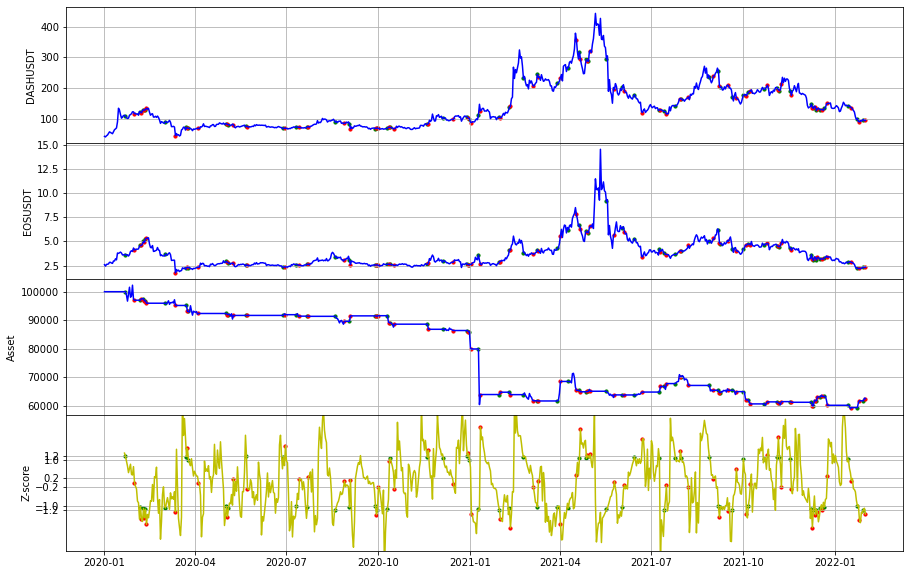

DASHUSDT_XLMUSDT 回測結果，場上有單已平倉
-----------------------------DASHUSDT-XLMUSDT--------------------------
初始價格 100000
總損益:  -23386.03423696
總交易次數:  55
平均損益:  -425.2006224902683
勝率:  0.4
獲利因子:  0.6506399865783546
賺賠比:  0.9759599798675319
最大資金回落:  28382.97778905474
夏普比率:  -0.1513615861711847


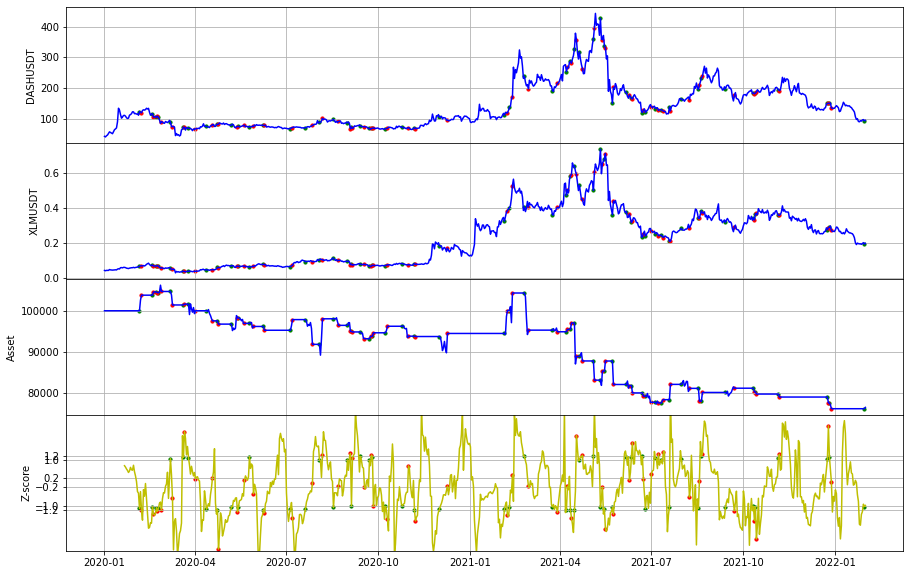

DASHUSDT_ICXUSDT 回測結果
-----------------------------DASHUSDT-ICXUSDT--------------------------
初始價格 100000
總損益:  -42144.00626650
總交易次數:  60
平均損益:  -702.4001044416364
勝率:  0.38333333333333336
獲利因子:  0.5815573383469211
賺賠比:  0.9355487616885254
最大資金回落:  57323.04046304246
夏普比率:  -0.1607859330053897


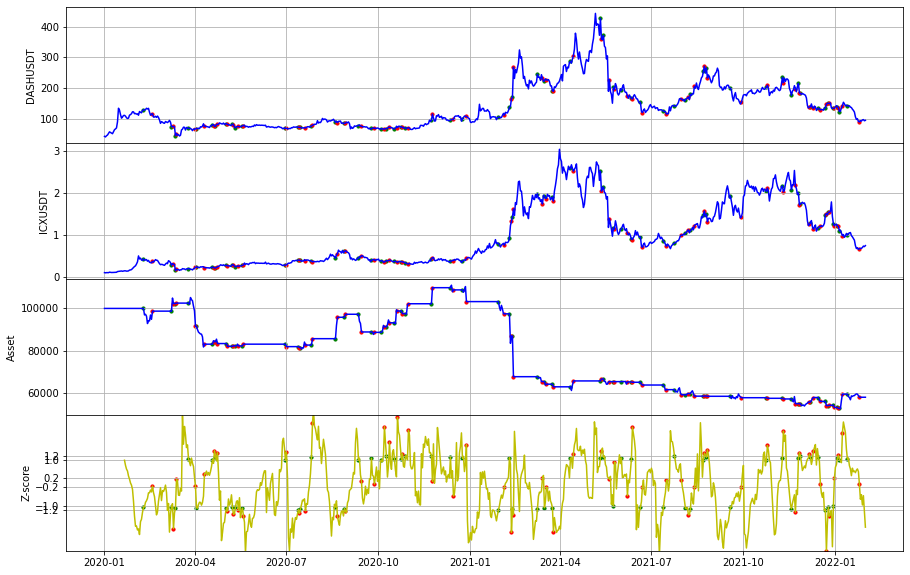

DASHUSDT_TFUELUSDT 回測結果
-----------------------------DASHUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  98827.62912434
總交易次數:  56
平均損益:  1764.7790915059854
勝率:  0.5714285714285714
獲利因子:  1.956260403948439
賺賠比:  1.4671953029613292
最大資金回落:  35850.99828853986
夏普比率:  0.238757862087683


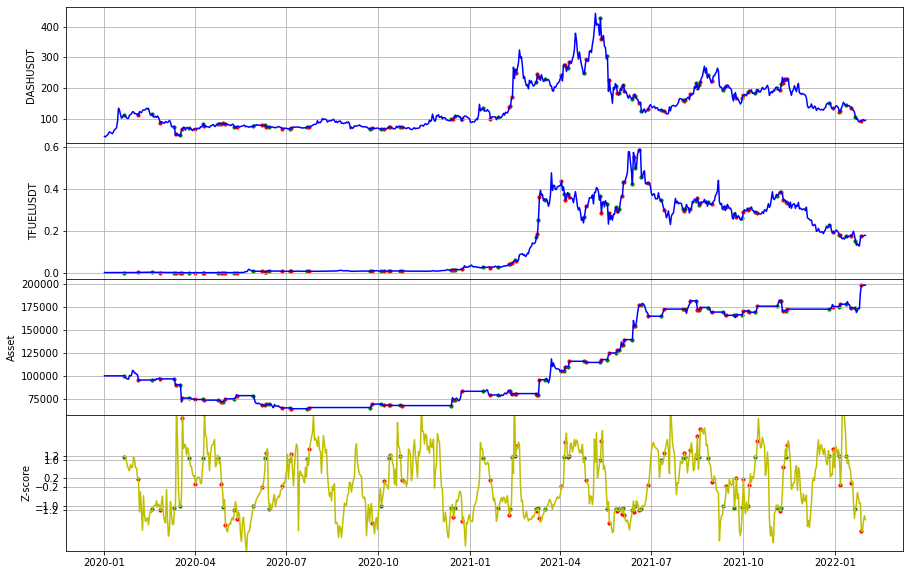

DASHUSDT_LINKUSDT 回測結果
-----------------------------DASHUSDT-LINKUSDT--------------------------
初始價格 100000
總損益:  -30773.88418428
總交易次數:  63
平均損益:  -488.47435213150436
勝率:  0.47619047619047616
獲利因子:  0.7227445870057093
賺賠比:  0.7950190457062801
最大資金回落:  51186.71037495838
夏普比率:  -0.1131852478275816


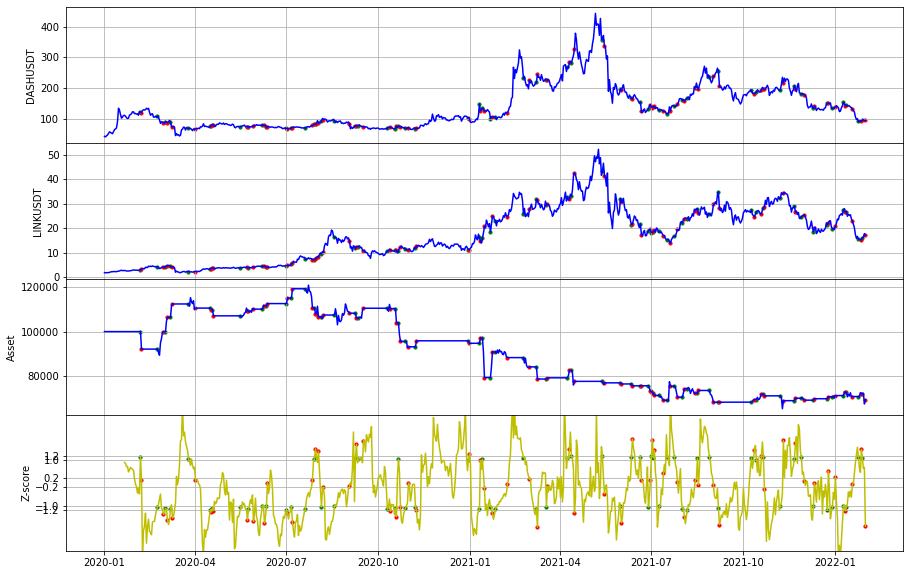

DASHUSDT_HOTUSDT 回測結果，場上有單已平倉
-----------------------------DASHUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  83076.39517989
總交易次數:  48
平均損益:  1730.7582329143927
勝率:  0.4375
獲利因子:  1.7660536620750782
賺賠比:  2.270640422667958
最大資金回落:  65951.33264178157
夏普比率:  0.09494787371890523


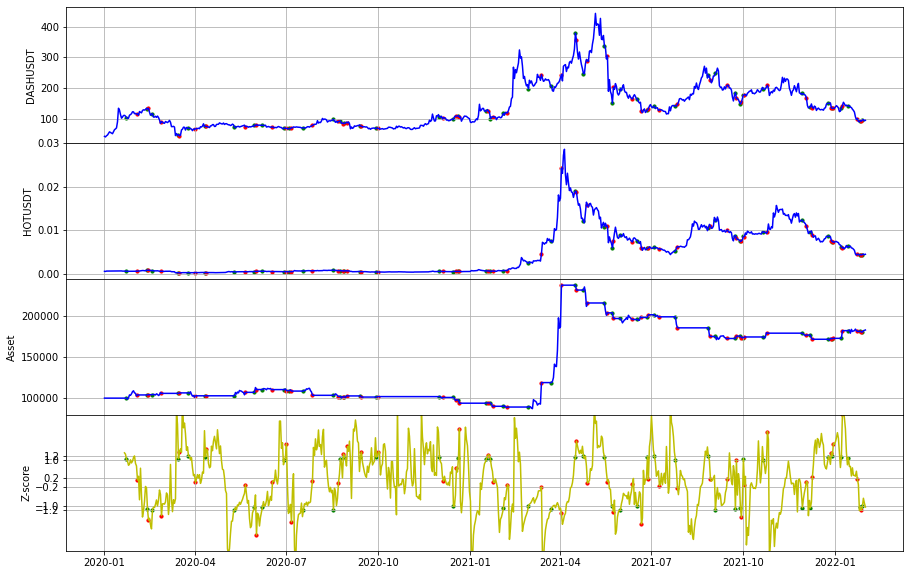

DASHUSDT_ZILUSDT 回測結果，場上有單已平倉
-----------------------------DASHUSDT-ZILUSDT--------------------------
初始價格 100000
總損益:  -24369.38553635
總交易次數:  53
平均損益:  -459.79972710100634
勝率:  0.49056603773584906
獲利因子:  0.8125097845284541
賺賠比:  0.8437601608564715
最大資金回落:  56851.868900308094
夏普比率:  -0.06415654523917429


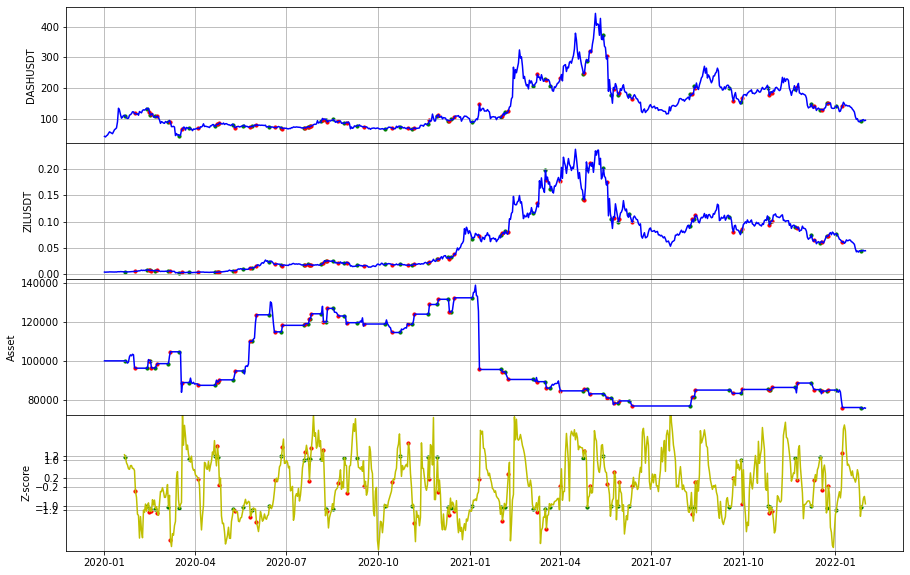

DASHUSDT_ZRXUSDT 回測結果
-----------------------------DASHUSDT-ZRXUSDT--------------------------
初始價格 100000
總損益:  24791.72610922
總交易次數:  50
平均損益:  495.83452218437685
勝率:  0.58
獲利因子:  1.241259169991459
賺賠比:  0.8988428472351945
最大資金回落:  35681.5957392611
夏普比率:  0.0677585882339846


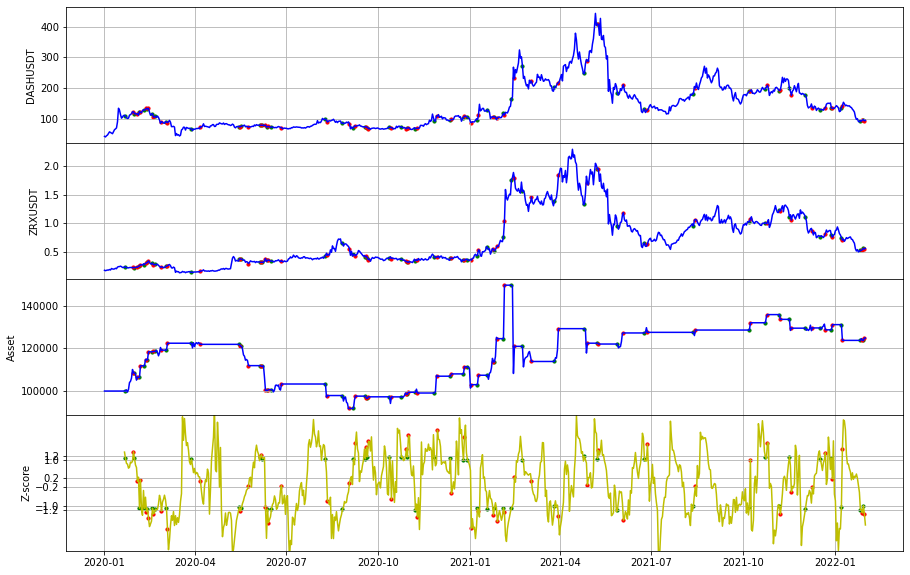

DASHUSDT_IOSTUSDT 回測結果
-----------------------------DASHUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  -4793.49361399
總交易次數:  55
平均損益:  -87.15442934528798
勝率:  0.4727272727272727
獲利因子:  0.9242122047162091
賺賠比:  1.0308520744911562
最大資金回落:  23587.704680022056
夏普比率:  -0.02585887924982871


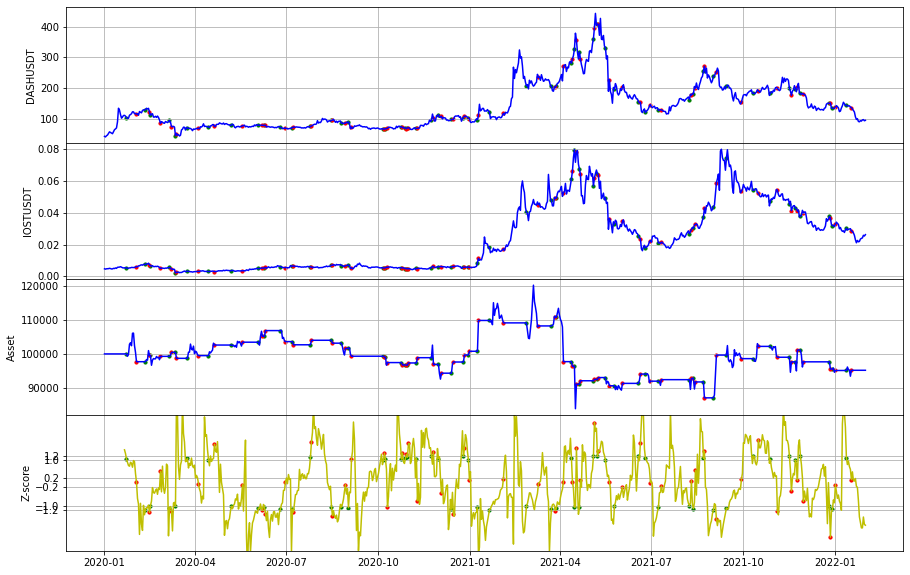

DASHUSDT_THETAUSDT 回測結果
-----------------------------DASHUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  -37986.15858037
總交易次數:  50
平均損益:  -759.723171607411
勝率:  0.4
獲利因子:  0.6473152623706064
賺賠比:  0.9709728935559095
最大資金回落:  52581.17526714695
夏普比率:  -0.13338975000071449


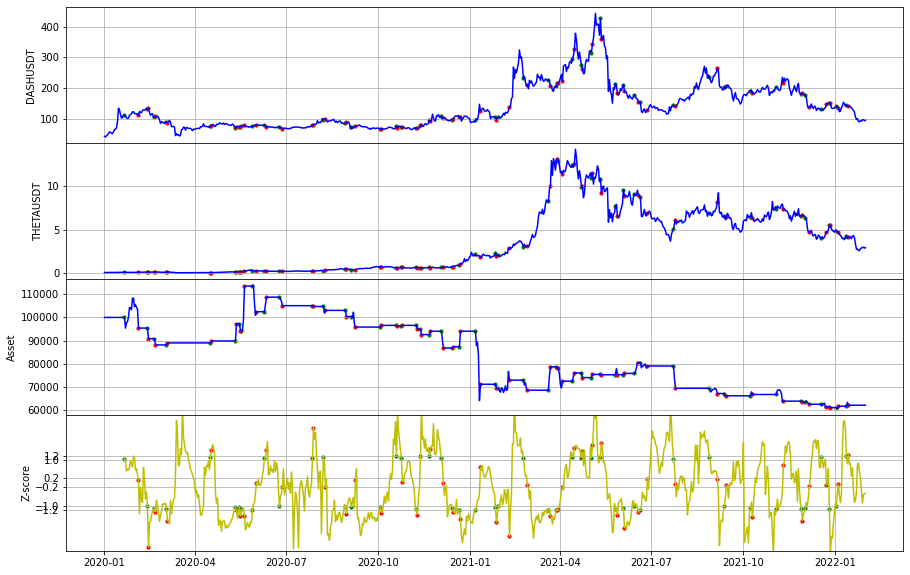

DASHUSDT_MITHUSDT 回測結果
-----------------------------DASHUSDT-MITHUSDT--------------------------
初始價格 100000
總損益:  174707.22527500
總交易次數:  53
平均損益:  3296.3627410376475
勝率:  0.5660377358490566
獲利因子:  2.022378844884202
賺賠比:  1.550490447744555
最大資金回落:  64690.314620300516
夏普比率:  0.1509498696891329


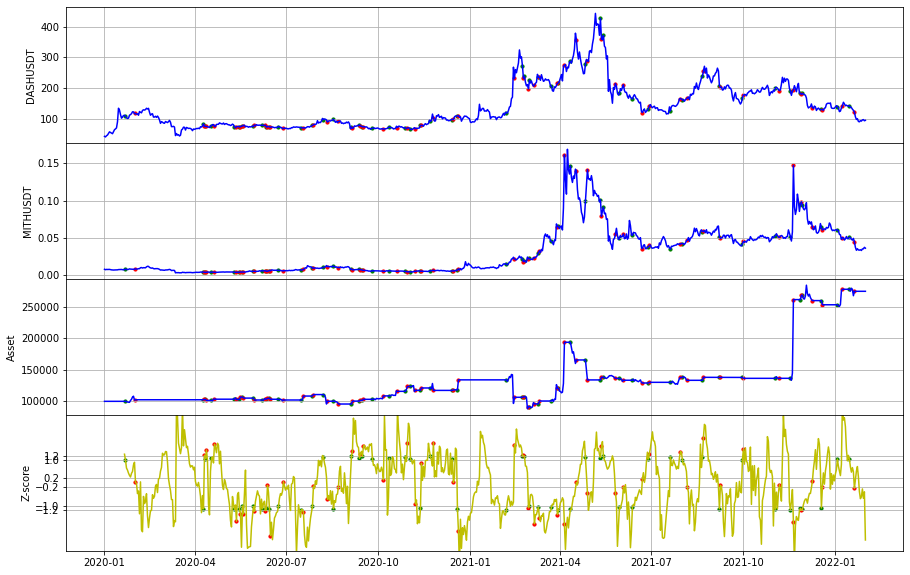

OMGUSDT_ADAUSDT 回測結果
-----------------------------OMGUSDT-ADAUSDT--------------------------
初始價格 100000
總損益:  -44992.59062647
總交易次數:  55
平均損益:  -818.0471022994218
勝率:  0.41818181818181815
獲利因子:  0.5632164107674926
賺賠比:  0.7836054410678159
最大資金回落:  47811.40732712307
夏普比率:  -0.18868100867050255


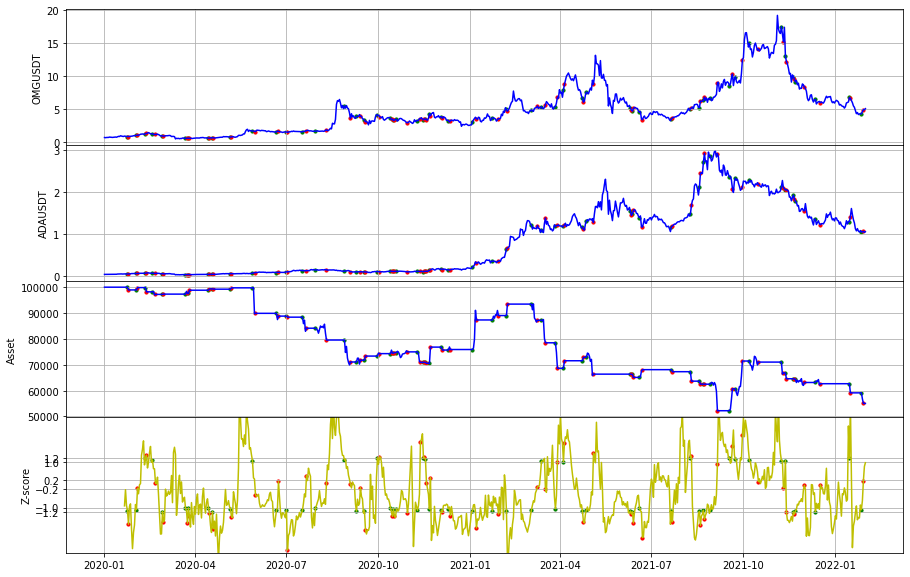

OMGUSDT_ONEUSDT 回測結果
-----------------------------OMGUSDT-ONEUSDT--------------------------
初始價格 100000
總損益:  8964.56613701
總交易次數:  49
平均損益:  182.95032932667408
勝率:  0.5918367346938775
獲利因子:  1.0592429945622255
賺賠比:  0.7305124100429141
最大資金回落:  82582.16099284054
夏普比率:  0.019099623695501795


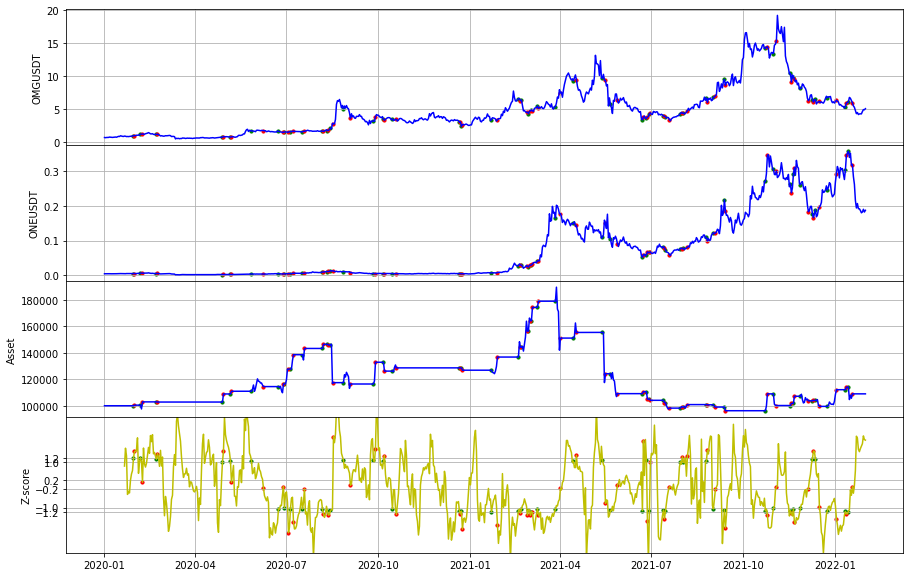

OMGUSDT_WAVESUSDT 回測結果
-----------------------------OMGUSDT-WAVESUSDT--------------------------
初始價格 100000
總損益:  -24208.93684263
總交易次數:  49
平均損益:  -494.0599355637785
勝率:  0.4897959183673469
獲利因子:  0.7670977768401332
賺賠比:  0.7990601842084721
最大資金回落:  45303.60231206342
夏普比率:  -0.07253292145648661


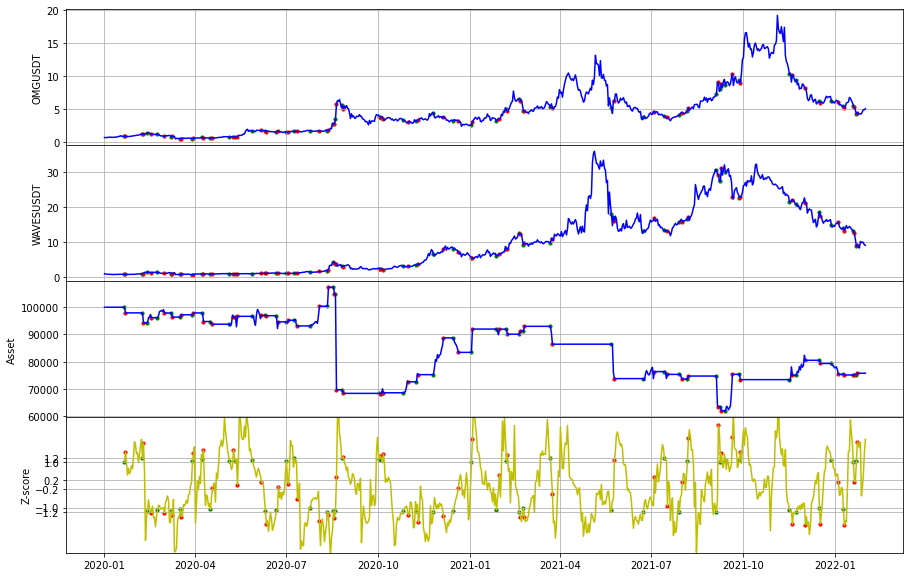

OMGUSDT_ONGUSDT 回測結果
-----------------------------OMGUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -75947.91324461
總交易次數:  52
平均損益:  -1460.5367931656624
勝率:  0.5
獲利因子:  0.6049649640845361
賺賠比:  0.6049649640845361
最大資金回落:  144014.7547556003
夏普比率:  -0.07278333437792106


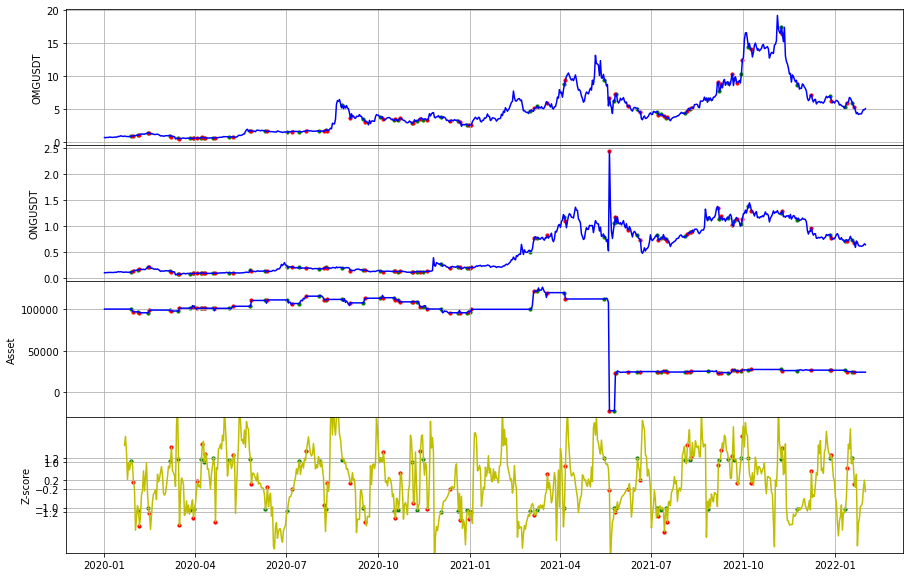

OMGUSDT_FETUSDT 回測結果
-----------------------------OMGUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  4069.28659405
總交易次數:  55
平均損益:  73.98702898274429
勝率:  0.4909090909090909
獲利因子:  1.033159406093002
賺賠比:  1.0714245692816318
最大資金回落:  59446.35781218807
夏普比率:  0.01244423756832855


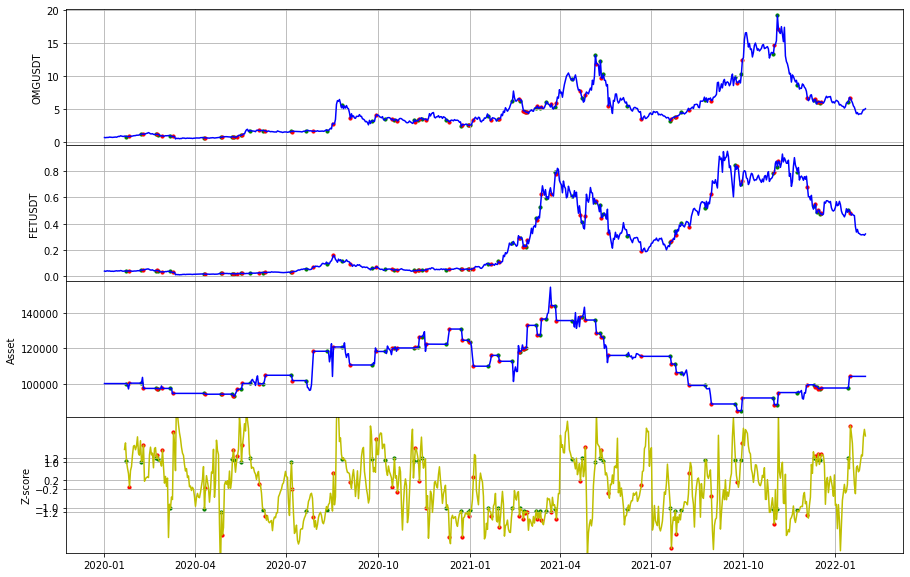

OMGUSDT_ATOMUSDT 回測結果
-----------------------------OMGUSDT-ATOMUSDT--------------------------
初始價格 100000
總損益:  -24899.79626208
總交易次數:  56
平均損益:  -444.6392189657269
勝率:  0.5357142857142857
獲利因子:  0.7649582265314041
賺賠比:  0.6629637963272168
最大資金回落:  59222.231709062944
夏普比率:  -0.09083129880560108


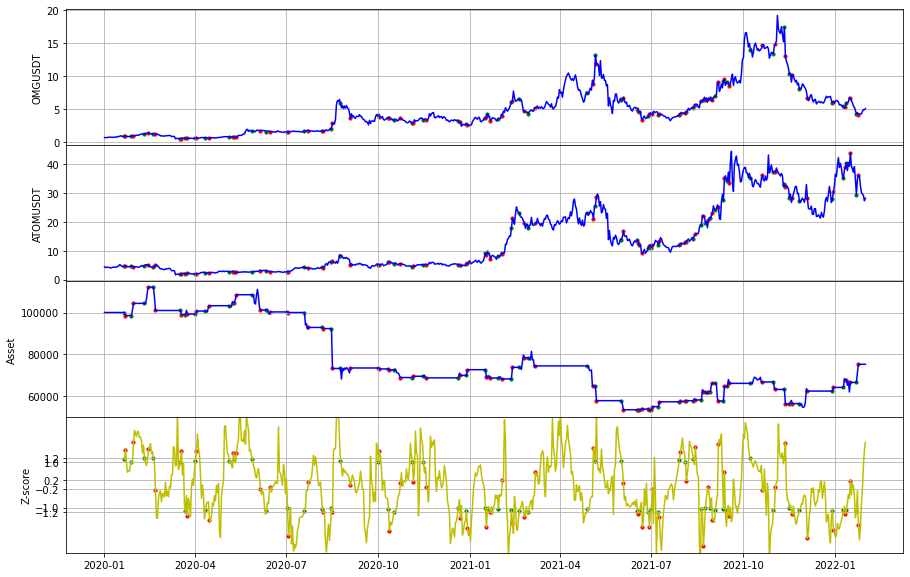

THETAUSDT_NEOUSDT 回測結果
-----------------------------THETAUSDT-NEOUSDT--------------------------
初始價格 100000
總損益:  -32327.84238902
總交易次數:  49
平均損益:  -659.7518854901647
勝率:  0.46938775510204084
獲利因子:  0.5640605706309914
賺賠比:  0.6376336885393815
最大資金回落:  44719.01517434983
夏普比率:  -0.19249330562399755


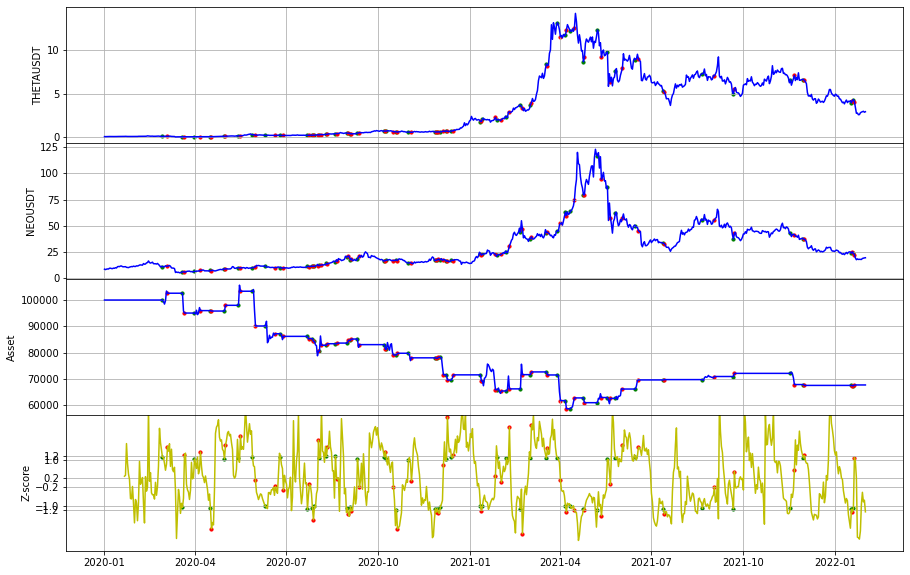

THETAUSDT_LTCUSDT 回測結果
-----------------------------THETAUSDT-LTCUSDT--------------------------
初始價格 100000
總損益:  -33646.83796132
總交易次數:  62
平均損益:  -542.6909348600016
勝率:  0.5
獲利因子:  0.6565069242449991
賺賠比:  0.6565069242449991
最大資金回落:  49768.378137031854
夏普比率:  -0.15524528499493784


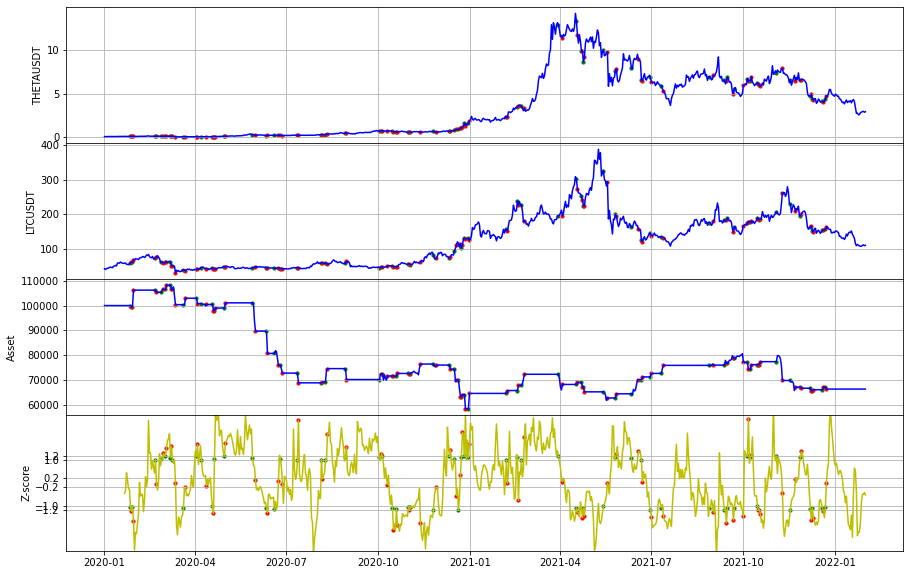

THETAUSDT_IOTAUSDT 回測結果
-----------------------------THETAUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  19719.77936857
總交易次數:  53
平均損益:  372.07130884087866
勝率:  0.5849056603773585
獲利因子:  1.2471140341759352
賺賠比:  0.8850486694151799
最大資金回落:  36075.315459286794
夏普比率:  0.08070983142253314


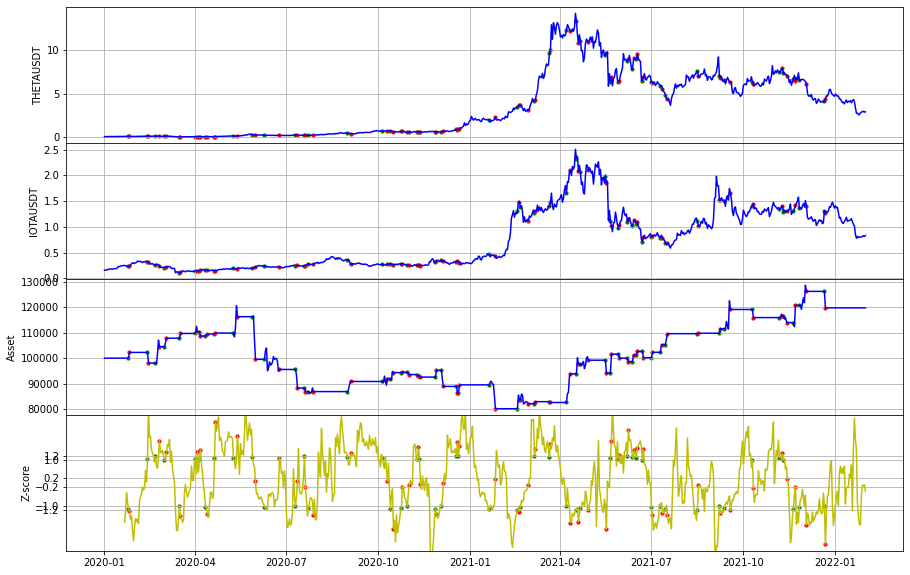

THETAUSDT_XLMUSDT 回測結果
-----------------------------THETAUSDT-XLMUSDT--------------------------
初始價格 100000
總損益:  -22113.99102106
總交易次數:  49
平均損益:  -451.3059392053508
勝率:  0.5102040816326531
獲利因子:  0.7307517414642228
賺賠比:  0.701521671805654
最大資金回落:  34973.97358167205
夏普比率:  -0.11812769771977286


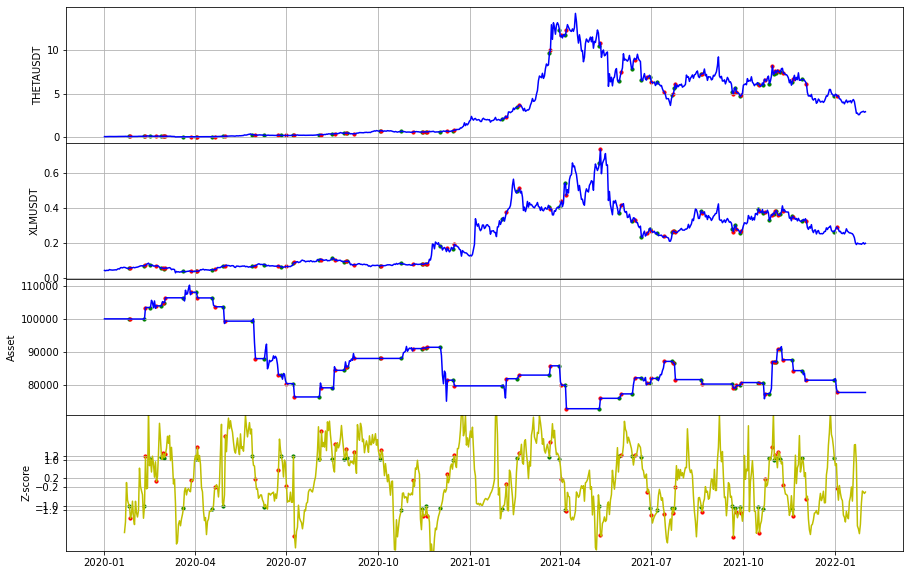

THETAUSDT_TRXUSDT 回測結果，場上有單已平倉
-----------------------------THETAUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  -34902.43615750
總交易次數:  53
平均損益:  -658.536531273642
勝率:  0.3584905660377358
獲利因子:  0.6090338381107174
賺賠比:  1.0898500260928627
最大資金回落:  49243.724873025
夏普比率:  -0.17127129798246754


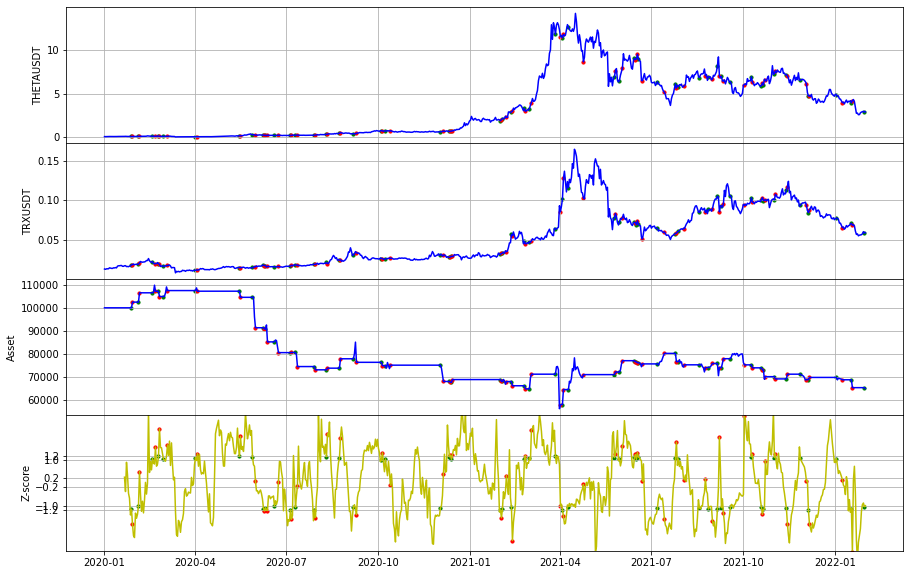

THETAUSDT_ETCUSDT 回測結果，場上有單已平倉
-----------------------------THETAUSDT-ETCUSDT--------------------------
初始價格 100000
總損益:  21580.81295329
總交易次數:  61
平均損益:  353.78381890644937
勝率:  0.4262295081967213
獲利因子:  1.1814836733318868
賺賠比:  1.5904587910236938
最大資金回落:  54525.70457647985
夏普比率:  0.049790330577466076


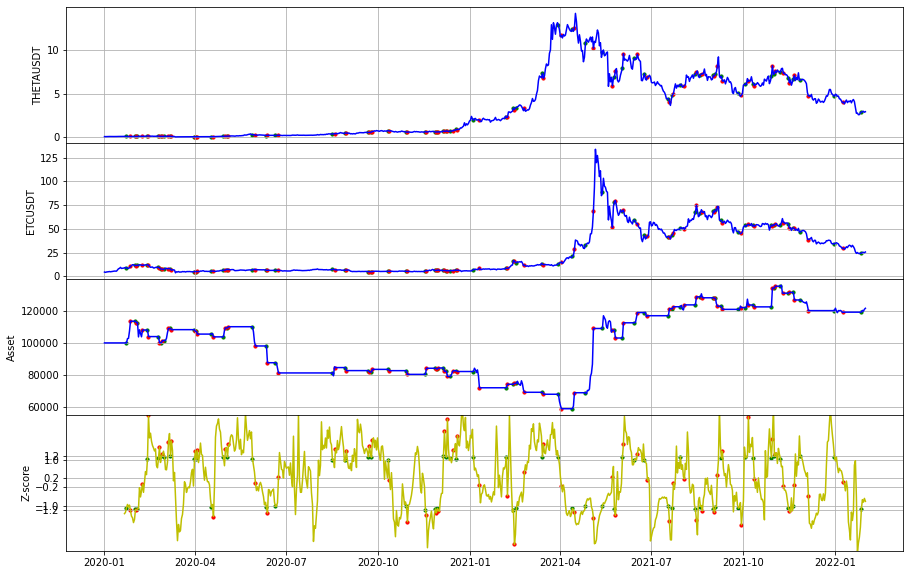

THETAUSDT_VETUSDT 回測結果
-----------------------------THETAUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -3620.95180016
總交易次數:  58
平均損益:  -62.43020345100376
勝率:  0.5
獲利因子:  0.9688197768192198
賺賠比:  0.9688197768192198
最大資金回落:  45944.932252575905
夏普比率:  -0.010000238366459161


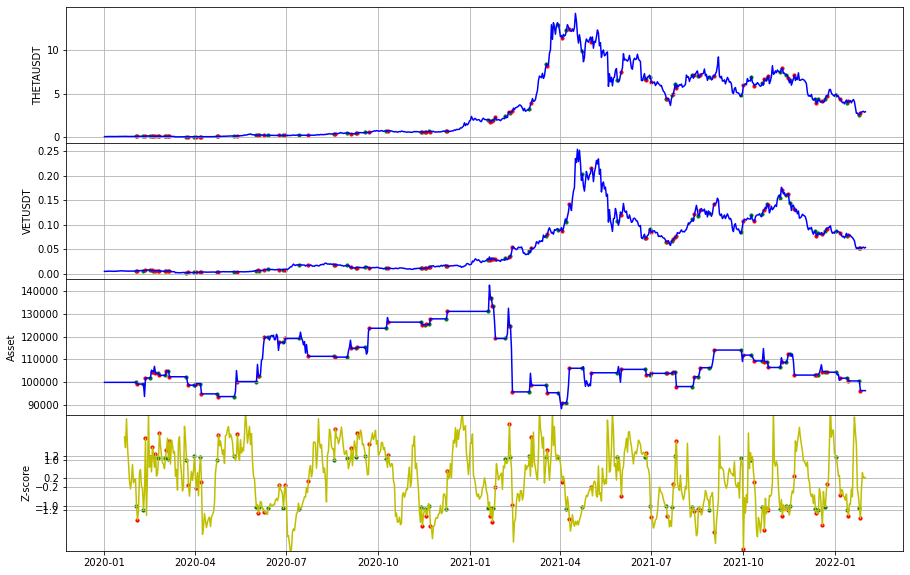

THETAUSDT_WAVESUSDT 回測結果
-----------------------------THETAUSDT-WAVESUSDT--------------------------
初始價格 100000
總損益:  -39298.60294799
總交易次數:  51
平均損益:  -770.5608421174339
勝率:  0.45098039215686275
獲利因子:  0.5716938608420936
賺賠比:  0.695975134938201
最大資金回落:  58059.796198769516
夏普比率:  -0.15499938273143699


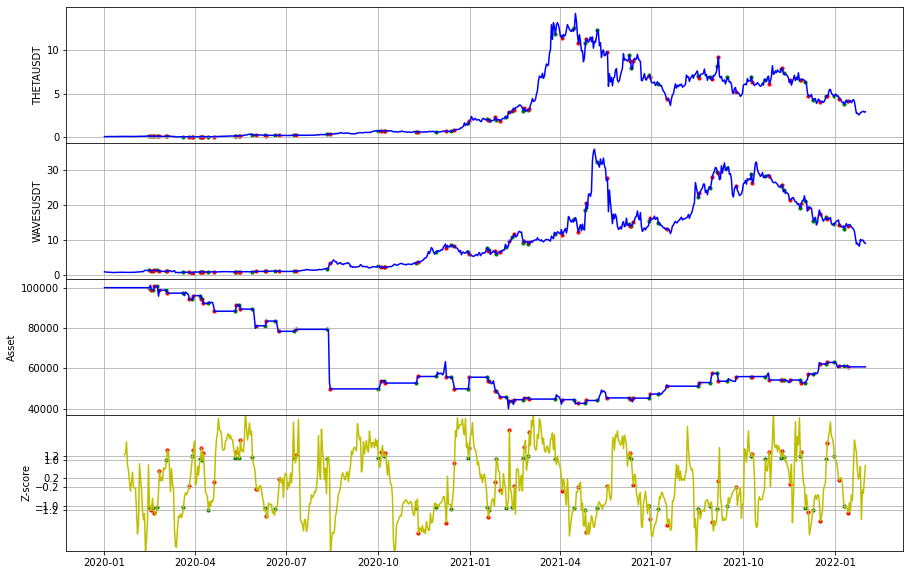

THETAUSDT_XMRUSDT 回測結果
-----------------------------THETAUSDT-XMRUSDT--------------------------
初始價格 100000
總損益:  -12901.94021705
總交易次數:  51
平均損益:  -252.97921994224924
勝率:  0.45098039215686275
獲利因子:  0.8759729751668959
賺賠比:  1.0664018828118733
最大資金回落:  47325.11309046962
夏普比率:  -0.048145199281088215


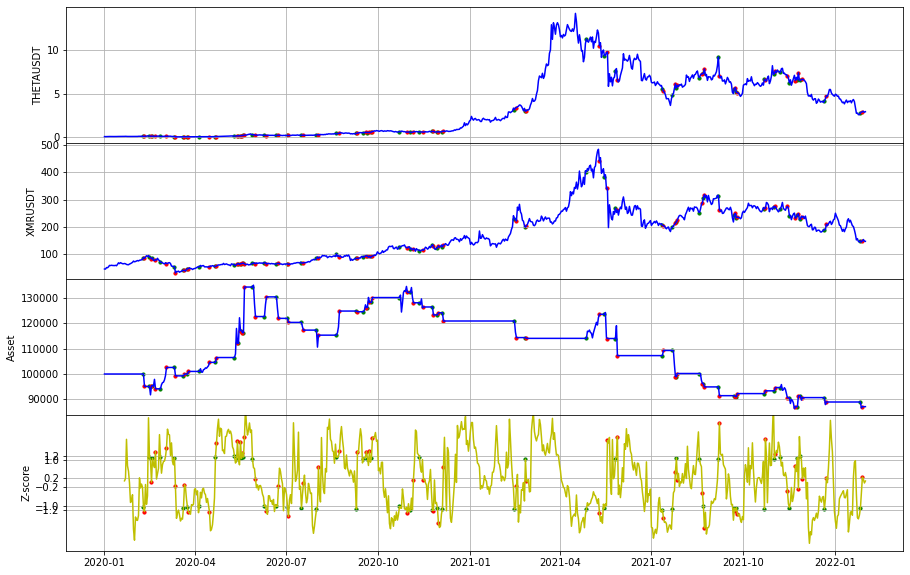

THETAUSDT_ZECUSDT 回測結果，場上有單已平倉
-----------------------------THETAUSDT-ZECUSDT--------------------------
初始價格 100000
總損益:  -7666.66469847
總交易次數:  60
平均損益:  -127.77774497448748
勝率:  0.5166666666666667
獲利因子:  0.9596880380206677
賺賠比:  0.8977726807290117
最大資金回落:  82792.58327960249
夏普比率:  -0.01422164511037908


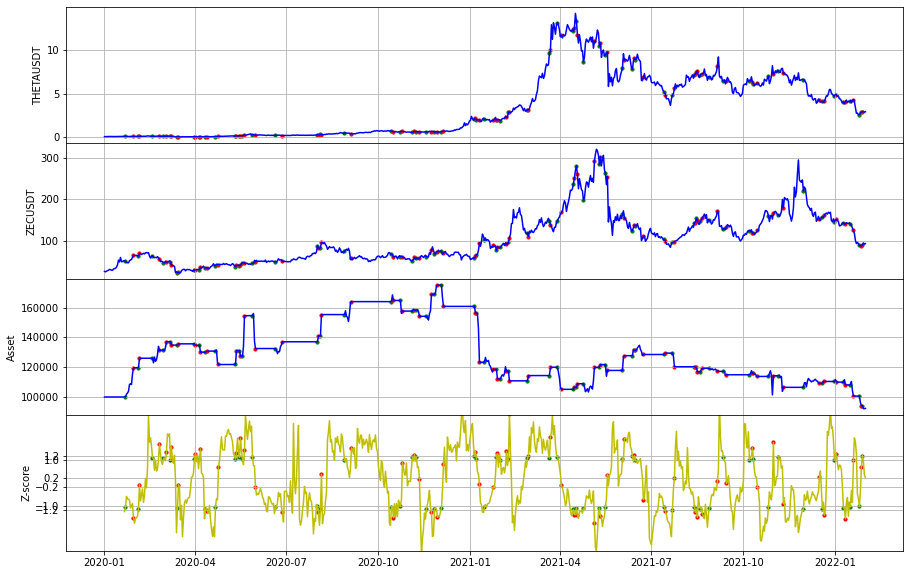

THETAUSDT_IOSTUSDT 回測結果
-----------------------------THETAUSDT-IOSTUSDT--------------------------
初始價格 100000
總損益:  34356.45530381
總交易次數:  60
平均損益:  572.6075883968816
勝率:  0.5
獲利因子:  1.2687420143565098
賺賠比:  1.2687420143565098
最大資金回落:  76538.96685262641
夏普比率:  0.06718188741973052


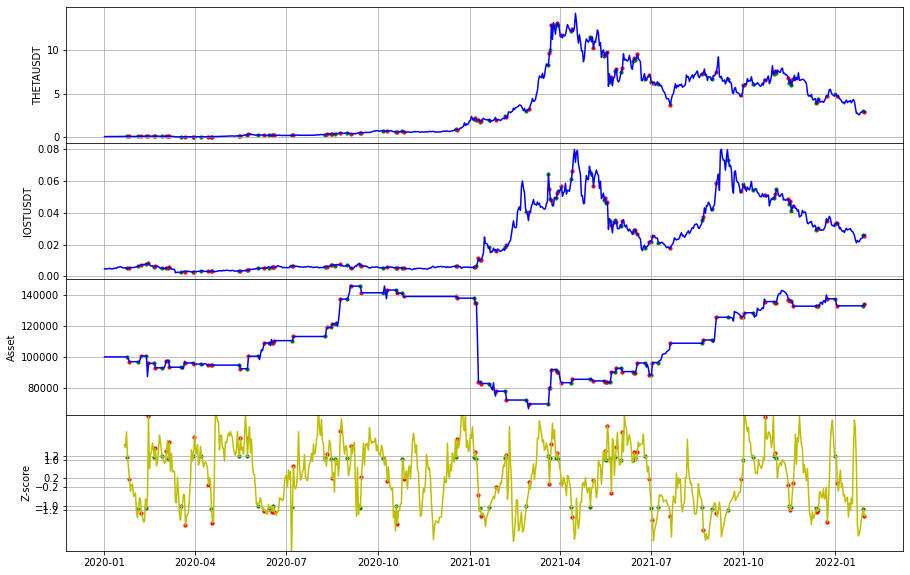

THETAUSDT_DASHUSDT 回測結果
-----------------------------THETAUSDT-DASHUSDT--------------------------
初始價格 100000
總損益:  -54712.06975689
總交易次數:  52
平均損益:  -1052.1551876325555
勝率:  0.40384615384615385
獲利因子:  0.4830410666583522
賺賠比:  0.7130606222099485
最大資金回落:  59816.50396365045
夏普比率:  -0.24593366868992017


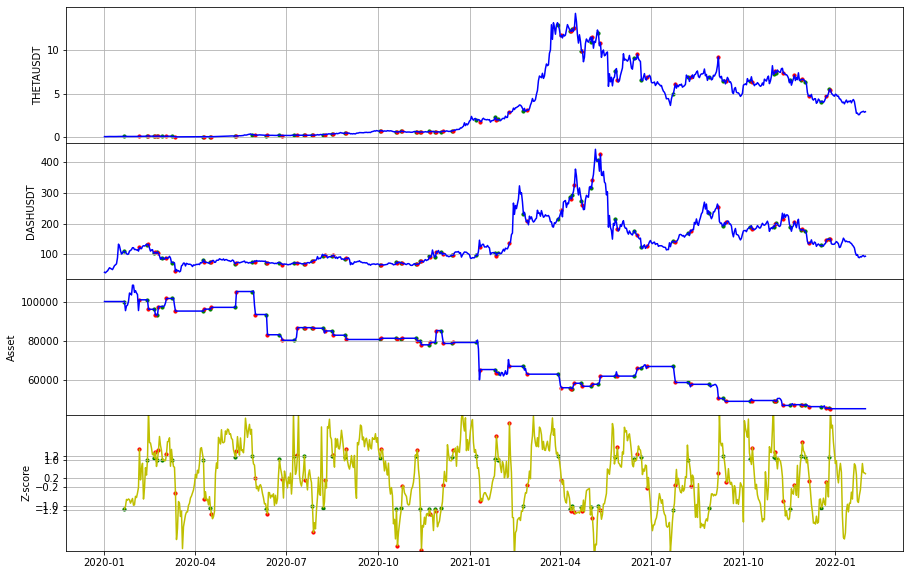

THETAUSDT_MITHUSDT 回測結果
-----------------------------THETAUSDT-MITHUSDT--------------------------
初始價格 100000
總損益:  -5796.41480139
總交易次數:  60
平均損益:  -96.60691335657272
勝率:  0.45
獲利因子:  0.9654946375894132
賺賠比:  1.1800490014981717
最大資金回落:  94207.43836275171
夏普比率:  -0.010808456216415952


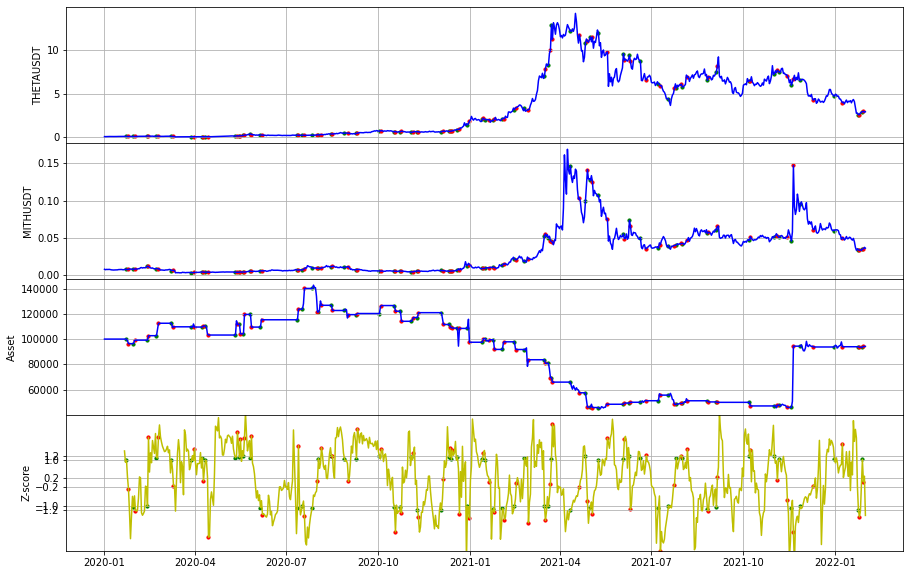

ENJUSDT_BNBUSDT 回測結果
-----------------------------ENJUSDT-BNBUSDT--------------------------
初始價格 100000
總損益:  -13246.63352575
總交易次數:  55
平均損益:  -240.84788228642586
勝率:  0.4909090909090909
獲利因子:  0.8960032602782233
賺賠比:  0.9291885662144538
最大資金回落:  47600.39596010317
夏普比率:  -0.03839750679441262


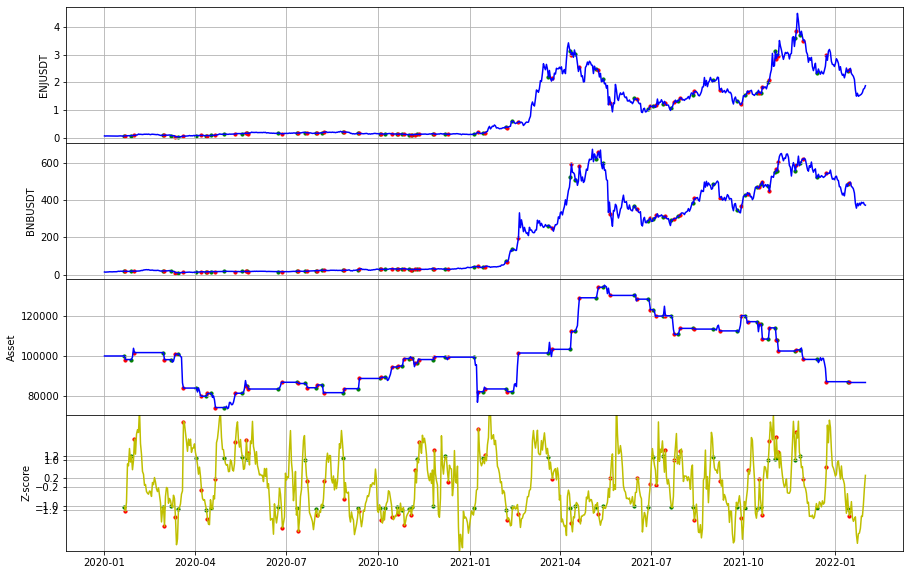

ENJUSDT_TRXUSDT 回測結果，場上有單已平倉
-----------------------------ENJUSDT-TRXUSDT--------------------------
初始價格 100000
總損益:  -64024.51562971
總交易次數:  55
平均損益:  -1164.0821023583785
勝率:  0.41818181818181815
獲利因子:  0.28751035709870393
賺賠比:  0.4000144098764576
最大資金回落:  64024.51562971082
夏普比率:  -0.3656902545140823


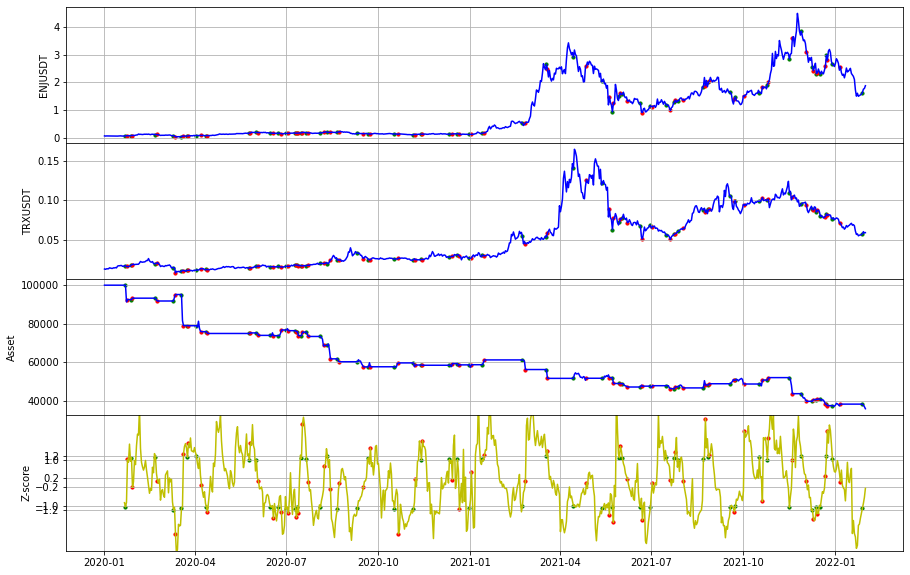

ENJUSDT_BATUSDT 回測結果
-----------------------------ENJUSDT-BATUSDT--------------------------
初始價格 100000
總損益:  -42940.00116267
總交易次數:  51
平均損益:  -841.9608071112395
勝率:  0.3333333333333333
獲利因子:  0.3866701989967277
賺賠比:  0.7733403979934554
最大資金回落:  47974.87944961501
夏普比率:  -0.24008872858727268


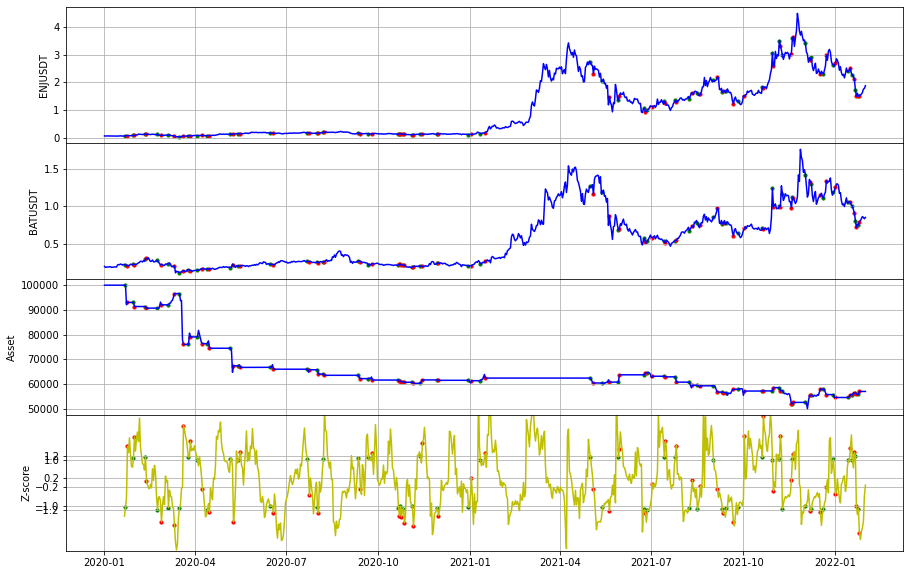

ENJUSDT_ATOMUSDT 回測結果
-----------------------------ENJUSDT-ATOMUSDT--------------------------
初始價格 100000
總損益:  -6432.10858026
總交易次數:  53
平均損益:  -121.36053925023286
勝率:  0.4716981132075472
獲利因子:  0.9399682250400462
賺賠比:  1.0527644120448516
最大資金回落:  41302.342246117114
夏普比率:  -0.02089442867899248


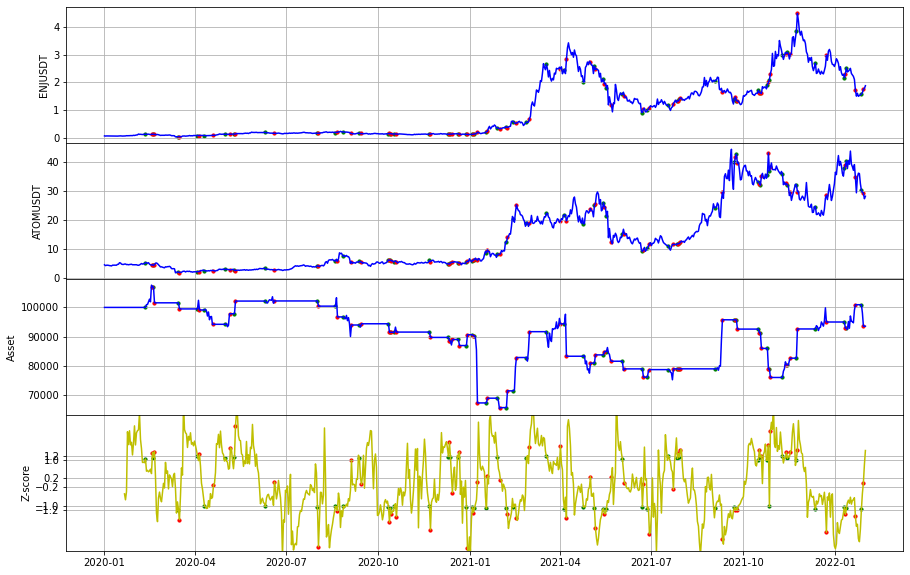

MITHUSDT_NEOUSDT 回測結果
-----------------------------MITHUSDT-NEOUSDT--------------------------
初始價格 100000
總損益:  -39891.98562049
總交易次數:  65
平均損益:  -613.7228556998427
勝率:  0.4153846153846154
獲利因子:  0.7106121170877122
賺賠比:  1.0001207573827062
最大資金回落:  56317.08649865004
夏普比率:  -0.12109626357738815


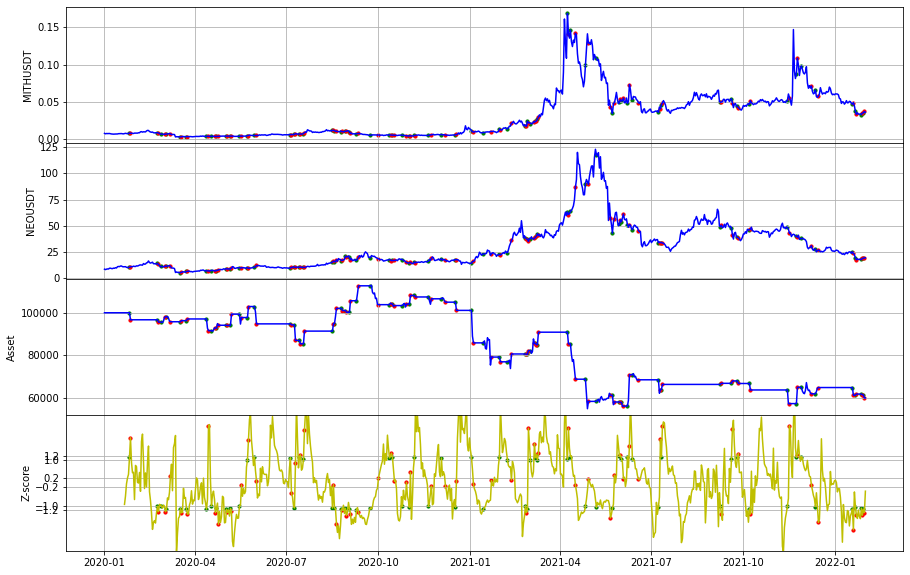

MITHUSDT_LTCUSDT 回測結果
-----------------------------MITHUSDT-LTCUSDT--------------------------
初始價格 100000
總損益:  -50403.67768030
總交易次數:  51
平均損益:  -988.3074054960072
勝率:  0.39215686274509803
獲利因子:  0.6033803573575267
賺賠比:  0.9352395539041666
最大資金回落:  59055.63689128298
夏普比率:  -0.13864516364203647


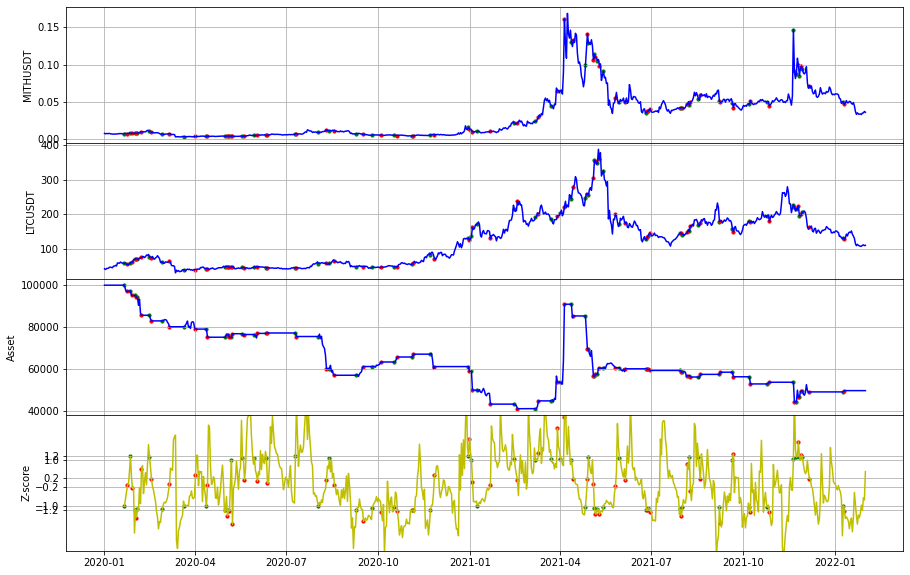

MITHUSDT_QTUMUSDT 回測結果
-----------------------------MITHUSDT-QTUMUSDT--------------------------
初始價格 100000
總損益:  -85033.52534871
總交易次數:  53
平均損益:  -1604.4061386548715
勝率:  0.3018867924528302
獲利因子:  0.2115170737791174
賺賠比:  0.489133233114209
最大資金回落:  91682.80441053347
夏普比率:  -0.40438609328444425


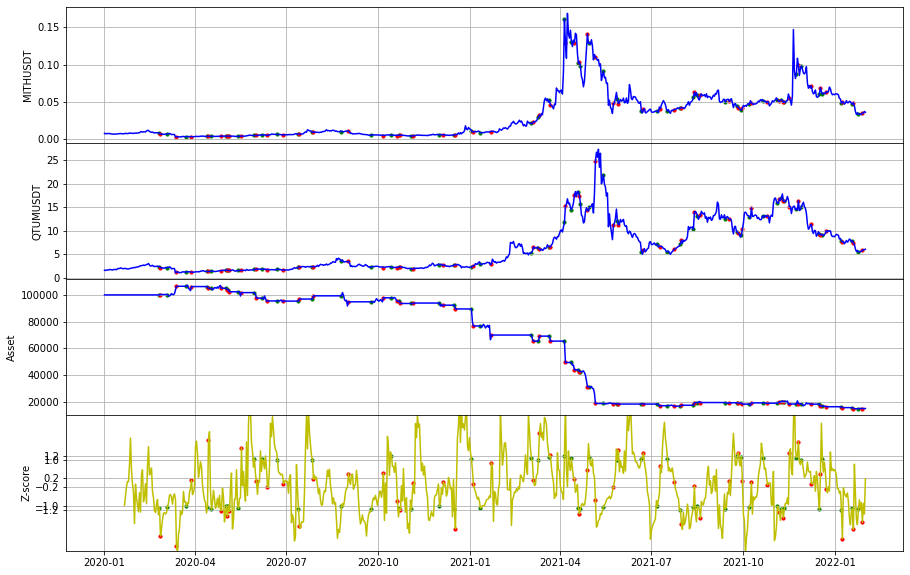

MITHUSDT_IOTAUSDT 回測結果
-----------------------------MITHUSDT-IOTAUSDT--------------------------
初始價格 100000
總損益:  -87860.20726546
總交易次數:  54
平均損益:  -1627.0408752863366
勝率:  0.5
獲利因子:  0.6780007477406048
賺賠比:  0.6780007477406048
最大資金回落:  188871.02514108337
夏普比率:  -0.07123338698345173


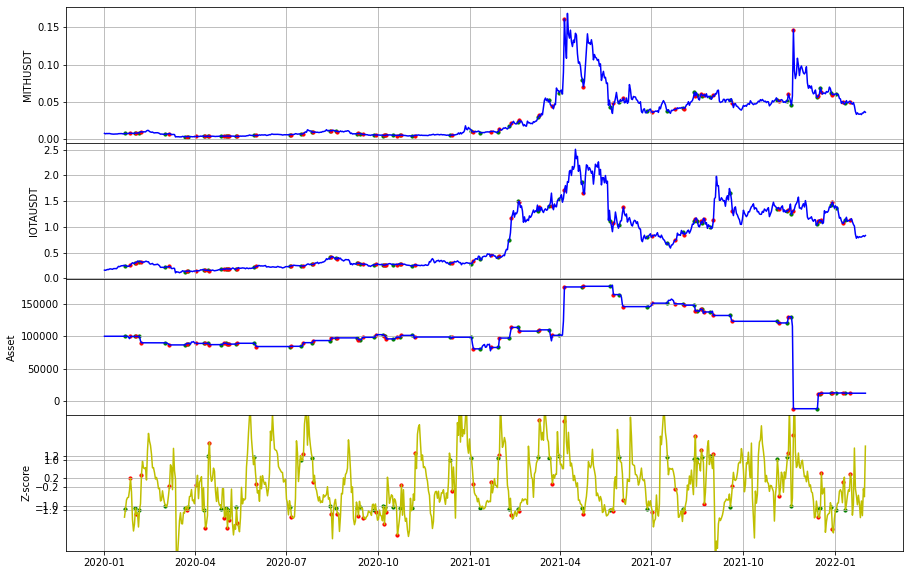

MITHUSDT_ICXUSDT 回測結果，場上有單已平倉
-----------------------------MITHUSDT-ICXUSDT--------------------------
初始價格 100000
總損益:  -80719.07470835
總交易次數:  49
平均損益:  -1647.328055272464
勝率:  0.40816326530612246
獲利因子:  0.4711570521322684
賺賠比:  0.6596198729851758
最大資金回落:  81182.17271438193
夏普比率:  -0.14868612397362657


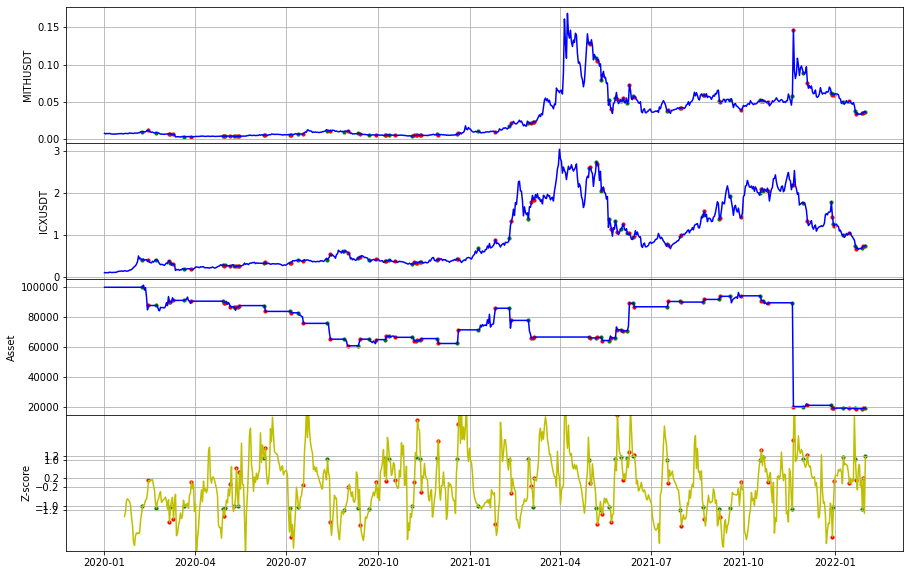

MITHUSDT_VETUSDT 回測結果
-----------------------------MITHUSDT-VETUSDT--------------------------
初始價格 100000
總損益:  -65901.31731652
總交易次數:  62
平均損益:  -1062.9244728471751
勝率:  0.4838709677419355
獲利因子:  0.46937163229223505
賺賠比:  0.5006630744450506
最大資金回落:  82491.58970314564
夏普比率:  -0.1798513612124552


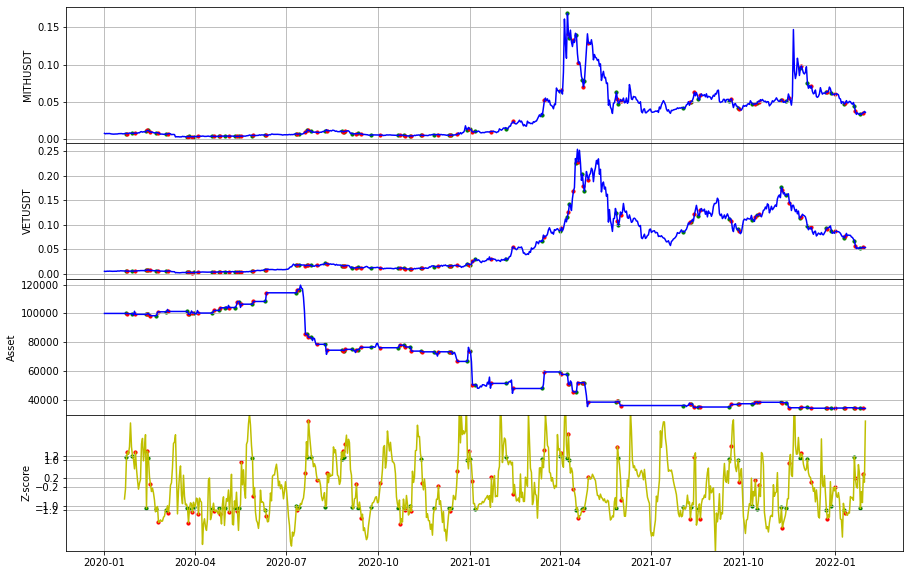

MITHUSDT_TFUELUSDT 回測結果
-----------------------------MITHUSDT-TFUELUSDT--------------------------
初始價格 100000
總損益:  114300.67731914
總交易次數:  52
平均損益:  2198.0899484450774
勝率:  0.5192307692307693
獲利因子:  1.727954368449629
賺賠比:  1.5999577485644714
最大資金回落:  40583.395420084766
夏普比率:  0.15138704659495858


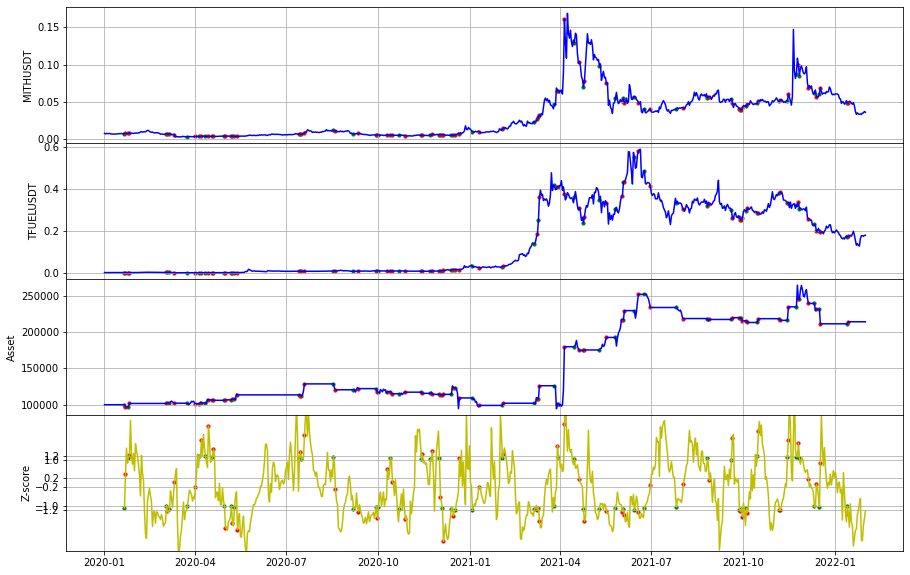

MITHUSDT_ONGUSDT 回測結果，場上有單已平倉
-----------------------------MITHUSDT-ONGUSDT--------------------------
初始價格 100000
總損益:  -79614.59933740
總交易次數:  56
平均損益:  -1421.6892738821039
勝率:  0.42857142857142855
獲利因子:  0.3312063797538186
賺賠比:  0.44160850633842486
最大資金回落:  95087.14773323892
夏普比率:  -0.1495459013379609


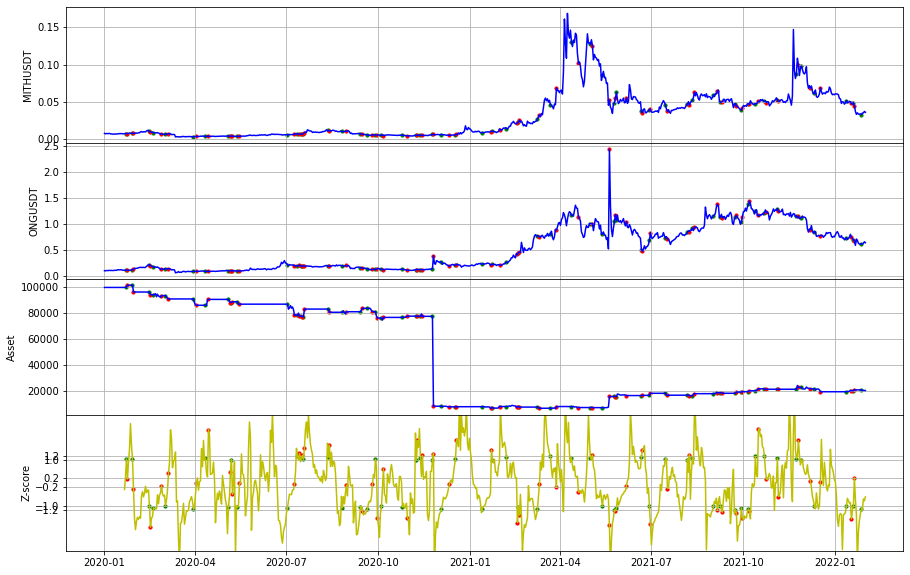

MITHUSDT_HOTUSDT 回測結果
-----------------------------MITHUSDT-HOTUSDT--------------------------
初始價格 100000
總損益:  -10461.05145571
總交易次數:  56
平均損益:  -186.80449028052863
勝率:  0.44642857142857145
獲利因子:  0.8974519192405082
賺賠比:  1.11284037985823
最大資金回落:  23778.0693782148
夏普比率:  -0.034107496600281395


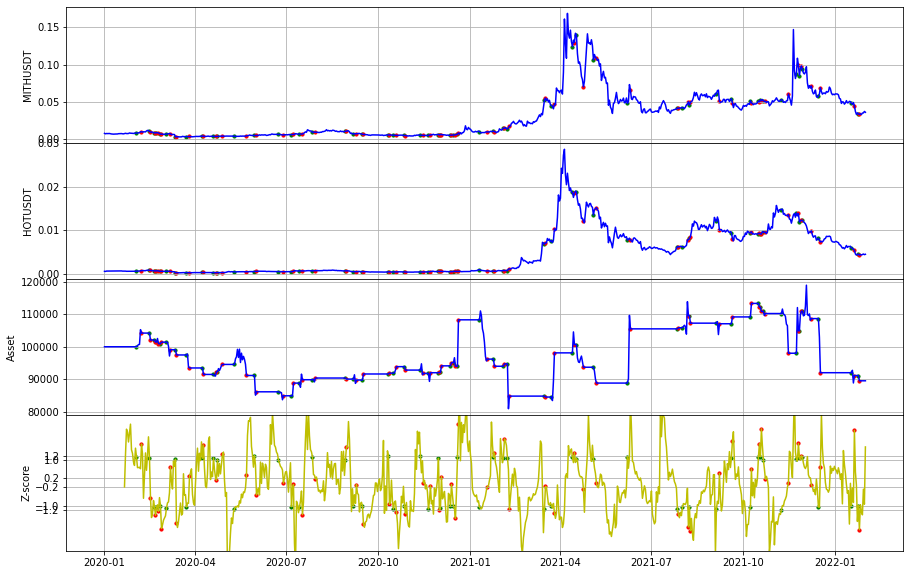

MITHUSDT_BATUSDT 回測結果
-----------------------------MITHUSDT-BATUSDT--------------------------
初始價格 100000
總損益:  -36720.11739687
總交易次數:  53
平均損益:  -692.8324037145892
勝率:  0.5094339622641509
獲利因子:  0.5986313825730238
賺賠比:  0.576459849885134
最大資金回落:  48175.7883443794
夏普比率:  -0.18048790764668965


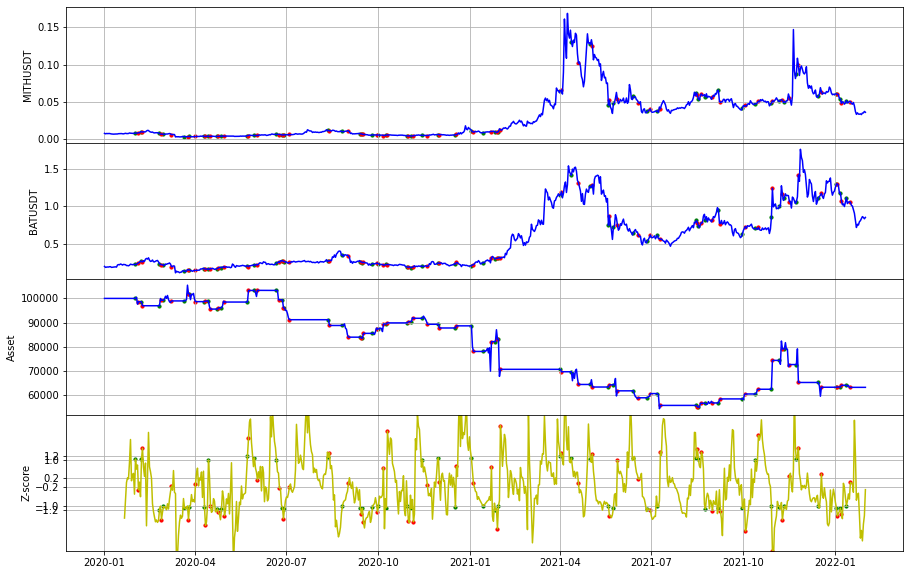

MITHUSDT_ZECUSDT 回測結果
-----------------------------MITHUSDT-ZECUSDT--------------------------
初始價格 100000
總損益:  -41761.81393482
總交易次數:  46
平均損益:  -907.8655203221318
勝率:  0.5
獲利因子:  0.5495105628731959
賺賠比:  0.5495105628731959
最大資金回落:  53696.40413530966
夏普比率:  -0.2022637389319184


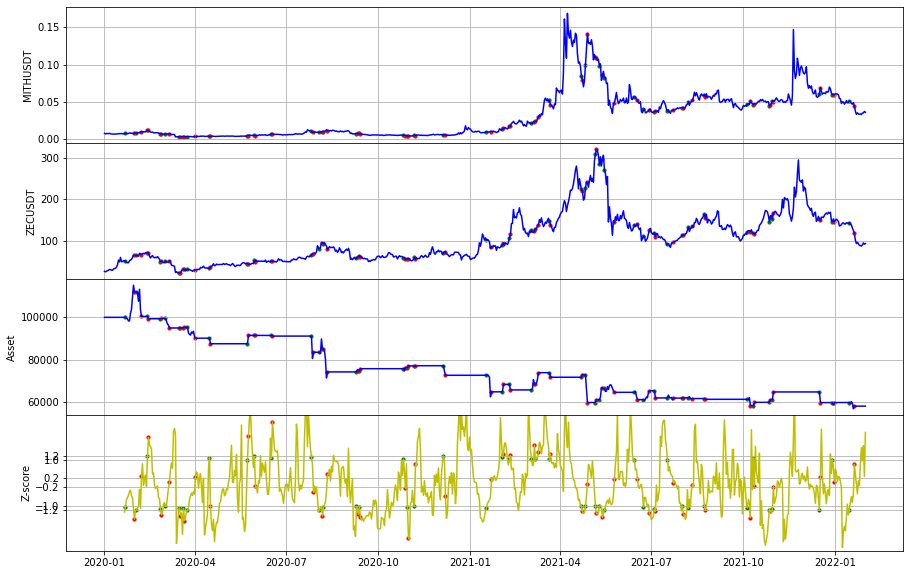

MITHUSDT_DASHUSDT 回測結果
-----------------------------MITHUSDT-DASHUSDT--------------------------
初始價格 100000
總損益:  2732.48607680
總交易次數:  48
平均損益:  56.92679326669471
勝率:  0.4583333333333333
獲利因子:  1.0179327714575834
賺賠比:  1.2030114571771442
最大資金回落:  50517.16399880381
夏普比率:  0.004781232889526782


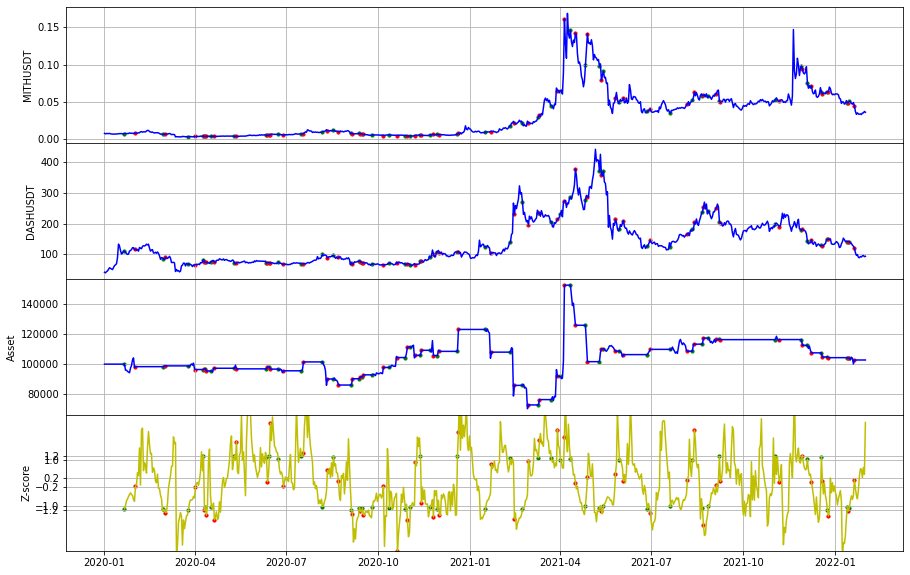

MITHUSDT_THETAUSDT 回測結果
-----------------------------MITHUSDT-THETAUSDT--------------------------
初始價格 100000
總損益:  78315.63597030
總交易次數:  58
平均損益:  1350.2695856948421
勝率:  0.5517241379310345
獲利因子:  1.3784272123256458
賺賠比:  1.1199721100145872
最大資金回落:  108132.1460336104
夏普比率:  0.09124754544289371


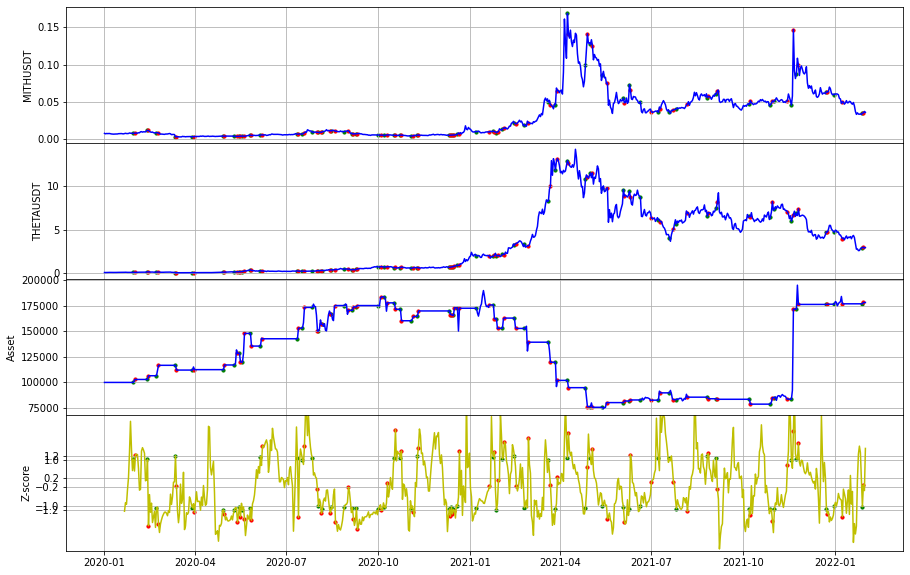

MATICUSDT_BNBUSDT 回測結果
-----------------------------MATICUSDT-BNBUSDT--------------------------
初始價格 100000
總損益:  35155.82989771
總交易次數:  52
平均損益:  676.0736518790923
勝率:  0.4230769230769231
獲利因子:  1.2086596820478388
賺賠比:  1.6481722937015981
最大資金回落:  37123.072659680474
夏普比率:  0.05874210306271128


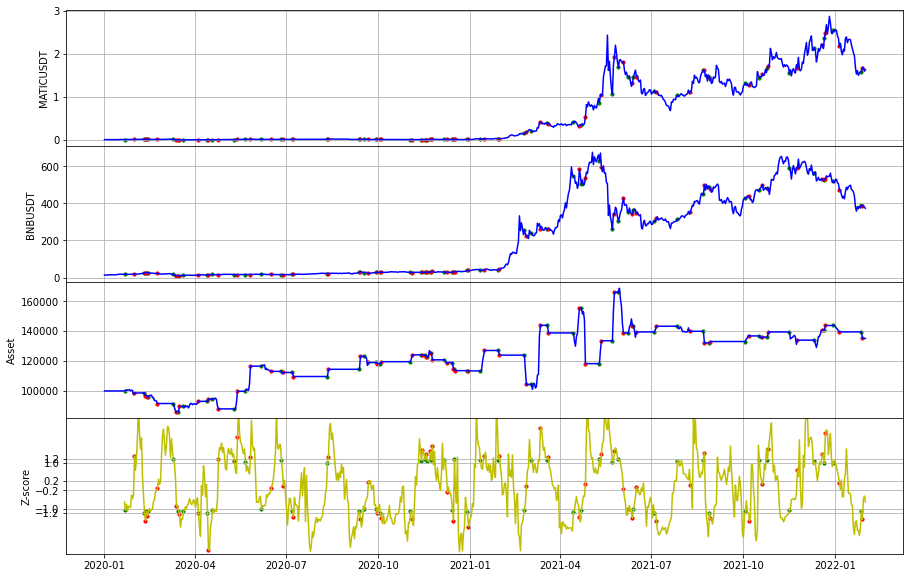

MATICUSDT_ONEUSDT 回測結果
-----------------------------MATICUSDT-ONEUSDT--------------------------
初始價格 100000
總損益:  -10101.64000086
總交易次數:  57
平均損益:  -177.22175440111496
勝率:  0.45614035087719296
獲利因子:  0.9124832933703694
賺賠比:  1.0879608497877482
最大資金回落:  31940.95531835858
夏普比率:  -0.03280607007857169


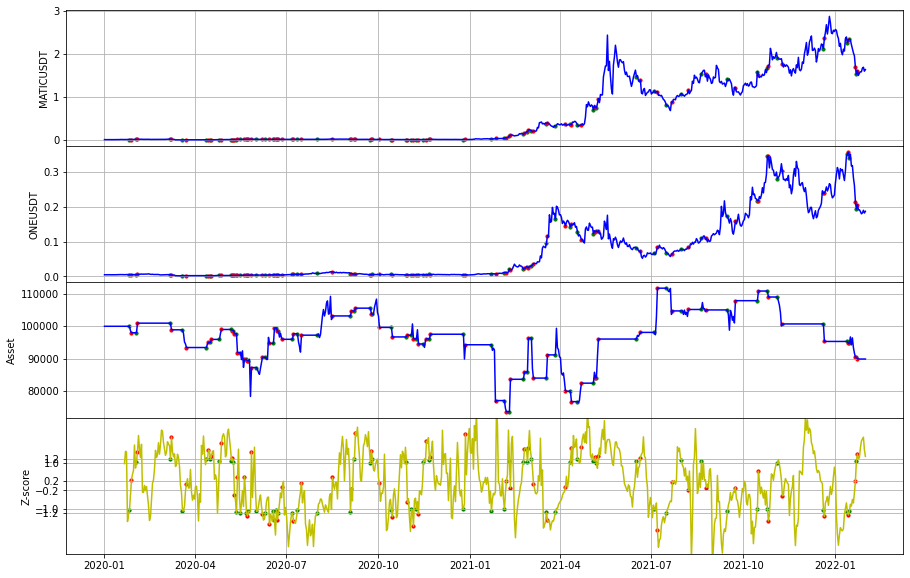

MATICUSDT_CELRUSDT 回測結果，場上有單已平倉
-----------------------------MATICUSDT-CELRUSDT--------------------------
初始價格 100000
總損益:  333542.63640359
總交易次數:  49
平均損益:  6806.992579665197
勝率:  0.6122448979591837
獲利因子:  3.0630323357987574
賺賠比:  1.9399204793392126
最大資金回落:  44360.71759271377
夏普比率:  0.28094222453075857


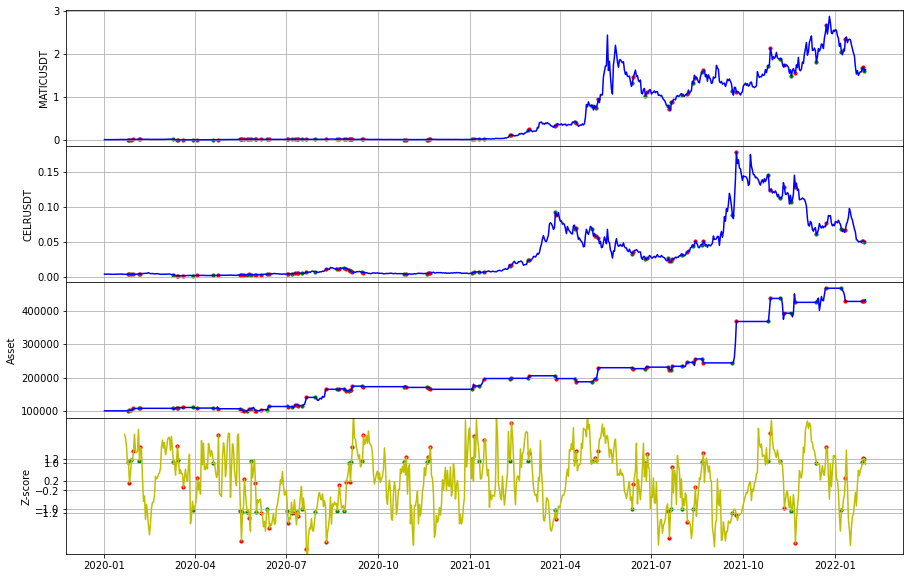

ATOMUSDT_ETHUSDT 回測結果
-----------------------------ATOMUSDT-ETHUSDT--------------------------
初始價格 100000
總損益:  -22971.06657504
總交易次數:  53
平均損益:  -433.41635047254164
勝率:  0.6037735849056604
獲利因子:  0.7431999658606699
賺賠比:  0.48772497759606465
最大資金回落:  58293.44703057014
夏普比率:  -0.09408067363501219


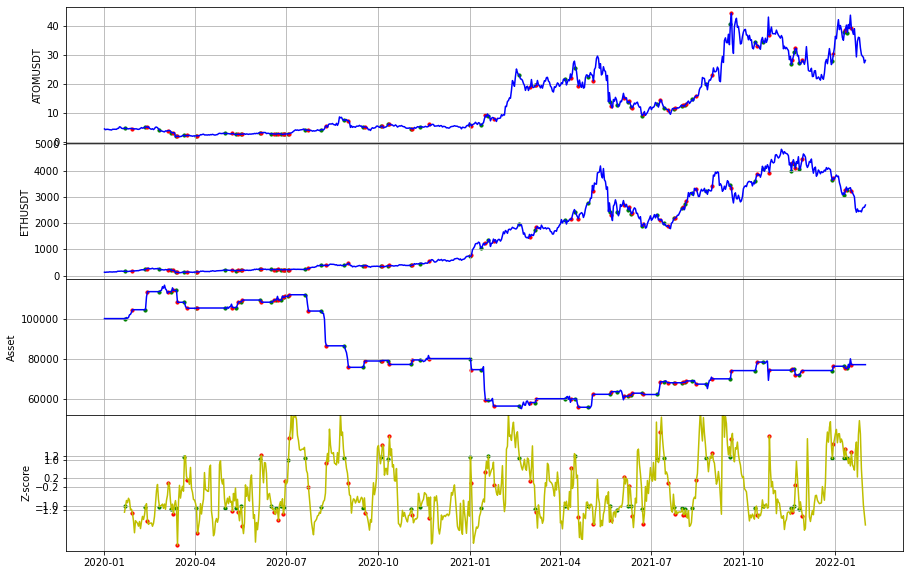

ATOMUSDT_ONEUSDT 回測結果
-----------------------------ATOMUSDT-ONEUSDT--------------------------
初始價格 100000
總損益:  -40103.14853913
總交易次數:  61
平均損益:  -657.4286645758314
勝率:  0.47540983606557374
獲利因子:  0.6771984378543342
賺賠比:  0.7472534486668515
最大資金回落:  58060.2412748912
夏普比率:  -0.13129295002089425


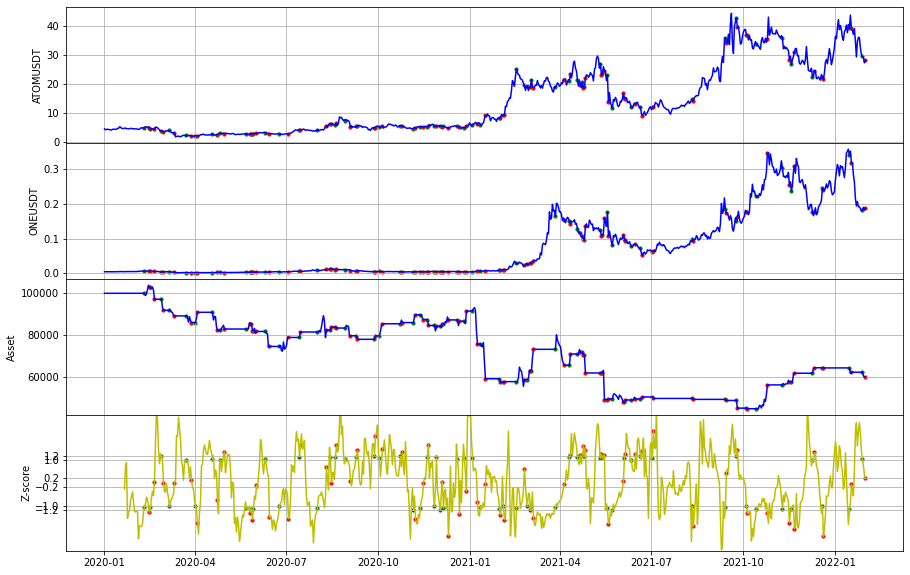

ATOMUSDT_FETUSDT 回測結果
-----------------------------ATOMUSDT-FETUSDT--------------------------
初始價格 100000
總損益:  9049.56139551
總交易次數:  62
平均損益:  145.9606676695933
勝率:  0.46774193548387094
獲利因子:  1.0725202735884407
賺賠比:  1.2204541044282256
最大資金回落:  41574.48209082351
夏普比率:  0.024390976881547566


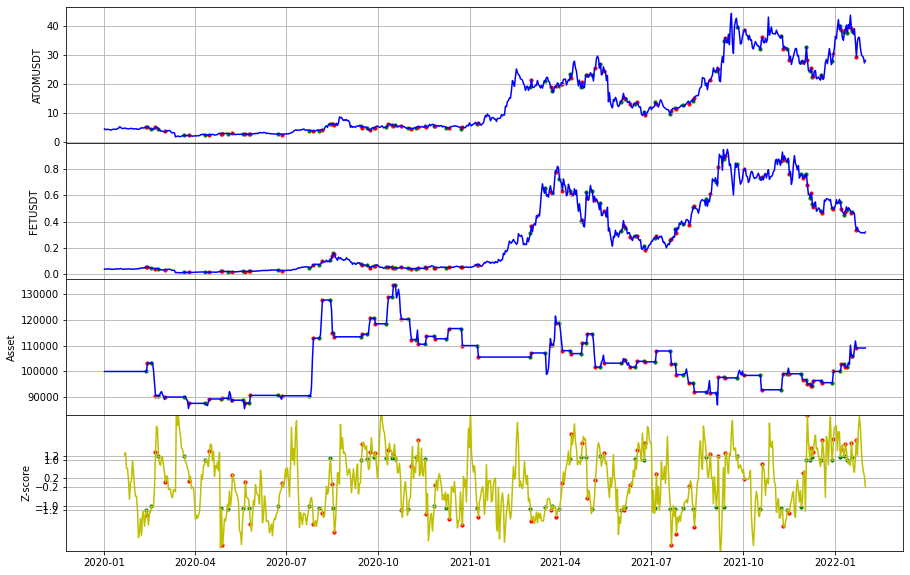

ATOMUSDT_BATUSDT 回測結果
-----------------------------ATOMUSDT-BATUSDT--------------------------
初始價格 100000
總損益:  30754.79929153
總交易次數:  54
平均損益:  569.5333202135998
勝率:  0.5370370370370371
獲利因子:  1.309570995866087
賺賠比:  1.1289405136776614
最大資金回落:  28333.226383426954
夏普比率:  0.08380757010952793


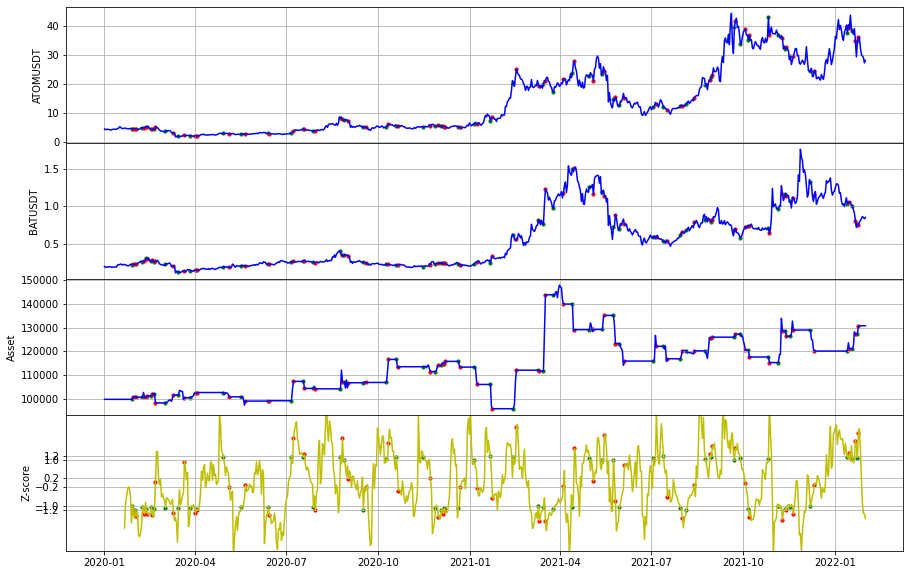

ATOMUSDT_CELRUSDT 回測結果
-----------------------------ATOMUSDT-CELRUSDT--------------------------
初始價格 100000
總損益:  33718.10156589
總交易次數:  54
平均損益:  624.4092882572376
勝率:  0.6111111111111112
獲利因子:  1.2589376862990633
賺賠比:  0.8011421640084949
最大資金回落:  29797.85689806973
夏普比率:  0.0813741881454297


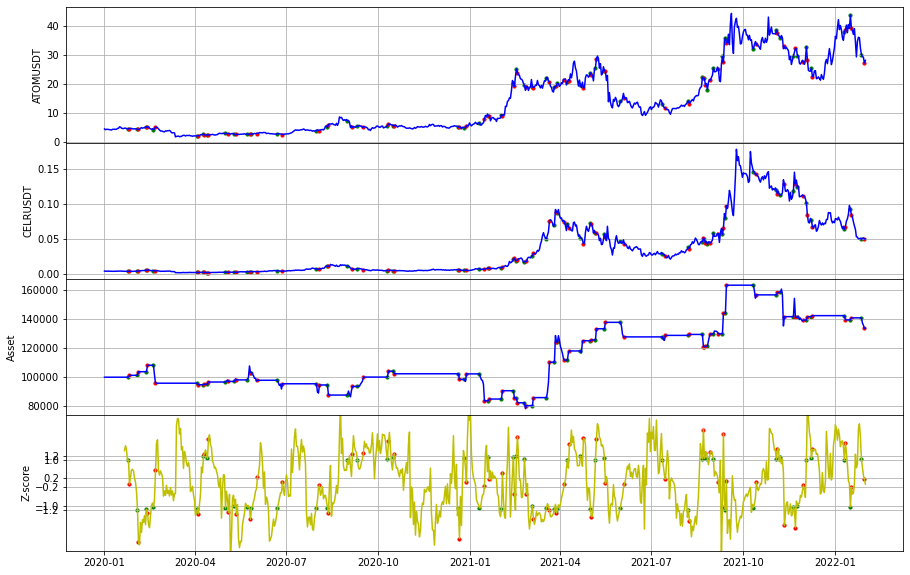

ATOMUSDT_ENJUSDT 回測結果，場上有單已平倉
-----------------------------ATOMUSDT-ENJUSDT--------------------------
初始價格 100000
總損益:  -16668.05796453
總交易次數:  51
平均損益:  -326.82466597126785
勝率:  0.47058823529411764
獲利因子:  0.8361057430616563
賺賠比:  0.9057812216501278
最大資金回落:  42815.25858408631
夏普比率:  -0.05994058288463685


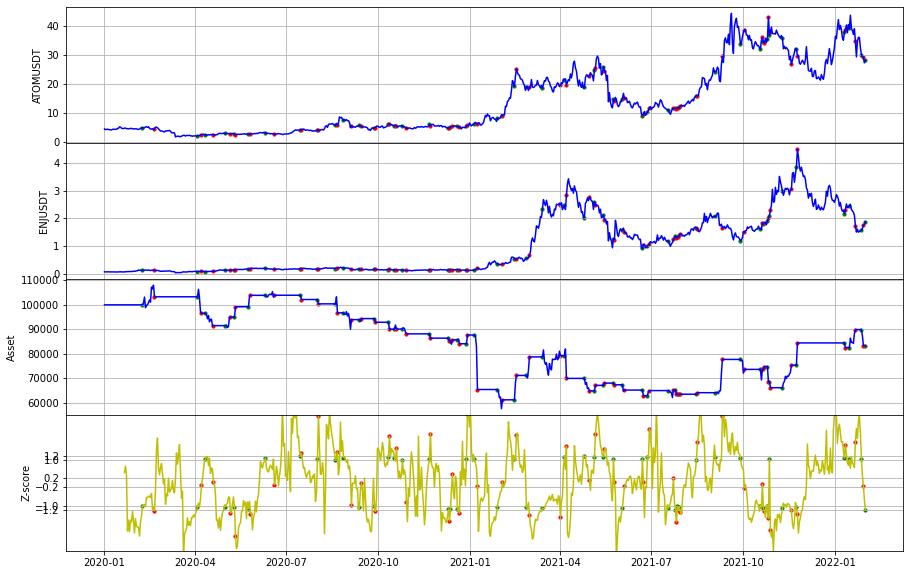

In [11]:
for i in result_list:
    df1 = df[[i[0], i[1]]]
    A = pairTrade(df1)
    A.indicator(tradeType = 'ratio')
    A.strategy(strategyType = 'divergence', actionType = 'amount', entry = 1, exit = 0.2, stopLoss = 1.2)
    A.pplot()

In [ ]:
A = pairTrade(df1)
A.indicator(tradeType = 'spread')
A.strategy(strategyType = 'divergence', actionType = 'amount', entry = 1, exit = 0.2, stopLoss = 1.2)
A.pplot()

In [ ]:
A = pairTrade(df1)
A.indicator(tradeType = 'returnSpread')
A.strategy(strategyType = 'divergence', actionType = 'amount', entry = 1, exit = 0.2, stopLoss = 1.2)
A.pplot()

In [ ]:
A = pairTrade(df1)
A.indicator(tradeType = 'regression')
A.strategy(strategyType = 'divergence', actionType = 'unit', entry = 1, exit = 0.2, stopLoss = 1.2)
A.pplot()

In [ ]:
A.df.head(30)

In [ ]:
A.df.to_csv('regression3.xlsx')